In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler

from skmultiflow.data import HyperplaneGenerator

import scipy.stats as stats

from numpy.random import seed
from numpy.random import randn
from scipy.stats import shapiro
from scipy.stats import normaltest
from scipy.stats import anderson

import tensorflow
import tensorflow.keras.backend as K
import tensorflow.keras.layers as layers

import warnings
warnings.filterwarnings('ignore')

###   DATA REFERENCE : https://www.win.tue.nl/~mpechen/data/DriftSets/

### 1.Generate Hyperplane Data  

In [2]:
def gen_hyperplane_data(data_size, n_features, drift_f,mag_change, noise_ratio,sigma ):
    stream=HyperplaneGenerator(random_state=0, n_features=n_features, n_drift_features=drift_f, mag_change=mag_change, noise_percentage=noise_ratio, sigma_percentage=sigma)
    data=stream.next_sample(data_size)
    features=data[0]
    label=data[1]
    data=pd.DataFrame(features)
    label=pd.DataFrame(label)
    col=[]
    for i in range(n_features):
        col_name=('att{}'.format(i))
        col.append(col_name)
    data.columns=col
    label.columns=['output']
    data=pd.concat([data,label],axis=1)
    
    return data  

In [3]:
data=gen_hyperplane_data(100000, 10, 0,0,0,0)

In [4]:
data.head()

,att0,att1,att2,att3,att4,att5,att6,att7,att8,att9,output
0,0.791725,0.528895,0.568045,0.925597,0.071036,0.087129,0.020218,0.832620,0.778157,0.870012,1
1,0.799159,0.461479,0.780529,0.118274,0.639921,0.143353,0.944669,0.521848,0.414662,0.264556,0
2,0.456150,0.568434,0.018790,0.617635,0.612096,0.616934,0.943748,0.681820,0.359508,0.437032,1
3,0.060225,0.666767,0.670638,0.210383,0.128926,0.315428,0.363711,0.570197,0.438602,0.988374,0
4,0.208877,0.161310,0.653108,0.253292,0.466311,0.244426,0.158970,0.110375,0.656330,0.138183,0


### User Defined Functions 

In [5]:
def mse_predictions(test, encoder):
    #test=data[int((0.66*len(data))):len(data)-1]
    #pos_test, neg_test=encode(test)
    #Y_test=test['class']
    #X_test=test.drop(['class'],axis=1)
    test=np.array(test)
    predictions=[]
    for i in range(0, test.shape[0]):
        ROW = np.array([test[i]])
        pred= encoder.predict(ROW) 
        mse = np.mean(np.power(test[i] - pred, 2))
        predictions.append(mse)
        #print(test[i] ,pred,mse)
    return predictions

In [6]:
def plot_results(predictions):
    df=pd.DataFrame(predictions,columns=['MSE'])
    #df['class']=pd.Series(Y_test)
    df['MSE']=df['MSE'].round(2)
    #df_positive_class=df[df['class']==1]
    #df_negative_class=df[df['class']==0]
   
    mean=np.mean(predictions).round(3)
    max=np.max(predictions).round(3)
    min=np.min(predictions).round(3)
    var=np.var(predictions).round(5)
    
    
    f, axes = plt.subplots(1, 2,figsize=(16,4))
    f.suptitle('Boxplots and Normal Distribution plot for MSE Distribution')
    #axes[0, 0].set_title('MSE of Positive Class')
    sns.boxplot(x=df['MSE'], data=df, ax=axes[0])
    #axes[0, 1].set_title('MSE of Negative Class')    
    #sns.boxplot(x=df_negative_class['MSE'], data=df_negative_class  , ax=axes[1])
    sns.distplot(x=df['MSE'],  ax=axes[1])
    print('mean={} ,max={},min={},variance={}'.format(mean,max,min,var))
    
    fig, ax = plt.subplots(figsize=(16,5))
    ax.set_title('MSE plot ')
    plt.plot(df['MSE'],label="MSE")
    #plt.plot(df_positive_class['MSE'],label="MSE of Positive Class")
    plt.legend()
    plt.show()  
    #return df

In [7]:
# Shapiro-Wilk Test
def Shapiro_Wilk(data):
    stat, p = shapiro(data)
    print('Statistics=%.3f, p=%.10f' % (stat, p))
    # interpret
    alpha = 0.05
    if p > alpha:
        print('Sample looks Gaussian (fail to reject H0)')
    else:
        print('Sample does not look Gaussian (reject H0)')

In [8]:
# D'Agostino and Pearson's Test
def D_Agostino(data):
    stat, p = normaltest(data)
    print('Statistics=%.3f, p=%.3f' % (stat, p))
    # interpret
    alpha = 0.05
    if p > alpha:
        print('Sample looks Gaussian (fail to reject H0)')
    else:
        print('Sample does not look Gaussian (reject H0)')

In [9]:
# Anderson-Darling Test
def Anderson_Darling(data):
    result = anderson(data)
    print('Statistic: %.3f' % result.statistic)
    p = 0
    for i in range(len(result.critical_values)):
        sl, cv = result.significance_level[i], result.critical_values[i]
        if result.statistic < result.critical_values[i]:
            print('%.3f: %.3f, data looks normal (fail to reject H0)' % (sl, cv))
        else:
            print('%.3f: %.3f, data does not look normal (reject H0)' % (sl, cv))

In [10]:
#Plot the model loss(train/test) for give number of epochs
def plot_loss(history):
    plt.plot(history['loss'], linewidth=2, label='Training_Loss')
    plt.plot(history['val_loss'], linewidth=2, label='Validation_Loss')
    plt.legend(loc='upper right')
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    #plt.ylim(ymin=0.70,ymax=1)
    plt.show()

In [11]:
def make_batches(test_data,batch_size):
    data=np.array(test_data)
    #batch_size=32
    batches={}
    count=0
    for index in range(0,data.shape[0],batch_size):
        batches[count]=data[index:min(index+batch_size,data.shape[0]),:]
        count+=1
    return batches
    #print(batch.shape) 

In [12]:
def compute_instance_loss_batch_loss(batch,batch_size,encoder):
    mse_list=[]
    mse_sum=0  
    for i in range(0,batch.shape[0]):
        ROW = np.array([batch[i]])
        pred= encoder.predict(ROW) 
        mse = np.round(np.mean(np.power(batch[i] - pred, 2)),5)
        mse_list.append(mse)
        mse_sum+=mse
    avg_mse=mse_sum/batch_size
    return mse_list,avg_mse   
    

In [13]:
def check_all_batch_normality(batches,encoder,batch_size):
    batch_avg_mse=[]
    batch_mse_values={}
    for b in batches:
        print("\n ********************")
        print('Batch: {}'.format(b))
        mse_list,average_mse=compute_instance_loss_batch_loss(batches[b],batch_size,encoder)
        plot_results(mse_list)
        
        print("\nShapiro_Wilk Test")
        Shapiro_Wilk(mse_list)
        print("D_Agostino Test")
        D_Agostino(mse_list)
        print("\nAnderson_Darling Test")
        Anderson_Darling(mse_list)
        batch_avg_mse.append(average_mse)
        batch_mse_values[b]=mse_list
    return batch_avg_mse,batch_mse_values

In [14]:
## computes loss threshold uisng IQR as well as ZScore from first test batch 
def compute_loss_threshold_testdata(threshold_batch):
    #val_loss=history['val_loss']
    ## Quartile Method 
    Q1=np.quantile(threshold_batch,0.25)
    Q3=np.quantile(threshold_batch,0.75)
    IQR=Q3-Q1
    thres_iqr=(Q3+1.5*IQR).round(4)
    #Z_SCORE
    mean=np.mean(threshold_batch)
    sigma=np.std(threshold_batch)
    thres_zscore=(mean+3*sigma).round(4)
    
    return thres_iqr ,thres_zscore

In [15]:
## computes loss threshold uisng IQR as well as ZScore from first test batch 
def compute_batch_threshold_testdata(batch_avg_mse):
    #val_loss=history['val_loss']
    ## Quartile Method 
    Q1=np.quantile(batch_avg_mse,0.25)
    Q3=np.quantile(batch_avg_mse,0.75)
    IQR=Q3-Q1
    thres_iqr=(Q3 + 1.5*IQR).round(4)
    #Z_SCORE
    mean=np.mean(batch_avg_mse)
    sigma=np.std(batch_avg_mse)
    thres_zscore=(mean+3*sigma).round(4)
    thresh_max=np.round((np.max(batch_avg_mse)),3)
    return thres_iqr, thres_zscore ,thresh_max

In [16]:
# This function takes two lists of Batch MSE and Exceed Counts along with Batch and Count Thresholds of Layer 2 AE
# If three consecutive bathces exceed booth thresholds , warning is generated and for 10 consectutive batches drift is confirmed.
def detect_drift(batch_mse,exceed_list, Thresh,count_thresh):
    n=0 # total number of batches where MSE exceeds threshold
    count=0 ## counts the number of consecutive batches exceding threshold
    w_count=0 # Count of elements in Window. Windows contains batch number where batch MSE exceeds
              #threshold 
    w_index_list=[] # Contains indices of batches where batch MSE esceeds threshold 
    for i in range(0,len(batch_mse)):
        #print (batch_mse)
        if((((batch_mse[i])>Thresh)) and (exceed_list[i]>count_thresh)):
            print(' Threshold exceeds at batch : {}'.format(i))
            n=n+1
            #print('Cumulative Batch Count Exceeding Threshold : {}'.format(n))
            if(len(w_index_list)==0 or (i-w_index_list[-1]==1)):
                # Check if w_index_list is empty or its last entry is the previous batch
                    w_index_list.append(i)# then append this batch to w_index_list
            count+=1
            #if (i!= w_index_list[-1]
            #print ("Batch %d MSE exceeds Threshold" %i)
            print(w_index_list)
            if (count>2):# if for more than nine consecutive batches , batch MSE esceeds threshold , then 
                         # confirm drift
                drift_batch=i-2 # at the first batch i this window

                print( " Drift Confirmed at Batch No : % d" %drift_batch)
            if (len(w_index_list)>=1 and len(w_index_list)<=2):
                w_level=i-len(w_index_list)
                print("Warning Level at Batch",i)
        
        if(batch_mse[i])<Thresh:
            count=0 # reset count 
            #if len(w_index_list)>=2:
               # w_level=i-len(w_index_list)
                #print("Warning Level at Batch",w_level)
            if len(w_index_list)<=3:
                w_index_list=[]

In [17]:
def plot_batch_mse(batch_mse):
    df=pd.DataFrame(batch_mse,columns=['MSE'])
    fig, ax = plt.subplots(figsize=(16,5))
    ax.set_title('MSE plot ')
    plt.plot(df['MSE'],label="MSE")
    #plt.plot(df_positive_class['MSE'],label="MSE of Positive Class")
    plt.legend()
    plt.show()  

In [18]:
def threshold_exceed_count(batch_mse_values, thr):
    exceed_count={}
    for key in batch_mse_values.keys():
        count=0
        list=batch_mse_values[key]
        for a in range(0,len(list)):
            if list[a]>thr:
                count+=1
        exceed_count[key]=count 
    values = exceed_count.values()
    total = sum(values)
    return exceed_count,total

In [19]:
# Here test  is a batch of size batch_size . This function computes average MSE for a batch passed 
def avg_mse_predictions(test, encoder,batch_size):
    #test=data[int((0.66*len(data))):len(data)-1]
    #pos_test, neg_test=encode(test)
    #Y_test=test['class']
    #X_test=test.drop(['class'],axis=1)
    test=np.array(test)
    #predictions=[]
    mse_sum=0
    for i in range(0, test.shape[0]):
        ROW = np.array([test[i]])
        pred= encoder.predict(ROW) 
        mse = np.round(np.mean(np.power(test[i] - pred, 2)),5)
        mse_sum+=mse
        #predictions.append(mse)
        #print(test[i] ,pred,mse)
    avg_mse=mse_sum/batch_size
    return avg_mse

In [20]:
## Computes batch MSE for all the batches in coming data stream data 
def compute_batch_mse(batches):
    batch_mse=[]
    for i in batches:
        avg_batch_mse=avg_mse_predictions(batches[i],encoder,32)
        batch_mse.append(avg_batch_mse)
    return batch_mse

In [21]:
def plot_batch_mse(batch_mse):
    df=pd.DataFrame(batch_mse,columns=['MSE'])
    fig, ax = plt.subplots(figsize=(16,5))
    ax.set_title('MSE plot ')
    plt.plot(df['MSE'],label="MSE")
    #plt.plot(df_positive_class['MSE'],label="MSE of Positive Class")
    plt.legend()
    plt.show()  

In [22]:
def encode_all(data,label_col):
        
    from sklearn.preprocessing import LabelEncoder
    # Apply Label Encoding
    encoder=LabelEncoder()
    for col in data.columns:
        if ((data[col].dtype=='object')and (data[col]!=label_col)): 
            data = pd.get_dummies(data, columns=[col])
   
      # Apply Minmax Normalization 
    for col in data.columns:
        if ((data[col].dtype=='float64')or(data[col].dtype=='int64')): 
            data[col] = np.round((data[col] - data[col].min()) / (data[col].max() - data[col].min()) ,3)  
        

   
    train=data[0:int(len(data)*0.80)]
    test=data[int((0.80*len(data))):len(data)]
    
    
    train_positives = train[train[label_col] == 1]
    train_negatives = train[train[label_col] == 0]
    
    X_positive=train_positives.drop(['output'],axis=1)
    X_negative=train_negatives.drop(['output'],axis=1)
    return train, test , data, X_positive,X_negative
    

In [23]:
def autoencoder (train,epochs,val_set):
    
    # set bottleneck 1/3 of the input layer size
    encoding_dim = int(np.floor(train.shape[-1]/3))
    
    # input layer size= # of attributes in the dataset after one-hot encoding
    input_layer = tensorflow.keras.Input(shape=train.shape[1:]) # Input Layer
    
    encoded = layers.Dense(encoding_dim, activation='sigmoid')(input_layer) # Code Layer
    decoded = layers.Dense(train.shape[1], activation='sigmoid')(encoded) # Output Laye
       
    
    autoencoder = tensorflow.keras.Model(input_layer, decoded)
    # above model maps an input to its reconstruction 
    
    encoder = tensorflow.keras.Model(input_layer, encoded)
    # above model maps input to its encoded representation 
    
   
    encoded_input = tensorflow.keras.Input(shape=(encoding_dim,))# Encoded Input
    decoder_layer = autoencoder.layers[-1]# Retrieve last layer of autoencoder model defined above
    decoder = tensorflow.keras.Model(encoded_input, decoder_layer(encoded_input))# Decoder Model
          
    autoencoder.compile(optimizer='adam', loss='mse') # Train autoencoder 
    history=autoencoder.fit(train,train, 
                epochs=epochs,
                batch_size=32,
                shuffle=True,
                validation_data=(val_set, val_set)).history
    return  autoencoder , history

In [24]:
def train_encoders(X_Positive,X_Negative, epochs):
    
    X_Positive_train=X_Positive[0:int(len(X_Positive)*0.90)]
    X_Positive_test=X_Positive[int((0.90*len(X_Positive))):len(X_Positive)-1]
    
    X_Negative_train=X_Negative[0:int(len(X_Negative)*0.90)]
    X_Negative_test=X_Negative[int((0.90*len(X_Negative))):len(X_Negative)-1]
   


    print("Training Autoencoder on Positive Examples ")
    encoder_pos_class, history_positive_class=autoencoder(X_Positive_train,epochs,X_Positive_test)
    print("Training Autoencoder on Negative Examples ")
    encoder_neg_class,history_negative_class=autoencoder(X_Negative_train,epochs,X_Negative_test)
    
    return encoder_pos_class, history_positive_class ,encoder_neg_class,history_negative_class

In [25]:
train, test , data, X_positive,X_negative=encode_all(data,'output')

In [26]:
X_negative

,att0,att1,att2,att3,att4,att5,att6,att7,att8,att9
1,0.799,0.461,0.781,0.118,0.640,0.143,0.945,0.522,0.415,0.265
3,0.060,0.667,0.671,0.210,0.129,0.315,0.364,0.570,0.439,0.988
4,0.209,0.161,0.653,0.253,0.466,0.244,0.159,0.110,0.656,0.138
6,0.283,0.120,0.296,0.119,0.318,0.414,0.064,0.692,0.567,0.265
7,0.094,0.576,0.929,0.319,0.667,0.132,0.716,0.289,0.183,0.587
...,...,...,...,...,...,...,...,...,...,...
79989,0.566,0.494,0.621,0.814,0.249,0.068,0.674,0.250,0.746,0.126
79990,0.673,0.460,0.748,0.657,0.213,0.082,0.553,0.322,0.028,0.756
79993,0.837,0.840,0.936,0.441,0.273,0.066,0.689,0.136,0.132,0.909
79994,0.313,0.653,0.709,0.544,0.230,0.761,0.899,0.241,0.170,0.716


  encoder_pos_class, history_positive_class ,encoder_neg_class,history_negative_class=train_encoders(X_positive,X_negative,100)

In [28]:
encoder_pos_class.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 10)]              0         
_________________________________________________________________
dense (Dense)                (None, 3)                 33        
_________________________________________________________________
dense_1 (Dense)              (None, 10)                40        
Total params: 73
Trainable params: 73
Non-trainable params: 0
_________________________________________________________________


In [29]:
test_pos_class=test[test['output']==1]
test_neg_class=test[test['output']==0]

In [30]:
del test_pos_class['output']

In [31]:
test_pos_class

,att0,att1,att2,att3,att4,att5,att6,att7,att8,att9
80000,0.507,0.961,0.970,0.989,0.805,0.792,0.162,0.850,0.398,0.393
80001,0.621,0.881,0.970,0.107,0.656,0.148,0.136,0.847,0.208,0.861
80005,0.888,0.311,0.679,0.473,0.149,0.612,0.540,0.685,0.846,0.559
80009,0.568,0.859,0.211,0.356,0.850,0.690,0.467,0.776,0.375,0.464
80011,0.378,0.171,0.318,0.740,0.447,0.484,0.566,0.826,0.438,0.640
...,...,...,...,...,...,...,...,...,...,...
99994,0.580,0.943,0.079,0.750,0.232,0.565,0.735,0.346,0.361,0.757
99995,0.627,0.694,0.014,0.564,0.893,0.955,0.507,0.899,0.033,0.624
99996,0.961,0.183,0.880,0.432,0.768,0.228,0.962,0.499,0.258,0.306
99997,0.101,0.991,0.489,0.238,0.450,0.827,0.016,0.633,0.822,0.402


In [32]:
del test_neg_class['output']


In [33]:
test_neg_class

,att0,att1,att2,att3,att4,att5,att6,att7,att8,att9
80002,0.364,0.299,0.090,0.860,0.899,0.012,0.340,0.729,0.500,0.176
80003,0.776,0.265,0.455,0.035,0.630,0.306,0.377,0.488,0.427,0.618
80004,0.661,0.924,0.275,0.795,0.218,0.954,0.202,0.156,0.113,0.111
80006,0.061,0.228,0.276,0.262,0.858,0.702,0.216,0.055,0.408,0.677
80007,0.261,0.343,0.059,0.385,0.631,0.623,0.583,0.214,0.750,0.729
...,...,...,...,...,...,...,...,...,...,...
99987,0.921,0.049,0.231,0.569,0.617,0.039,0.933,0.746,0.096,0.727
99989,0.143,0.264,0.340,0.601,0.124,0.154,0.142,0.506,0.128,0.872
99990,0.638,0.922,0.671,0.830,0.341,0.332,0.772,0.181,0.163,0.365
99991,0.628,0.199,0.588,0.476,0.213,0.884,0.055,0.313,0.789,0.126


### Computing Thresholds on Negative Test Data by Negative Autoencoder

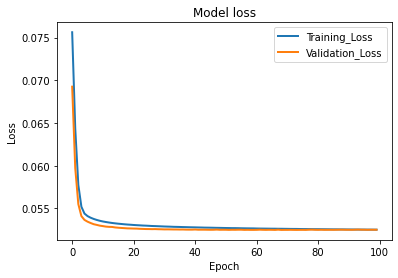

In [34]:
plot_loss(history_negative_class)

In [35]:
predictions_neg=mse_predictions(test_neg_class,encoder_neg_class)

mean=0.052 ,max=0.144,min=0.003,variance=0.00048


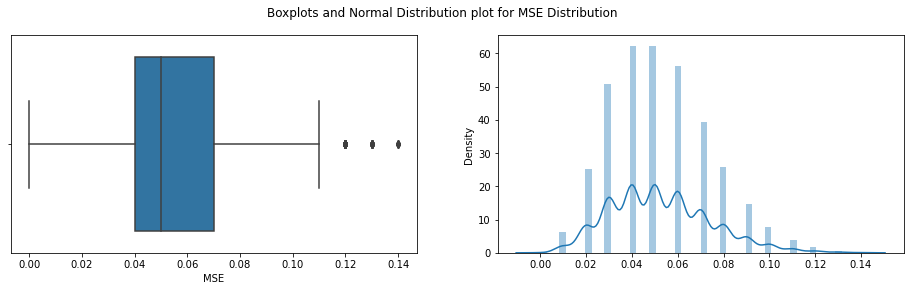

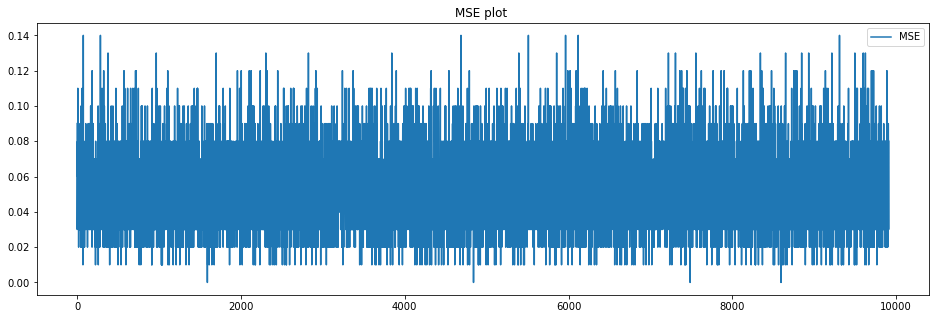

In [36]:
plot_results(predictions_neg)

In [37]:
Anderson_Darling(predictions_neg)

Statistic: 40.166
15.000: 0.576, data does not look normal (reject H0)
10.000: 0.656, data does not look normal (reject H0)
5.000: 0.787, data does not look normal (reject H0)
2.500: 0.918, data does not look normal (reject H0)
1.000: 1.092, data does not look normal (reject H0)


In [38]:
batches_neg=make_batches(test_neg_class,32)

batch_avg_mse_neg_en_neg,batch_mse_values_neg_en_neg=check_all_batch_normality(batches_neg,encoder_neg_class,32)

## Compute Instance Threshold from first N Batches

In [40]:
def compute_instance_threshold_firstN_batches(batch_avg_mse_values,N):
    zscore_list=[]
    value_list=[]
    for k in range(0,N):
        value_list=batch_avg_mse_values[k]
        #Z_SCORE
        mean=np.mean(value_list)
        sigma=np.std(value_list)
        thres_zscore=(mean+3*sigma).round(4)
        zscore_list.append(thres_zscore)
        #print (value_list)
        #print(zscore_list)
    return (np.mean(zscore_list).round(4)) , zscore_list     

In [41]:
instance_thresh_neg,zscore_list_neg =compute_instance_threshold_firstN_batches(batch_mse_values_neg_en_neg,30)

In [42]:
instance_thresh_neg

0.1149

In [43]:
Anderson_Darling(zscore_list_neg)

Statistic: 0.193
15.000: 0.521, data looks normal (fail to reject H0)
10.000: 0.593, data looks normal (fail to reject H0)
5.000: 0.712, data looks normal (fail to reject H0)
2.500: 0.830, data looks normal (fail to reject H0)
1.000: 0.988, data looks normal (fail to reject H0)


## Compute Batch Threshold

In [44]:
batch_avg_mse_neg_en_neg;

In [45]:
thres_iqr_batch_neg, thres_zscore_batch_neg ,thresh_max_batch_neg=compute_batch_threshold_testdata(batch_avg_mse_neg_en_neg)

In [46]:
thres_iqr_batch_neg, thres_zscore_batch_neg ,thresh_max_batch_neg

(0.0623, 0.0645, 0.063)

## Compute Count Threshold

In [47]:
# Counts the MSE values exceeding threshold in each batch 
exceed_count_neg_en_neg,total_neg_en_neg=threshold_exceed_count(batch_mse_values_neg_en_neg,instance_thresh_neg)

In [48]:
exceed_count_neg_en_neg,total_neg_en_neg;

In [49]:
exceed_list_neg_en_neg=[]
for key in exceed_count_neg_en_neg.keys():
    exceed_list_neg_en_neg.append(exceed_count_neg_en_neg[key])


mean=0.235 ,max=3,min=0,variance=0.23164


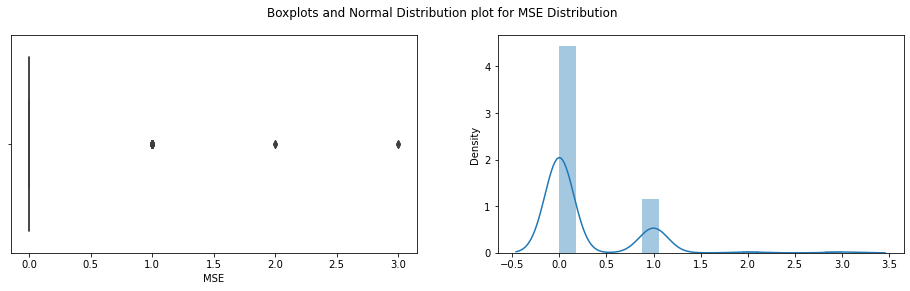

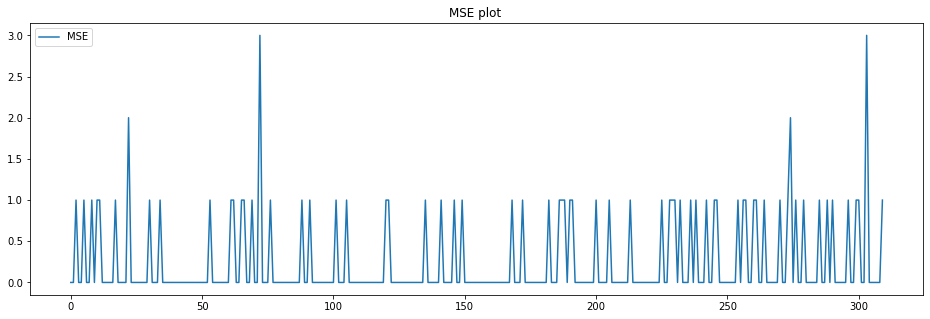

In [50]:
plot_results(exceed_list_neg_en_neg)

In [51]:
count_thresh_neg=np.max(exceed_list_neg_en_neg)

In [52]:
count_thresh_neg

3

# Computing Thresholds on Positive  Test Data by Positive Autoencoder

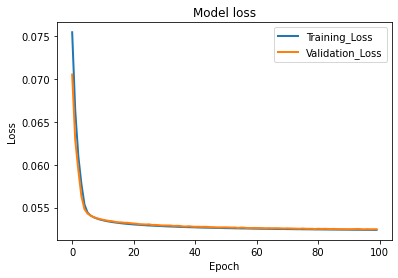

In [53]:
plot_loss(history_positive_class)

In [54]:
predictions_pos=mse_predictions(test_pos_class,encoder_pos_class)

mean=0.053 ,max=0.151,min=0.002,variance=0.00047


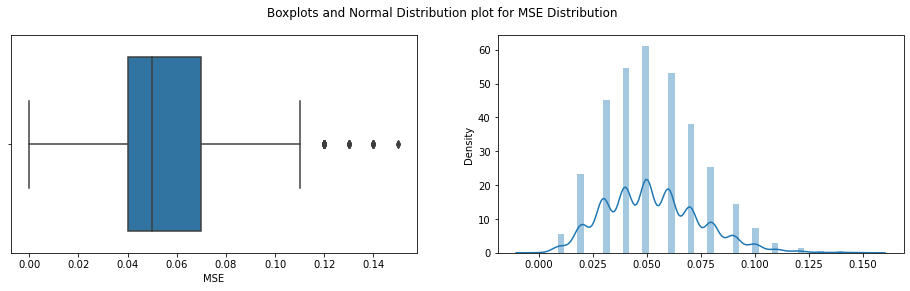

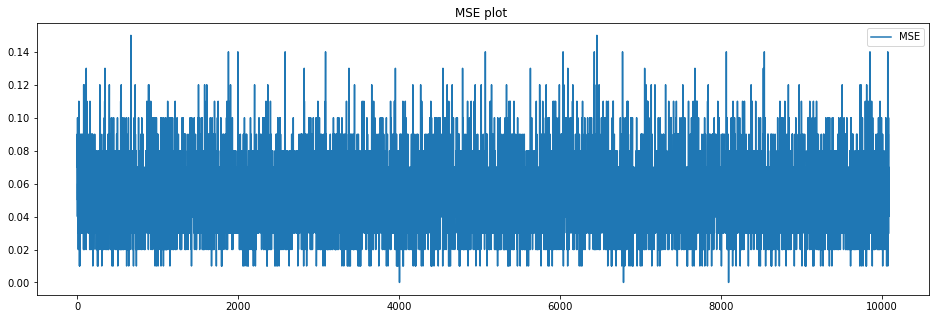

In [55]:
plot_results(predictions_pos)

In [56]:
Anderson_Darling(predictions_pos)

Statistic: 32.610
15.000: 0.576, data does not look normal (reject H0)
10.000: 0.656, data does not look normal (reject H0)
5.000: 0.787, data does not look normal (reject H0)
2.500: 0.918, data does not look normal (reject H0)
1.000: 1.092, data does not look normal (reject H0)


In [57]:
Shapiro_Wilk(predictions_pos)

Statistics=0.983, p=0.0000000000
Sample does not look Gaussian (reject H0)


In [58]:
batches_pos=make_batches(test_pos_class,32)

In [59]:
test_pos_class.shape

(10088, 10)


 ********************
Batch: 0
mean=0.055 ,max=0.109,min=0.011,variance=0.00057


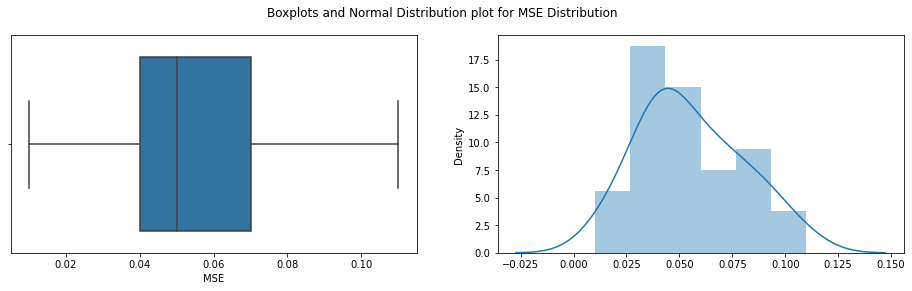

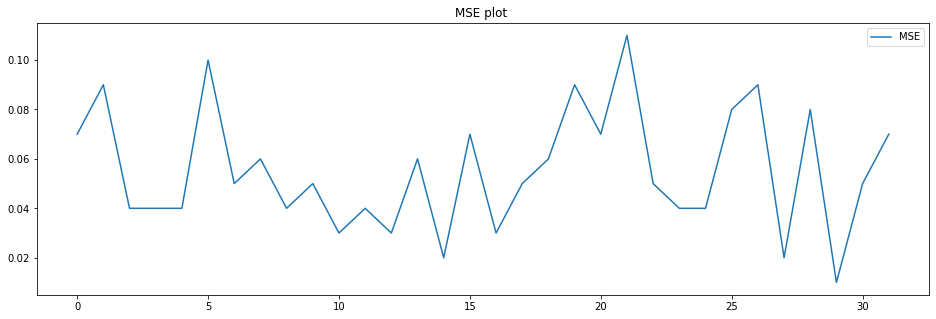


Shapiro_Wilk Test
Statistics=0.963, p=0.3305469751
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.655, p=0.437
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.509
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 1
mean=0.052 ,max=0.095,min=0.013,variance=0.00043


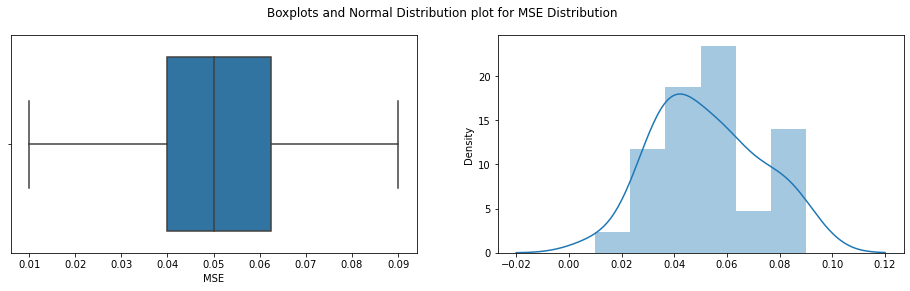

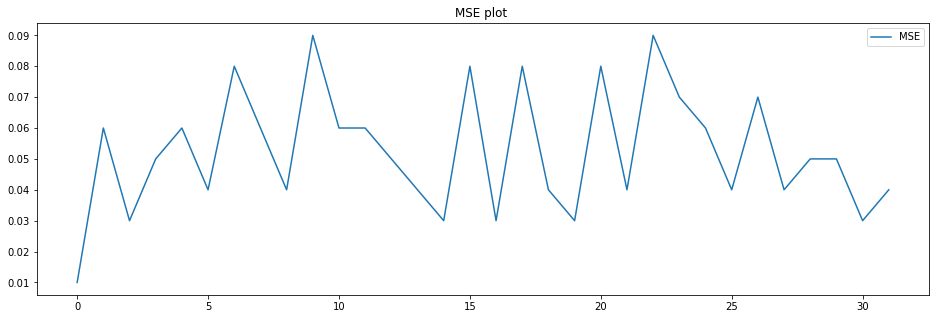


Shapiro_Wilk Test
Statistics=0.958, p=0.2377585471
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.661, p=0.436
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.488
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 2
mean=0.054 ,max=0.124,min=0.021,variance=0.00063


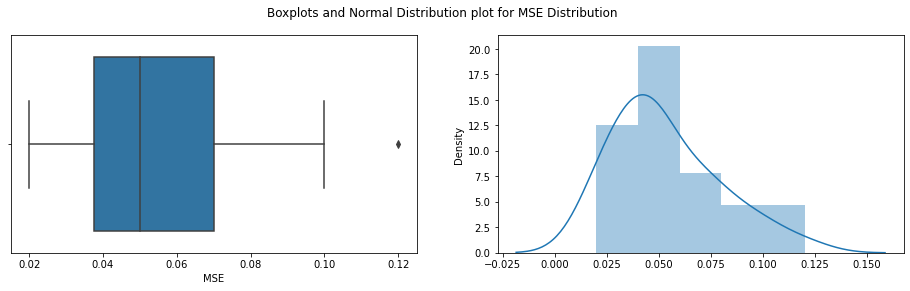

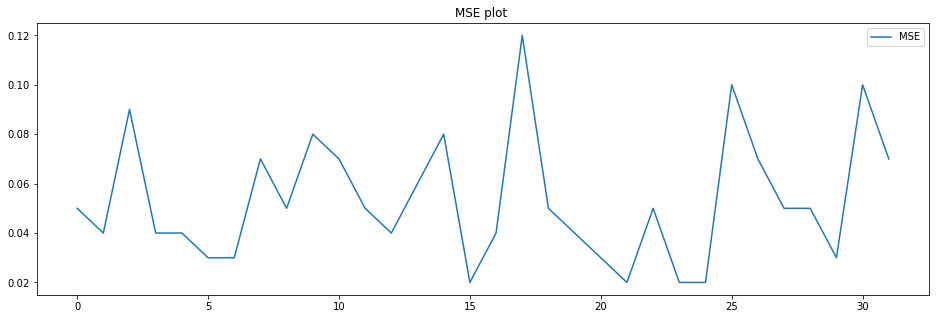


Shapiro_Wilk Test
Statistics=0.925, p=0.0279384833
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=4.970, p=0.083
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.808
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 3
mean=0.055 ,max=0.129,min=0.023,variance=0.0007


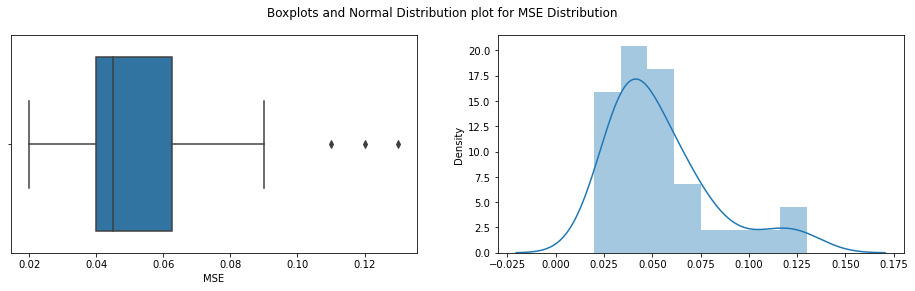

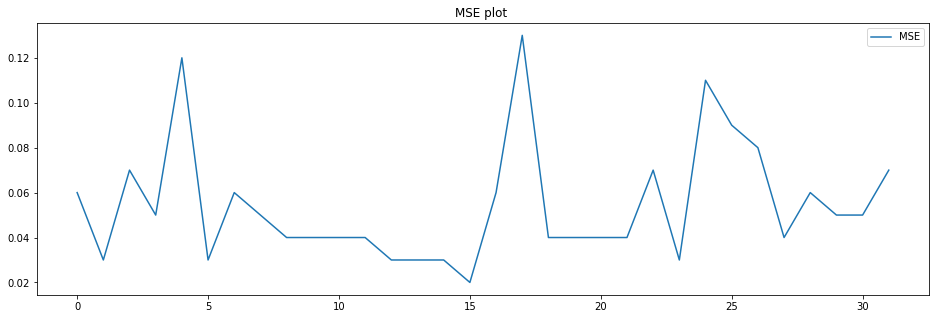


Shapiro_Wilk Test
Statistics=0.866, p=0.0009395021
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=11.756, p=0.003
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.344
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 4
mean=0.054 ,max=0.11,min=0.02,variance=0.00032


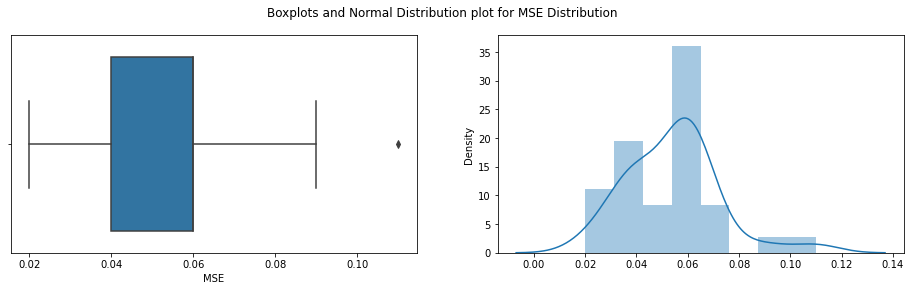

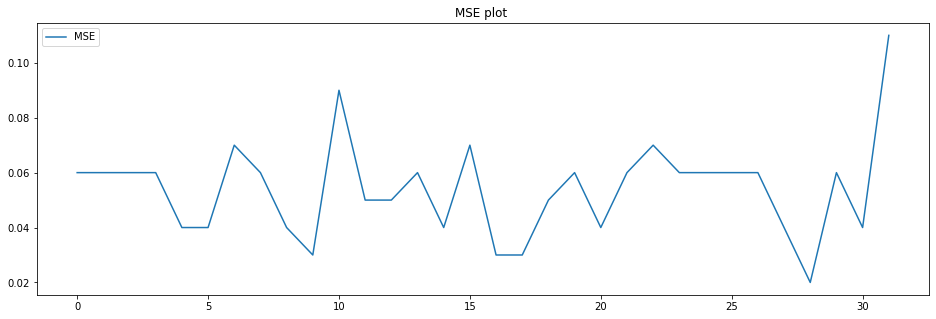


Shapiro_Wilk Test
Statistics=0.932, p=0.0431878231
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=6.906, p=0.032
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.727
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 5
mean=0.054 ,max=0.095,min=0.017,variance=0.00043


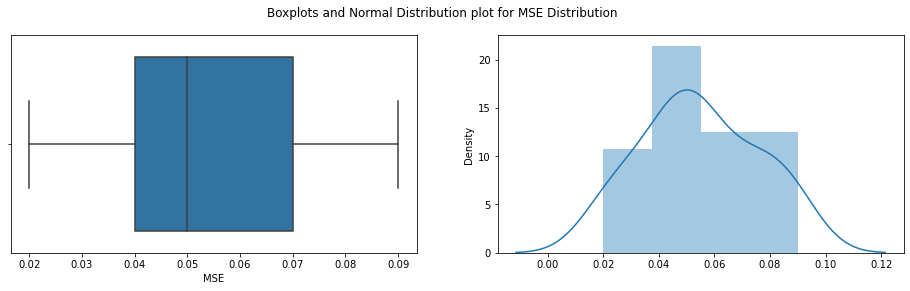

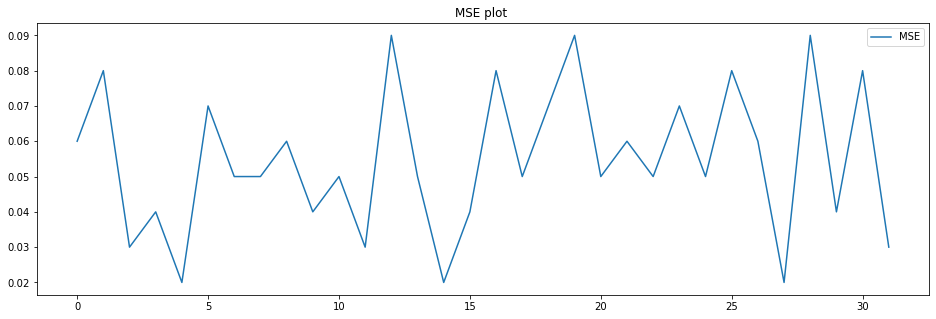


Shapiro_Wilk Test
Statistics=0.974, p=0.6225401163
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.191, p=0.551
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.259
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 6
mean=0.051 ,max=0.092,min=0.013,variance=0.00039


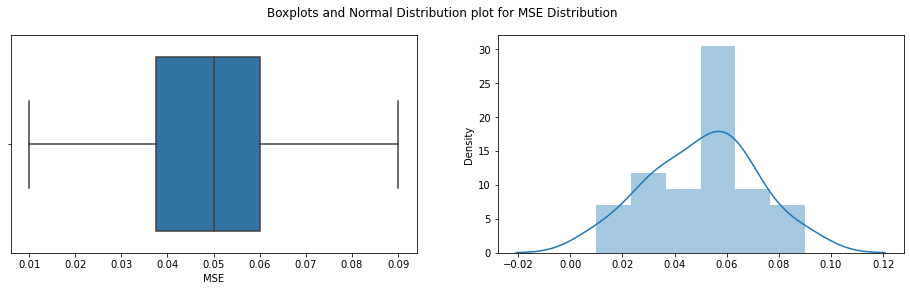

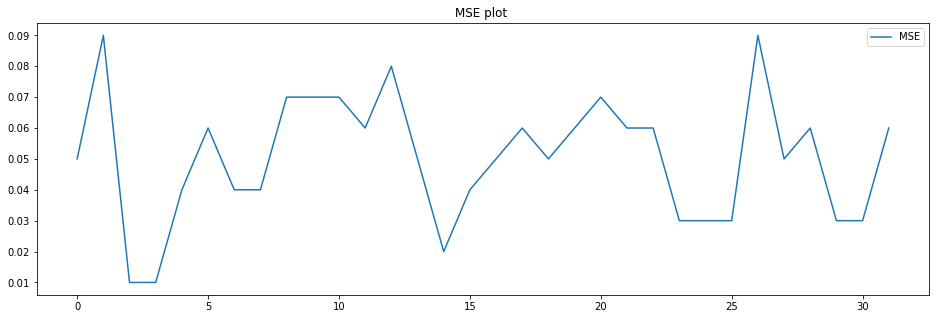


Shapiro_Wilk Test
Statistics=0.980, p=0.8110533953
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.048, p=0.976
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.215
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 7
mean=0.051 ,max=0.083,min=0.009,variance=0.00039


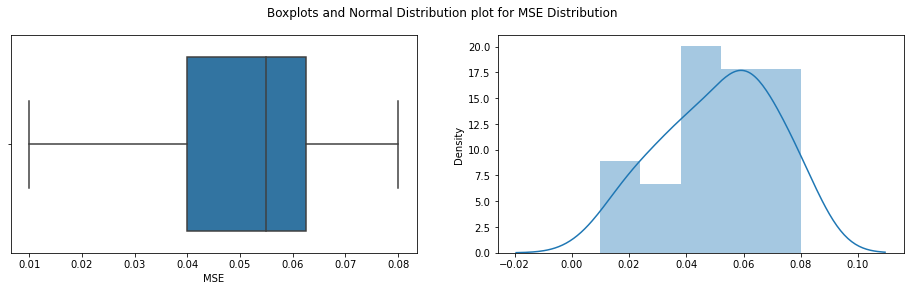

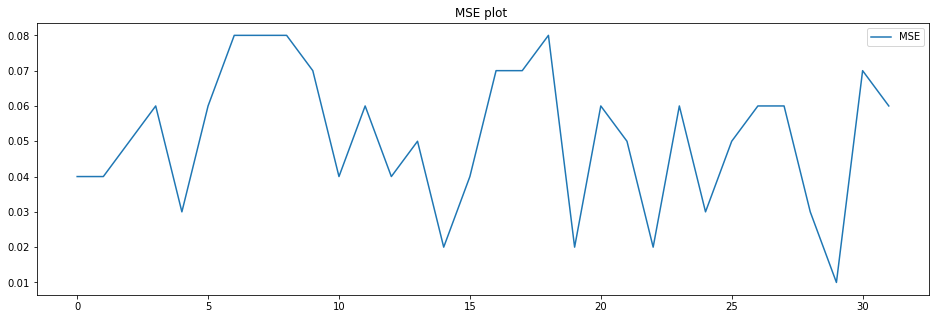


Shapiro_Wilk Test
Statistics=0.963, p=0.3319592476
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.691, p=0.429
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.423
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 8
mean=0.047 ,max=0.118,min=0.014,variance=0.00059


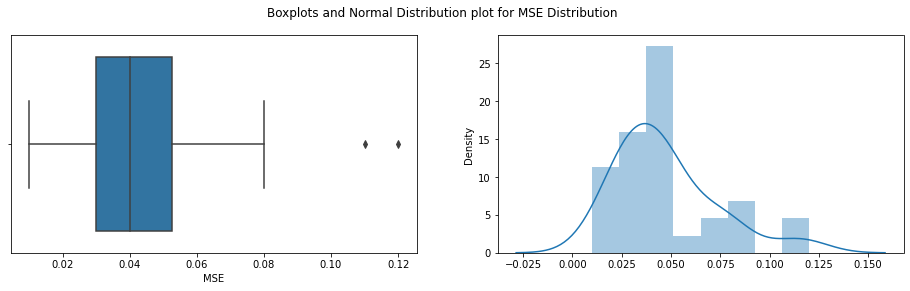

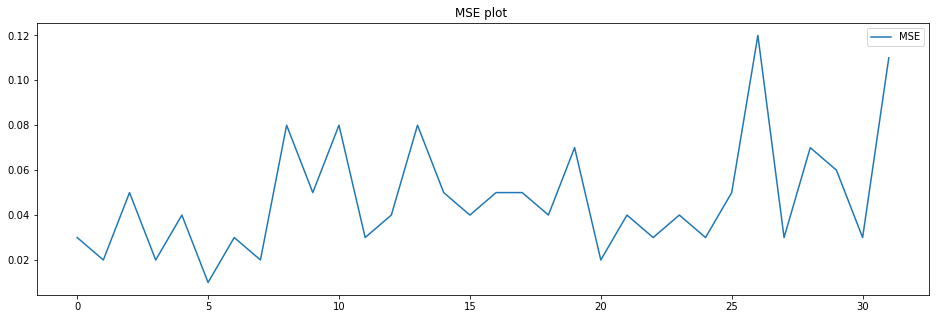


Shapiro_Wilk Test
Statistics=0.903, p=0.0075928592
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=10.143, p=0.006
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.943
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 9
mean=0.051 ,max=0.093,min=0.011,variance=0.00044


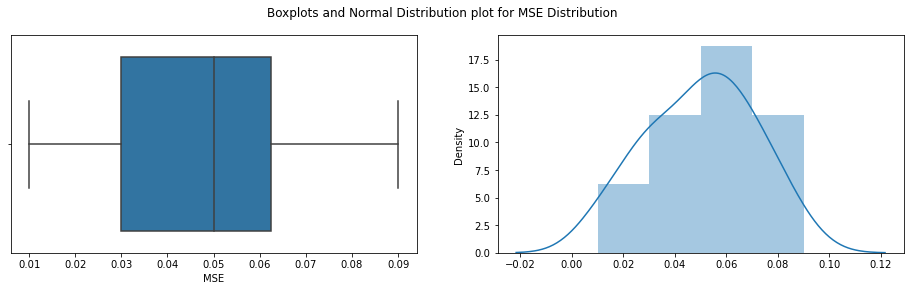

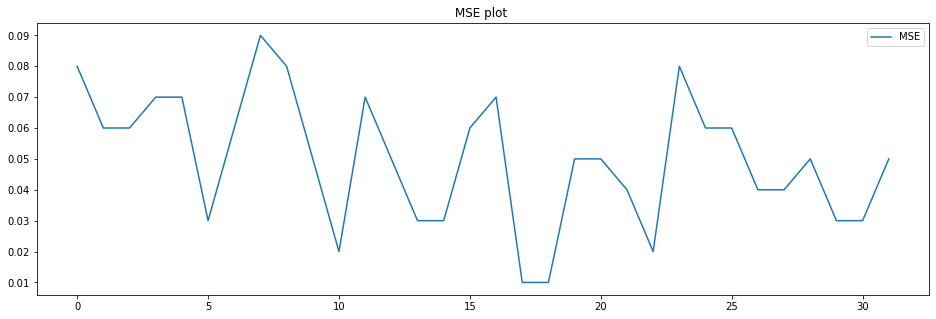


Shapiro_Wilk Test
Statistics=0.977, p=0.7084295750
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.068, p=0.586
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.240
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 10
mean=0.054 ,max=0.126,min=0.019,variance=0.00063


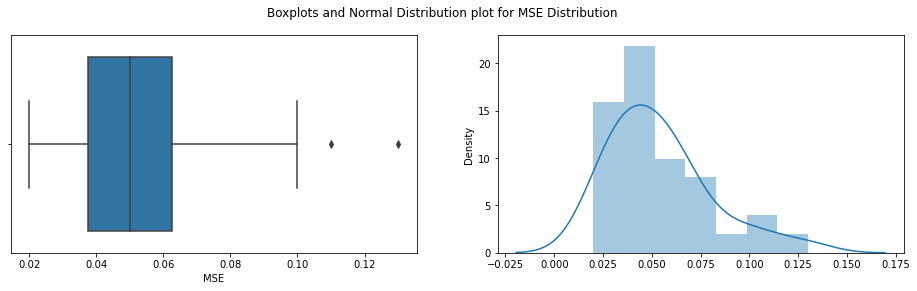

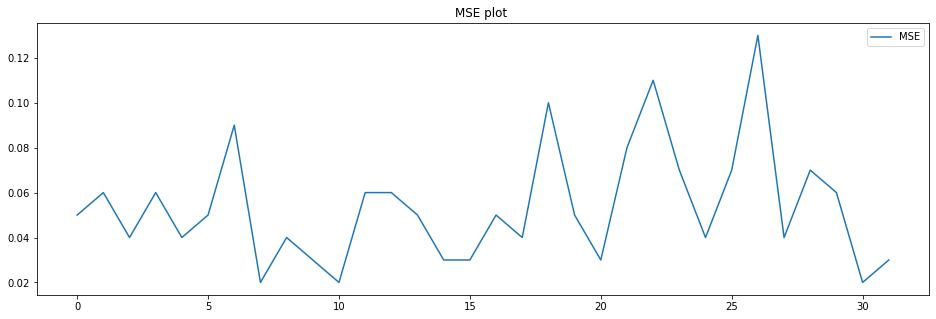


Shapiro_Wilk Test
Statistics=0.901, p=0.0065746200
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=9.551, p=0.008
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.030
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 11
mean=0.052 ,max=0.091,min=0.02,variance=0.00034


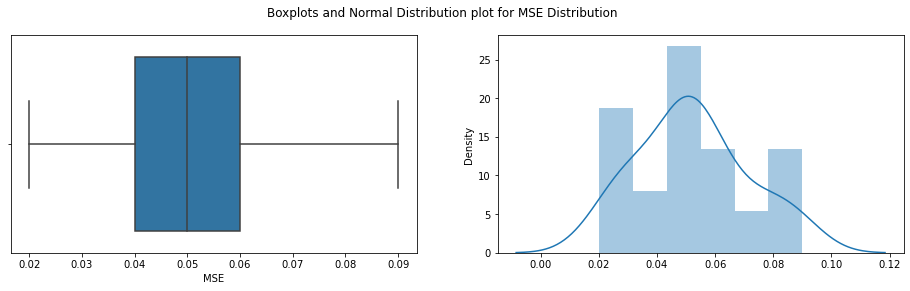

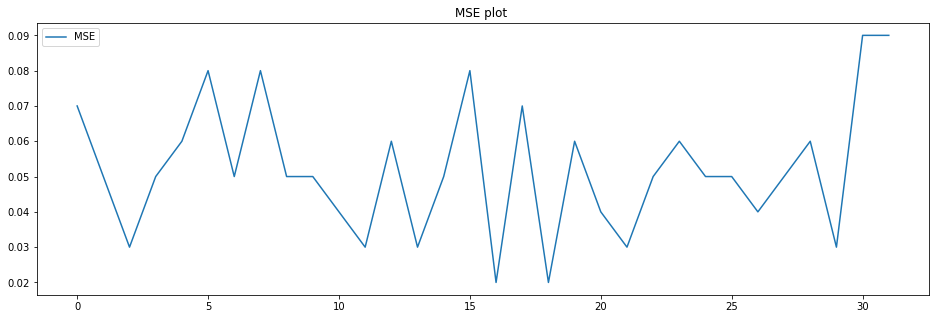


Shapiro_Wilk Test
Statistics=0.958, p=0.2400283515
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.560, p=0.756
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.511
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 12
mean=0.054 ,max=0.123,min=0.015,variance=0.00048


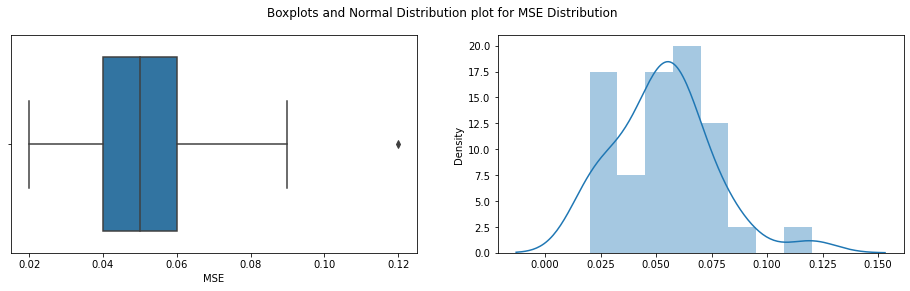

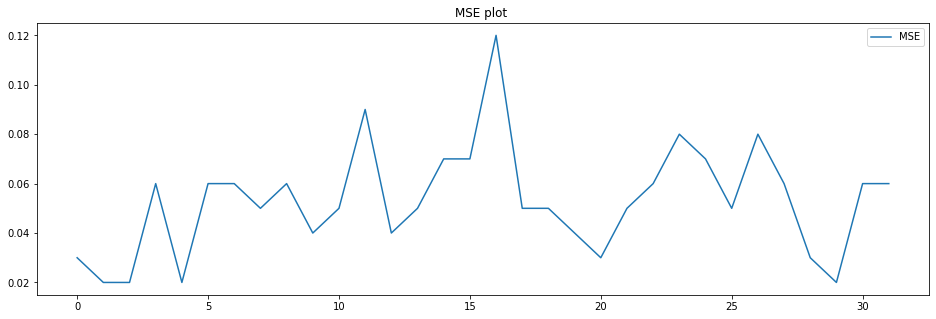


Shapiro_Wilk Test
Statistics=0.951, p=0.1550080627
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=6.612, p=0.037
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.409
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 13
mean=0.051 ,max=0.097,min=0.008,variance=0.00062


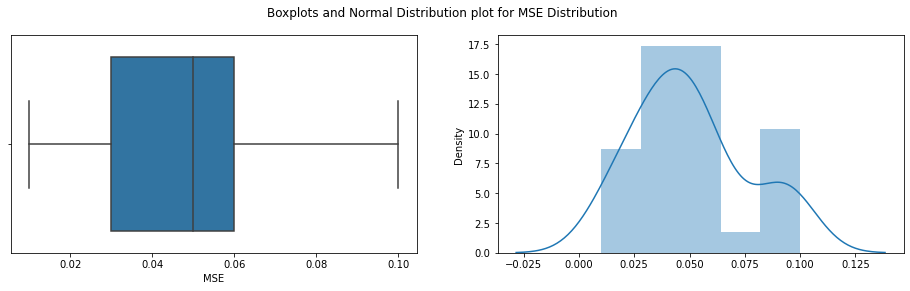

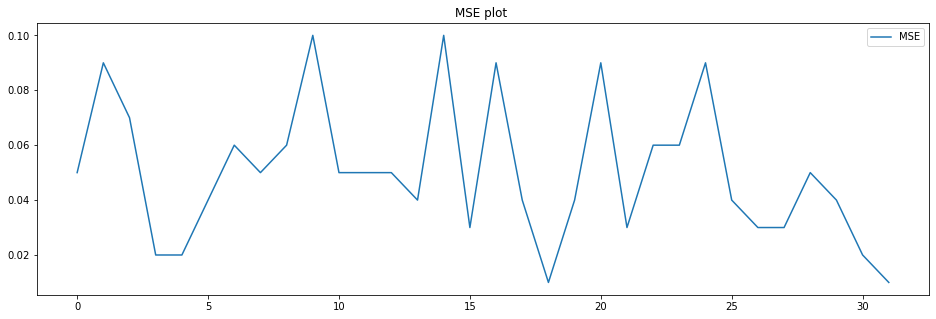


Shapiro_Wilk Test
Statistics=0.935, p=0.0549179316
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.944, p=0.378
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.698
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 14
mean=0.052 ,max=0.099,min=0.021,variance=0.00041


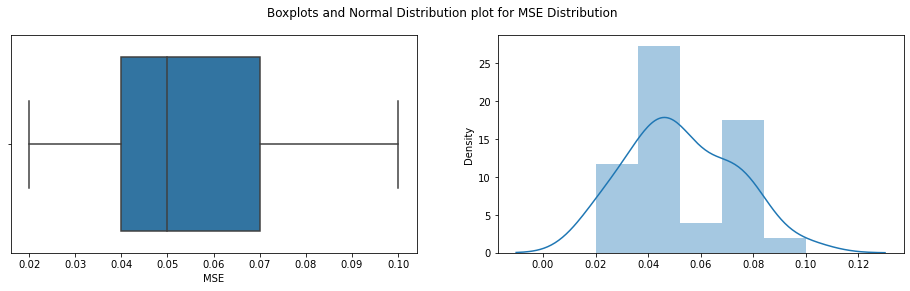

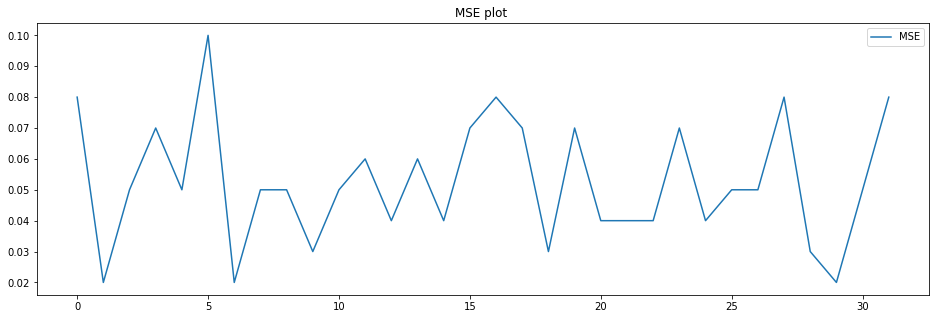


Shapiro_Wilk Test
Statistics=0.964, p=0.3510789275
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.452, p=0.484
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.361
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 15
mean=0.057 ,max=0.096,min=0.015,variance=0.00051


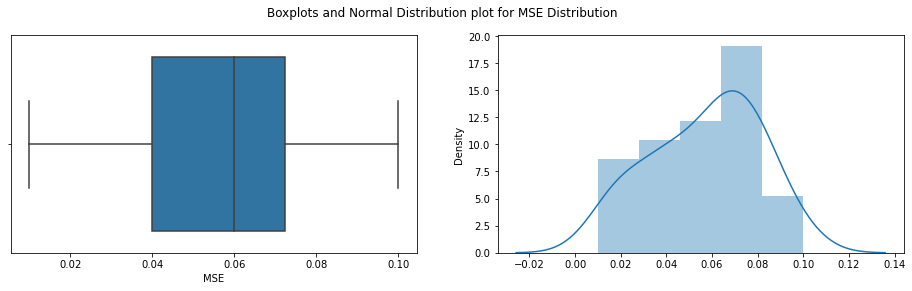

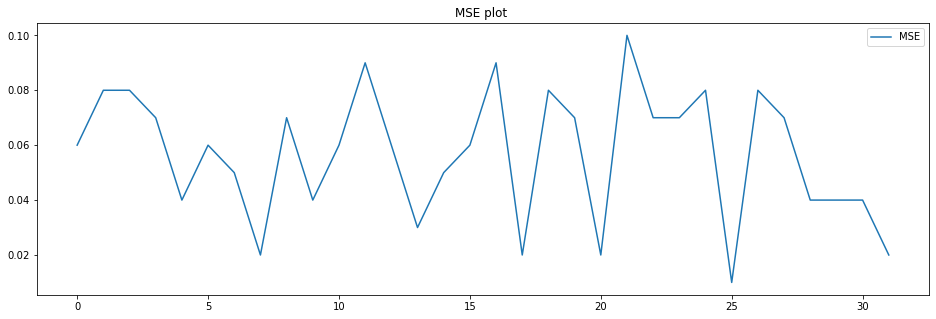


Shapiro_Wilk Test
Statistics=0.958, p=0.2491121590
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.659, p=0.265
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.439
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 16
mean=0.049 ,max=0.114,min=0.019,variance=0.0004


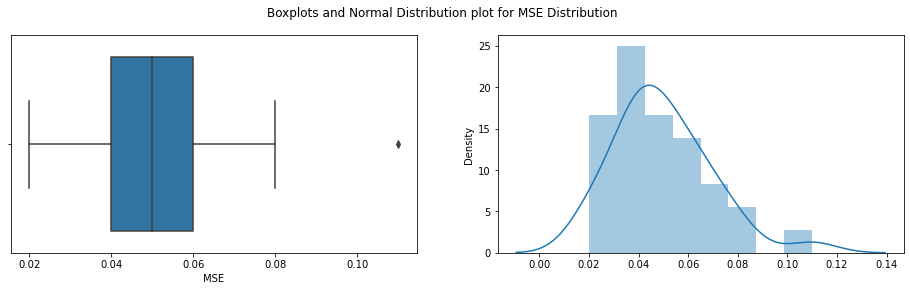

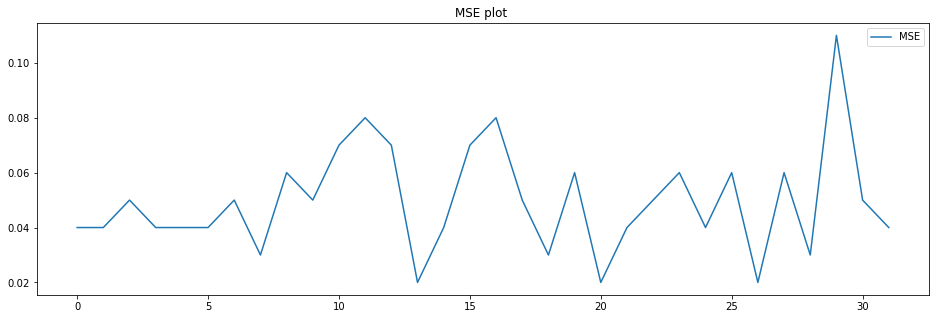


Shapiro_Wilk Test
Statistics=0.929, p=0.0360957049
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=10.352, p=0.006
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.612
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 17
mean=0.054 ,max=0.12,min=0.016,variance=0.00067


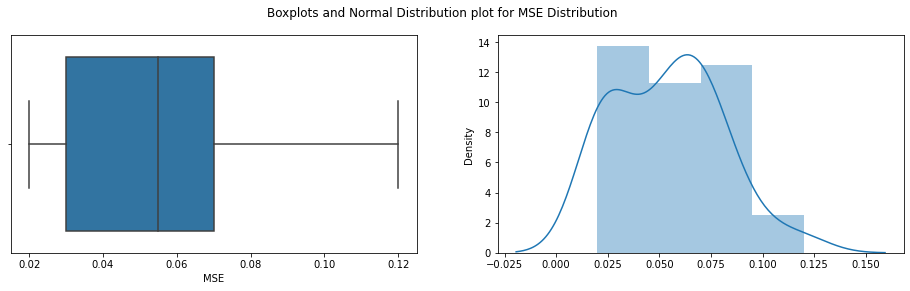

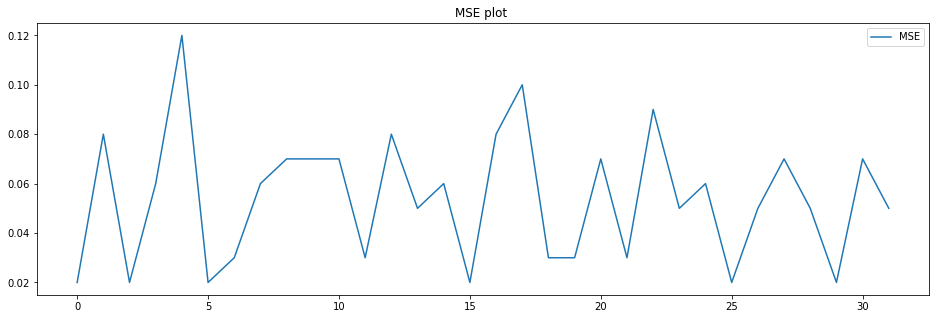


Shapiro_Wilk Test
Statistics=0.950, p=0.1408282667
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.689, p=0.708
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.513
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 18
mean=0.051 ,max=0.099,min=0.017,variance=0.00037


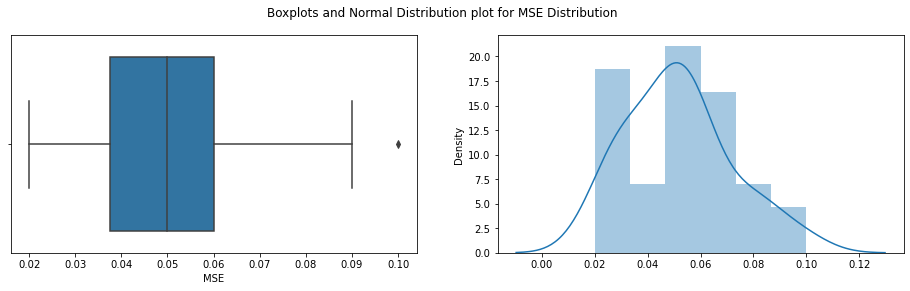

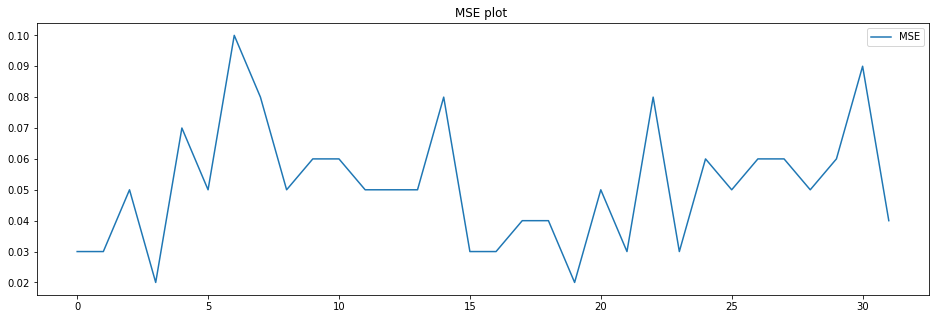


Shapiro_Wilk Test
Statistics=0.976, p=0.6703758836
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.138, p=0.566
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.258
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 19
mean=0.053 ,max=0.099,min=0.012,variance=0.00051


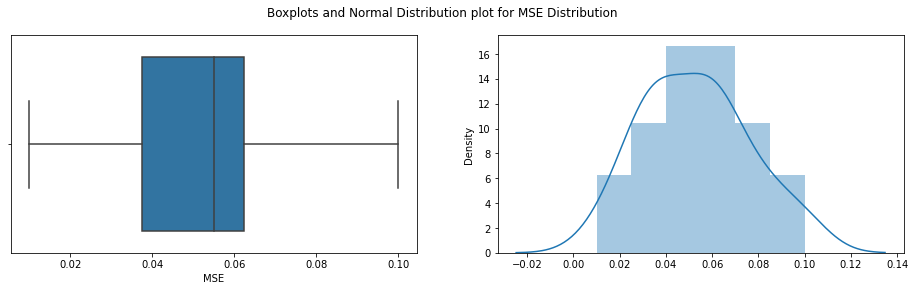

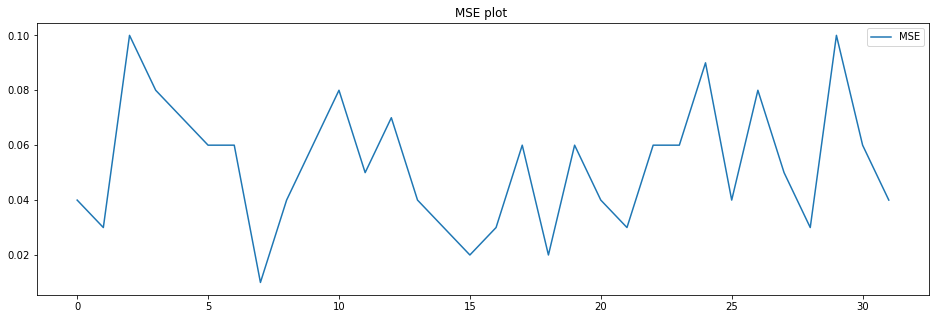


Shapiro_Wilk Test
Statistics=0.974, p=0.6146641970
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.725, p=0.696
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.286
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 20
mean=0.052 ,max=0.151,min=0.01,variance=0.00065


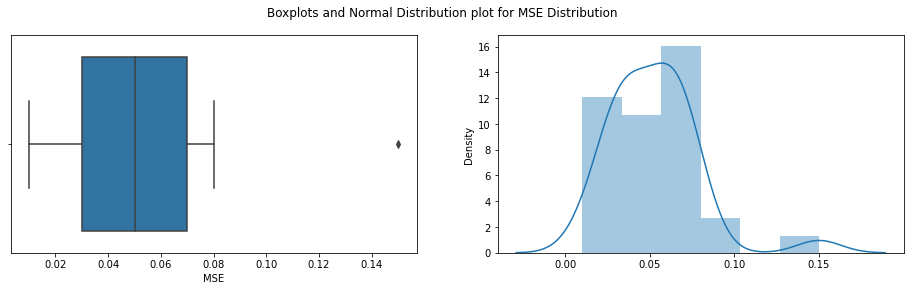

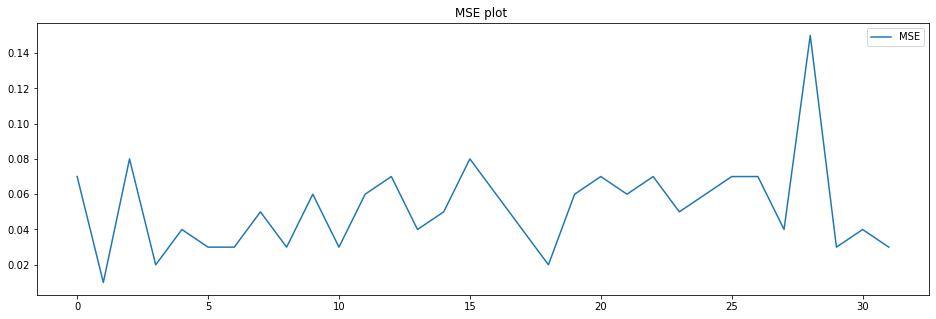


Shapiro_Wilk Test
Statistics=0.870, p=0.0011412911
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=22.822, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.757
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 21
mean=0.048 ,max=0.075,min=0.013,variance=0.00027


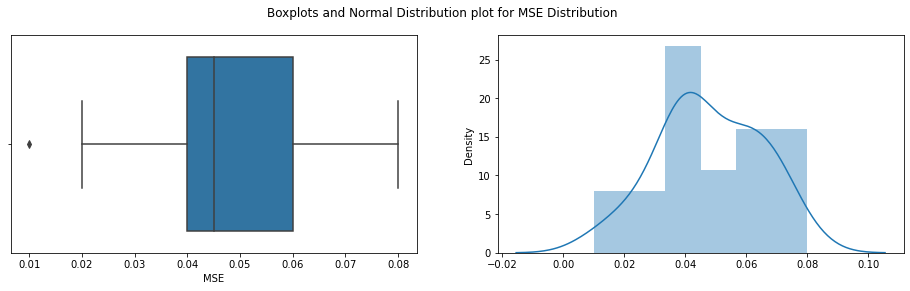

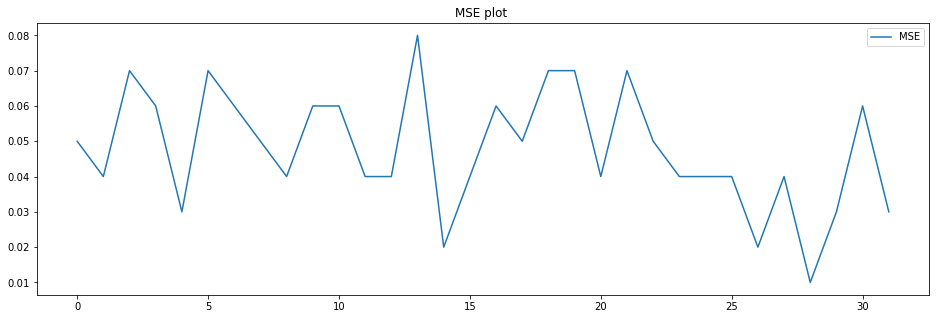


Shapiro_Wilk Test
Statistics=0.970, p=0.5042355657
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.468, p=0.480
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.315
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 22
mean=0.058 ,max=0.124,min=0.018,variance=0.00053


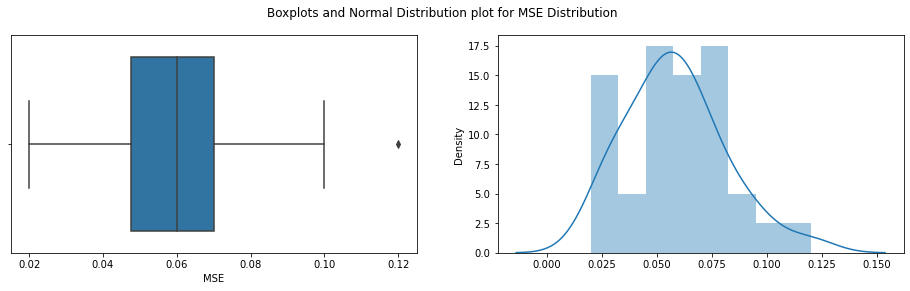

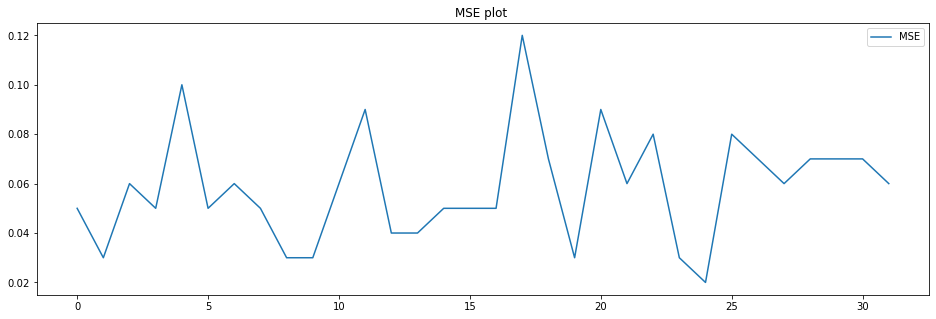


Shapiro_Wilk Test
Statistics=0.962, p=0.3183331192
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.272, p=0.118
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.357
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 23
mean=0.053 ,max=0.095,min=0.015,variance=0.0003


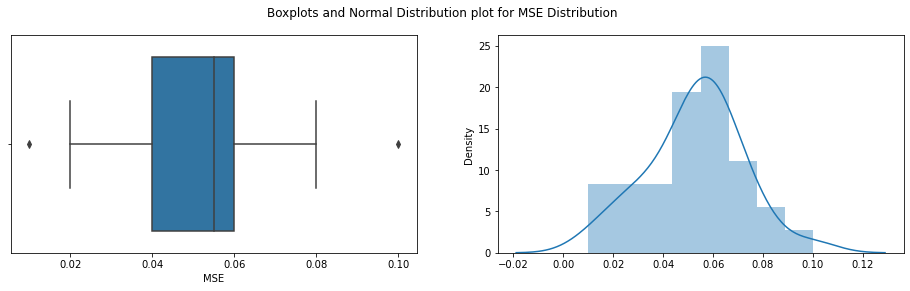

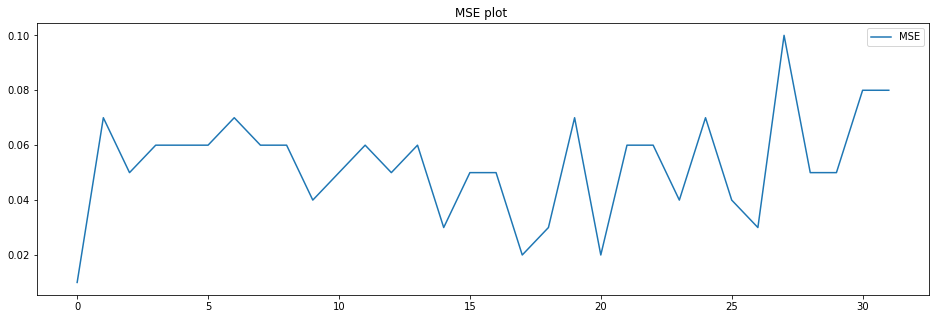


Shapiro_Wilk Test
Statistics=0.986, p=0.9483920336
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.265, p=0.876
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.228
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 24
mean=0.052 ,max=0.087,min=0.022,variance=0.0004


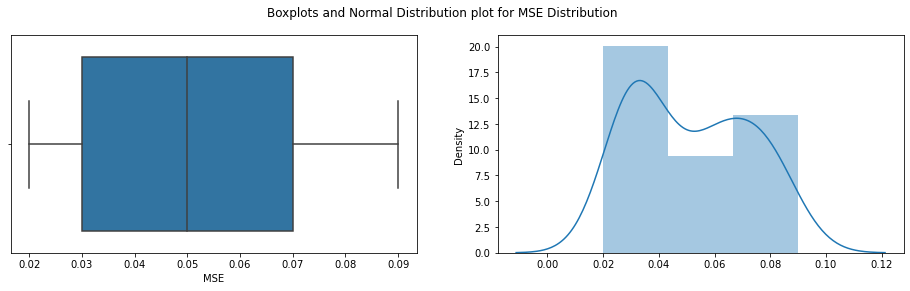

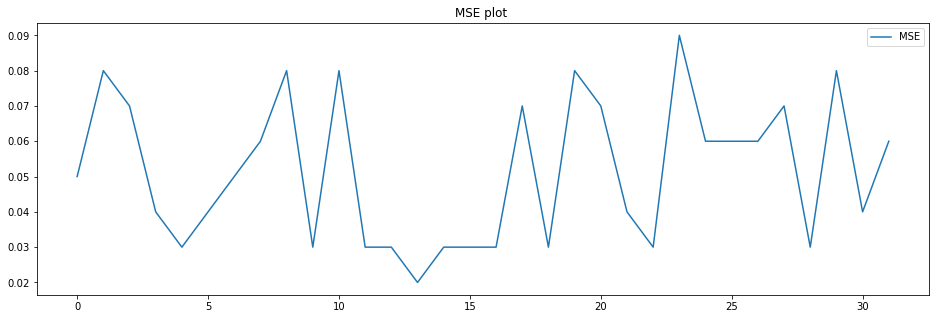


Shapiro_Wilk Test
Statistics=0.900, p=0.0060550175
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=15.788, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.242
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 25
mean=0.056 ,max=0.097,min=0.015,variance=0.0004


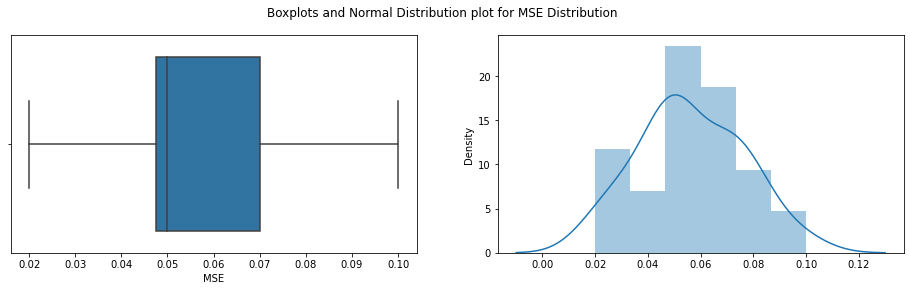

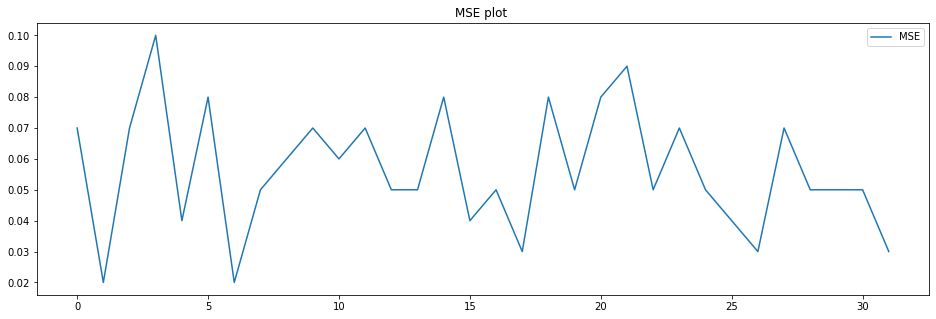


Shapiro_Wilk Test
Statistics=0.979, p=0.7805694938
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.676, p=0.713
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.311
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 26
mean=0.047 ,max=0.083,min=0.018,variance=0.00025


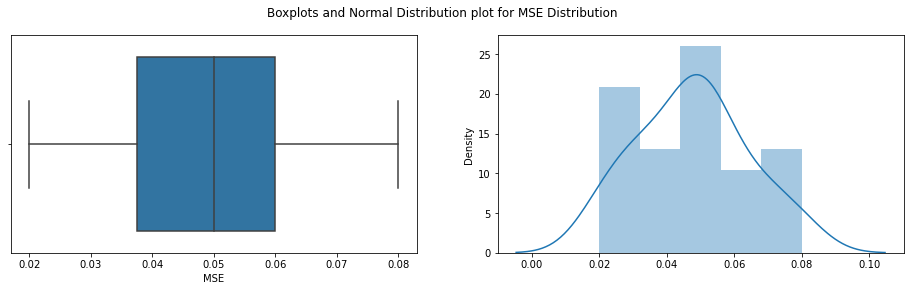

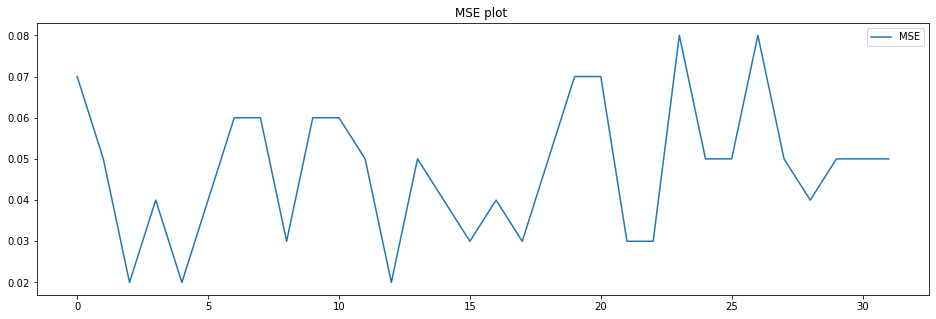


Shapiro_Wilk Test
Statistics=0.979, p=0.7778373957
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.761, p=0.684
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.238
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 27
mean=0.059 ,max=0.122,min=0.024,variance=0.00074


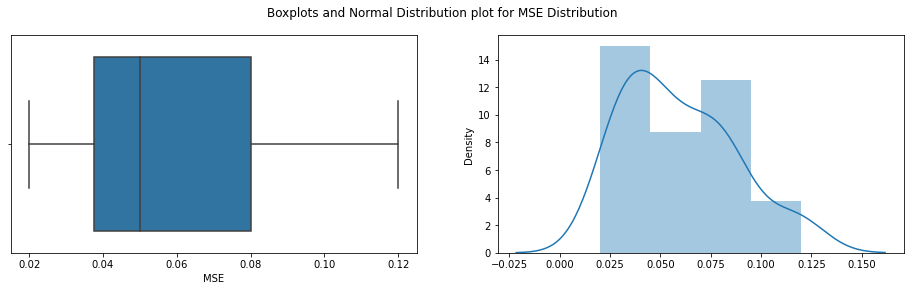

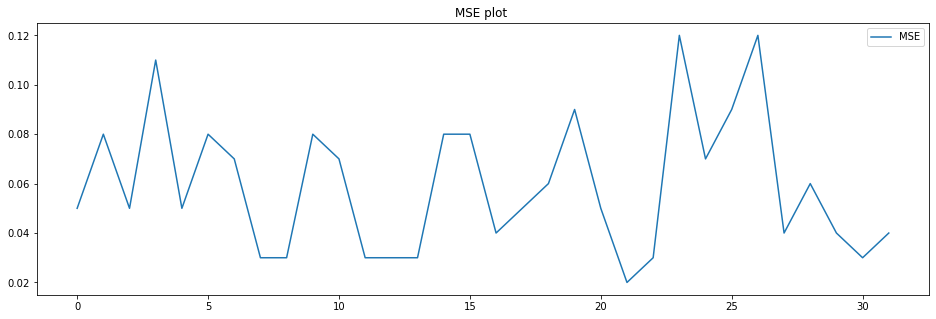


Shapiro_Wilk Test
Statistics=0.932, p=0.0437343083
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=2.556, p=0.279
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.611
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 28
mean=0.056 ,max=0.11,min=0.023,variance=0.00045


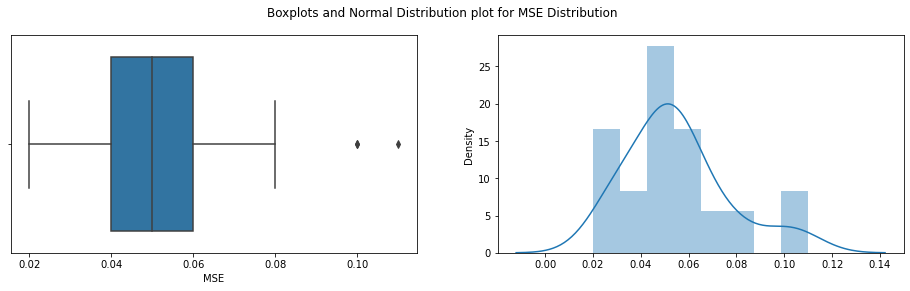

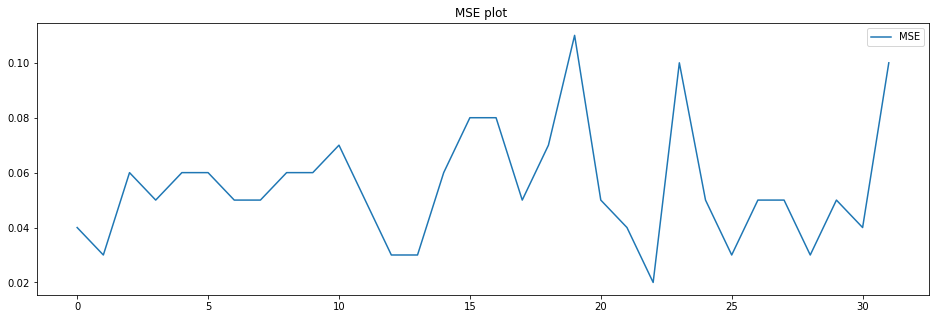


Shapiro_Wilk Test
Statistics=0.928, p=0.0335196815
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=5.438, p=0.066
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.713
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 29
mean=0.055 ,max=0.104,min=0.017,variance=0.00049


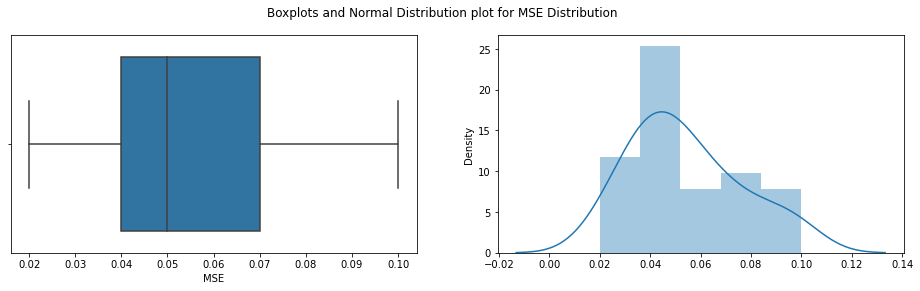

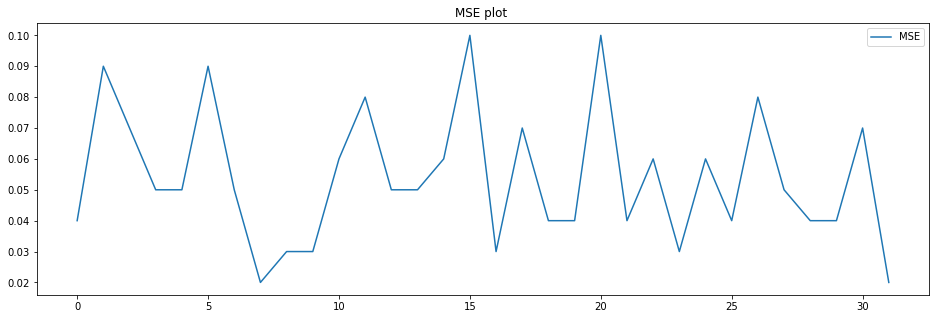


Shapiro_Wilk Test
Statistics=0.957, p=0.2216368020
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.969, p=0.374
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.502
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 30
mean=0.054 ,max=0.105,min=0.012,variance=0.00064


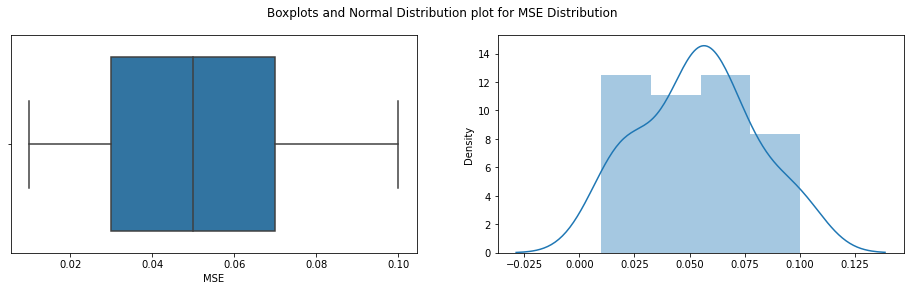

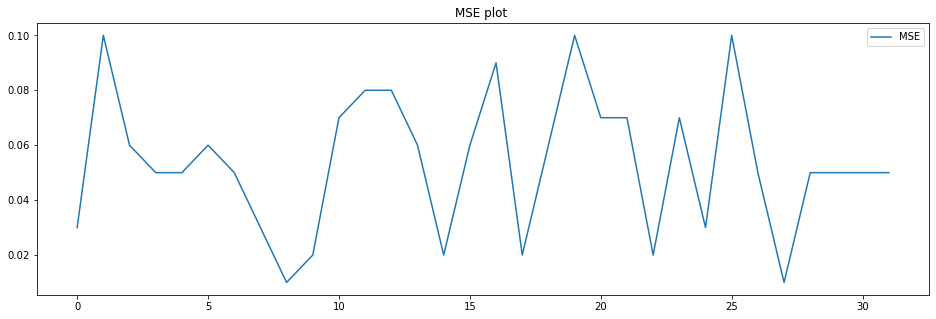


Shapiro_Wilk Test
Statistics=0.964, p=0.3534492254
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.987, p=0.610
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.348
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 31
mean=0.052 ,max=0.089,min=0.008,variance=0.0004


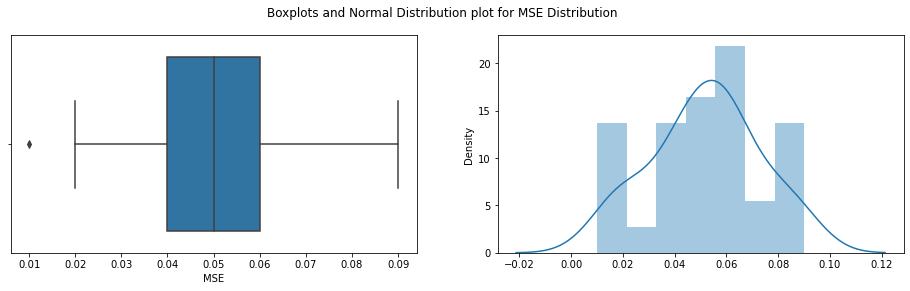

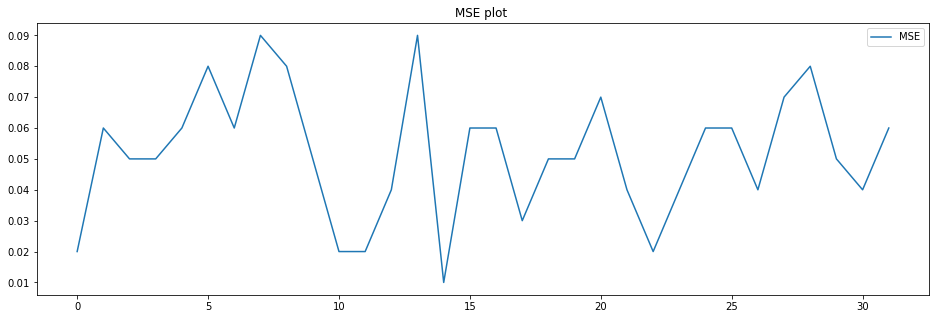


Shapiro_Wilk Test
Statistics=0.964, p=0.3558449745
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.453, p=0.797
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.467
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 32
mean=0.06 ,max=0.104,min=0.012,variance=0.00044


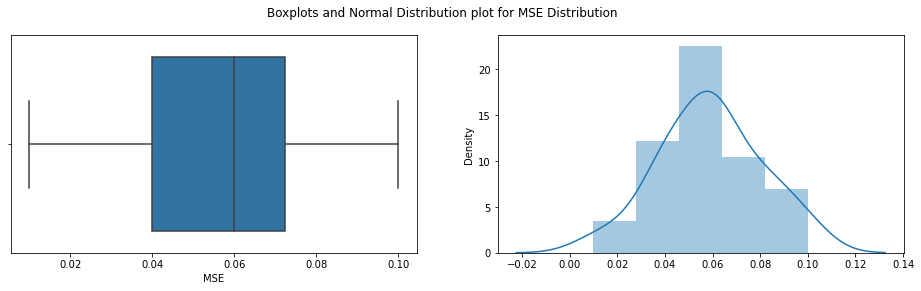

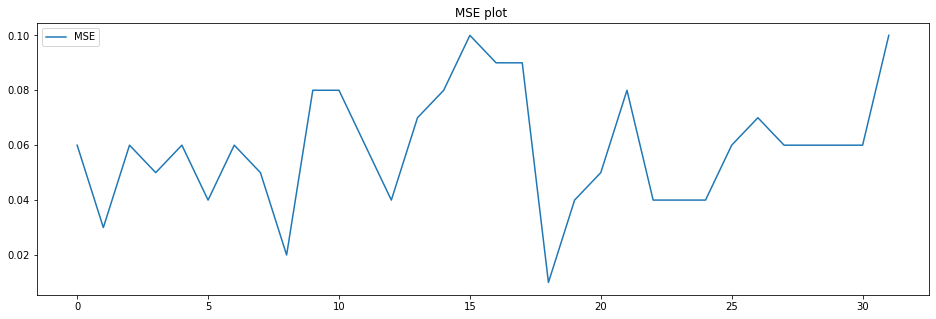


Shapiro_Wilk Test
Statistics=0.988, p=0.9666296244
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.015, p=0.992
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.184
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 33
mean=0.047 ,max=0.105,min=0.008,variance=0.00041


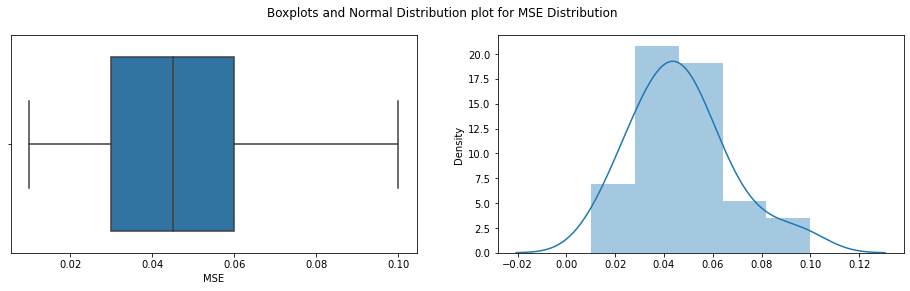

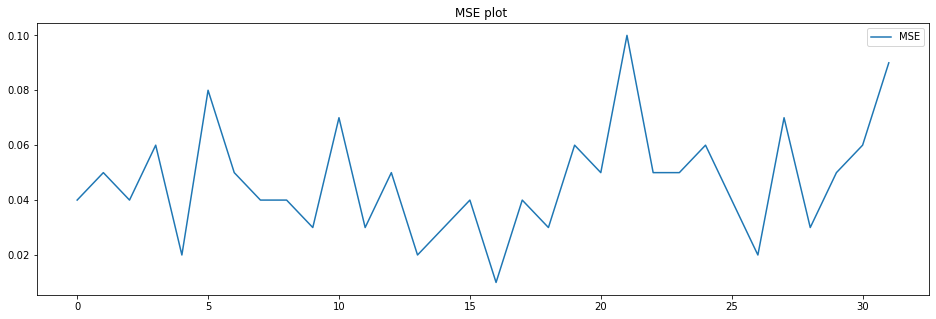


Shapiro_Wilk Test
Statistics=0.965, p=0.3735542297
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.338, p=0.114
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.399
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 34
mean=0.049 ,max=0.095,min=0.019,variance=0.0006


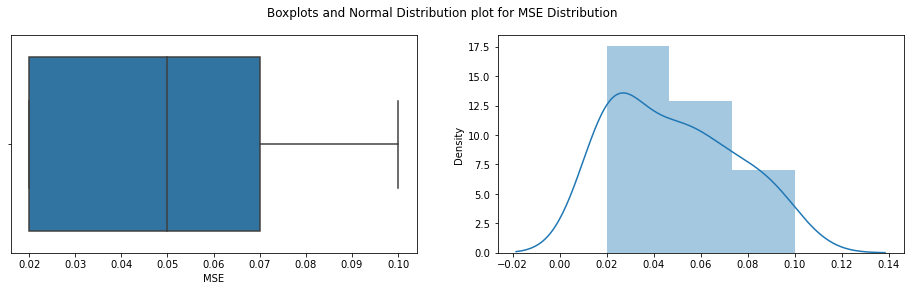

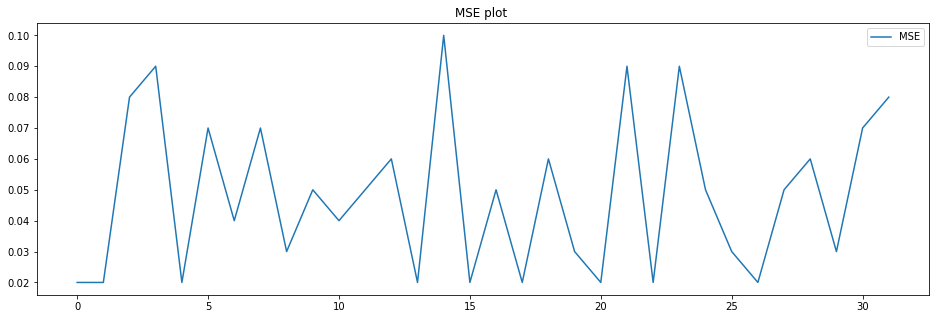


Shapiro_Wilk Test
Statistics=0.901, p=0.0064699943
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=6.785, p=0.034
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.036
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 35
mean=0.057 ,max=0.107,min=0.021,variance=0.00048


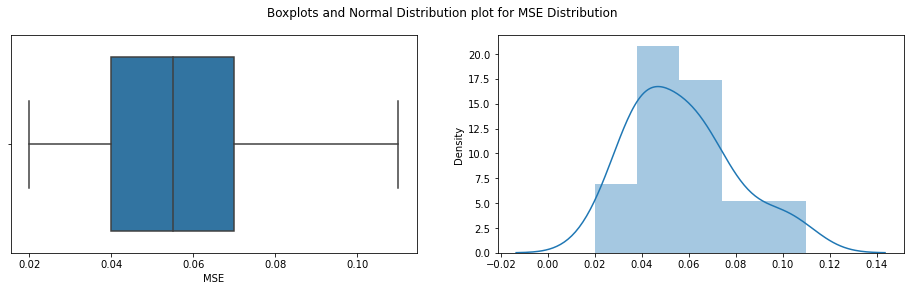

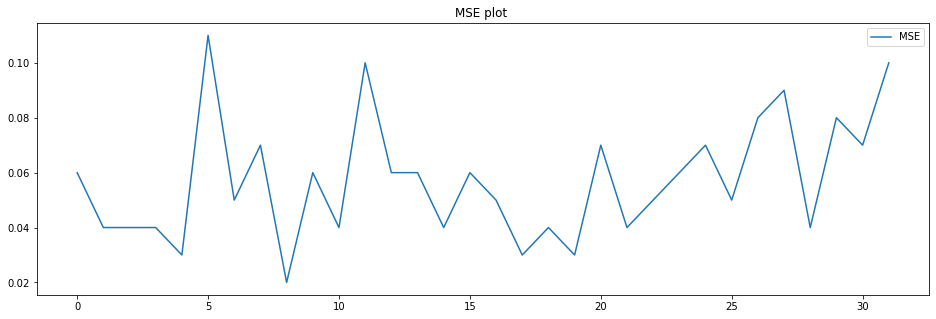


Shapiro_Wilk Test
Statistics=0.945, p=0.1045350954
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.885, p=0.236
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.596
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 36
mean=0.049 ,max=0.101,min=0.009,variance=0.00047


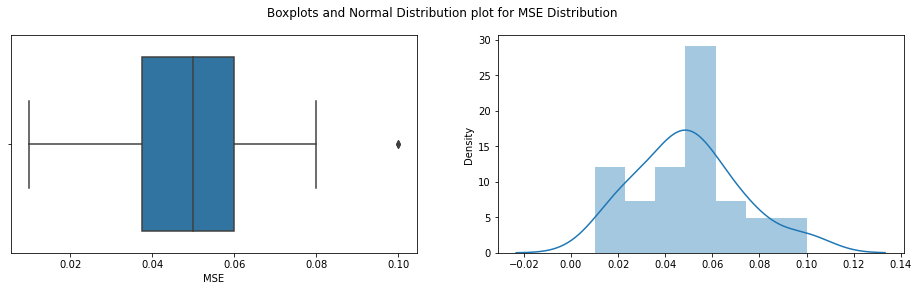

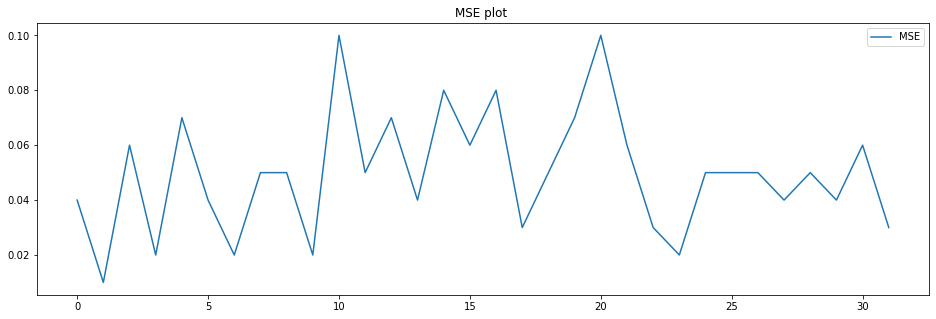


Shapiro_Wilk Test
Statistics=0.972, p=0.5548328757
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.654, p=0.437
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.265
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 37
mean=0.051 ,max=0.097,min=0.019,variance=0.00041


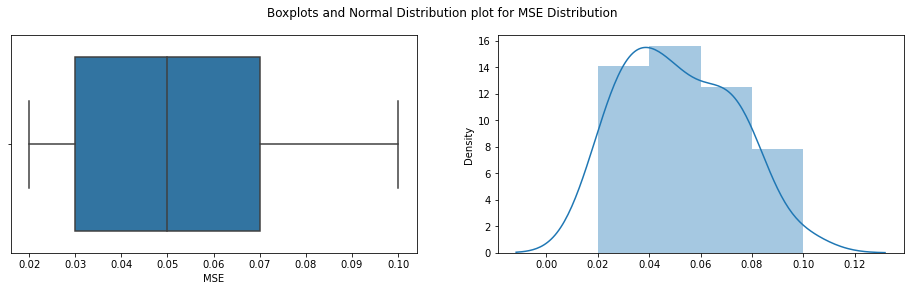

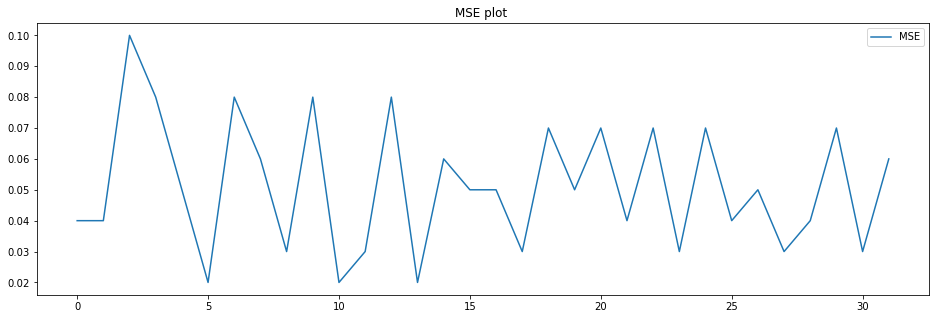


Shapiro_Wilk Test
Statistics=0.951, p=0.1581262052
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.544, p=0.280
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.565
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 38
mean=0.049 ,max=0.107,min=0.021,variance=0.00037


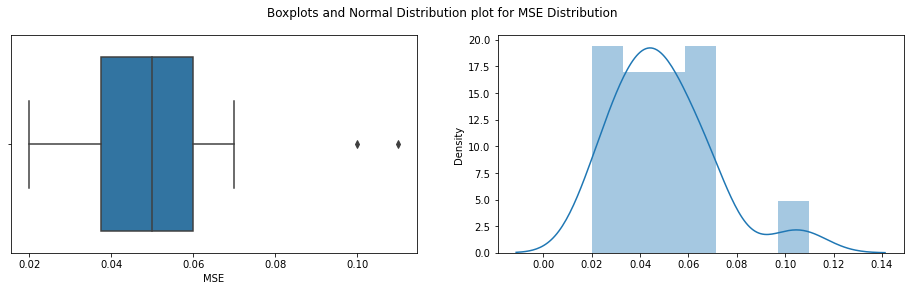

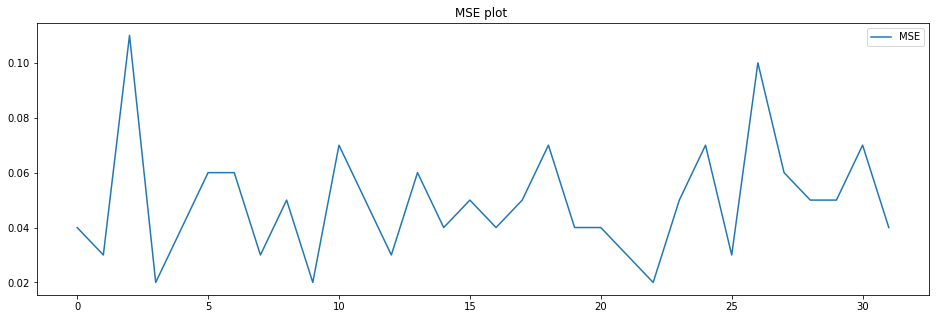


Shapiro_Wilk Test
Statistics=0.924, p=0.0271328967
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=9.118, p=0.010
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.554
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 39
mean=0.052 ,max=0.085,min=0.027,variance=0.00029


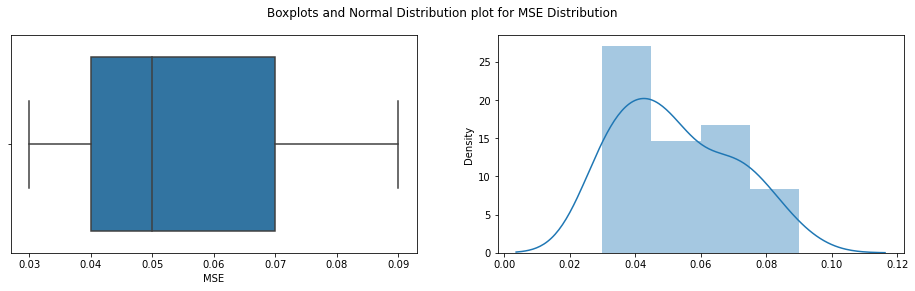

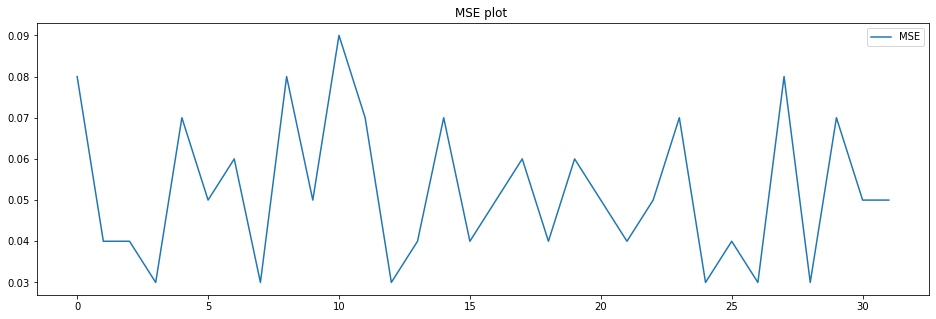


Shapiro_Wilk Test
Statistics=0.940, p=0.0749941841
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.029, p=0.133
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.653
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 40
mean=0.049 ,max=0.104,min=0.015,variance=0.00041


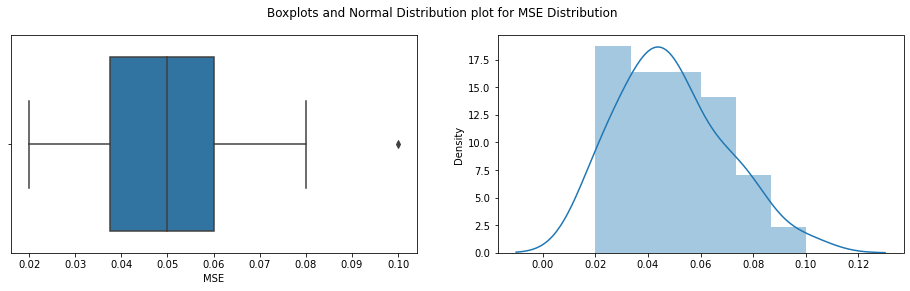

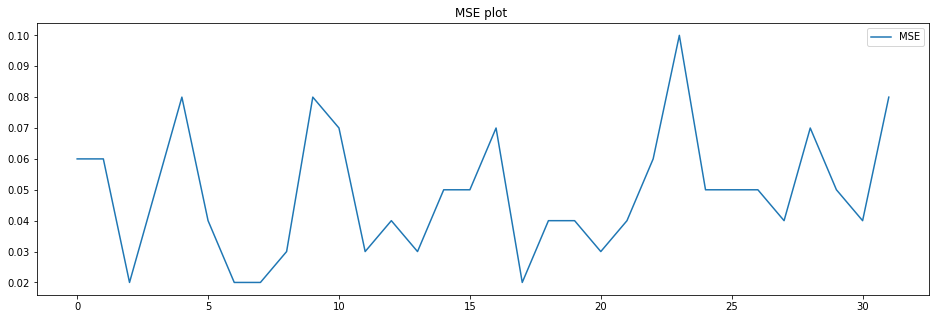


Shapiro_Wilk Test
Statistics=0.972, p=0.5522205830
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.357, p=0.308
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.257
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 41
mean=0.054 ,max=0.1,min=0.019,variance=0.00049


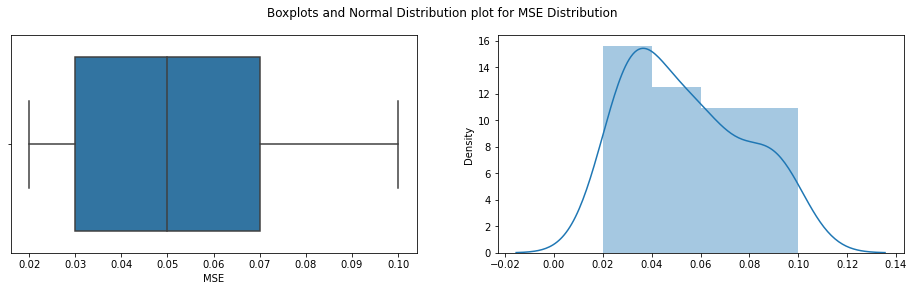

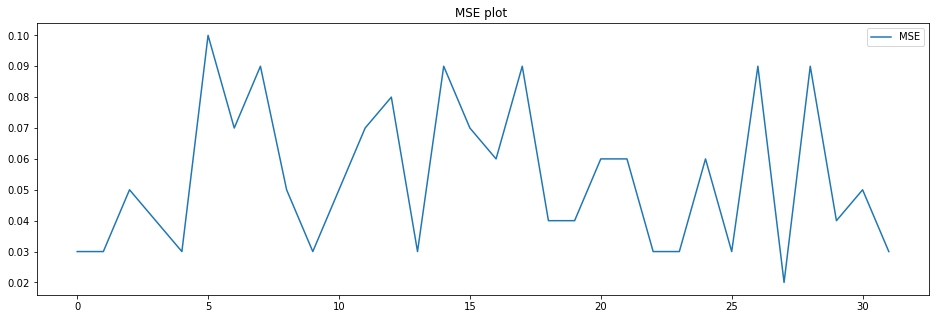


Shapiro_Wilk Test
Statistics=0.927, p=0.0326592699
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=4.653, p=0.098
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.855
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 42
mean=0.047 ,max=0.087,min=0.022,variance=0.00028


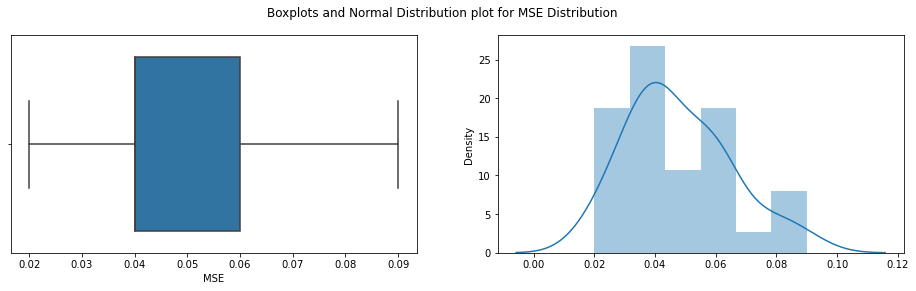

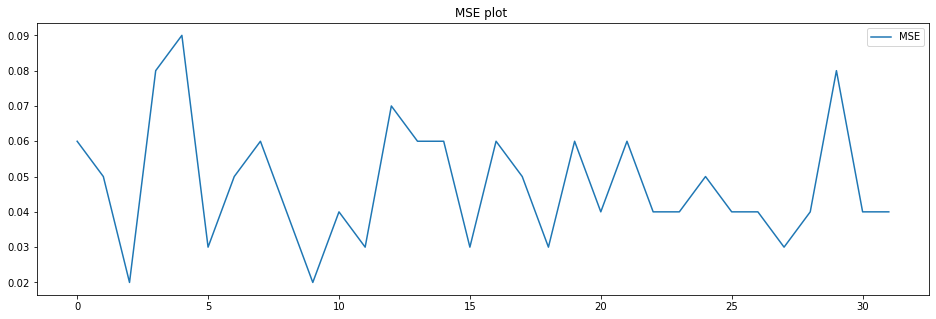


Shapiro_Wilk Test
Statistics=0.944, p=0.0999073461
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.253, p=0.197
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.548
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 43
mean=0.056 ,max=0.095,min=0.021,variance=0.00036


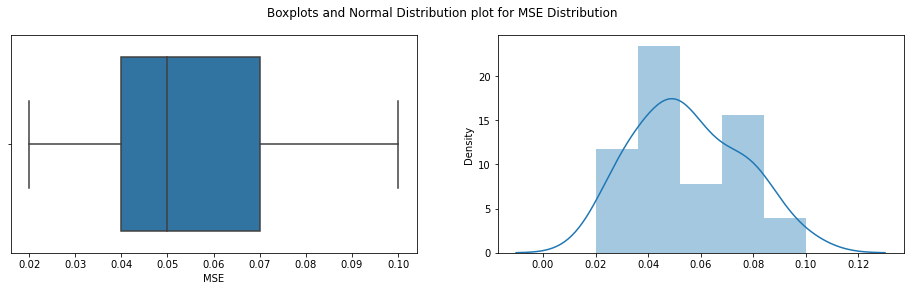

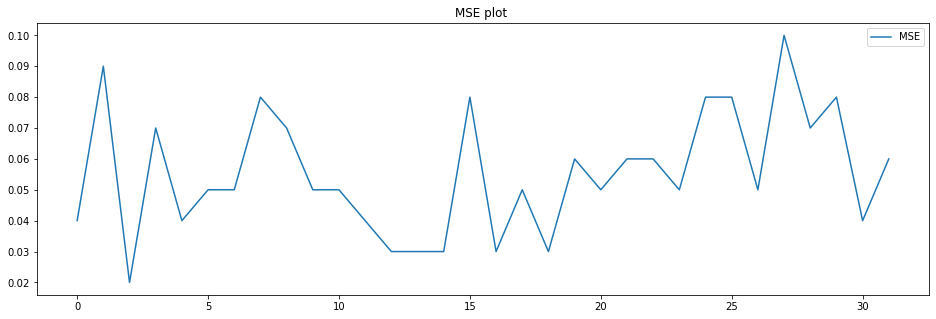


Shapiro_Wilk Test
Statistics=0.974, p=0.6052305102
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.606, p=0.448
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.321
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 44
mean=0.054 ,max=0.102,min=0.01,variance=0.00038


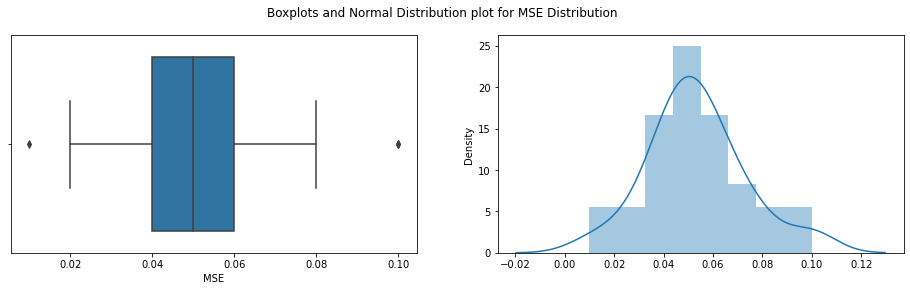

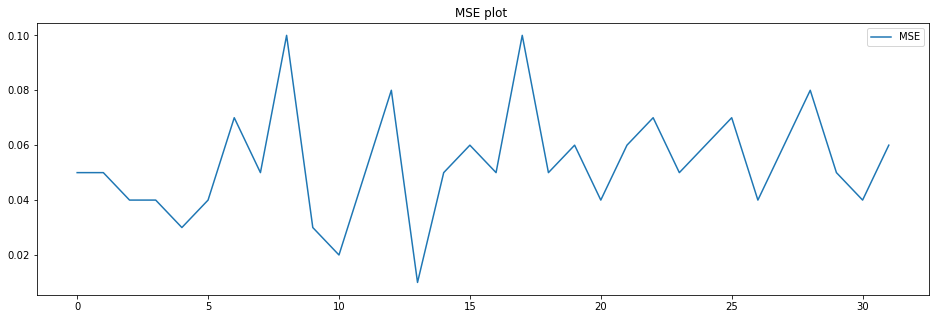


Shapiro_Wilk Test
Statistics=0.969, p=0.4725300670
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.611, p=0.271
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.415
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 45
mean=0.058 ,max=0.099,min=0.022,variance=0.00036


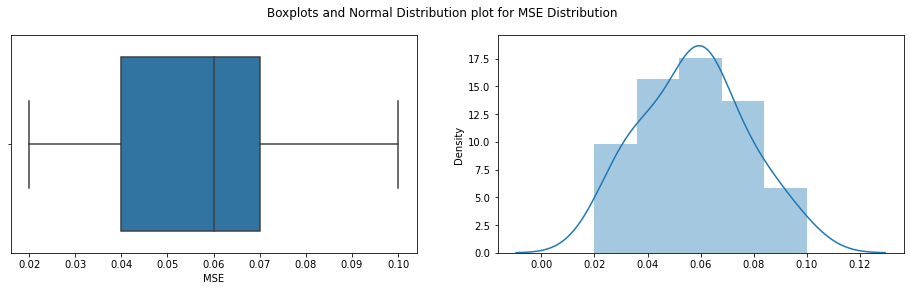

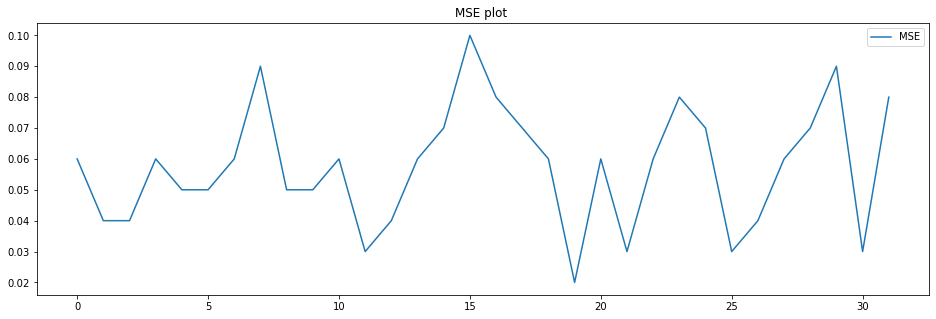


Shapiro_Wilk Test
Statistics=0.979, p=0.7550107837
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.469, p=0.791
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.234
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 46
mean=0.051 ,max=0.097,min=0.018,variance=0.00043


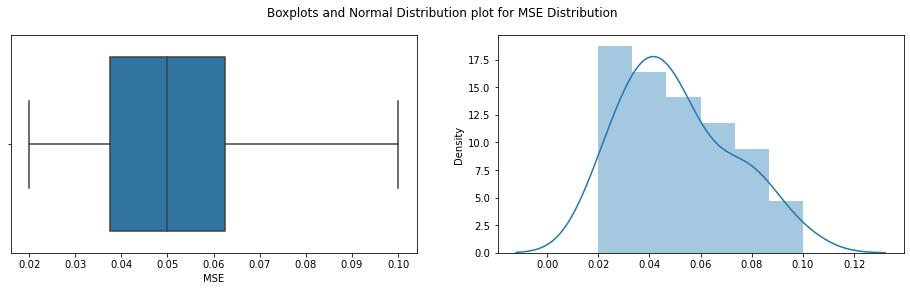

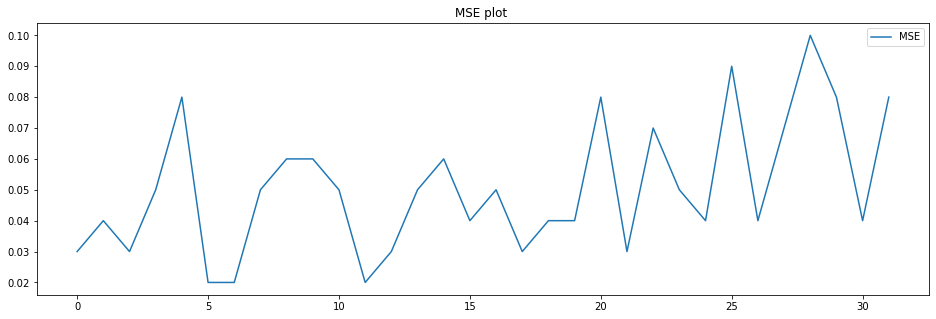


Shapiro_Wilk Test
Statistics=0.958, p=0.2387622148
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.936, p=0.380
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.452
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 47
mean=0.057 ,max=0.116,min=0.024,variance=0.00056


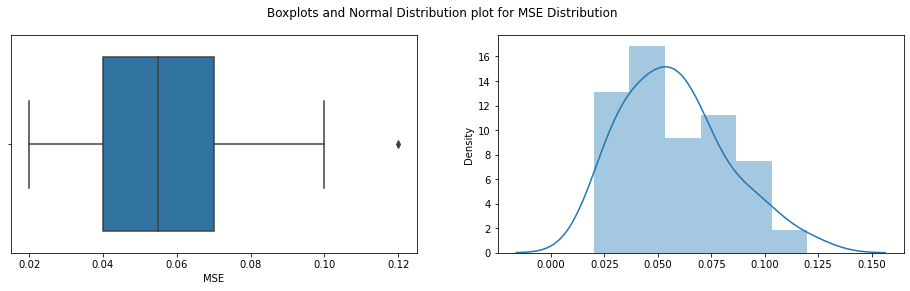

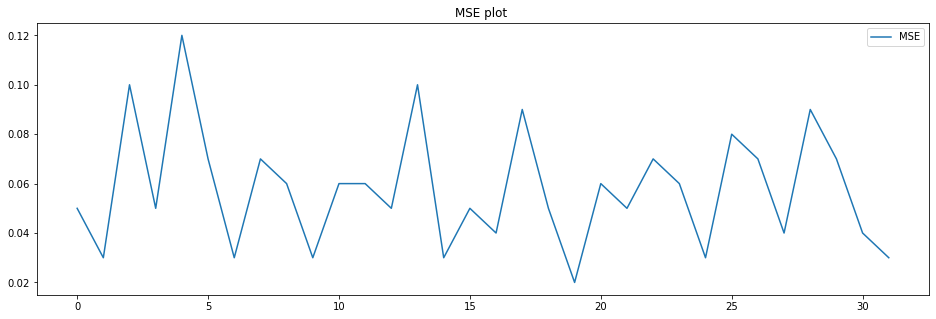


Shapiro_Wilk Test
Statistics=0.950, p=0.1395954639
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.994, p=0.369
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.450
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 48
mean=0.053 ,max=0.098,min=0.022,variance=0.00041


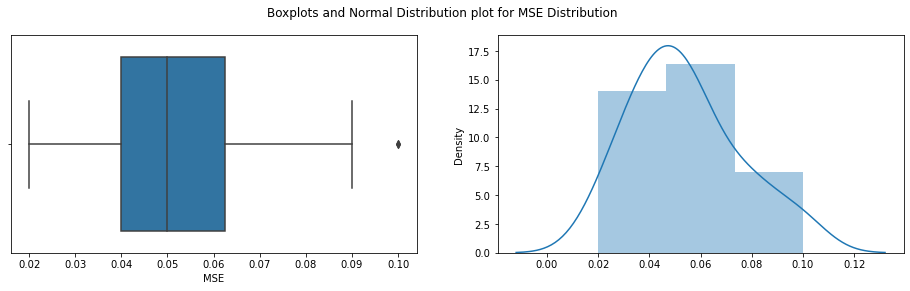

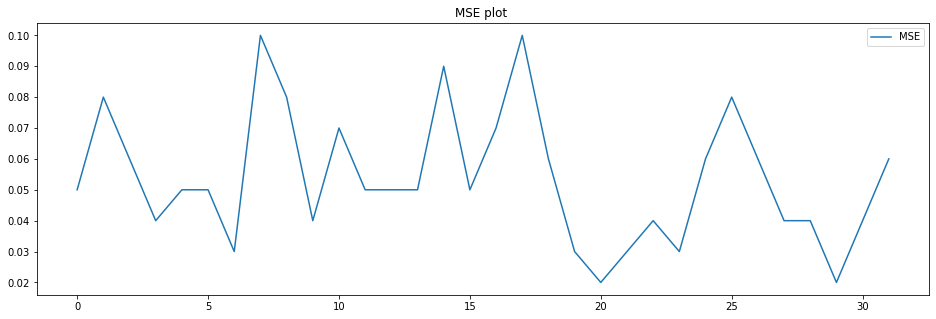


Shapiro_Wilk Test
Statistics=0.946, p=0.1128709018
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.562, p=0.278
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.533
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 49
mean=0.049 ,max=0.123,min=0.024,variance=0.00038


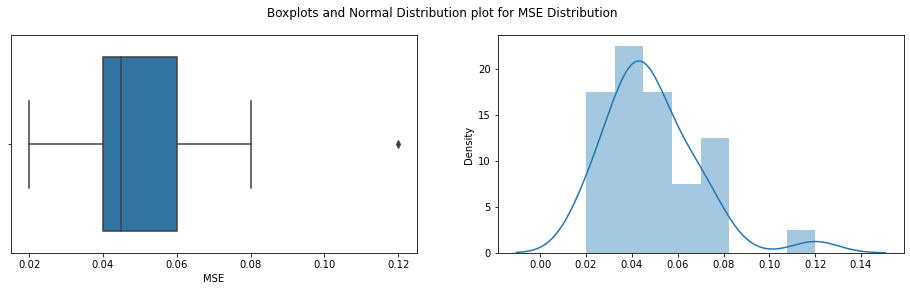

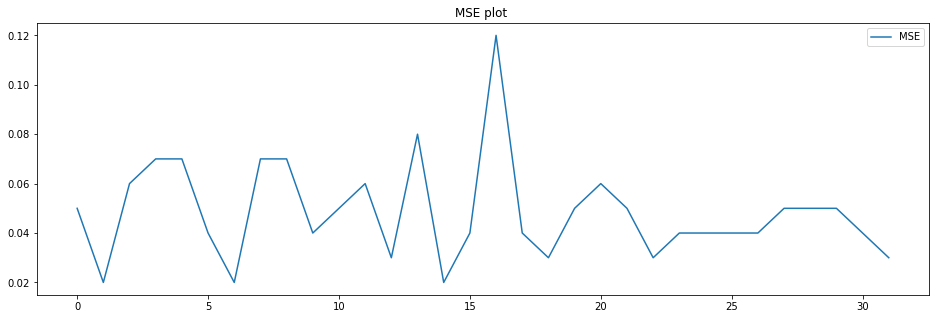


Shapiro_Wilk Test
Statistics=0.868, p=0.0010457829
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=22.672, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.823
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 50
mean=0.05 ,max=0.117,min=0.02,variance=0.0005


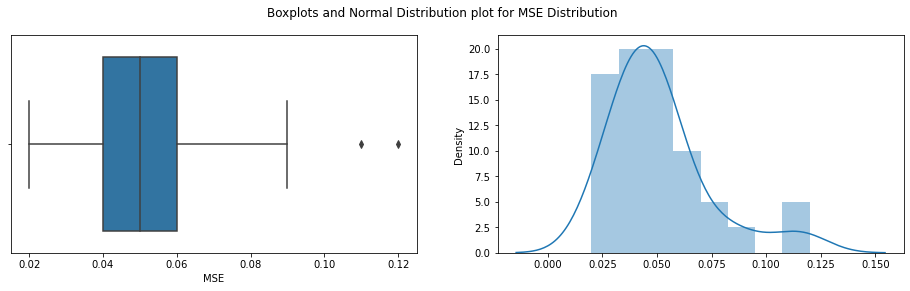

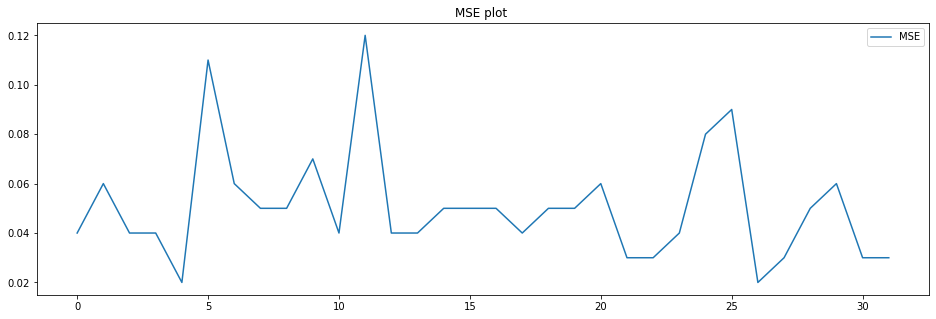


Shapiro_Wilk Test
Statistics=0.867, p=0.0009930212
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=14.314, p=0.001
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.401
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 51
mean=0.059 ,max=0.096,min=0.019,variance=0.00044


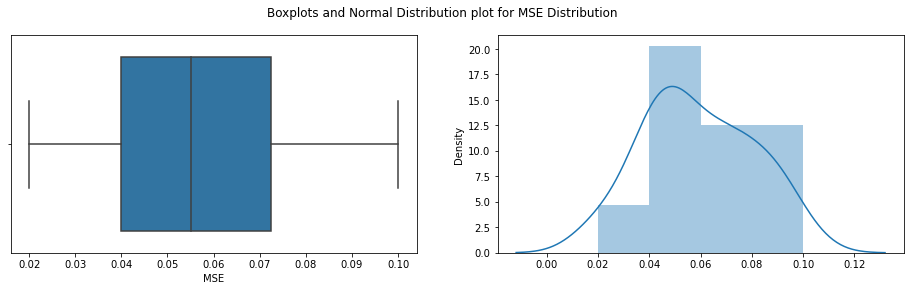

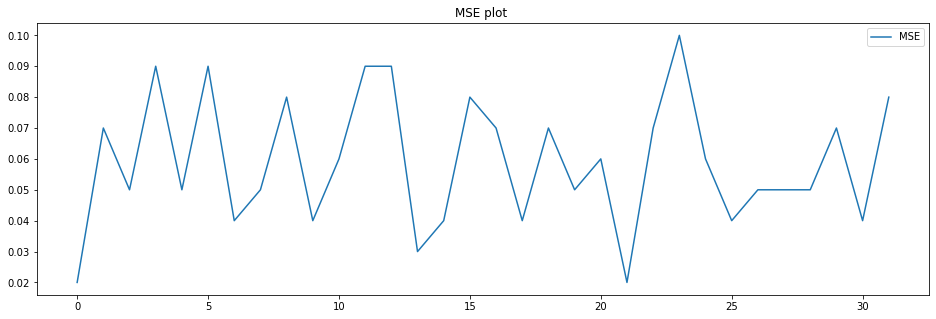


Shapiro_Wilk Test
Statistics=0.964, p=0.3486455679
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.225, p=0.329
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.382
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 52
mean=0.054 ,max=0.101,min=0.01,variance=0.00047


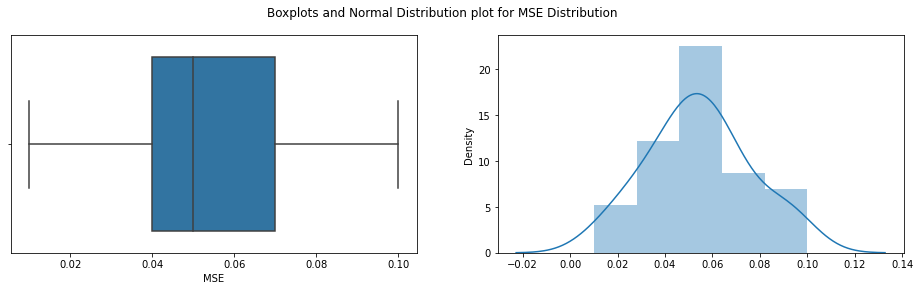

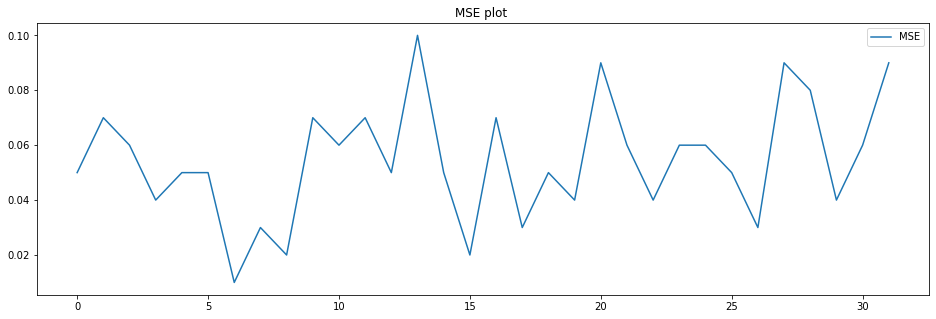


Shapiro_Wilk Test
Statistics=0.988, p=0.9671096802
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.117, p=0.943
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.167
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 53
mean=0.058 ,max=0.111,min=0.022,variance=0.00049


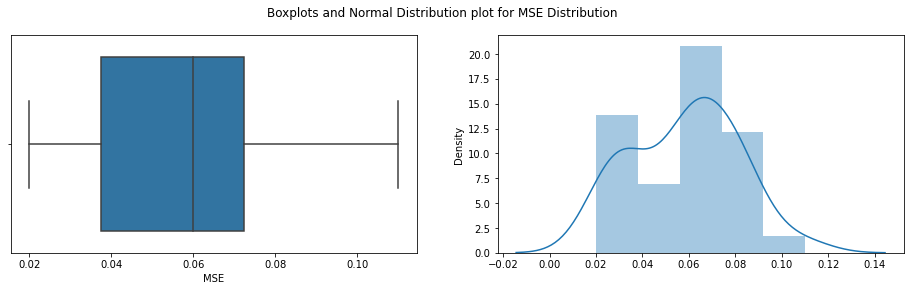

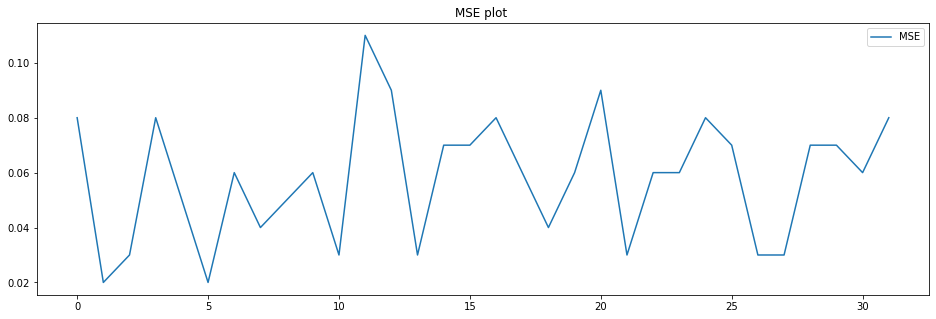


Shapiro_Wilk Test
Statistics=0.961, p=0.2965050042
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.321, p=0.852
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.448
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 54
mean=0.053 ,max=0.111,min=0.012,variance=0.00046


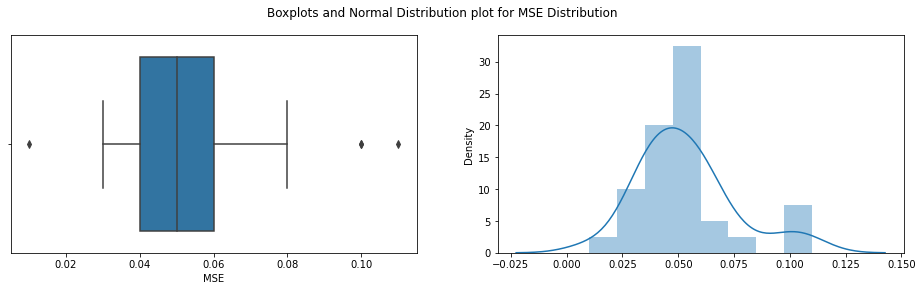

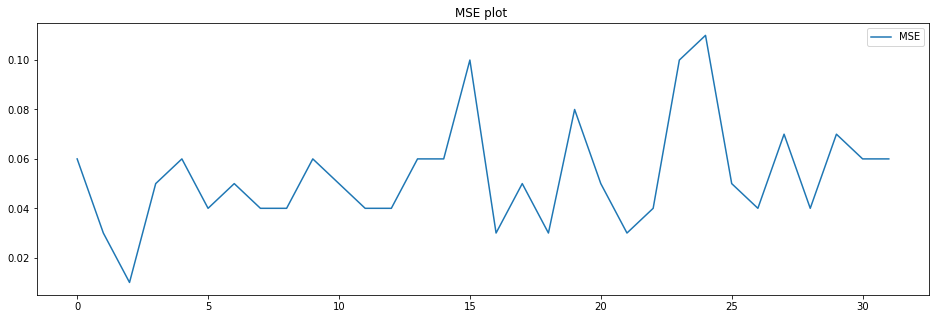


Shapiro_Wilk Test
Statistics=0.944, p=0.0975883380
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.649, p=0.059
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.620
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 55
mean=0.052 ,max=0.098,min=0.019,variance=0.00037


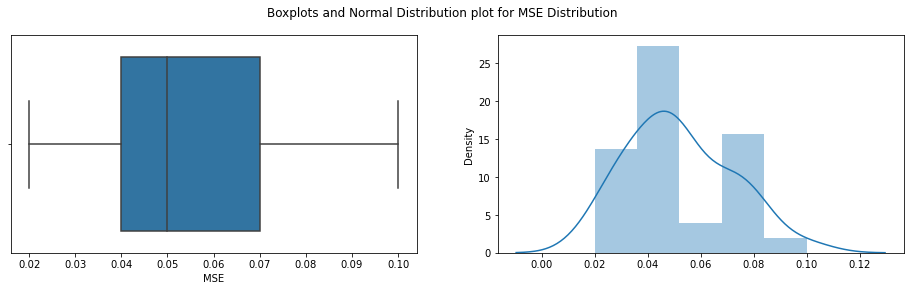

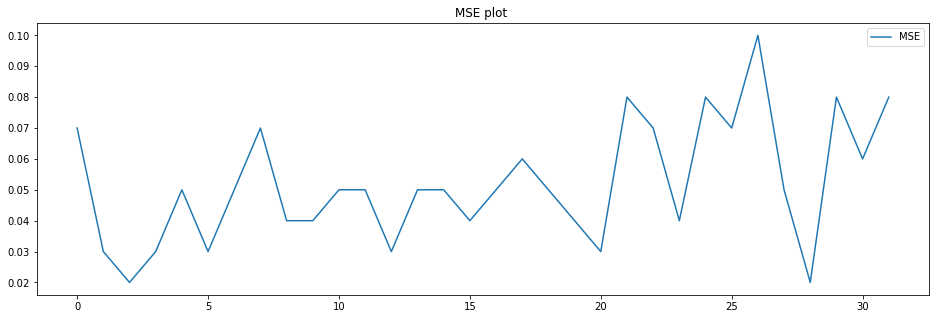


Shapiro_Wilk Test
Statistics=0.967, p=0.4197056890
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.601, p=0.449
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.405
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 56
mean=0.049 ,max=0.094,min=0.012,variance=0.00048


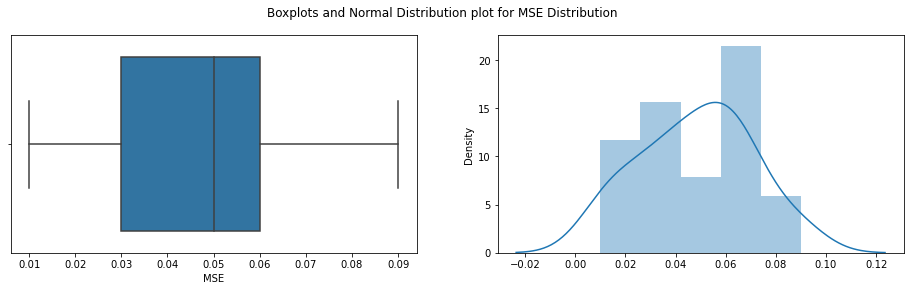

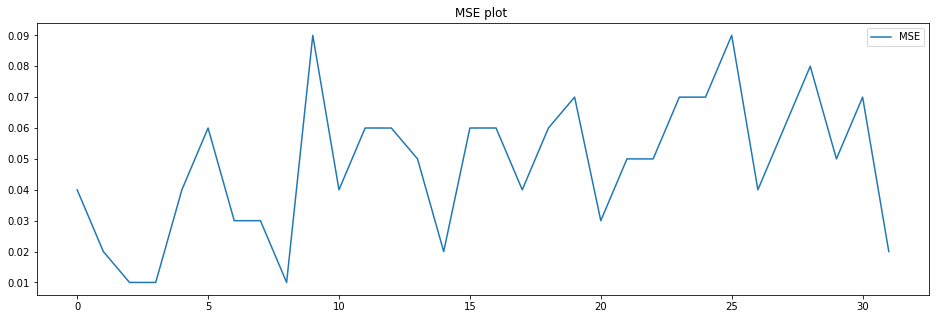


Shapiro_Wilk Test
Statistics=0.969, p=0.4716149271
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.449, p=0.799
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.240
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 57
mean=0.06 ,max=0.094,min=0.019,variance=0.00041


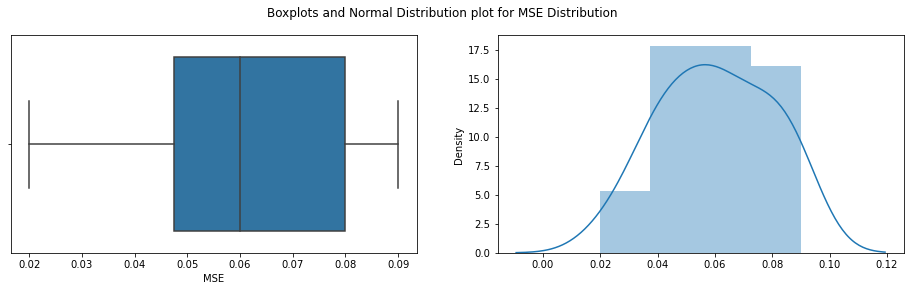

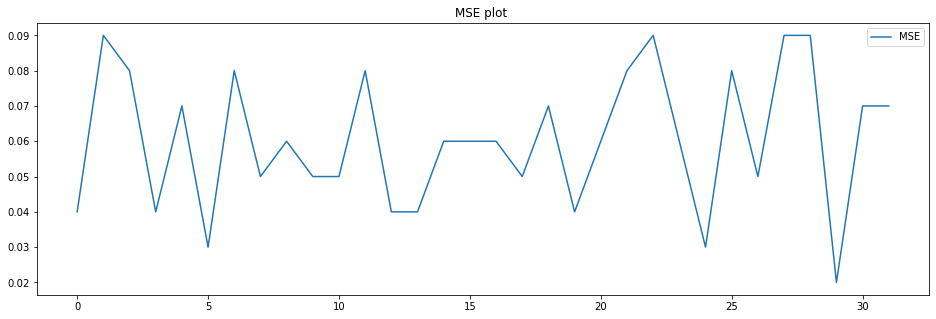


Shapiro_Wilk Test
Statistics=0.967, p=0.4250948727
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.472, p=0.479
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.305
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 58
mean=0.065 ,max=0.141,min=0.023,variance=0.0008


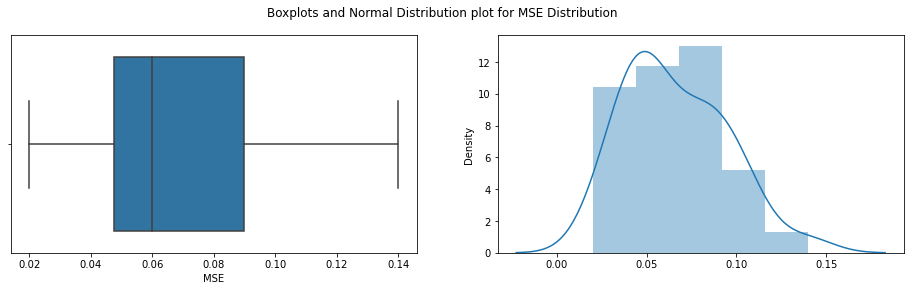

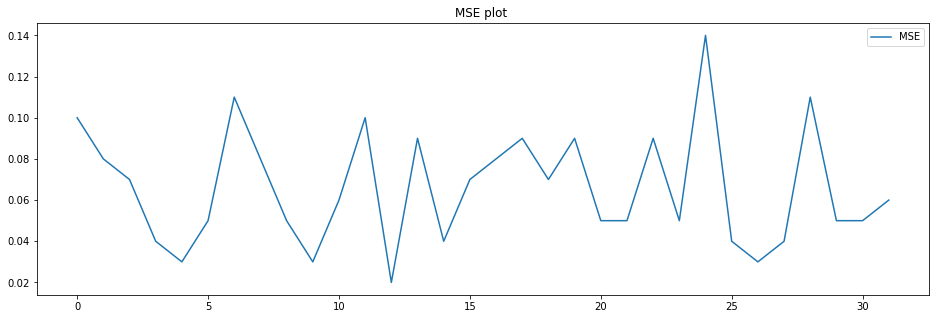


Shapiro_Wilk Test
Statistics=0.947, p=0.1202515215
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.906, p=0.234
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.571
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 59
mean=0.055 ,max=0.117,min=0.026,variance=0.00055


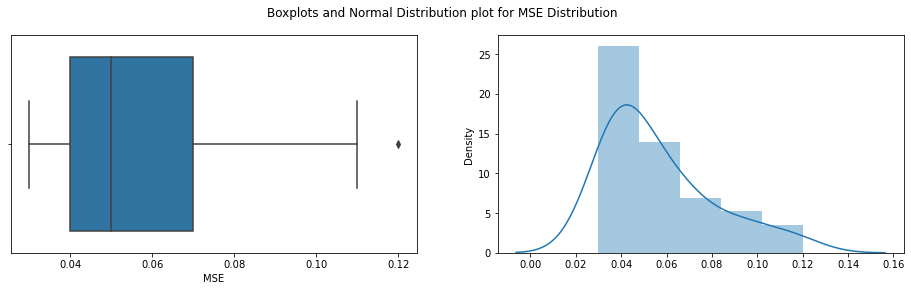

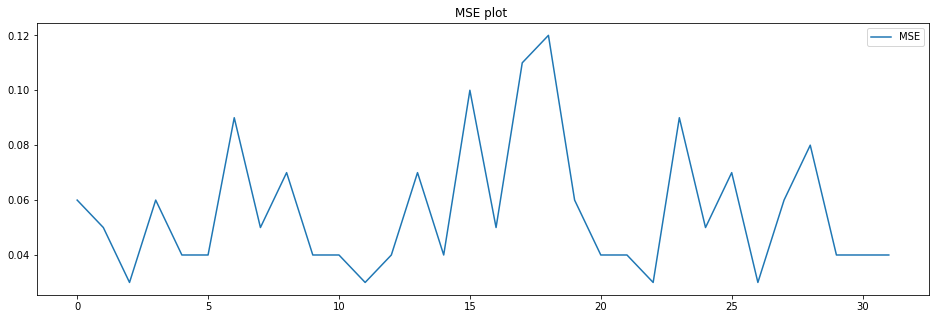


Shapiro_Wilk Test
Statistics=0.880, p=0.0019671049
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=6.746, p=0.034
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.399
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 60
mean=0.052 ,max=0.099,min=0.016,variance=0.00046


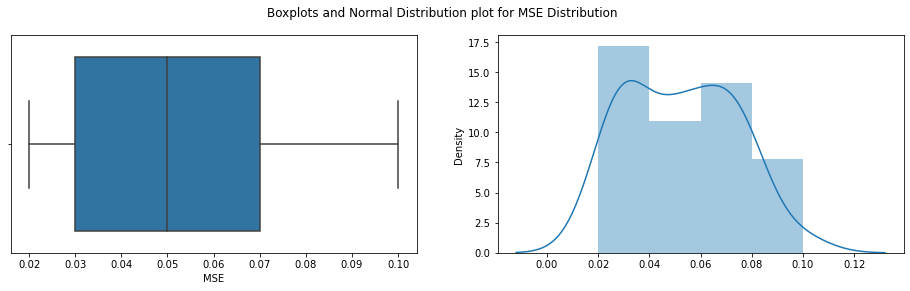

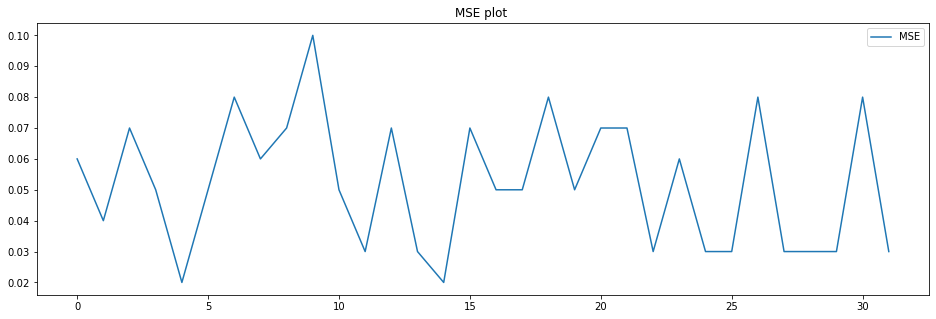


Shapiro_Wilk Test
Statistics=0.963, p=0.3232849240
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.585, p=0.275
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.445
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 61
mean=0.047 ,max=0.081,min=0.026,variance=0.00019


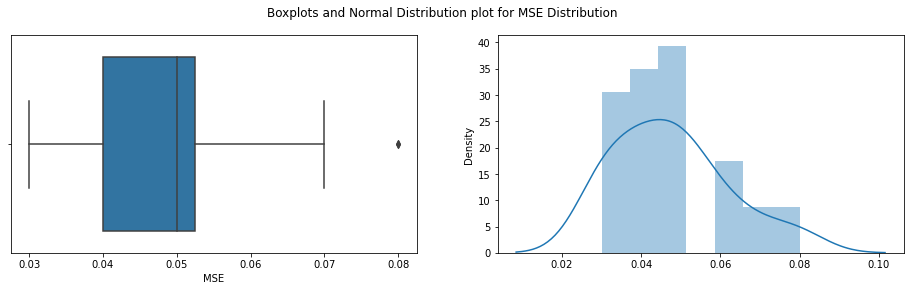

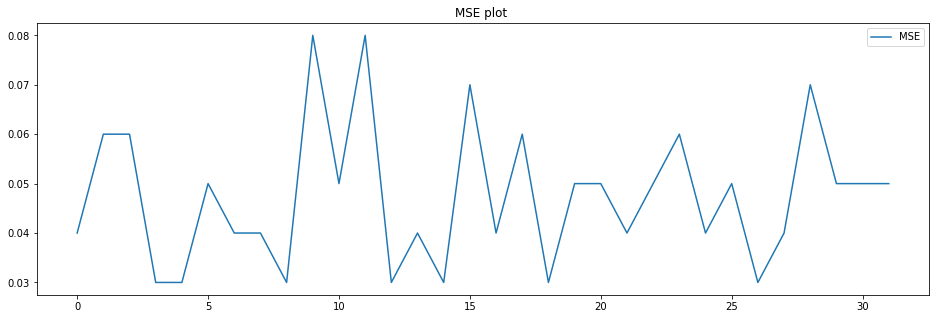


Shapiro_Wilk Test
Statistics=0.965, p=0.3635291159
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.994, p=0.369
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.288
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 62
mean=0.056 ,max=0.138,min=0.031,variance=0.00046


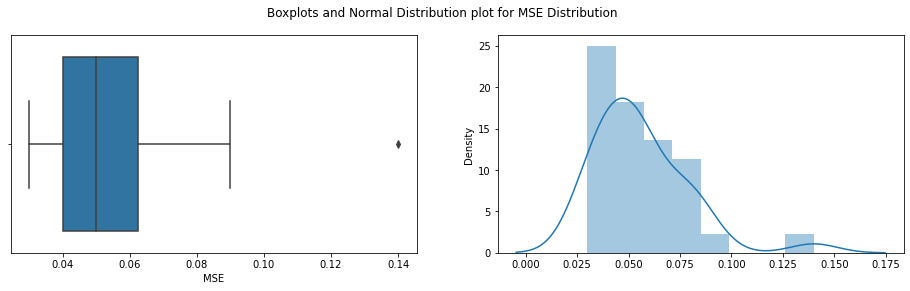

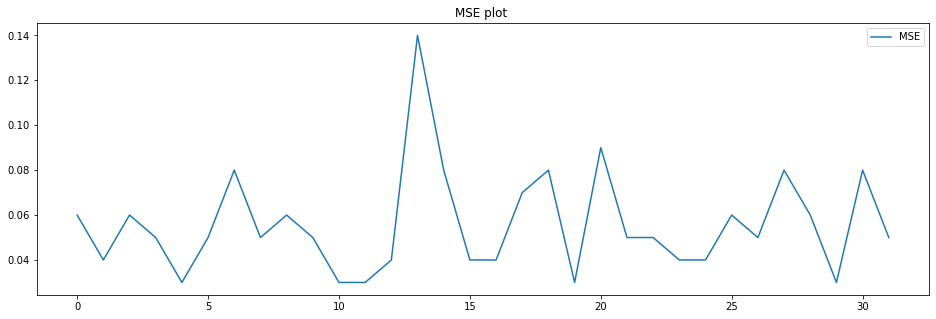


Shapiro_Wilk Test
Statistics=0.848, p=0.0003826131
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=23.165, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.054
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 63
mean=0.053 ,max=0.086,min=0.02,variance=0.00037


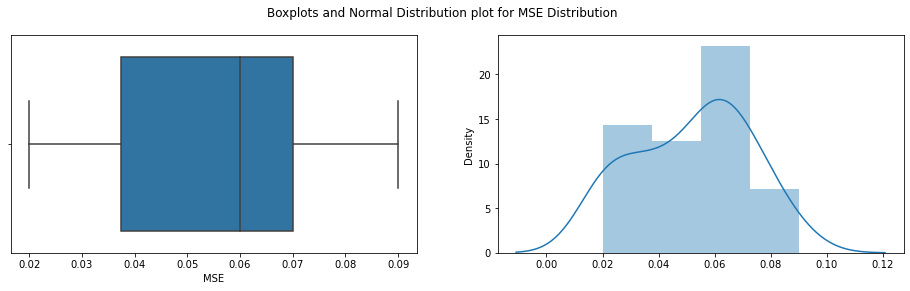

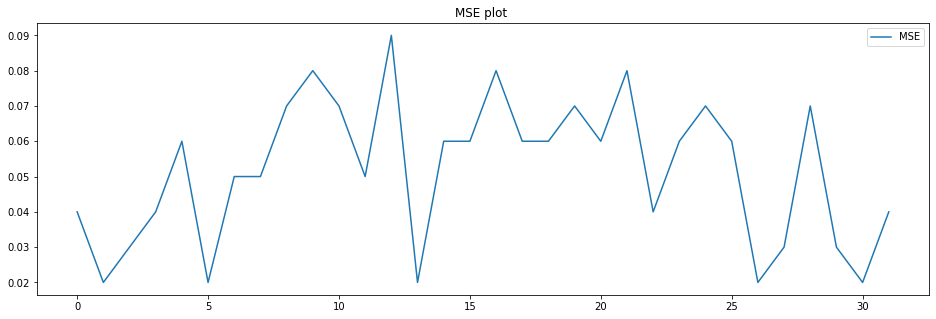


Shapiro_Wilk Test
Statistics=0.949, p=0.1360590309
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.135, p=0.126
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.523
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 64
mean=0.051 ,max=0.095,min=0.013,variance=0.00056


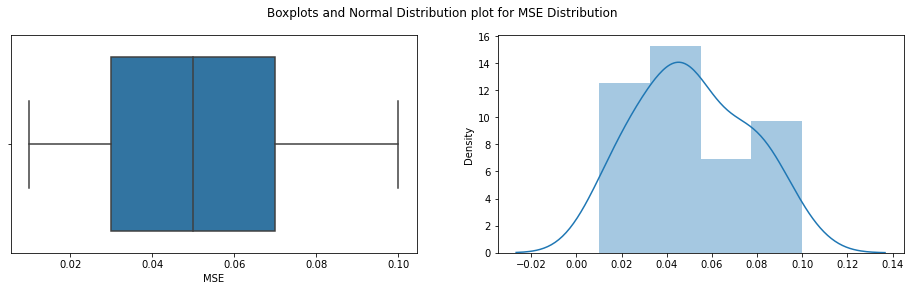

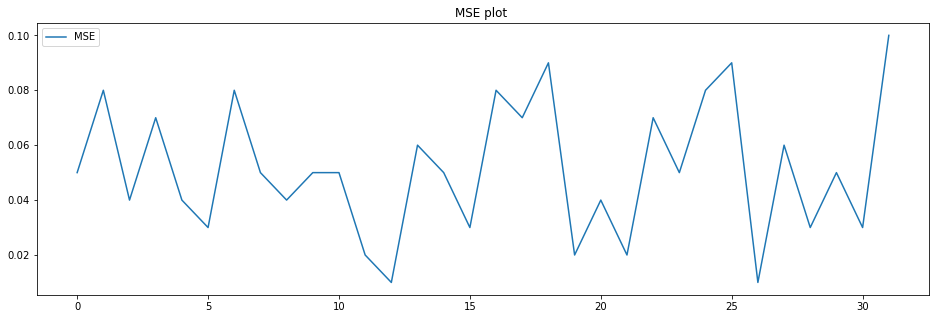


Shapiro_Wilk Test
Statistics=0.958, p=0.2373934239
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.468, p=0.177
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.418
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 65
mean=0.051 ,max=0.089,min=0.011,variance=0.00047


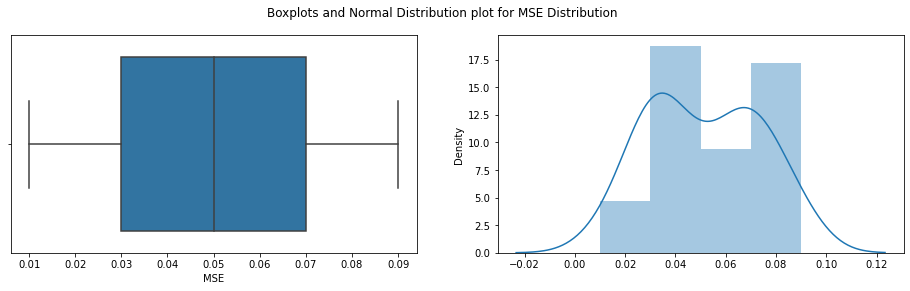

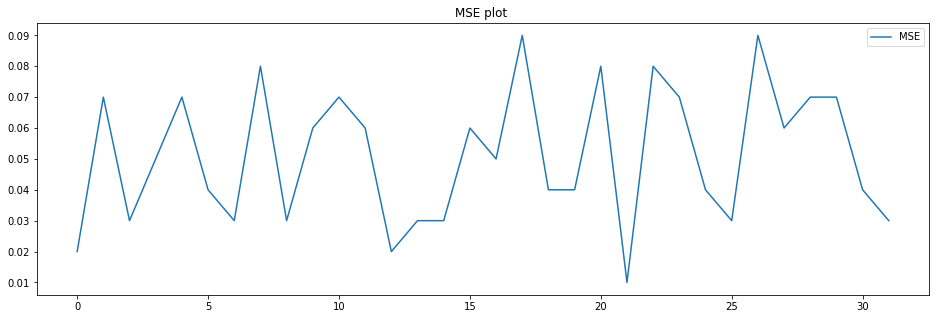


Shapiro_Wilk Test
Statistics=0.955, p=0.1936390847
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.985, p=0.050
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.532
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 66
mean=0.046 ,max=0.083,min=0.011,variance=0.00029


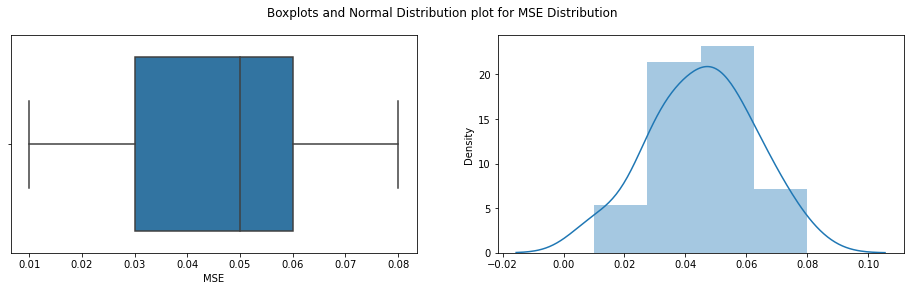

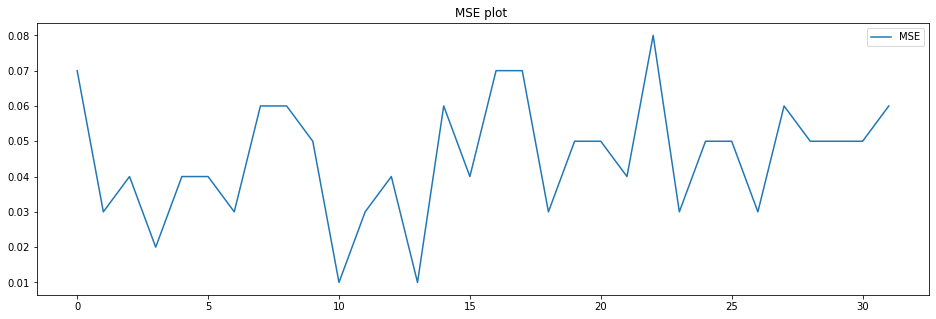


Shapiro_Wilk Test
Statistics=0.987, p=0.9602788687
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.056, p=0.972
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.165
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 67
mean=0.055 ,max=0.098,min=0.016,variance=0.00042


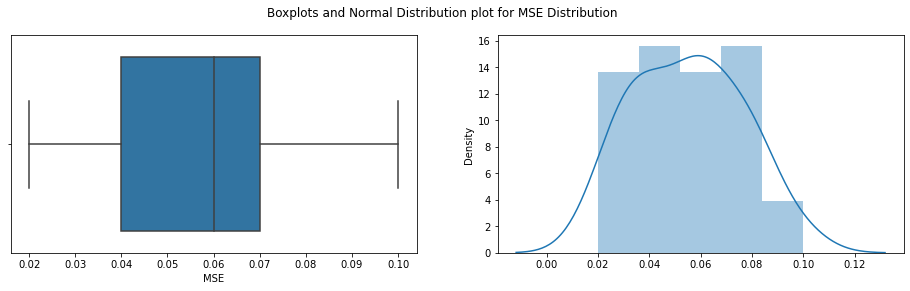

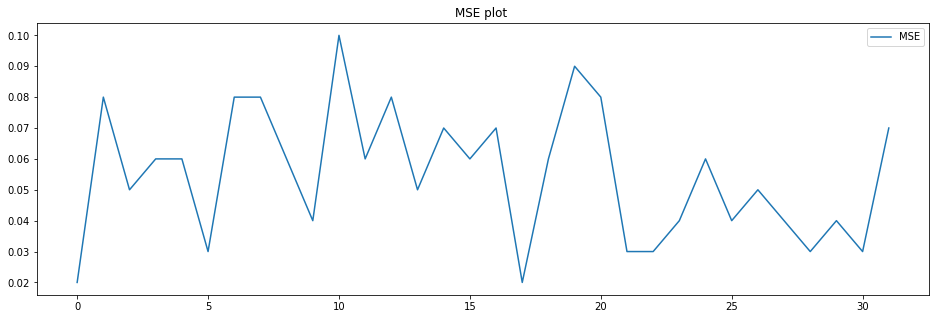


Shapiro_Wilk Test
Statistics=0.977, p=0.7190367579
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.049, p=0.592
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.264
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 68
mean=0.051 ,max=0.119,min=0.009,variance=0.0006


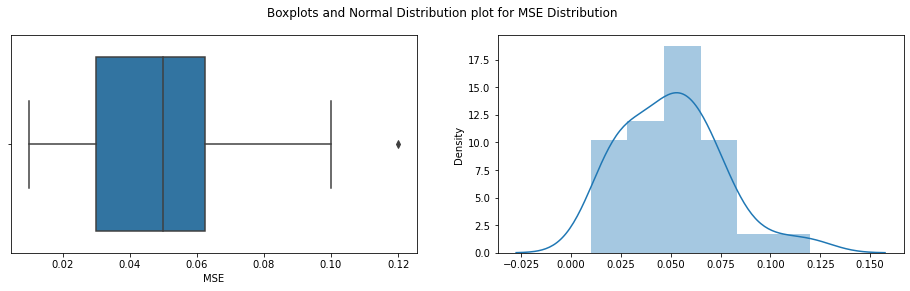

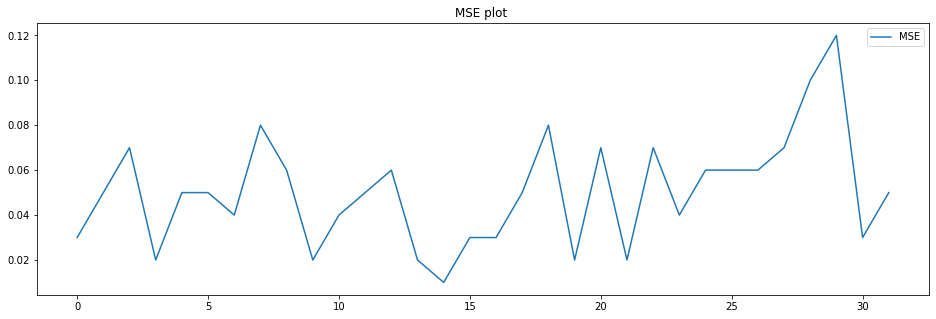


Shapiro_Wilk Test
Statistics=0.965, p=0.3835433424
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.442, p=0.179
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.271
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 69
mean=0.051 ,max=0.086,min=0.011,variance=0.00031


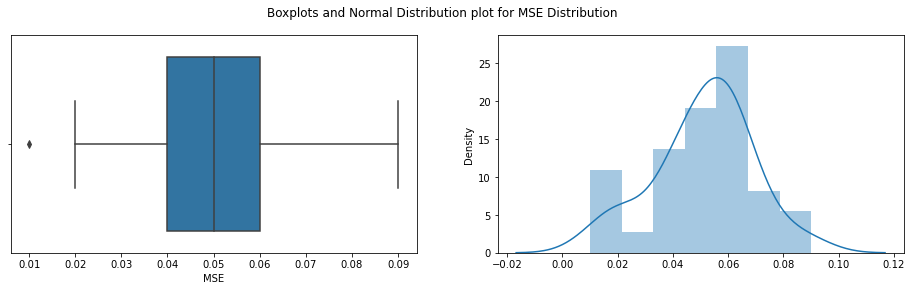

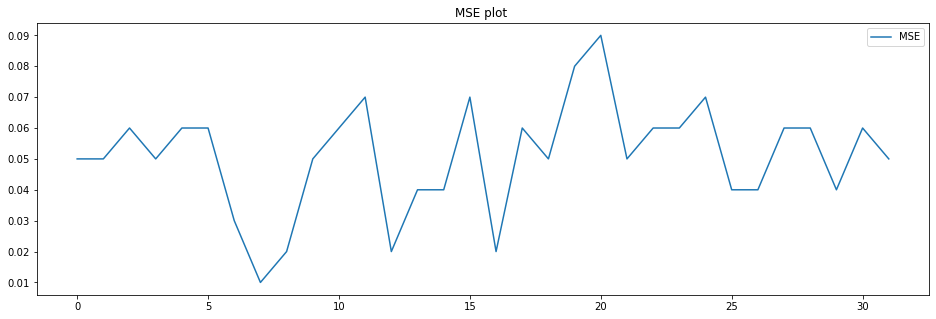


Shapiro_Wilk Test
Statistics=0.970, p=0.5057509542
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.896, p=0.639
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.434
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 70
mean=0.054 ,max=0.099,min=0.026,variance=0.00031


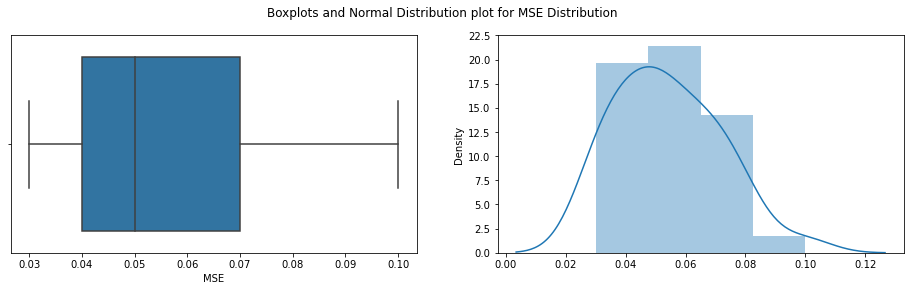

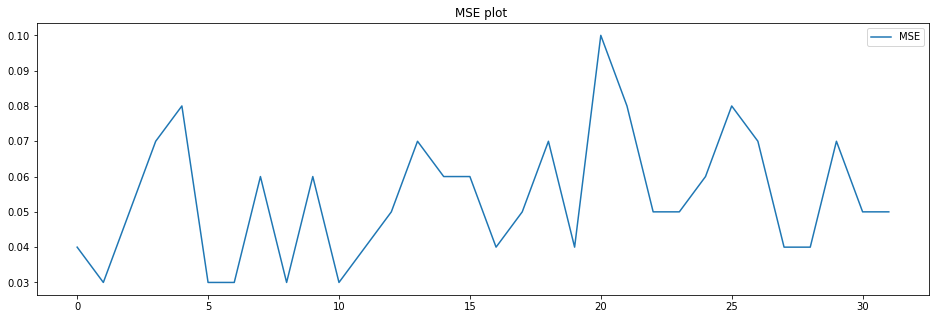


Shapiro_Wilk Test
Statistics=0.962, p=0.3078337908
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.436, p=0.488
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.442
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 71
mean=0.056 ,max=0.094,min=0.021,variance=0.00043


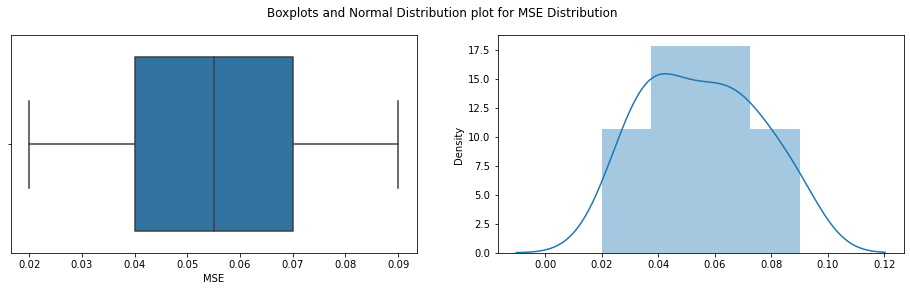

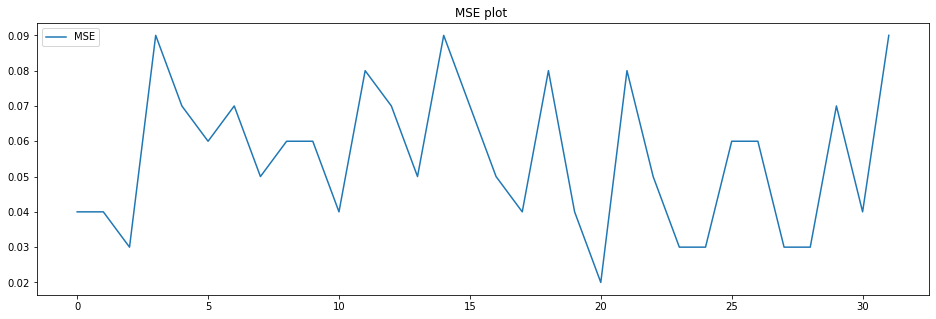


Shapiro_Wilk Test
Statistics=0.961, p=0.2862119377
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.356, p=0.308
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.315
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 72
mean=0.056 ,max=0.103,min=0.02,variance=0.00054


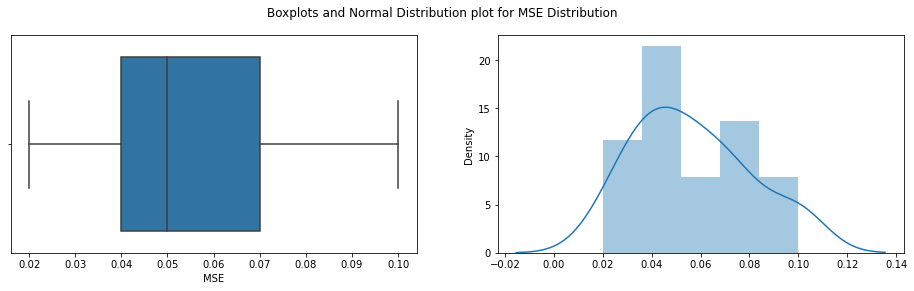

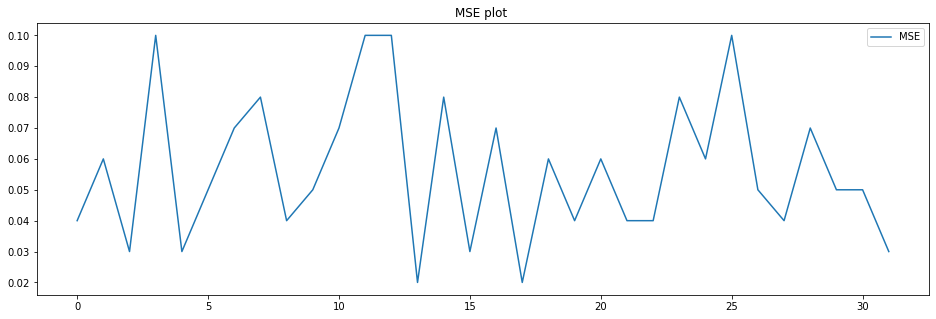


Shapiro_Wilk Test
Statistics=0.954, p=0.1909655333
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.198, p=0.333
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.382
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 73
mean=0.05 ,max=0.111,min=0.011,variance=0.00064


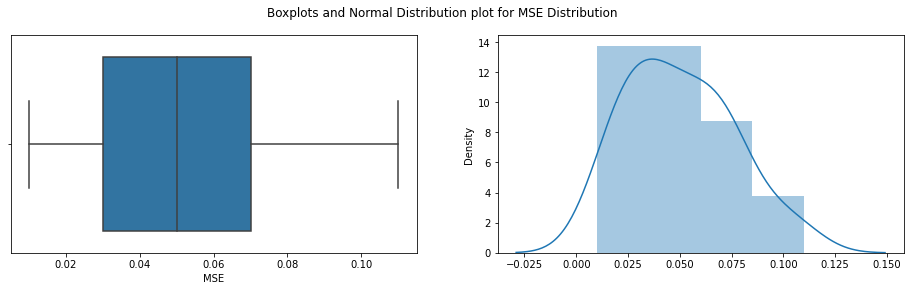

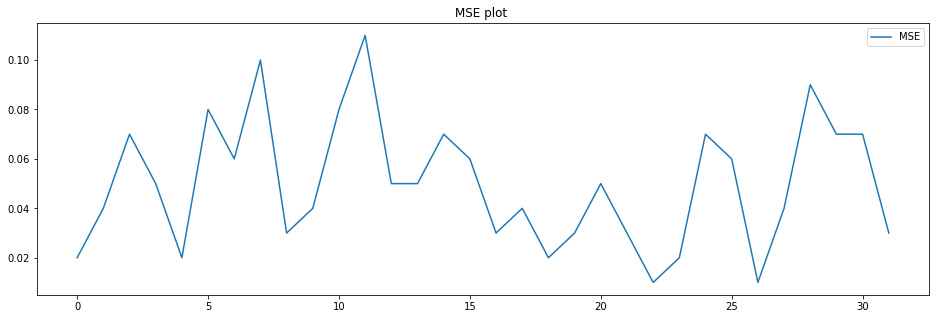


Shapiro_Wilk Test
Statistics=0.962, p=0.3201299906
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.921, p=0.383
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.335
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 74
mean=0.055 ,max=0.117,min=0.016,variance=0.00049


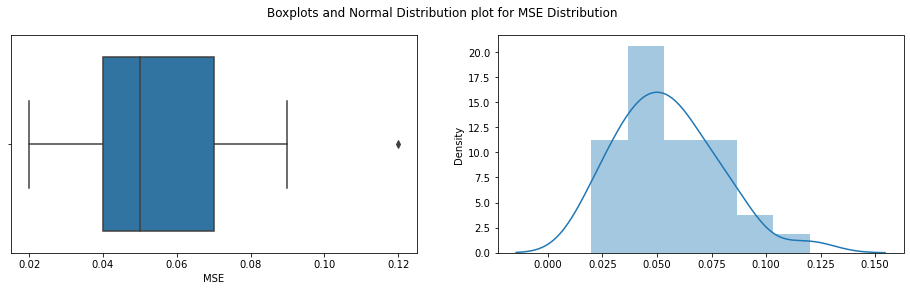

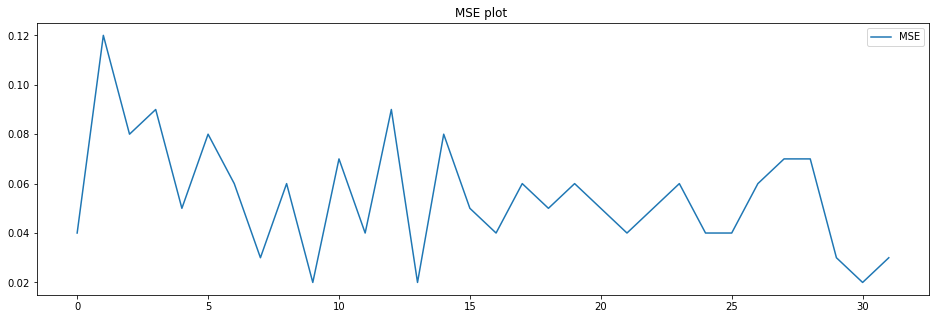


Shapiro_Wilk Test
Statistics=0.972, p=0.5631936193
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.602, p=0.272
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.263
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 75
mean=0.054 ,max=0.107,min=0.021,variance=0.00042


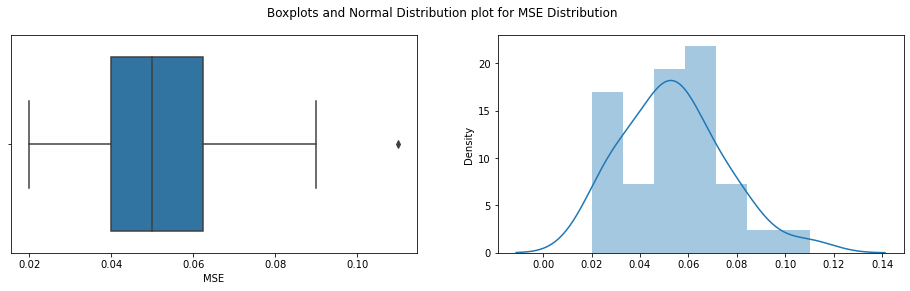

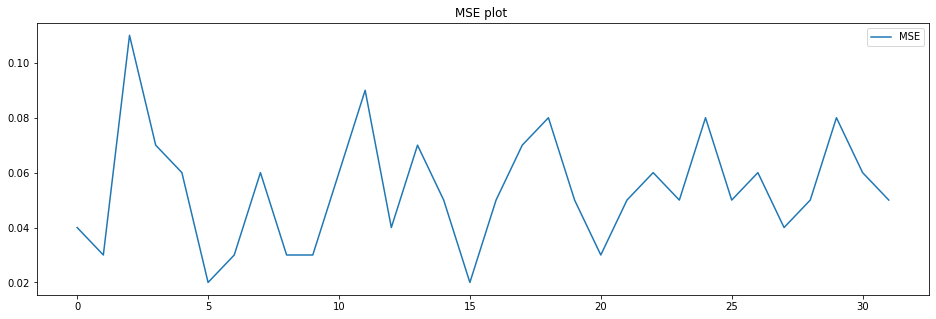


Shapiro_Wilk Test
Statistics=0.968, p=0.4363858700
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.724, p=0.422
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.300
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 76
mean=0.05 ,max=0.084,min=0.011,variance=0.00024


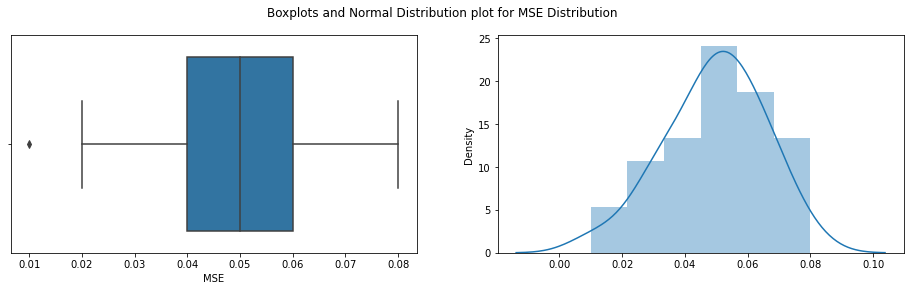

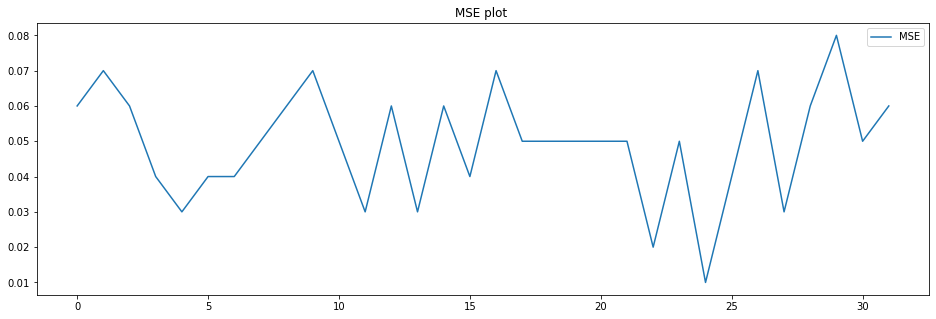


Shapiro_Wilk Test
Statistics=0.987, p=0.9624002576
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.661, p=0.719
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.206
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 77
mean=0.046 ,max=0.097,min=0.011,variance=0.00059


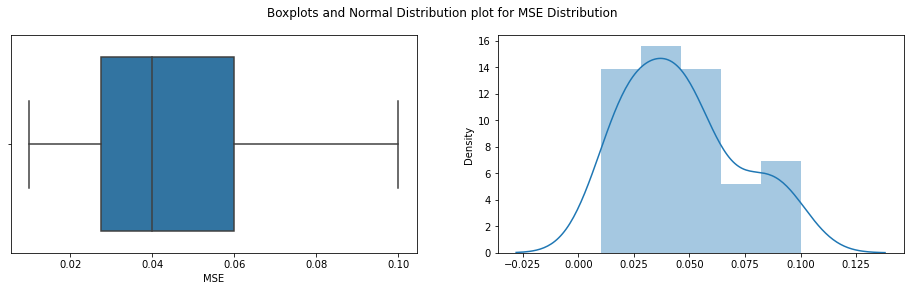

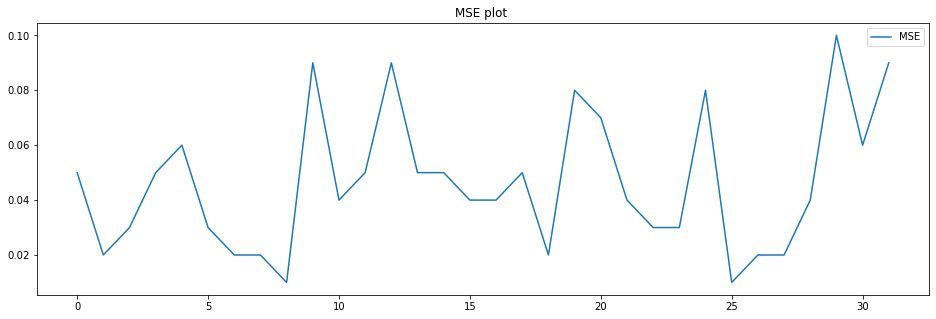


Shapiro_Wilk Test
Statistics=0.940, p=0.0762548521
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.790, p=0.248
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.585
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 78
mean=0.052 ,max=0.103,min=0.015,variance=0.0006


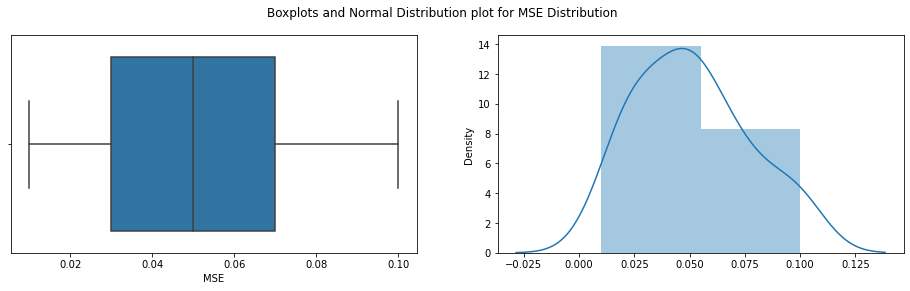

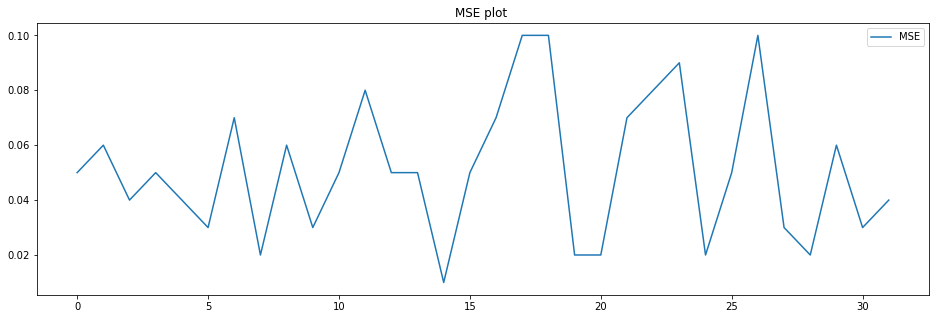


Shapiro_Wilk Test
Statistics=0.951, p=0.1504523009
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.006, p=0.367
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.442
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 79
mean=0.053 ,max=0.089,min=0.02,variance=0.00039


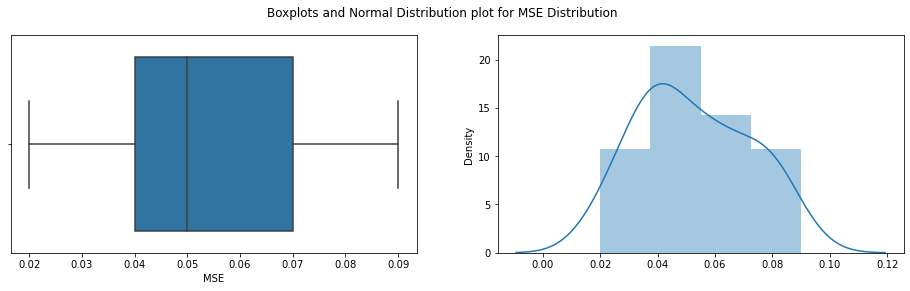

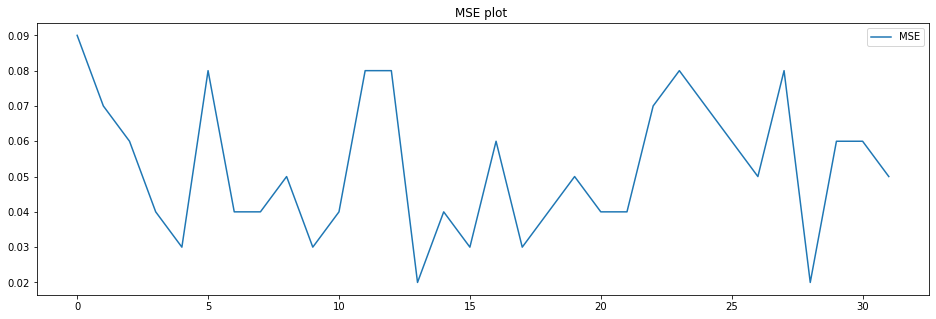


Shapiro_Wilk Test
Statistics=0.951, p=0.1542078704
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.016, p=0.081
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.512
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 80
mean=0.056 ,max=0.145,min=0.024,variance=0.00054


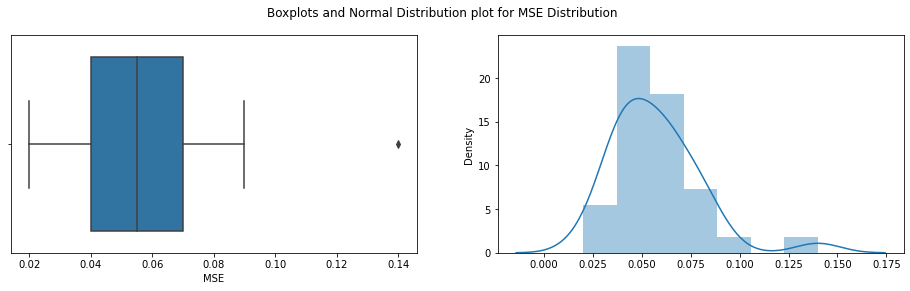

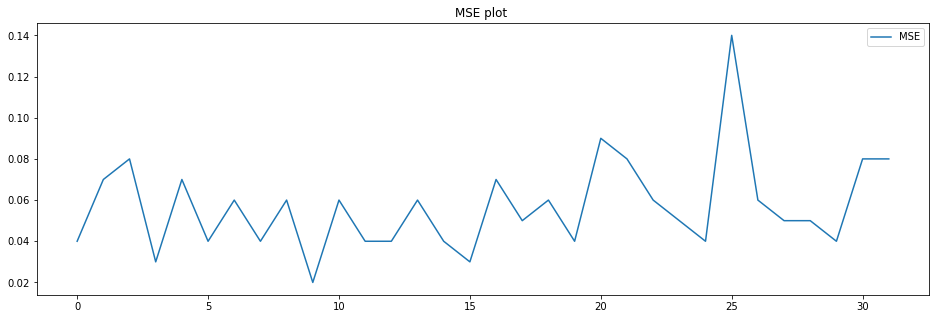


Shapiro_Wilk Test
Statistics=0.873, p=0.0013401522
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=22.800, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.804
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 81
mean=0.05 ,max=0.083,min=0.019,variance=0.00033


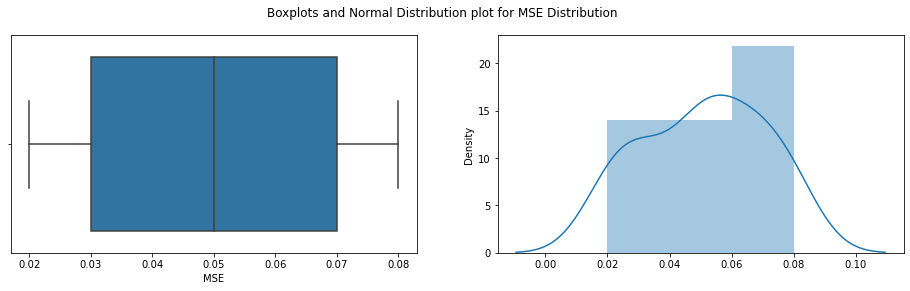

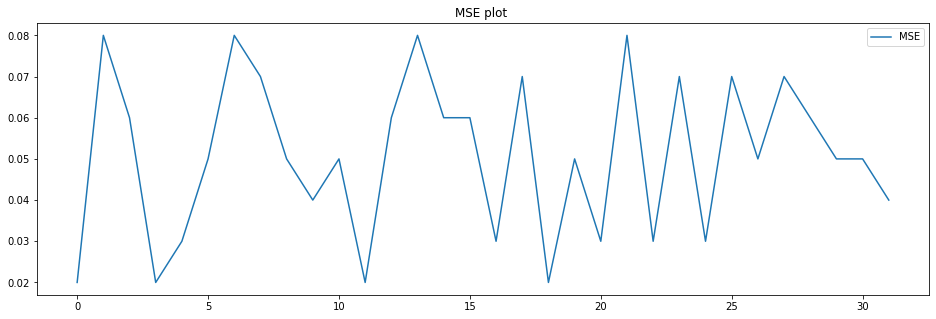


Shapiro_Wilk Test
Statistics=0.961, p=0.2892442048
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.549, p=0.280
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.352
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 82
mean=0.048 ,max=0.078,min=0.011,variance=0.0003


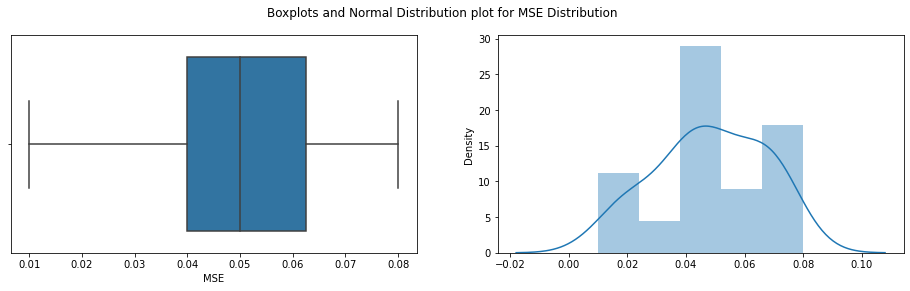

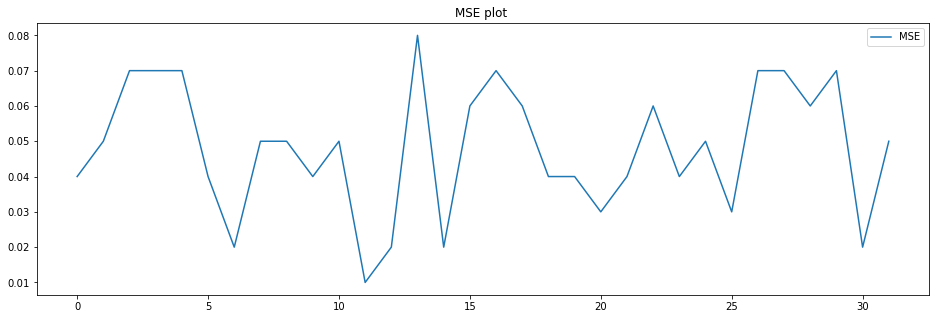


Shapiro_Wilk Test
Statistics=0.961, p=0.3002719581
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.948, p=0.378
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.436
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 83
mean=0.054 ,max=0.095,min=0.02,variance=0.00043


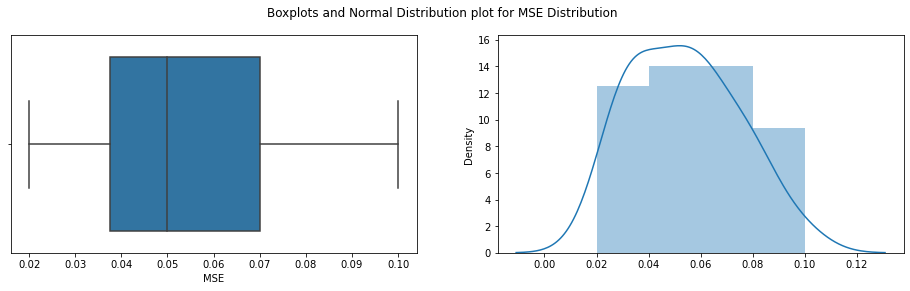

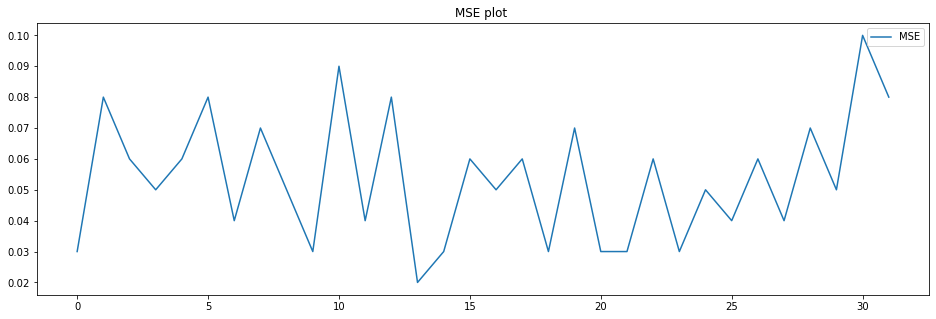


Shapiro_Wilk Test
Statistics=0.958, p=0.2406683266
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.592, p=0.274
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.392
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 84
mean=0.055 ,max=0.085,min=0.03,variance=0.00021


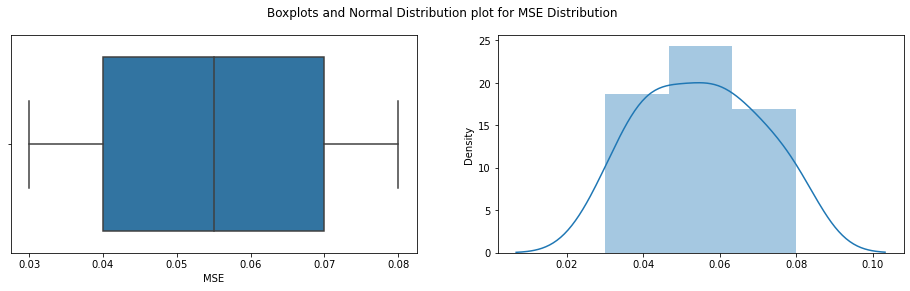

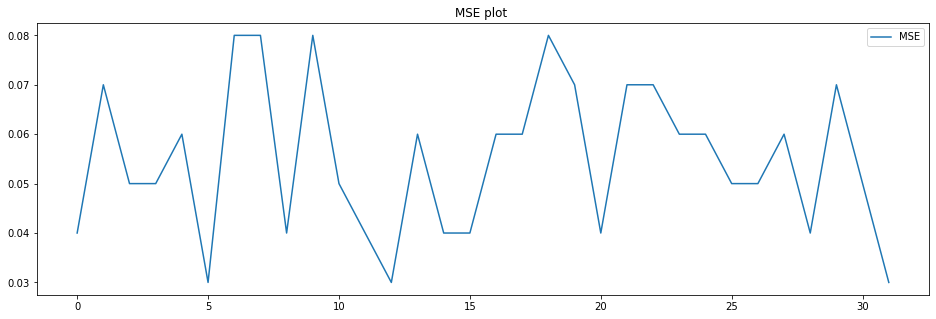


Shapiro_Wilk Test
Statistics=0.973, p=0.5891025662
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.582, p=0.453
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.230
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 85
mean=0.045 ,max=0.081,min=0.015,variance=0.00025


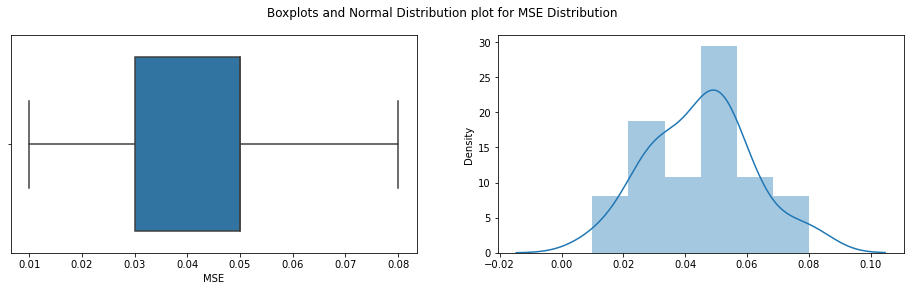

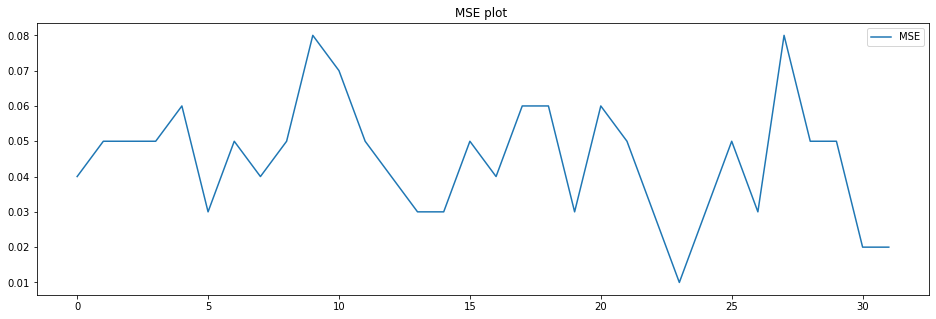


Shapiro_Wilk Test
Statistics=0.968, p=0.4435197711
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.522, p=0.770
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.411
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 86
mean=0.053 ,max=0.086,min=0.027,variance=0.00025


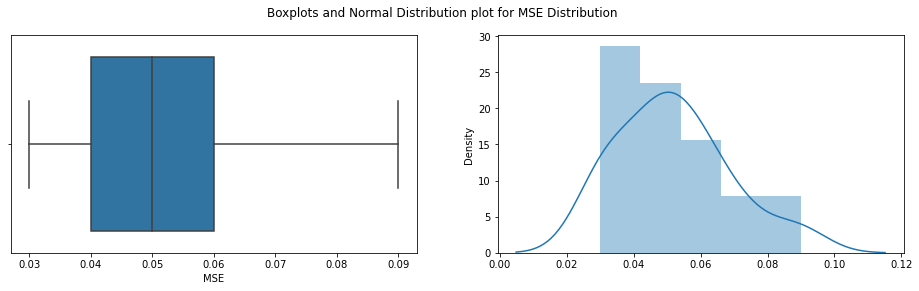

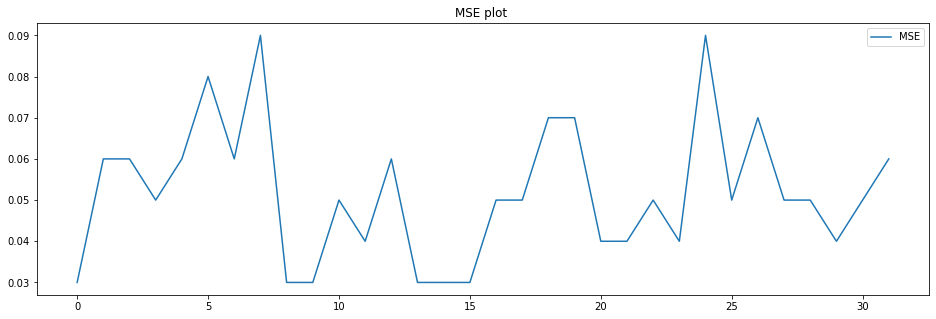


Shapiro_Wilk Test
Statistics=0.957, p=0.2223468423
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.526, p=0.466
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.347
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 87
mean=0.051 ,max=0.09,min=0.008,variance=0.00045


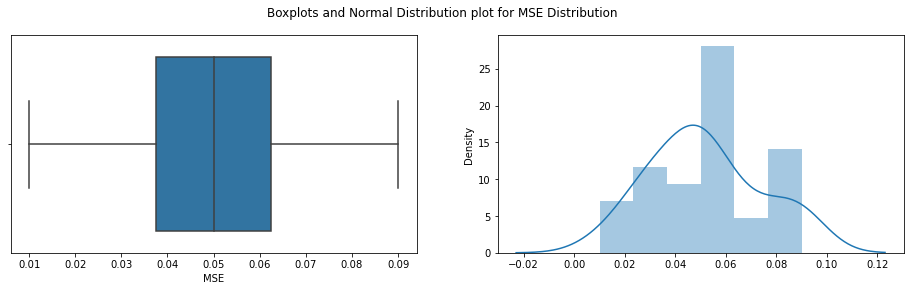

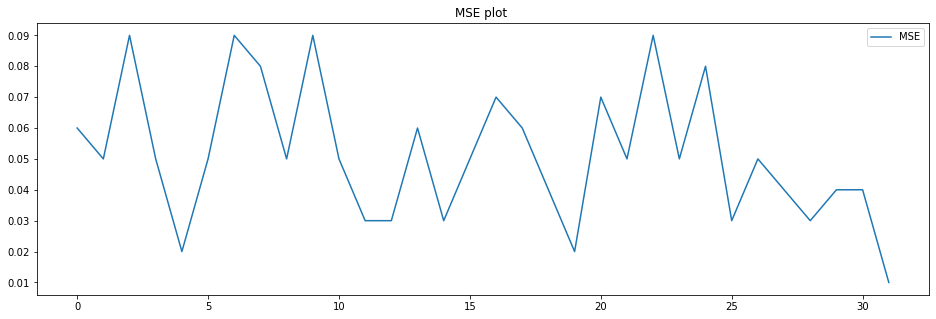


Shapiro_Wilk Test
Statistics=0.967, p=0.4256099164
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.380, p=0.827
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.383
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 88
mean=0.062 ,max=0.131,min=0.019,variance=0.00076


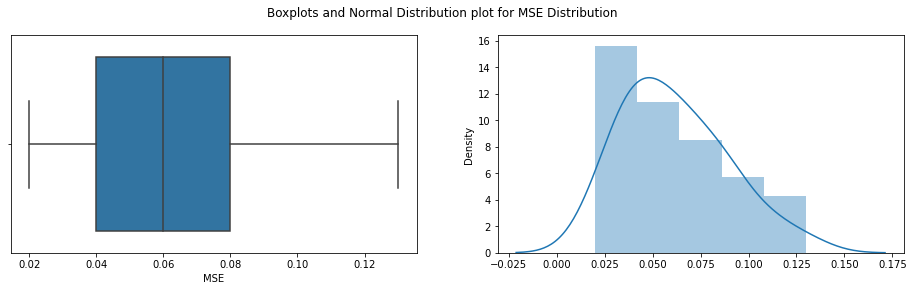

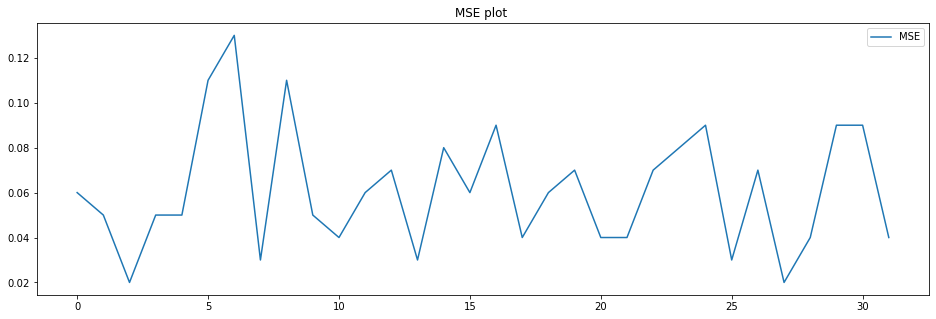


Shapiro_Wilk Test
Statistics=0.945, p=0.1073120013
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.794, p=0.247
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.628
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 89
mean=0.056 ,max=0.089,min=0.015,variance=0.00041


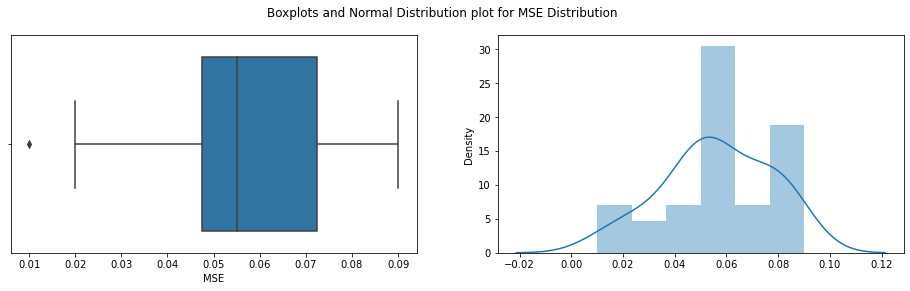

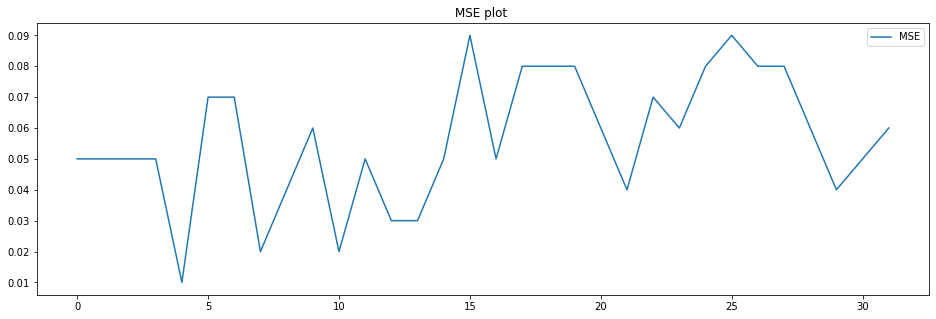


Shapiro_Wilk Test
Statistics=0.965, p=0.3632493615
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.101, p=0.577
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.296
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 90
mean=0.059 ,max=0.105,min=0.017,variance=0.0005


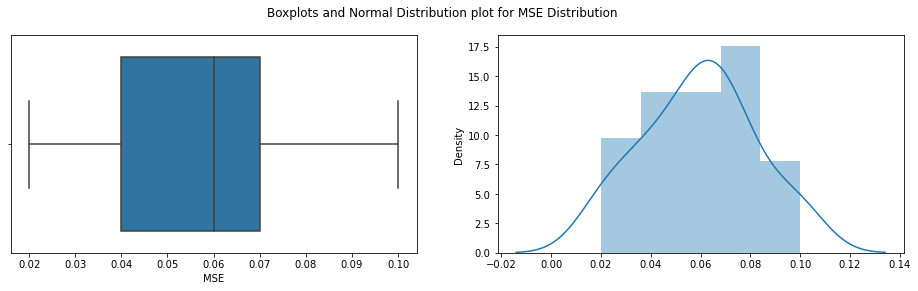

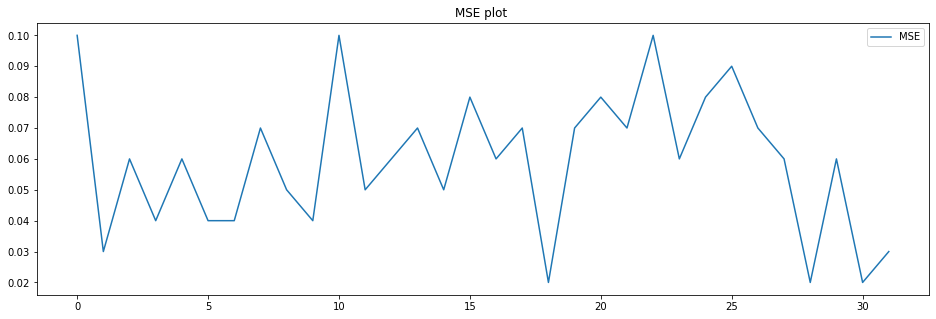


Shapiro_Wilk Test
Statistics=0.979, p=0.7665090561
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.192, p=0.908
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.199
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 91
mean=0.054 ,max=0.098,min=0.02,variance=0.00031


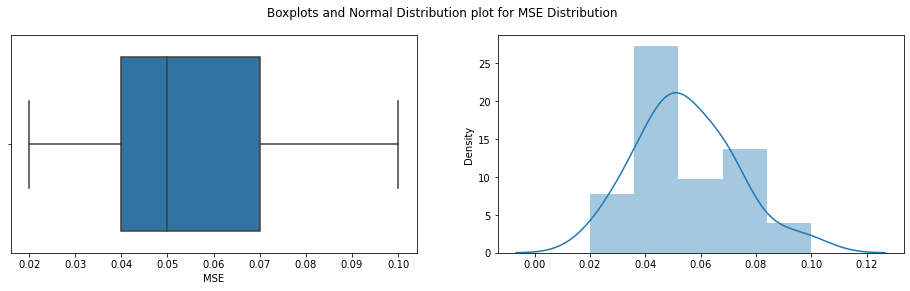

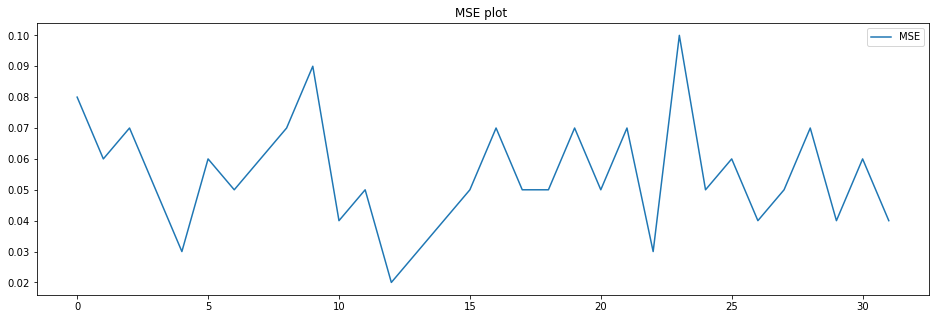


Shapiro_Wilk Test
Statistics=0.982, p=0.8515496254
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.628, p=0.731
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.227
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 92
mean=0.054 ,max=0.103,min=0.009,variance=0.00038


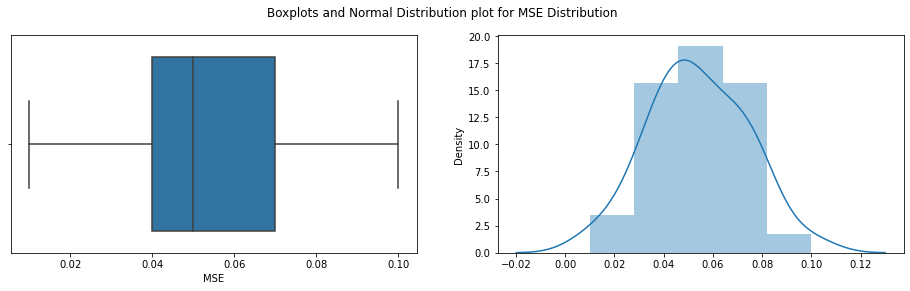

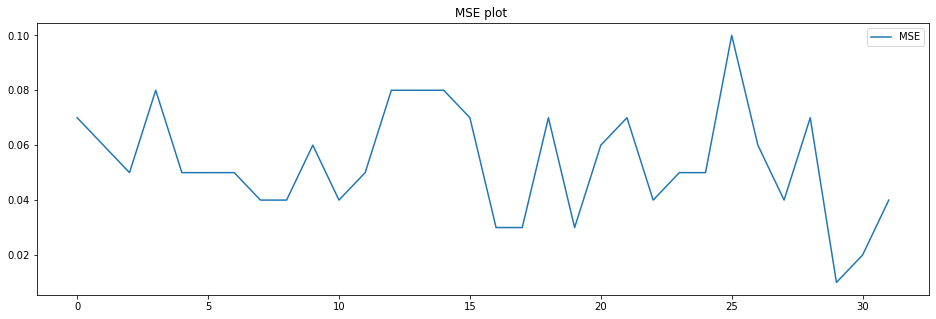


Shapiro_Wilk Test
Statistics=0.990, p=0.9910422564
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.375, p=0.829
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.183
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 93
mean=0.057 ,max=0.112,min=0.016,variance=0.0005


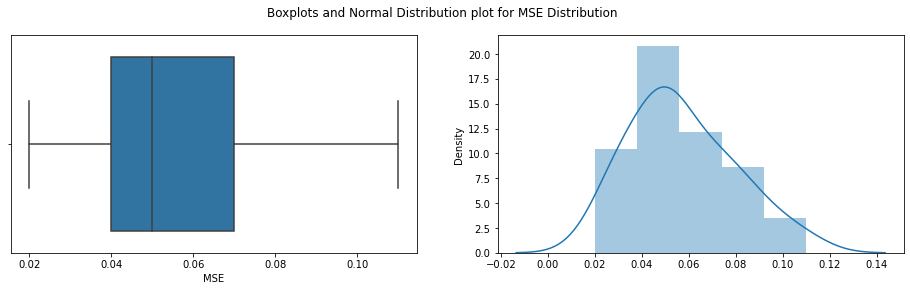

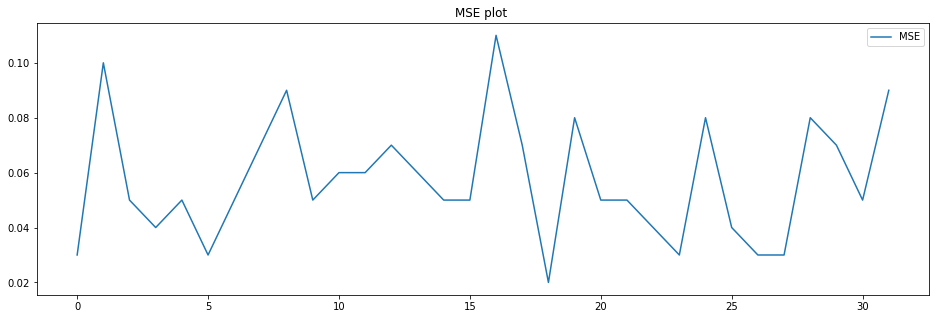


Shapiro_Wilk Test
Statistics=0.969, p=0.4828383029
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.824, p=0.402
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.358
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 94
mean=0.052 ,max=0.096,min=0.02,variance=0.00057


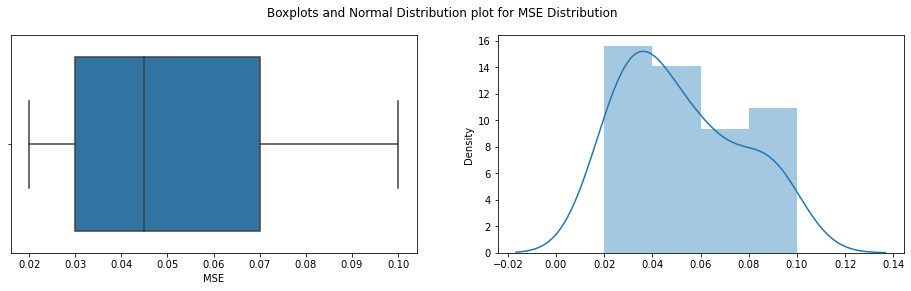

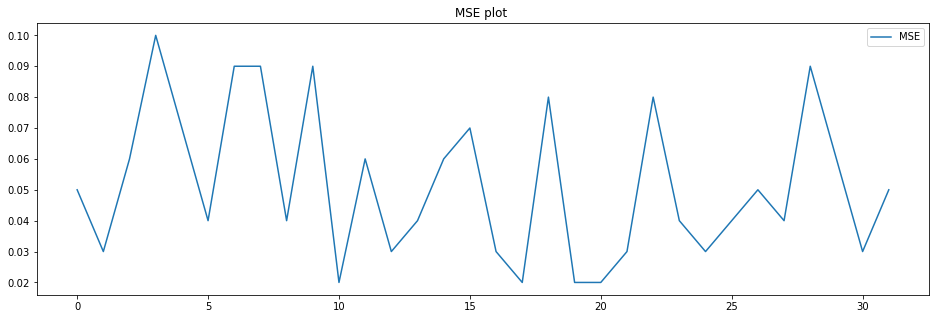


Shapiro_Wilk Test
Statistics=0.911, p=0.0122654103
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=5.430, p=0.066
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.931
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 95
mean=0.048 ,max=0.089,min=0.01,variance=0.00033


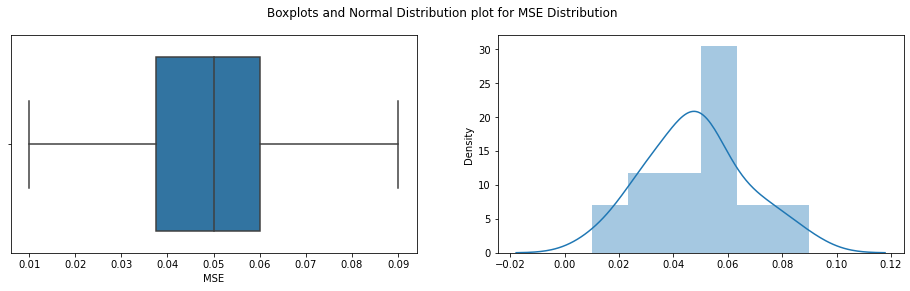

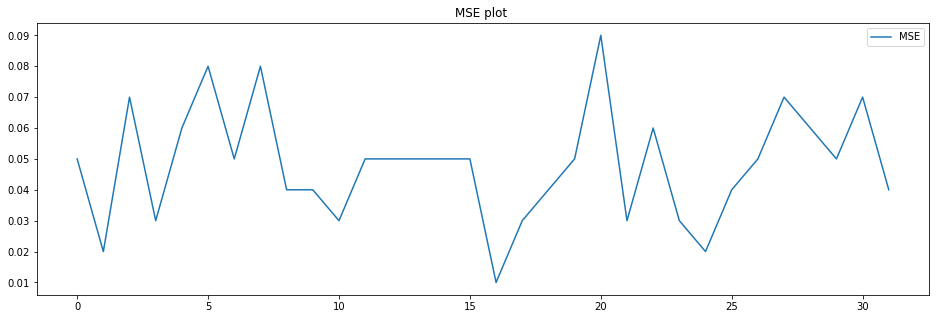


Shapiro_Wilk Test
Statistics=0.987, p=0.9617336988
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.210, p=0.900
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.187
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 96
mean=0.056 ,max=0.137,min=0.014,variance=0.00067


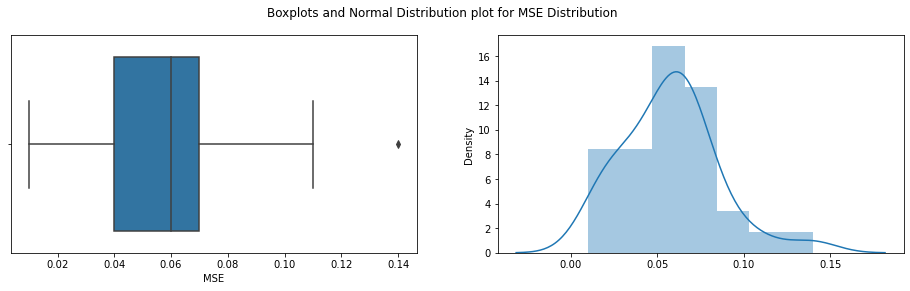

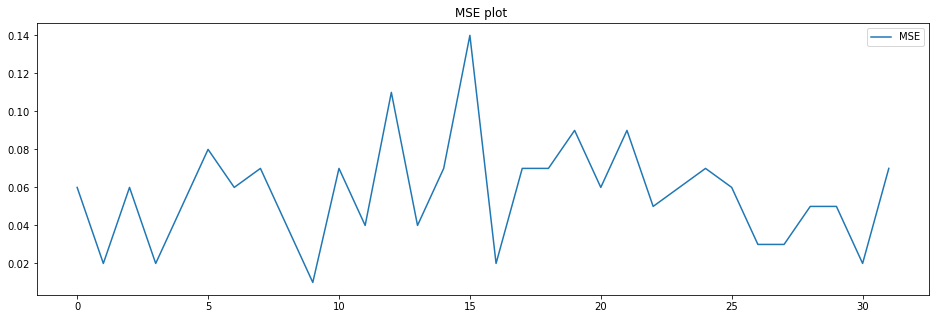


Shapiro_Wilk Test
Statistics=0.944, p=0.0991391167
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=6.707, p=0.035
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.435
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 97
mean=0.043 ,max=0.076,min=0.02,variance=0.00026


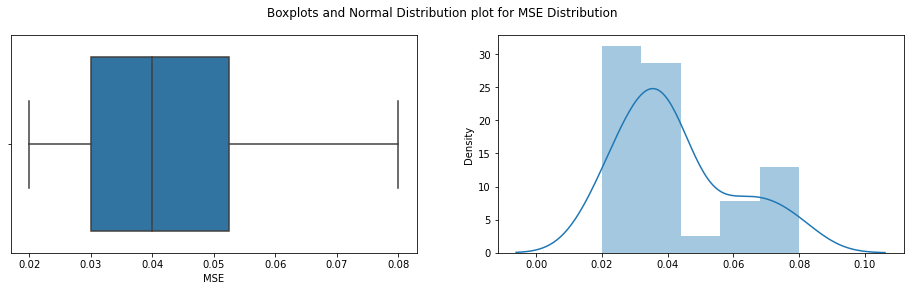

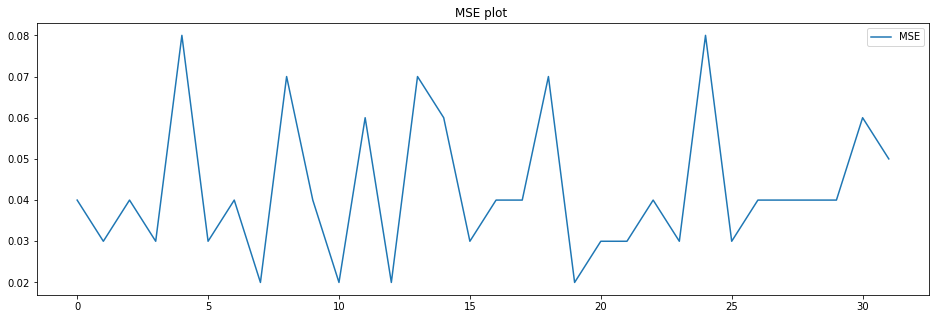


Shapiro_Wilk Test
Statistics=0.892, p=0.0038529960
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=3.666, p=0.160
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 1.420
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 98
mean=0.058 ,max=0.088,min=0.015,variance=0.00039


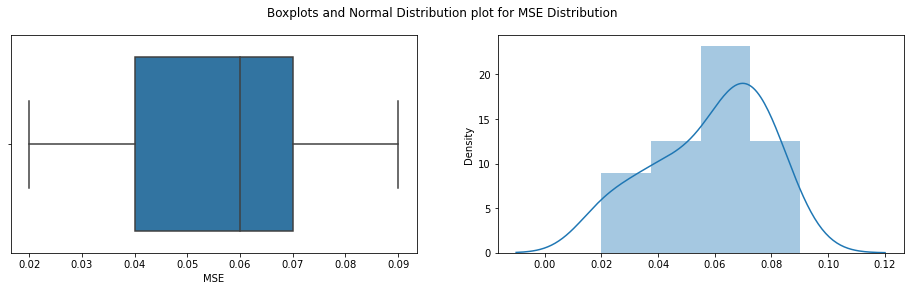

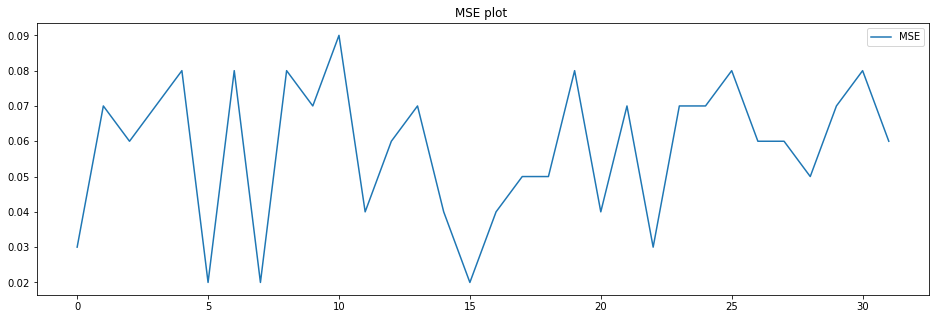


Shapiro_Wilk Test
Statistics=0.947, p=0.1164911240
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.358, p=0.308
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.575
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 99
mean=0.057 ,max=0.096,min=0.017,variance=0.00046


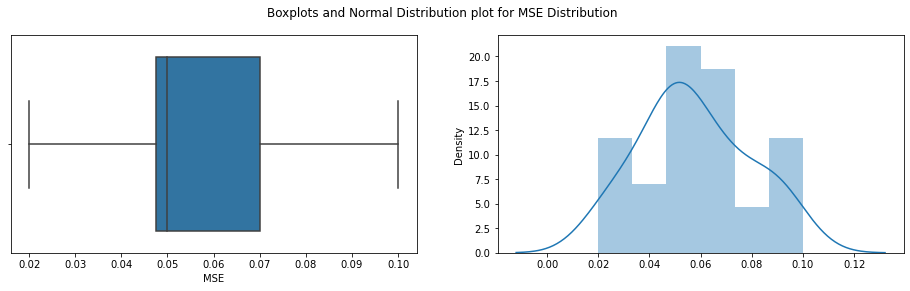

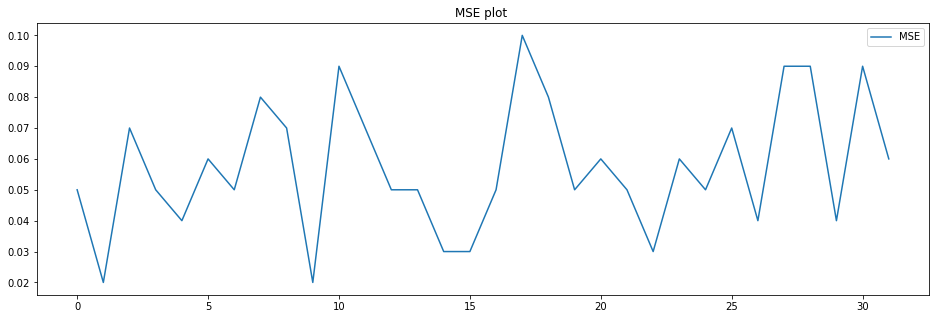


Shapiro_Wilk Test
Statistics=0.958, p=0.2432148755
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.105, p=0.575
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.401
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 100
mean=0.054 ,max=0.095,min=0.018,variance=0.00058


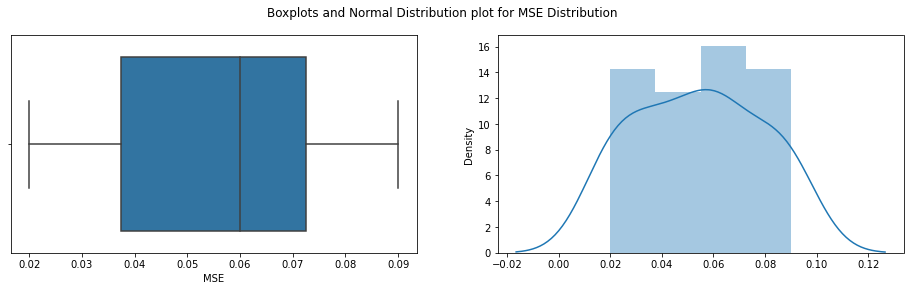

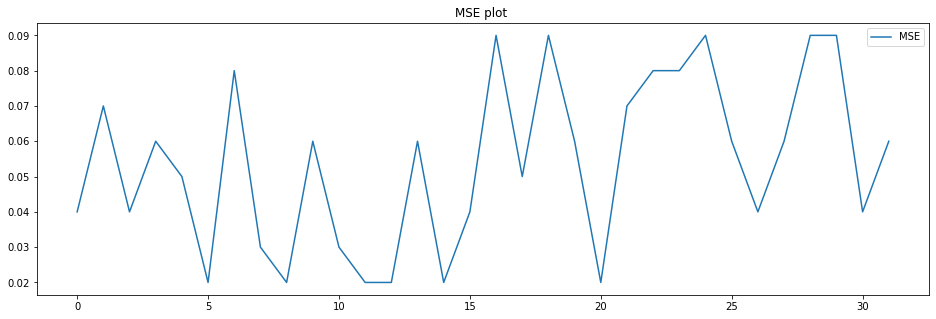


Shapiro_Wilk Test
Statistics=0.933, p=0.0488073602
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=8.051, p=0.018
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.601
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 101
mean=0.052 ,max=0.103,min=0.016,variance=0.00042


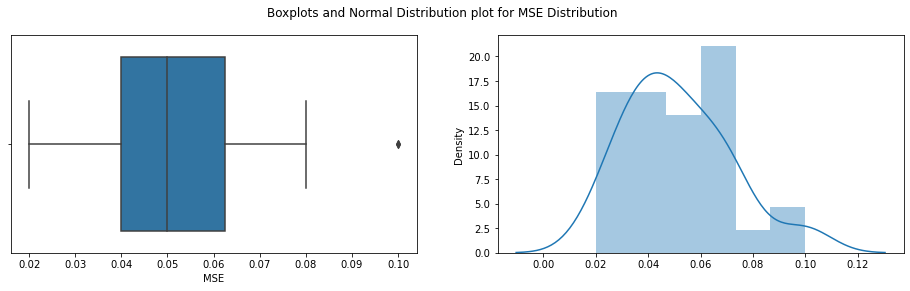

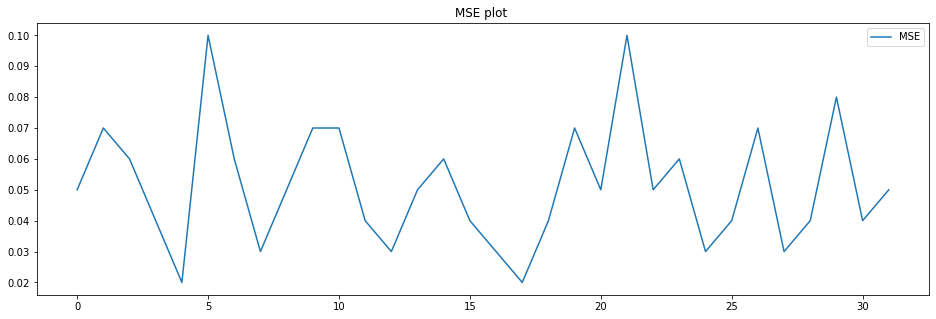


Shapiro_Wilk Test
Statistics=0.959, p=0.2564579248
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.135, p=0.209
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.360
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 102
mean=0.052 ,max=0.097,min=0.013,variance=0.00047


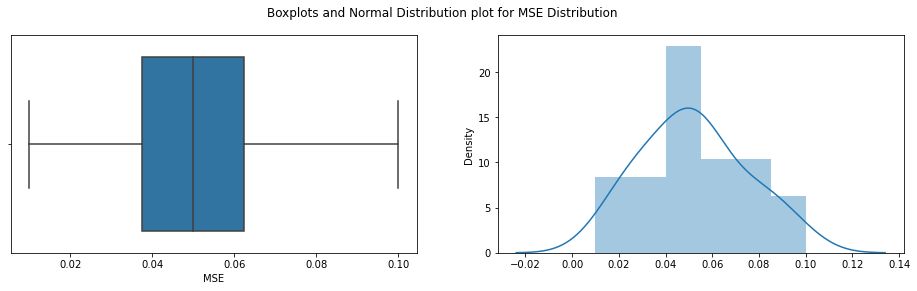

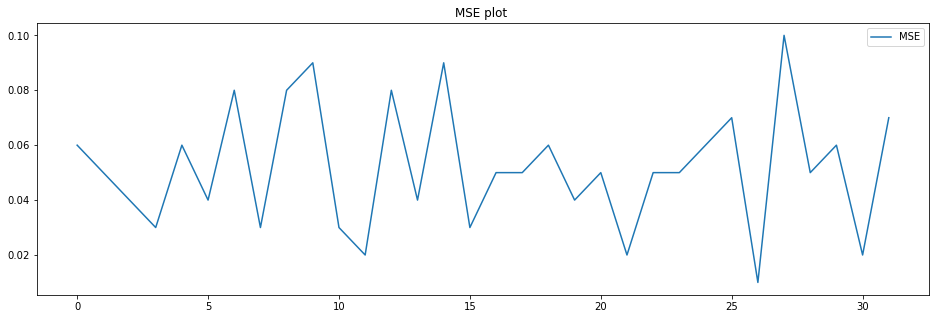


Shapiro_Wilk Test
Statistics=0.974, p=0.6069192886
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.843, p=0.656
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.256
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 103
mean=0.051 ,max=0.094,min=0.01,variance=0.00041


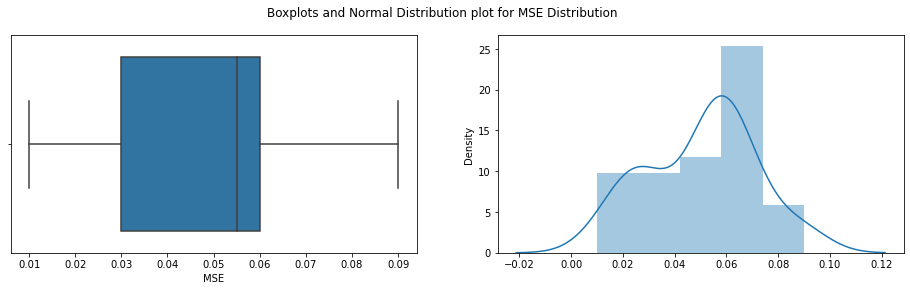

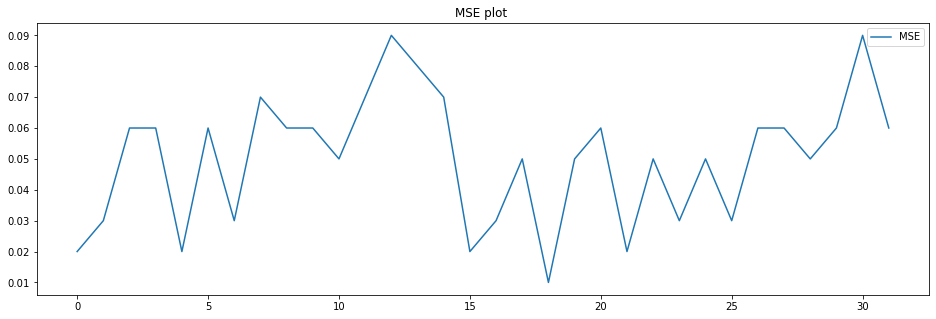


Shapiro_Wilk Test
Statistics=0.956, p=0.2087942511
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.283, p=0.868
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.684
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 104
mean=0.057 ,max=0.113,min=0.01,variance=0.00042


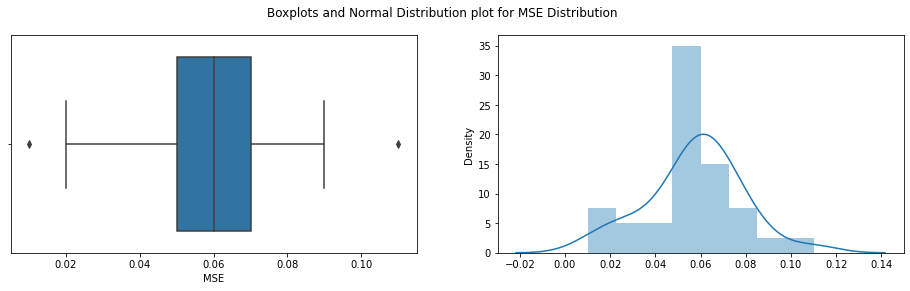

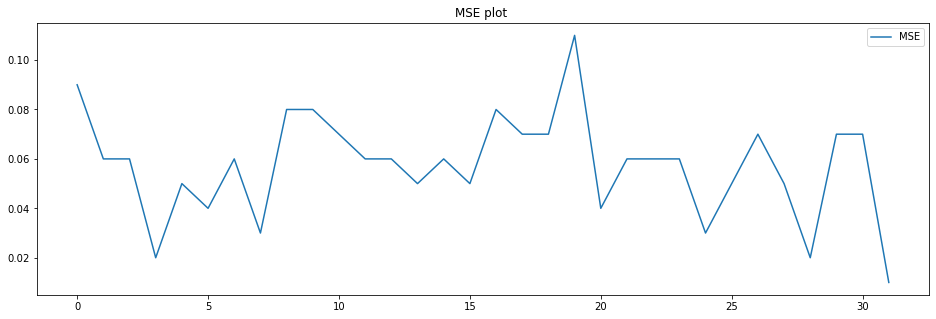


Shapiro_Wilk Test
Statistics=0.962, p=0.3116897345
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.677, p=0.432
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.546
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 105
mean=0.054 ,max=0.128,min=0.009,variance=0.00071


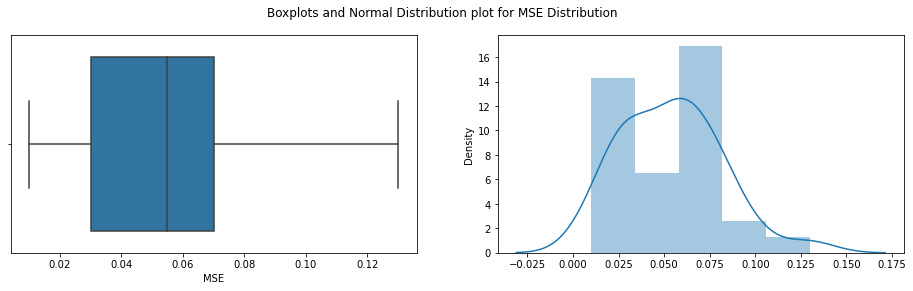

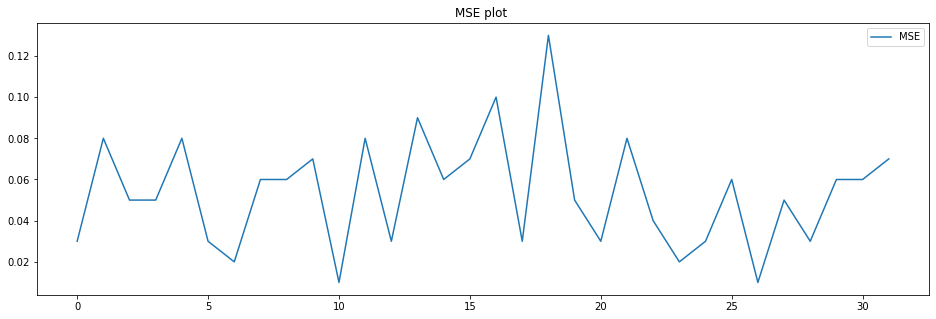


Shapiro_Wilk Test
Statistics=0.967, p=0.4291996956
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.658, p=0.265
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.300
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 106
mean=0.053 ,max=0.091,min=0.013,variance=0.00045


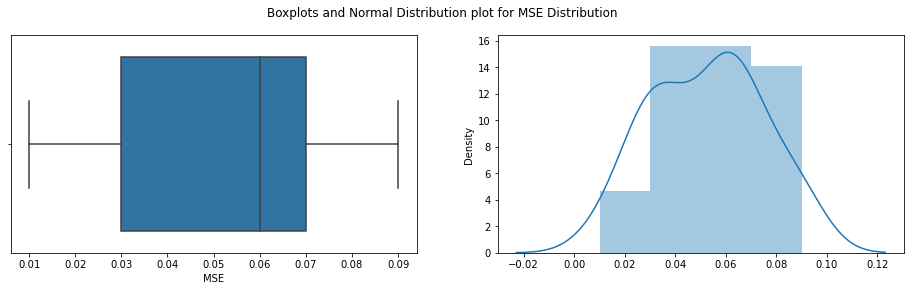

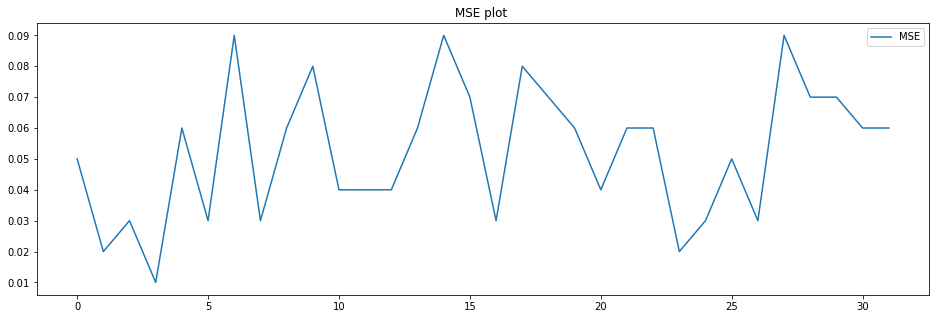


Shapiro_Wilk Test
Statistics=0.960, p=0.2813871503
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.994, p=0.136
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.454
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 107
mean=0.055 ,max=0.116,min=0.015,variance=0.00053


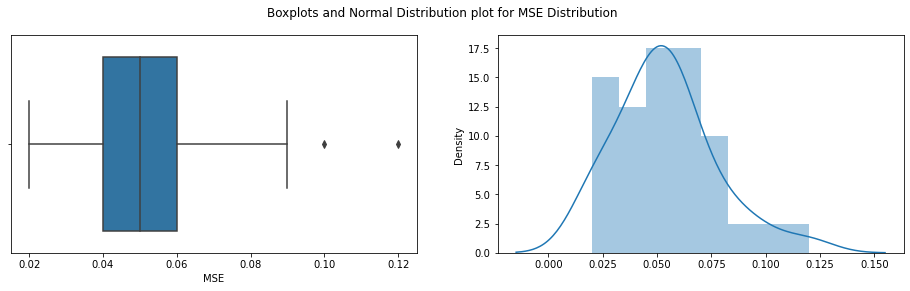

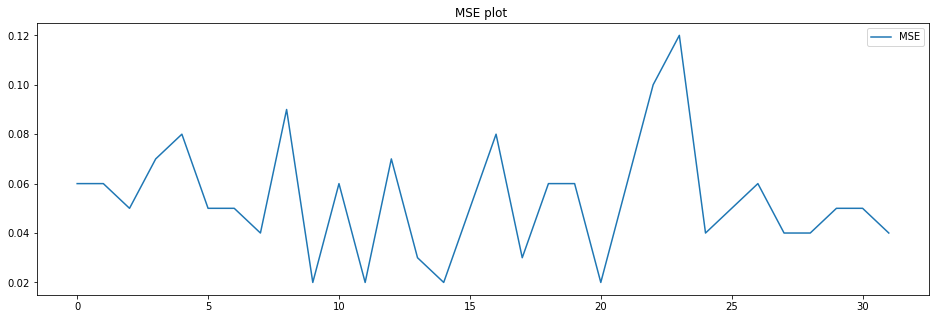


Shapiro_Wilk Test
Statistics=0.966, p=0.3984597623
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.311, p=0.191
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.342
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 108
mean=0.054 ,max=0.087,min=0.021,variance=0.00039


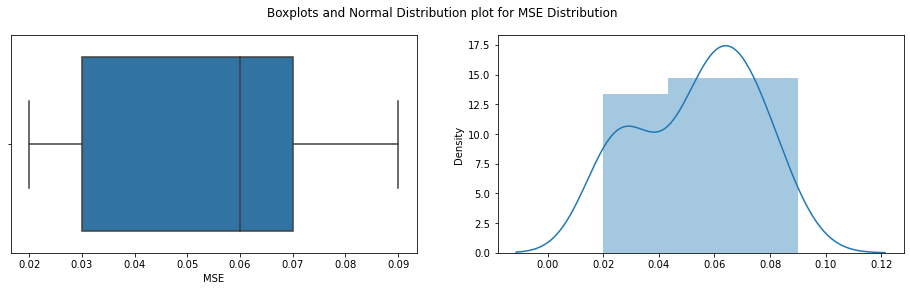

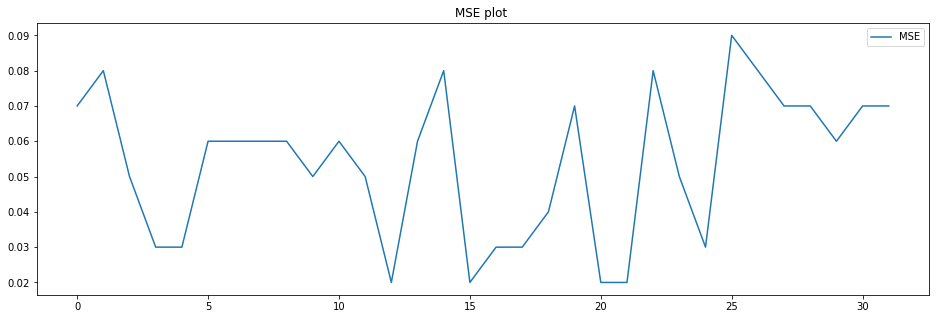


Shapiro_Wilk Test
Statistics=0.935, p=0.0544490479
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.079, p=0.079
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.677
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 109
mean=0.05 ,max=0.088,min=0.012,variance=0.00042


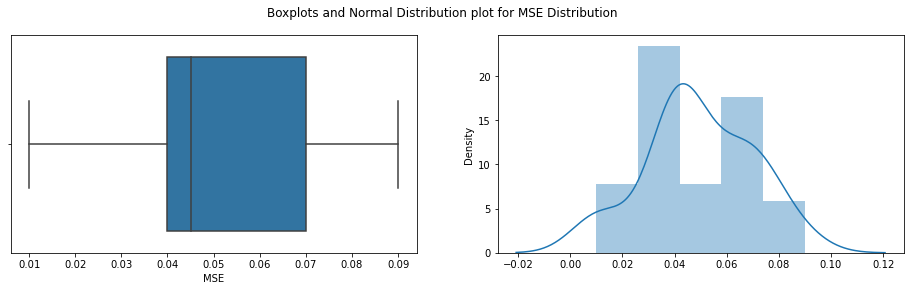

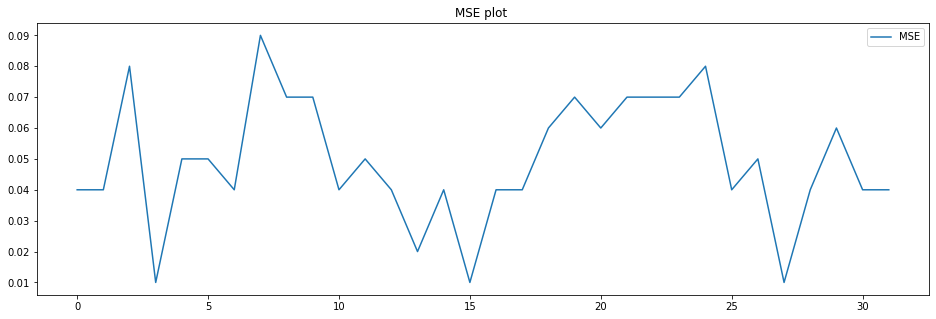


Shapiro_Wilk Test
Statistics=0.957, p=0.2323279977
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.983, p=0.612
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.487
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 110
mean=0.05 ,max=0.114,min=0.014,variance=0.00055


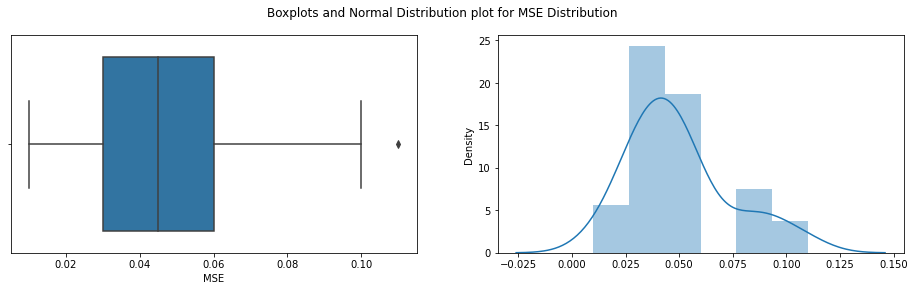

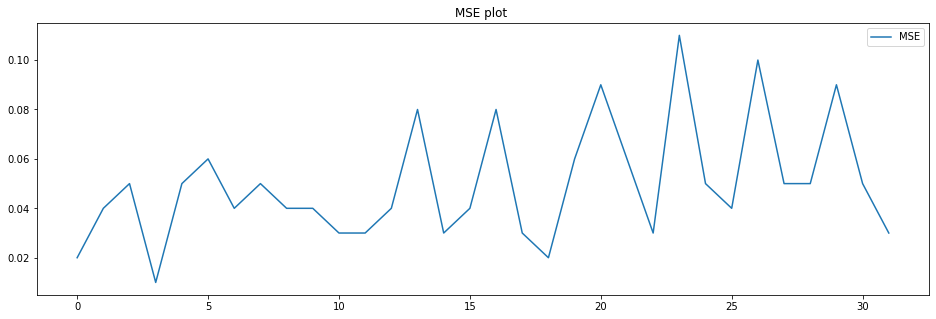


Shapiro_Wilk Test
Statistics=0.928, p=0.0336348861
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=6.057, p=0.048
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.826
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 111
mean=0.056 ,max=0.11,min=0.025,variance=0.00031


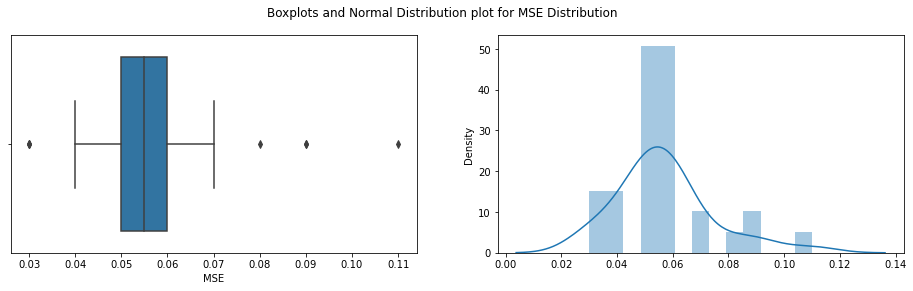

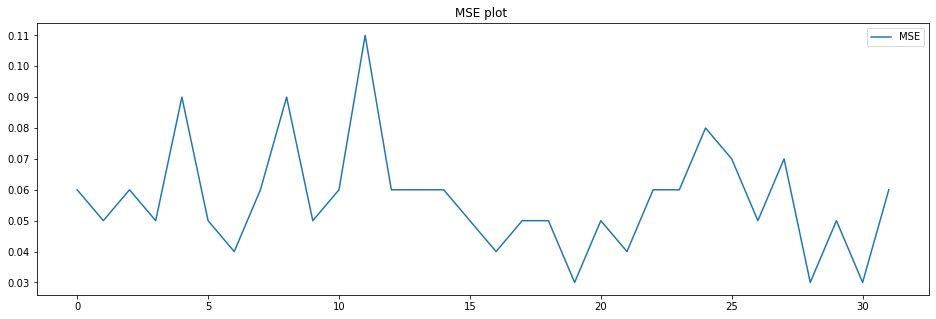


Shapiro_Wilk Test
Statistics=0.932, p=0.0446311533
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=7.821, p=0.020
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.724
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 112
mean=0.049 ,max=0.105,min=0.024,variance=0.00033


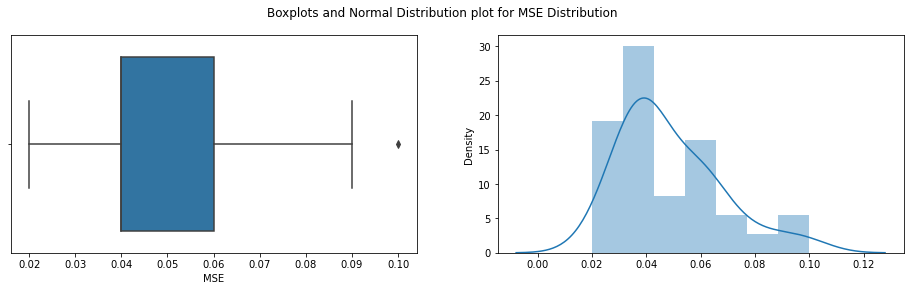

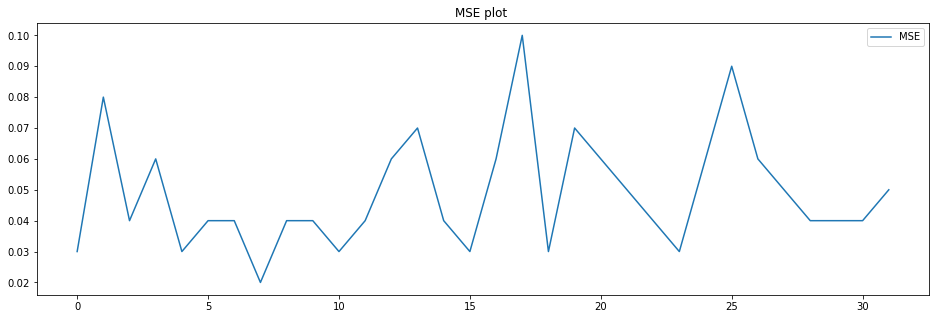


Shapiro_Wilk Test
Statistics=0.898, p=0.0053688926
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=9.897, p=0.007
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.035
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 113
mean=0.05 ,max=0.083,min=0.012,variance=0.00034


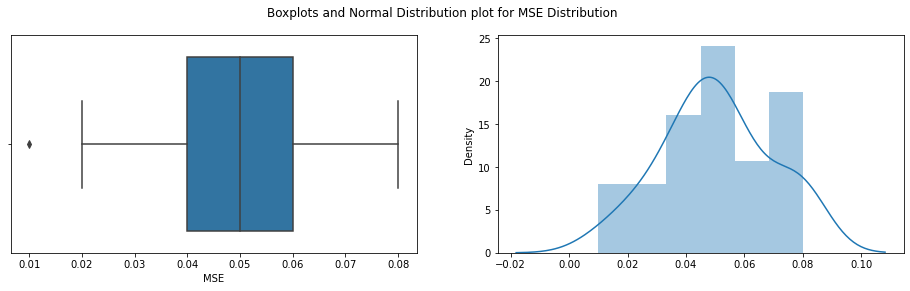

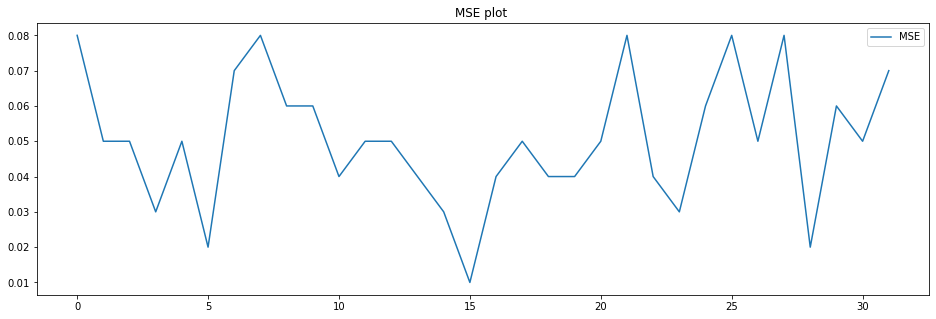


Shapiro_Wilk Test
Statistics=0.976, p=0.6788585186
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.462, p=0.794
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.234
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 114
mean=0.052 ,max=0.118,min=0.012,variance=0.00061


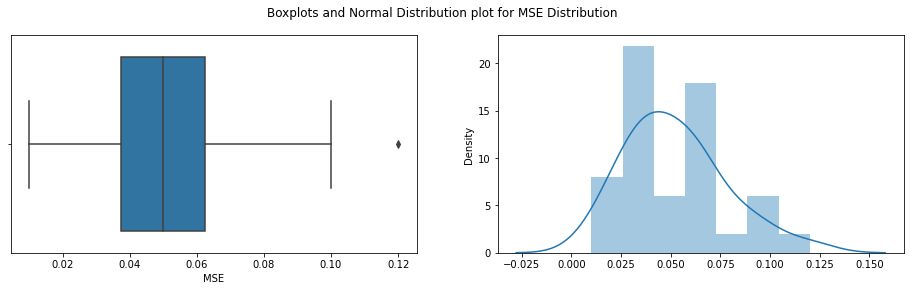

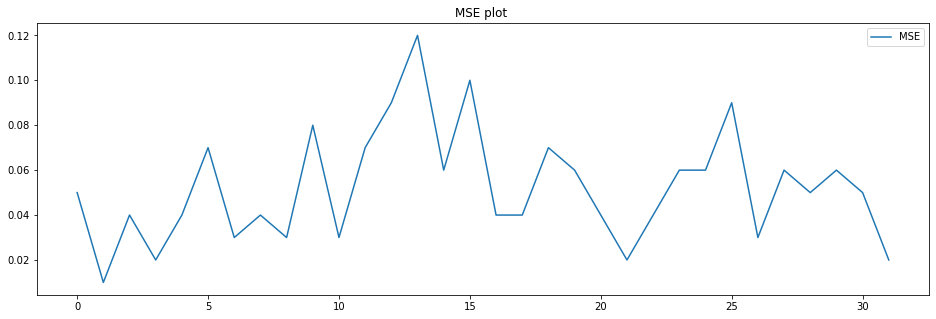


Shapiro_Wilk Test
Statistics=0.960, p=0.2740055323
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.196, p=0.202
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.396
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 115
mean=0.057 ,max=0.107,min=0.015,variance=0.00058


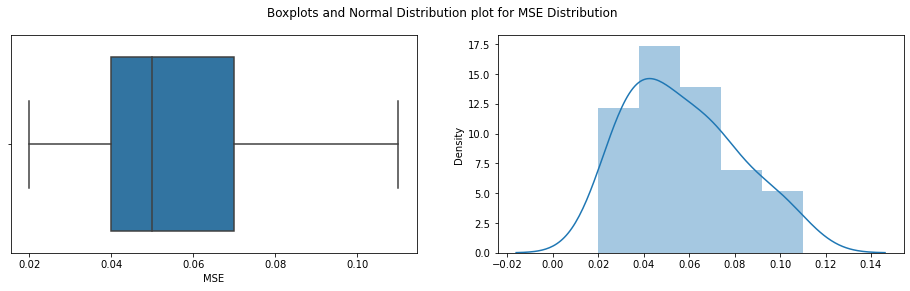

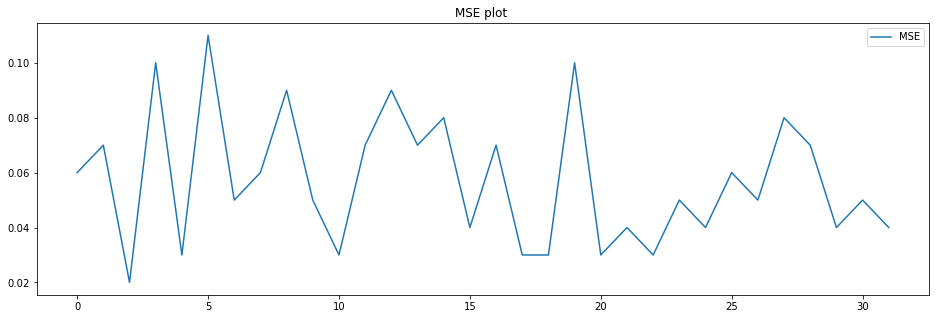


Shapiro_Wilk Test
Statistics=0.953, p=0.1790352464
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.806, p=0.246
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.548
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 116
mean=0.056 ,max=0.086,min=0.024,variance=0.00024


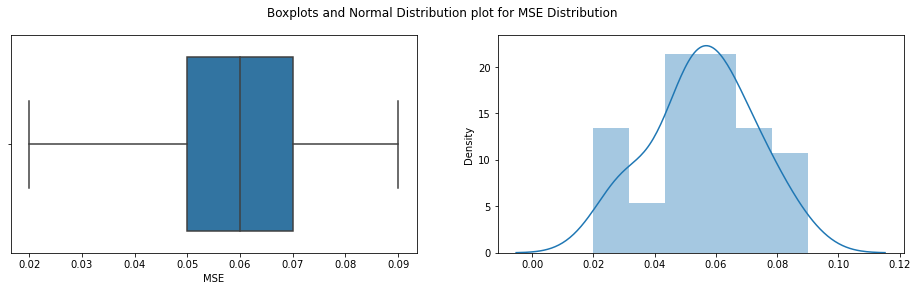

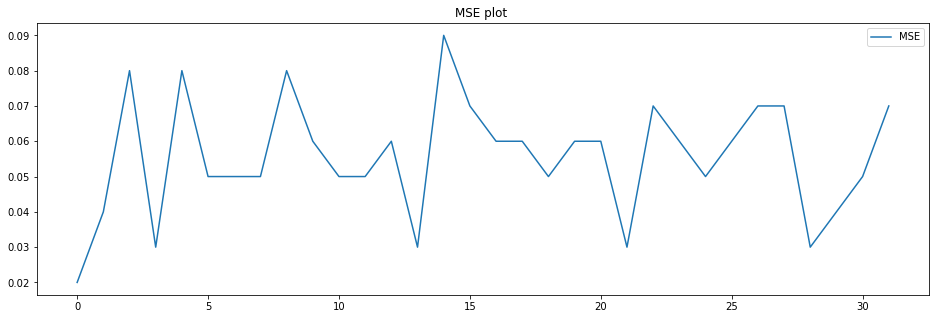


Shapiro_Wilk Test
Statistics=0.979, p=0.7693113685
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.685, p=0.710
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.223
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 117
mean=0.05 ,max=0.097,min=0.011,variance=0.00045


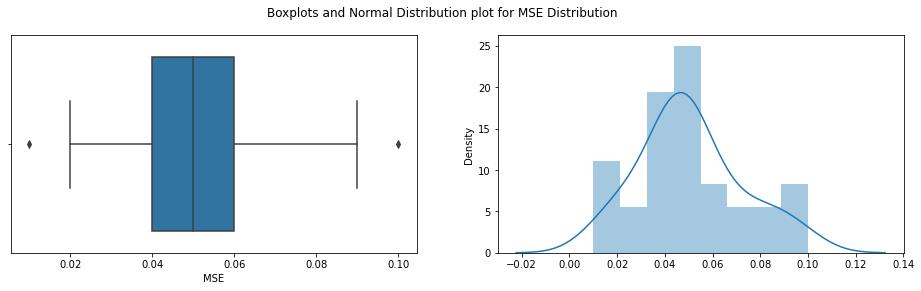

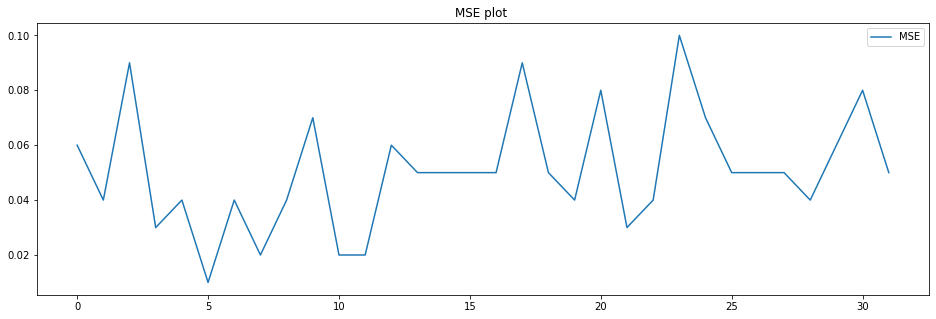


Shapiro_Wilk Test
Statistics=0.955, p=0.2059091032
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.917, p=0.383
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.588
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 118
mean=0.054 ,max=0.101,min=0.022,variance=0.00048


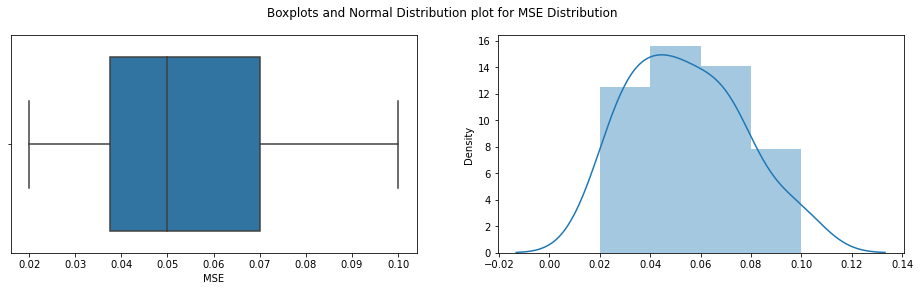

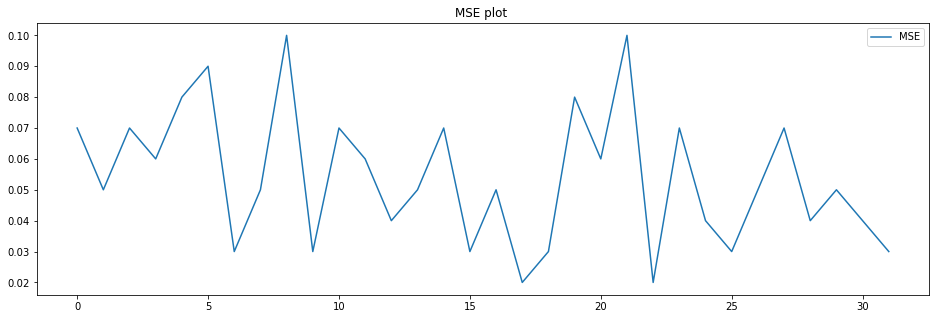


Shapiro_Wilk Test
Statistics=0.956, p=0.2191388160
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.634, p=0.442
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.342
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 119
mean=0.05 ,max=0.089,min=0.02,variance=0.00027


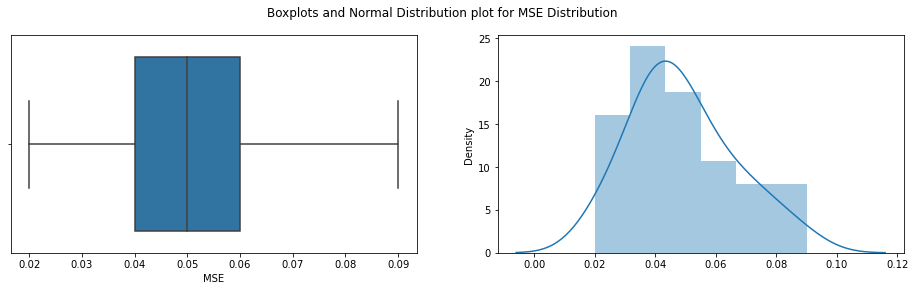

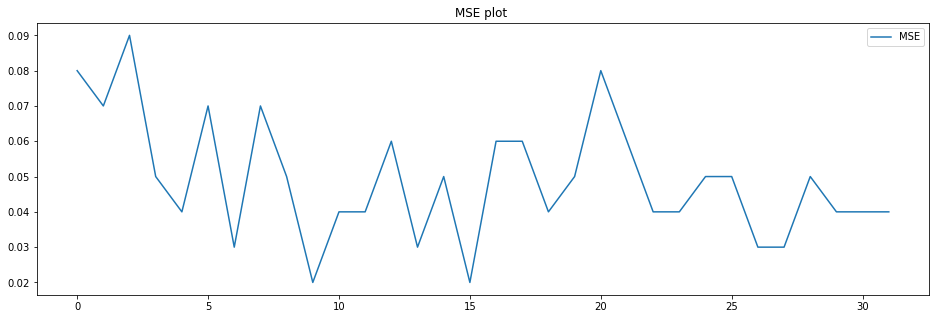


Shapiro_Wilk Test
Statistics=0.959, p=0.2508924603
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.338, p=0.311
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.548
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 120
mean=0.054 ,max=0.101,min=0.012,variance=0.00043


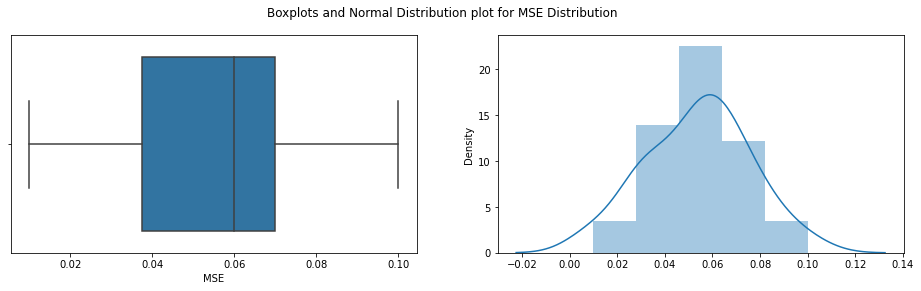

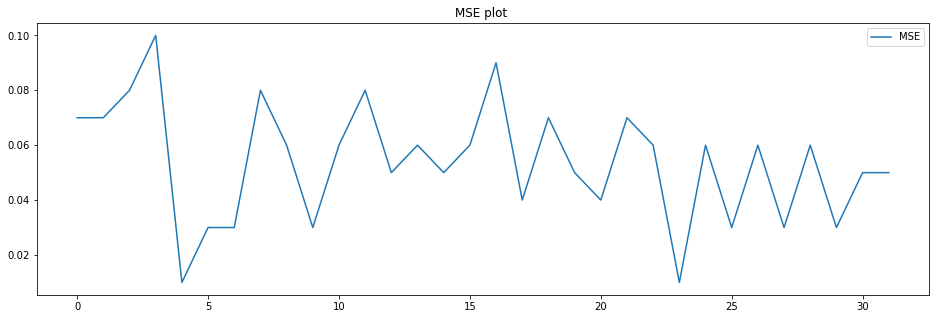


Shapiro_Wilk Test
Statistics=0.984, p=0.8944594264
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.008, p=0.996
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.220
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 121
mean=0.053 ,max=0.105,min=0.017,variance=0.00047


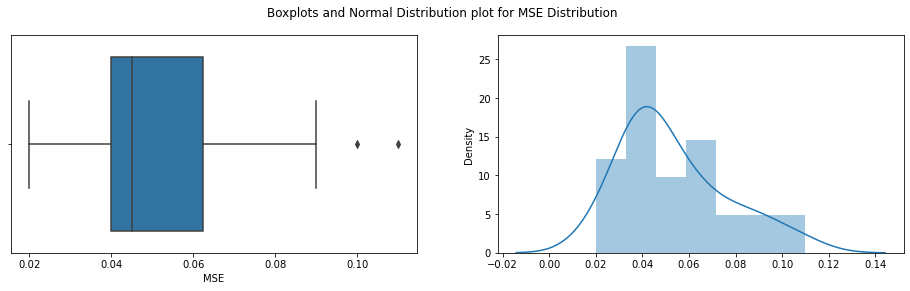

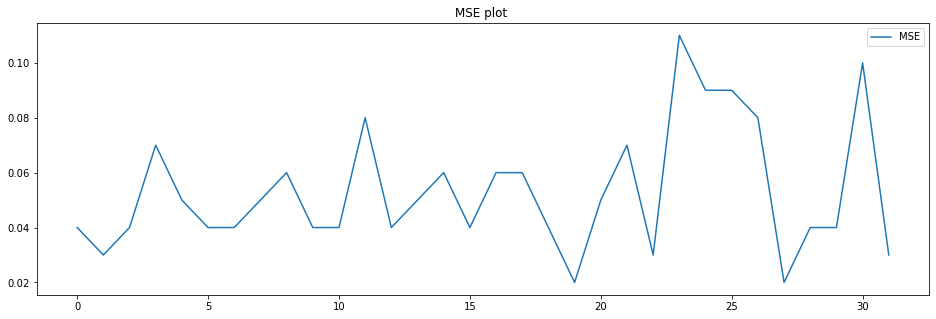


Shapiro_Wilk Test
Statistics=0.934, p=0.0518265478
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.336, p=0.189
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.861
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 122
mean=0.054 ,max=0.095,min=0.025,variance=0.00044


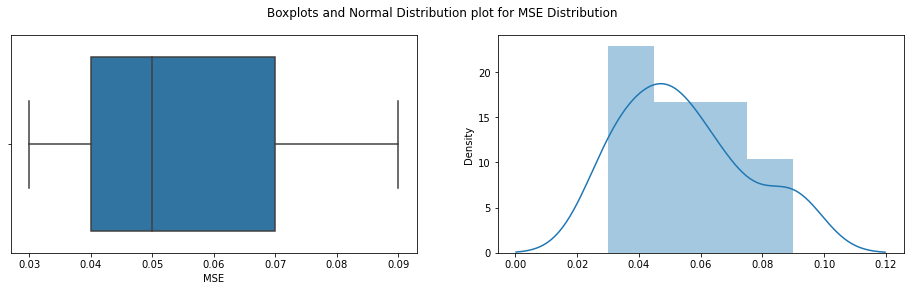

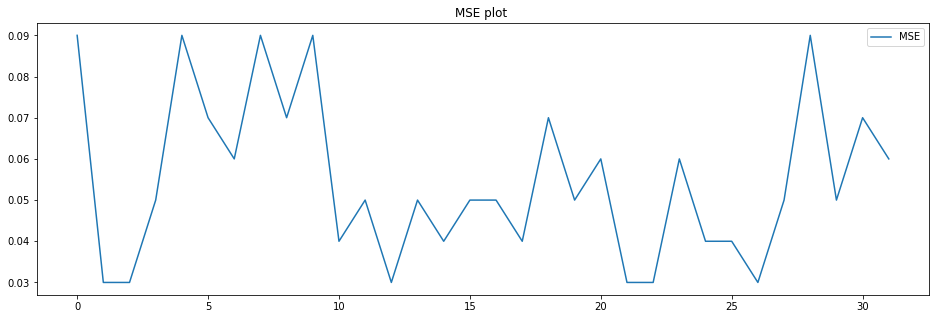


Shapiro_Wilk Test
Statistics=0.929, p=0.0360717811
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=2.972, p=0.226
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.661
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 123
mean=0.05 ,max=0.133,min=0.018,variance=0.00056


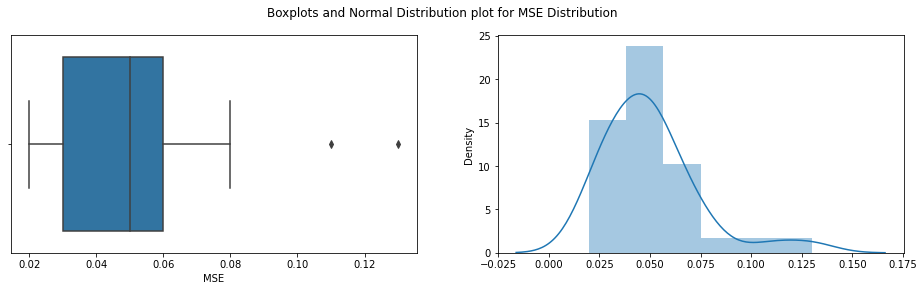

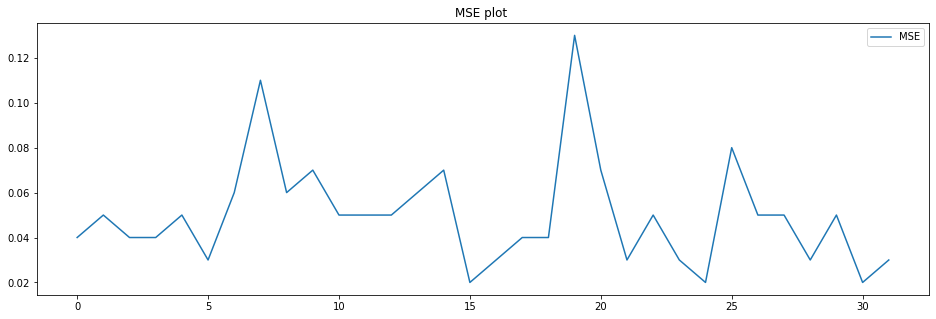


Shapiro_Wilk Test
Statistics=0.875, p=0.0015146071
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=18.581, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.024
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 124
mean=0.05 ,max=0.087,min=0.008,variance=0.00044


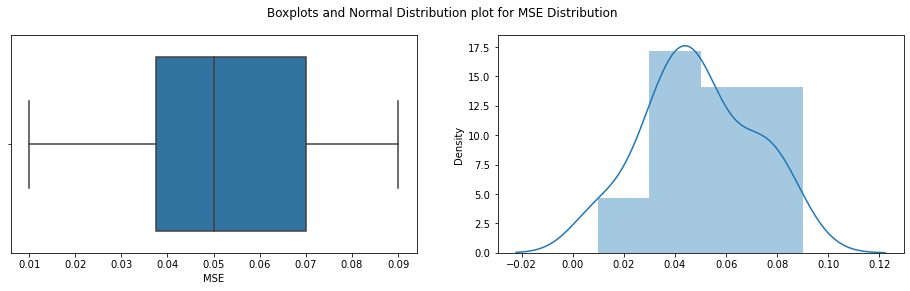

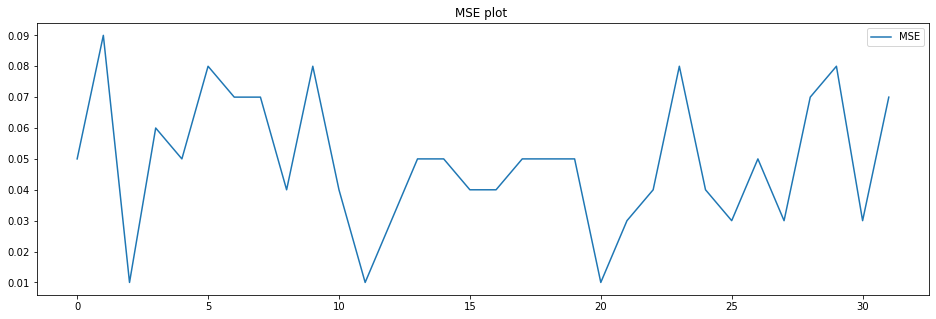


Shapiro_Wilk Test
Statistics=0.970, p=0.4955940247
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.527, p=0.769
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.283
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 125
mean=0.052 ,max=0.087,min=0.003,variance=0.00037


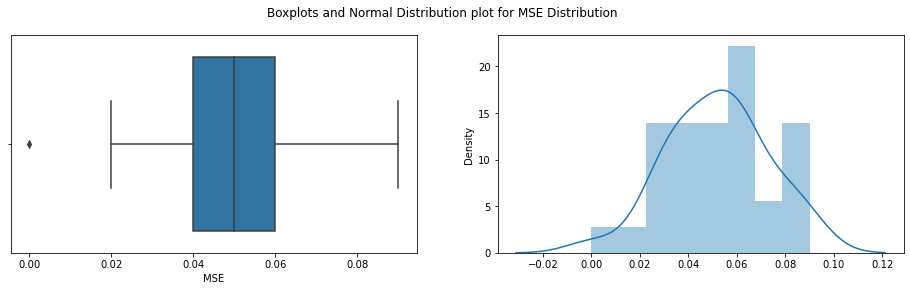

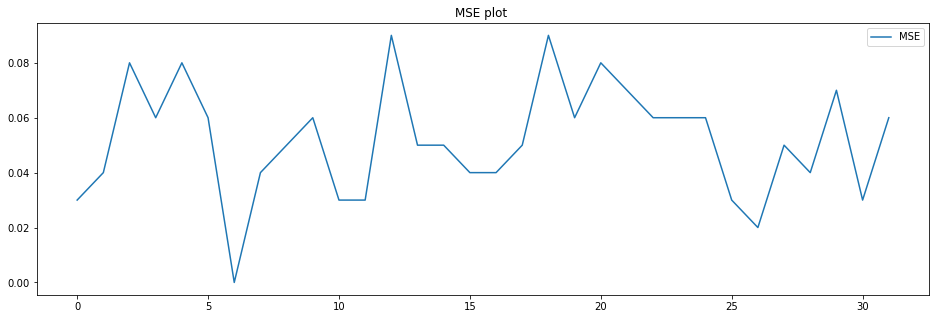


Shapiro_Wilk Test
Statistics=0.984, p=0.9067142606
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.251, p=0.882
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.167
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 126
mean=0.053 ,max=0.113,min=0.01,variance=0.00082


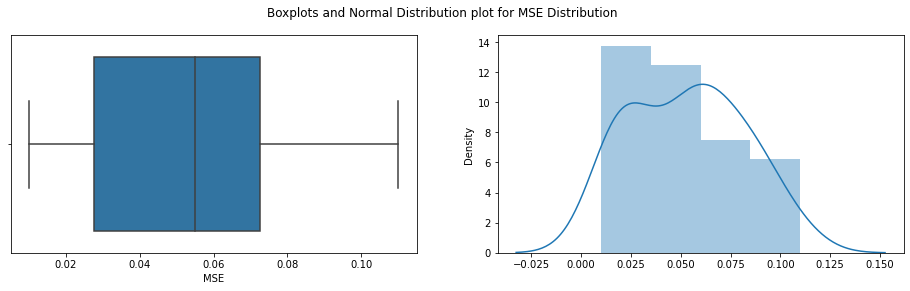

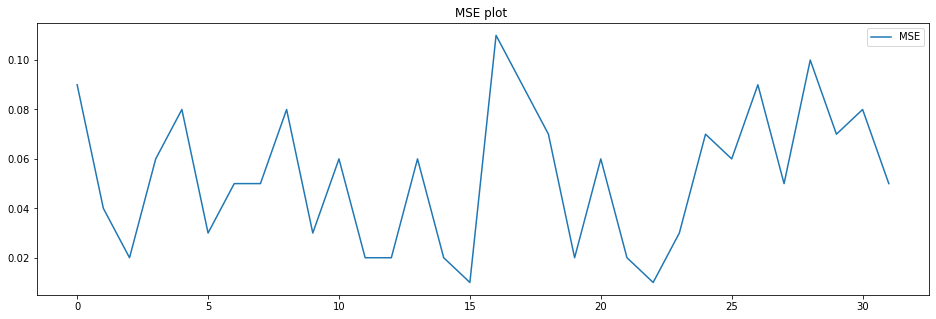


Shapiro_Wilk Test
Statistics=0.947, p=0.1179875955
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.079, p=0.214
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.555
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 127
mean=0.052 ,max=0.112,min=0.016,variance=0.00043


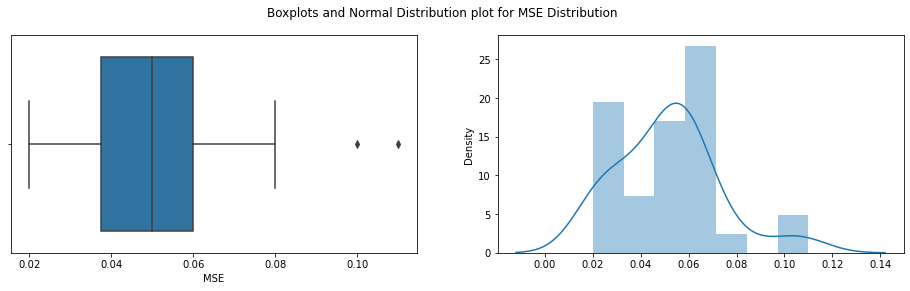

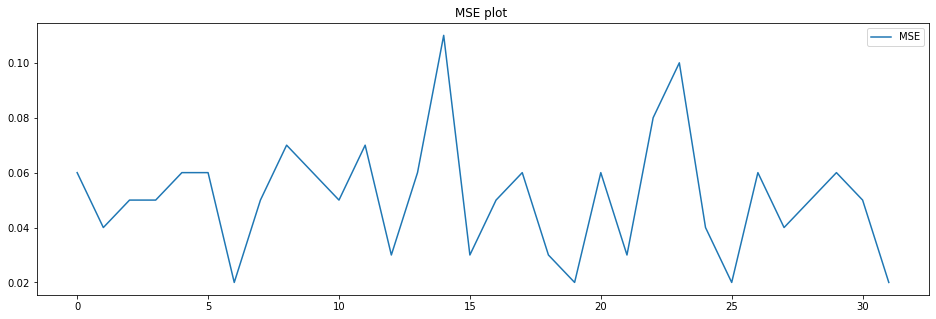


Shapiro_Wilk Test
Statistics=0.955, p=0.1958050430
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.981, p=0.083
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.422
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 128
mean=0.055 ,max=0.09,min=0.021,variance=0.00035


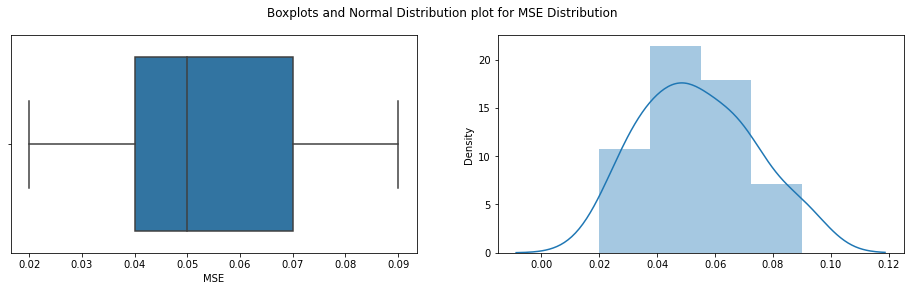

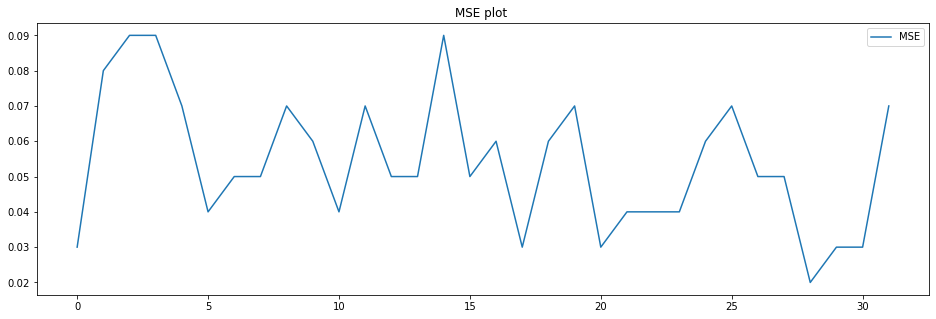


Shapiro_Wilk Test
Statistics=0.970, p=0.4970606565
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.064, p=0.356
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.260
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 129
mean=0.05 ,max=0.087,min=0.021,variance=0.00025


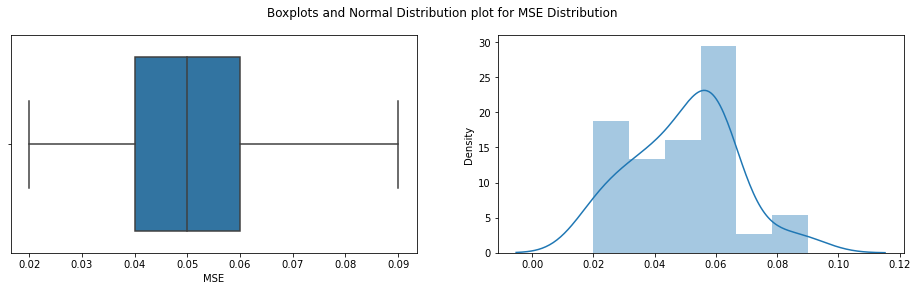

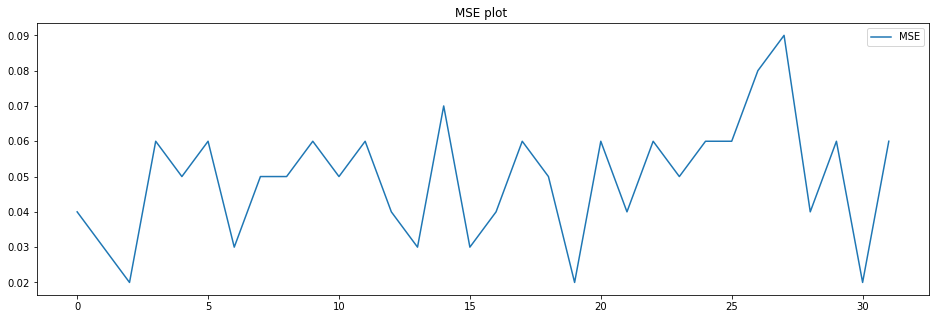


Shapiro_Wilk Test
Statistics=0.976, p=0.6777656078
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.019, p=0.991
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.269
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 130
mean=0.048 ,max=0.121,min=0.013,variance=0.00042


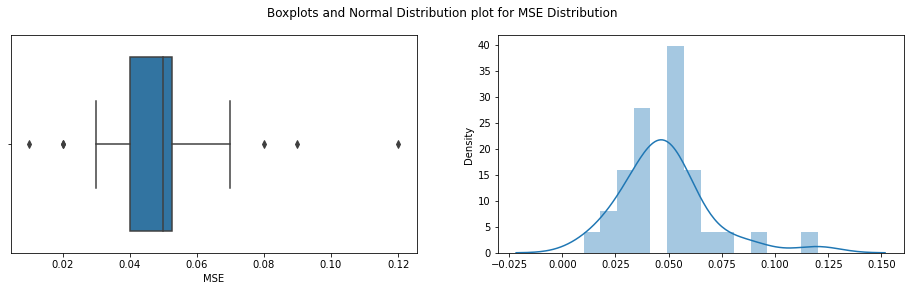

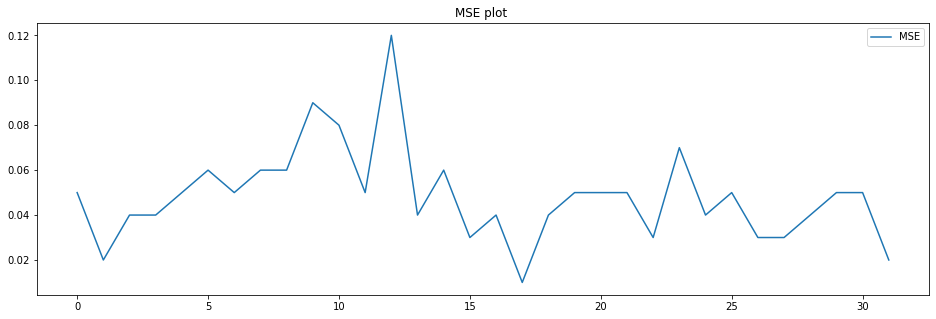


Shapiro_Wilk Test
Statistics=0.892, p=0.0039163344
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=17.579, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.992
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 131
mean=0.05 ,max=0.094,min=0.013,variance=0.00055


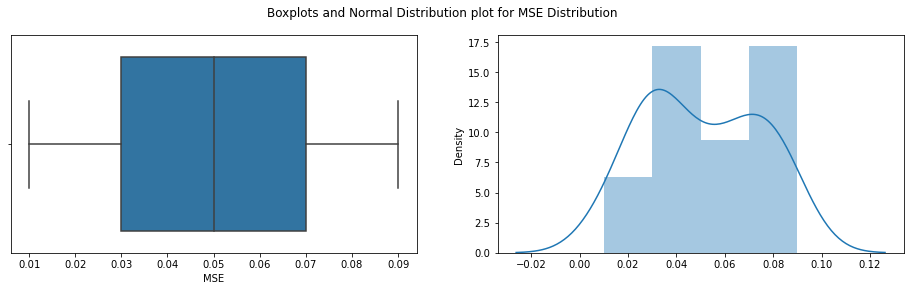

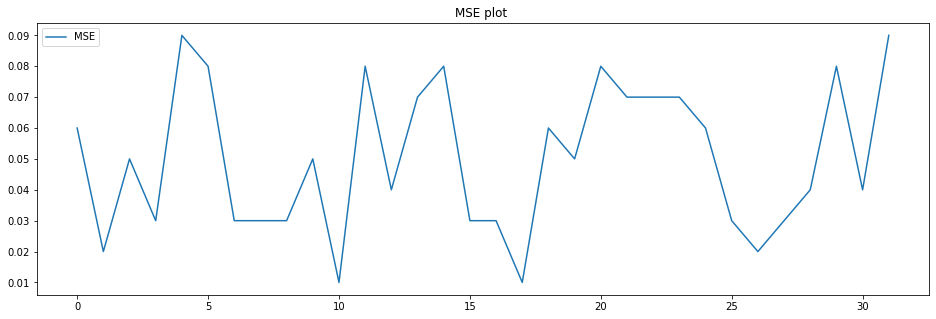


Shapiro_Wilk Test
Statistics=0.943, p=0.0884055123
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=6.466, p=0.039
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.632
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 132
mean=0.054 ,max=0.095,min=0.02,variance=0.0003


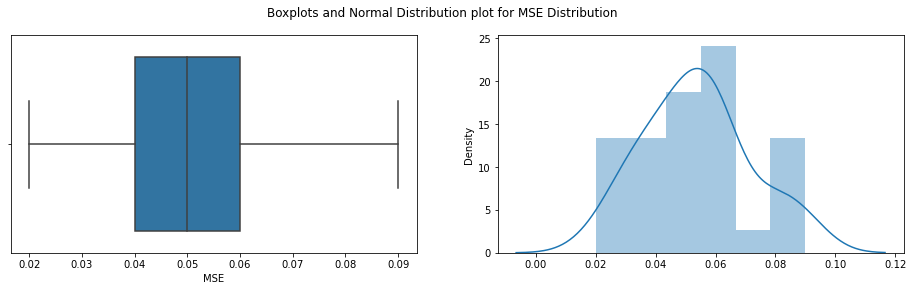

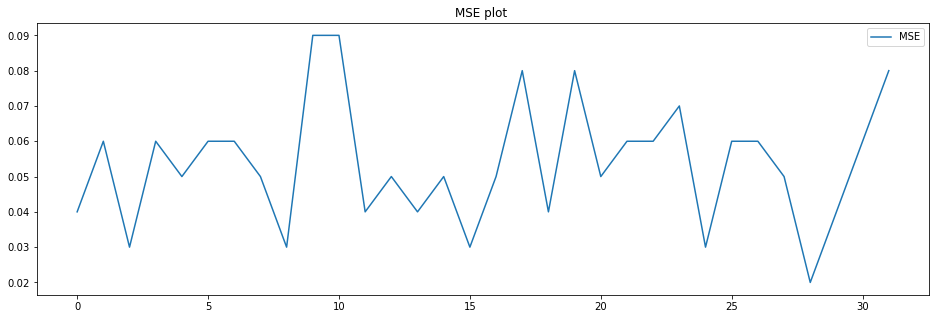


Shapiro_Wilk Test
Statistics=0.979, p=0.7836140394
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.018, p=0.601
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.238
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 133
mean=0.062 ,max=0.12,min=0.013,variance=0.00075


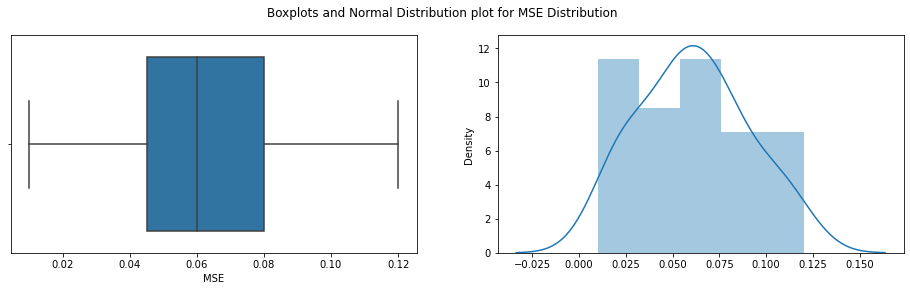

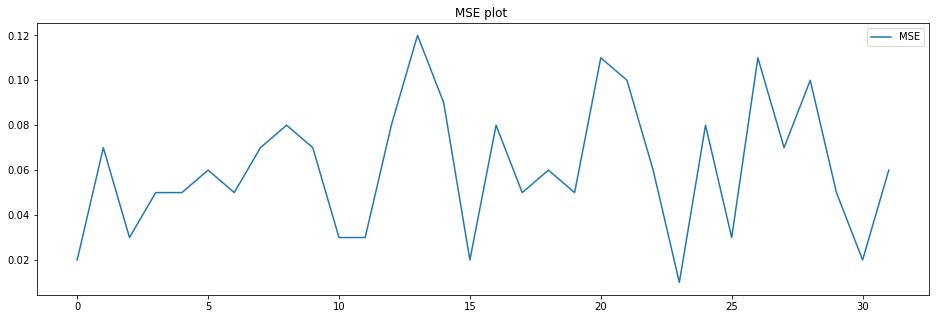


Shapiro_Wilk Test
Statistics=0.979, p=0.7583299875
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.716, p=0.699
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.178
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 134
mean=0.049 ,max=0.082,min=0.013,variance=0.00041


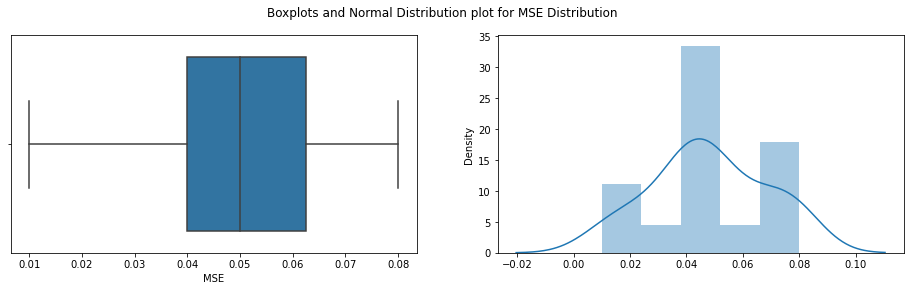

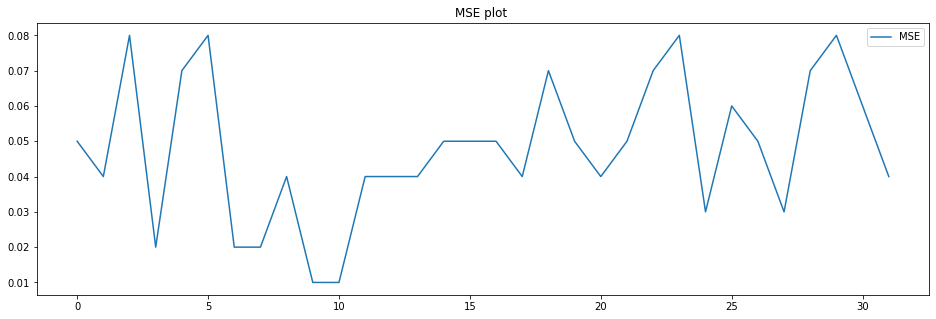


Shapiro_Wilk Test
Statistics=0.948, p=0.1290951520
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.616, p=0.446
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.465
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 135
mean=0.052 ,max=0.09,min=0.023,variance=0.00033


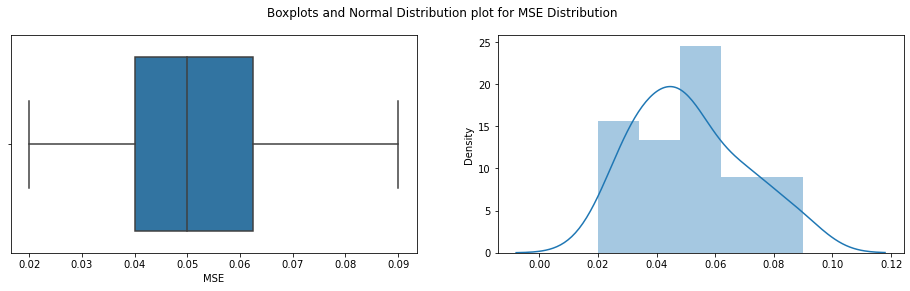

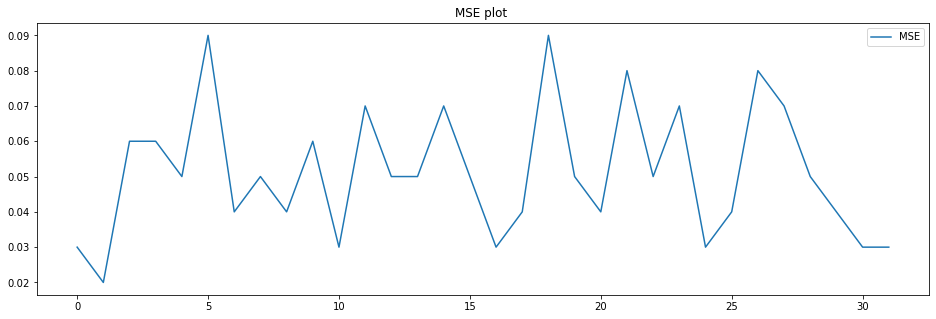


Shapiro_Wilk Test
Statistics=0.955, p=0.2016897798
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.143, p=0.342
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.452
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 136
mean=0.06 ,max=0.096,min=0.021,variance=0.00045


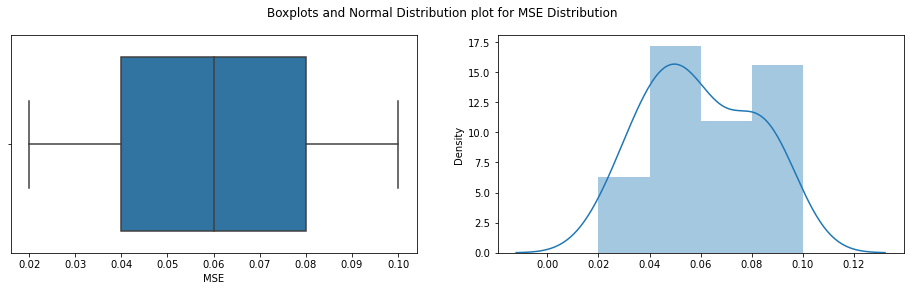

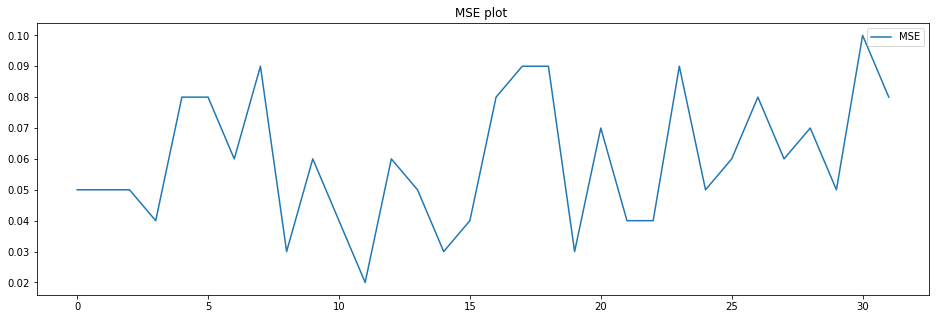


Shapiro_Wilk Test
Statistics=0.956, p=0.2097679824
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.308, p=0.116
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.425
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 137
mean=0.05 ,max=0.112,min=0.006,variance=0.00061


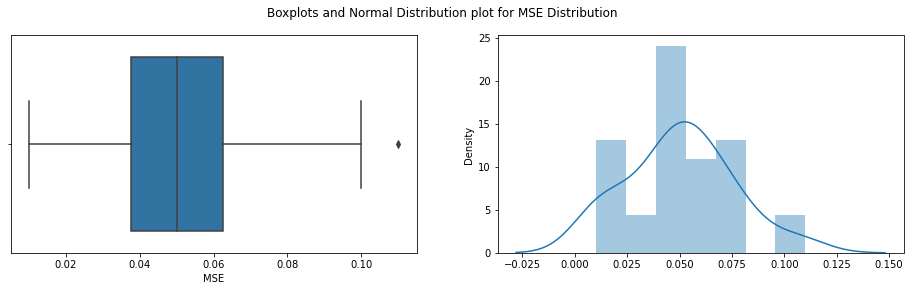

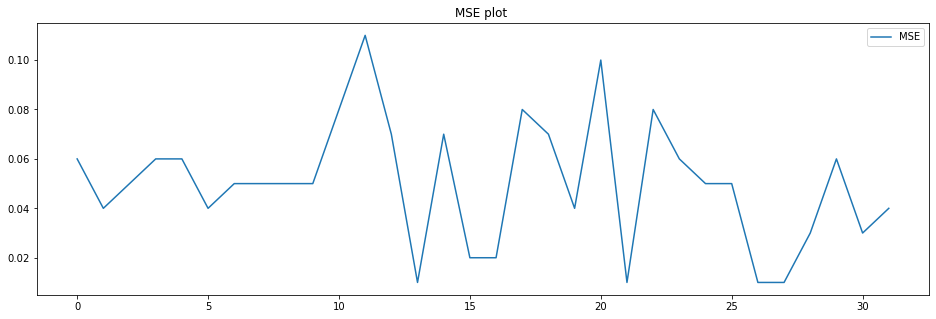


Shapiro_Wilk Test
Statistics=0.973, p=0.5939945579
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.616, p=0.735
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.271
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 138
mean=0.055 ,max=0.096,min=0.014,variance=0.0004


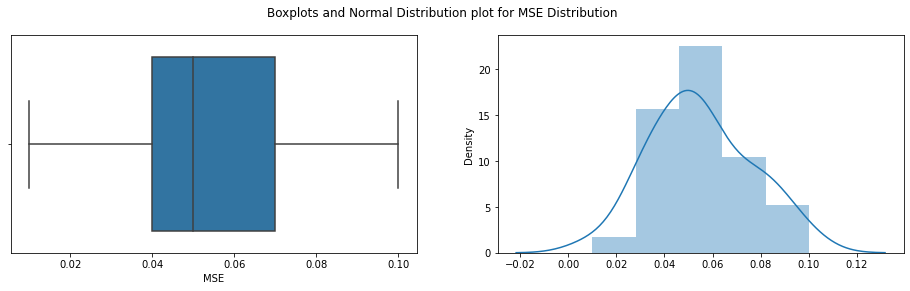

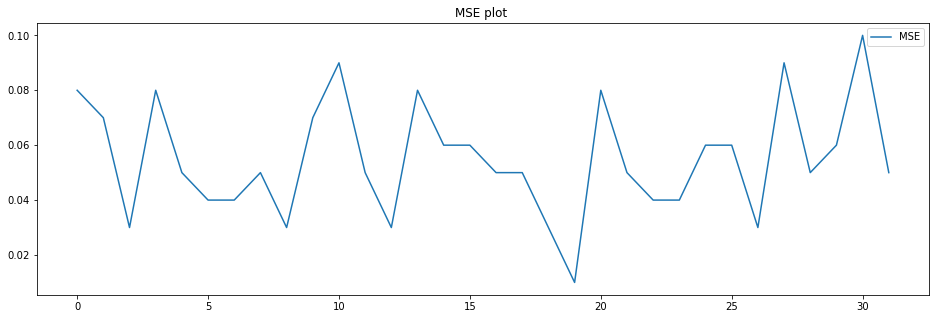


Shapiro_Wilk Test
Statistics=0.967, p=0.4314985871
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.861, p=0.650
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.438
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 139
mean=0.058 ,max=0.102,min=0.016,variance=0.00055


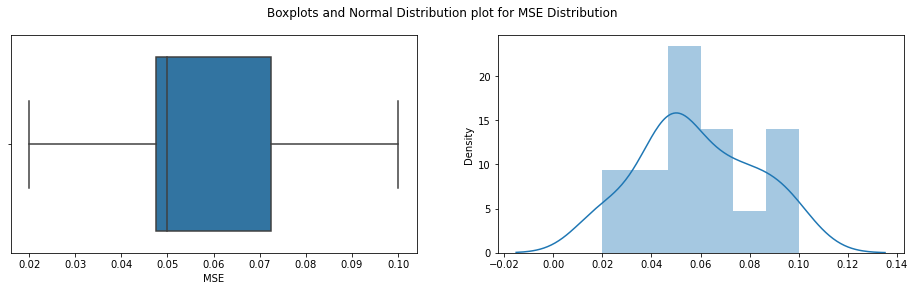

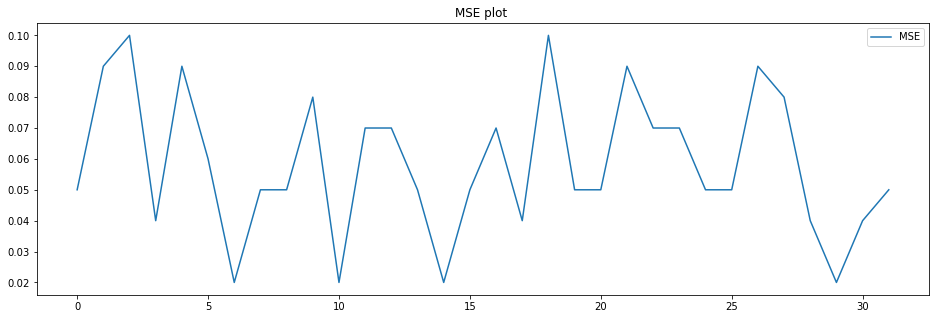


Shapiro_Wilk Test
Statistics=0.957, p=0.2334317118
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.041, p=0.360
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.494
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 140
mean=0.056 ,max=0.1,min=0.013,variance=0.00047


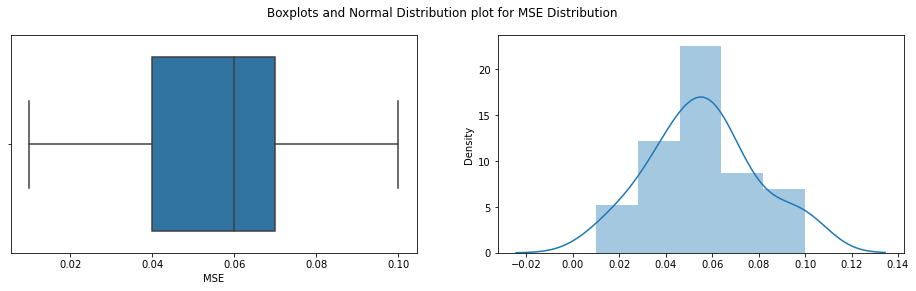

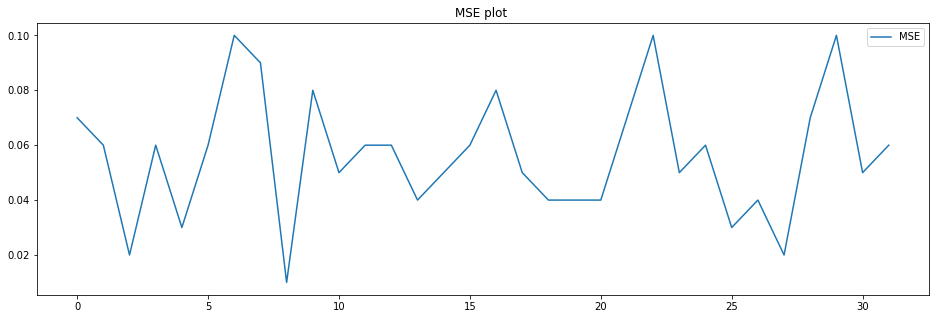


Shapiro_Wilk Test
Statistics=0.970, p=0.5093205571
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.355, p=0.837
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.341
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 141
mean=0.059 ,max=0.091,min=0.011,variance=0.00028


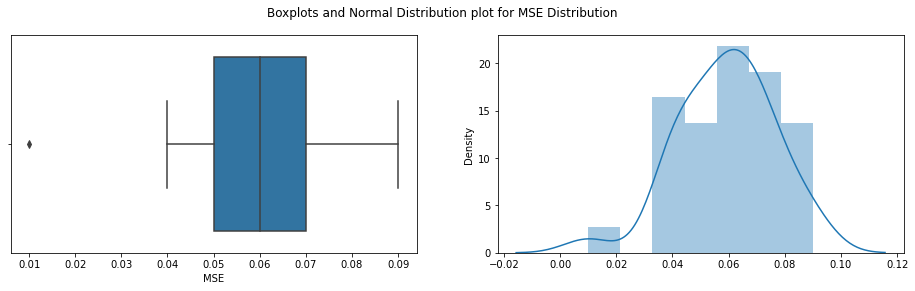

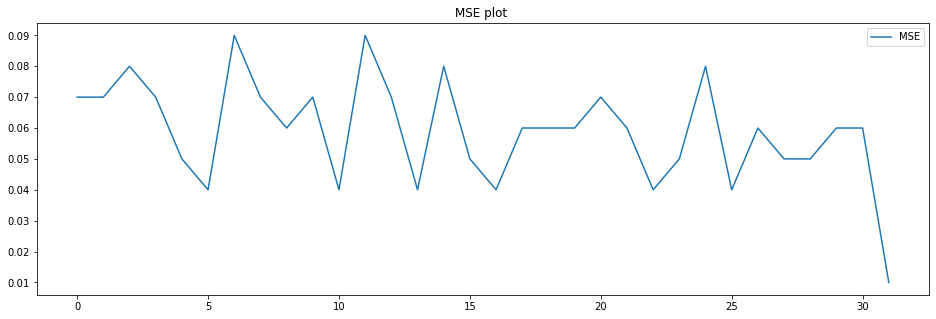


Shapiro_Wilk Test
Statistics=0.978, p=0.7301496267
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.481, p=0.289
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.180
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 142
mean=0.056 ,max=0.125,min=0.02,variance=0.00049


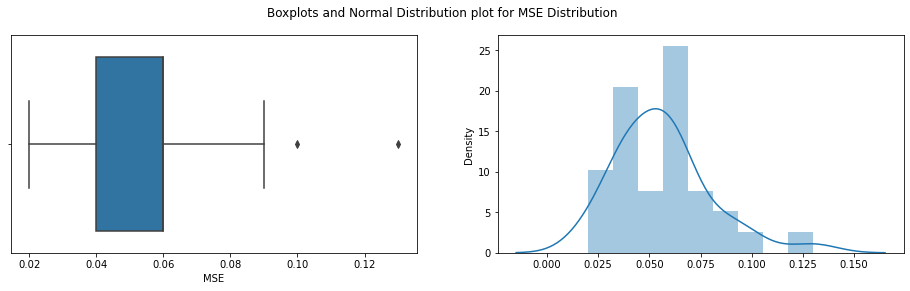

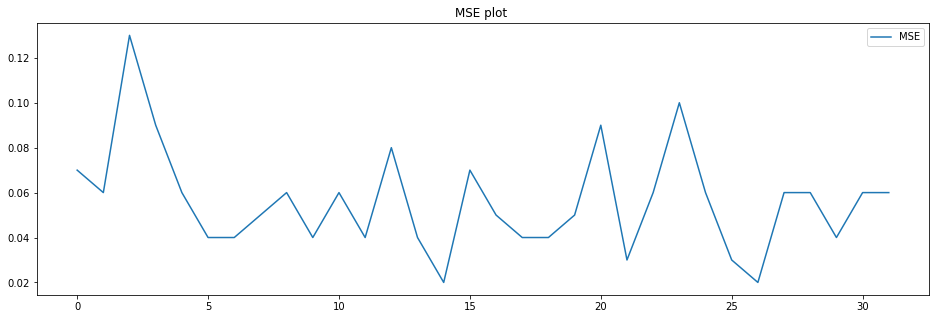


Shapiro_Wilk Test
Statistics=0.926, p=0.0308895502
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=9.349, p=0.009
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.760
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 143
mean=0.055 ,max=0.124,min=0.019,variance=0.00056


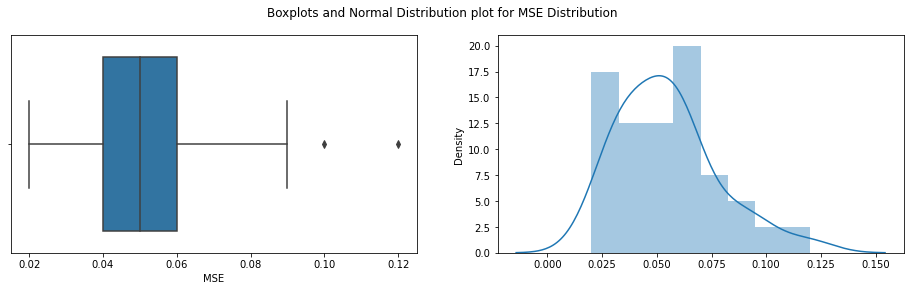

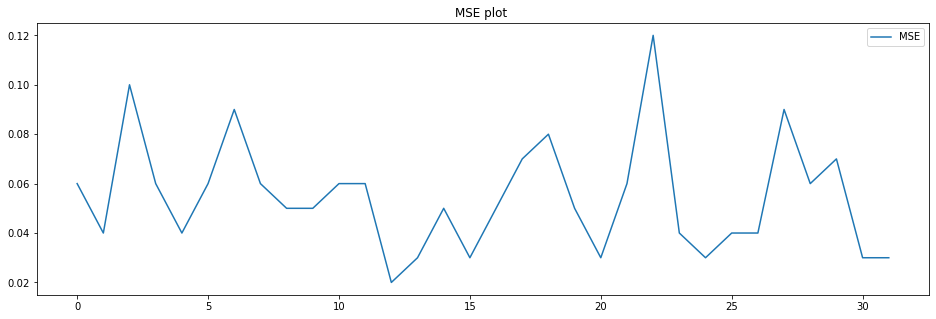


Shapiro_Wilk Test
Statistics=0.942, p=0.0847206116
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.729, p=0.057
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.535
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 144
mean=0.052 ,max=0.106,min=0.008,variance=0.00062


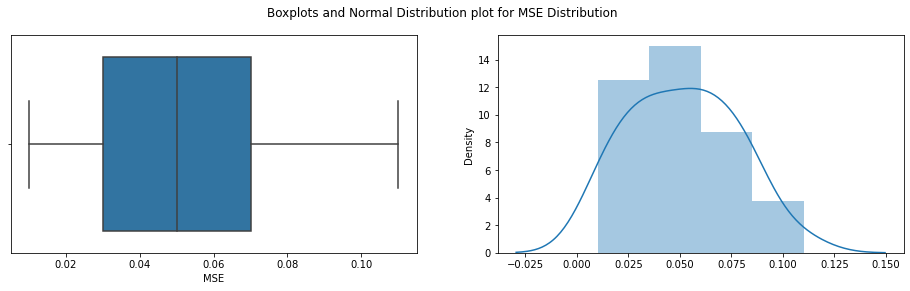

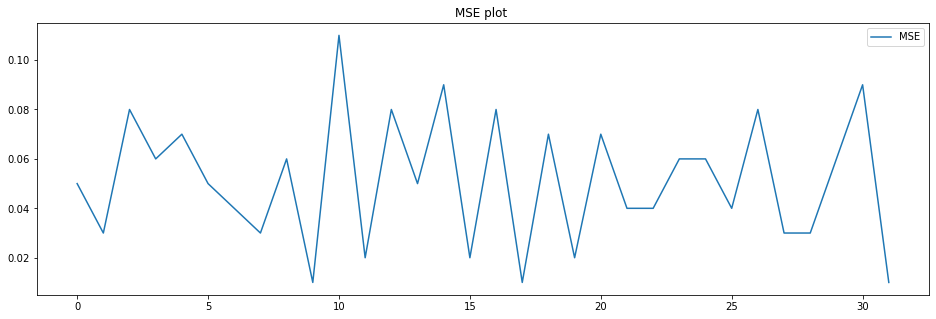


Shapiro_Wilk Test
Statistics=0.974, p=0.6242356896
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.697, p=0.428
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.285
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 145
mean=0.059 ,max=0.117,min=0.024,variance=0.00049


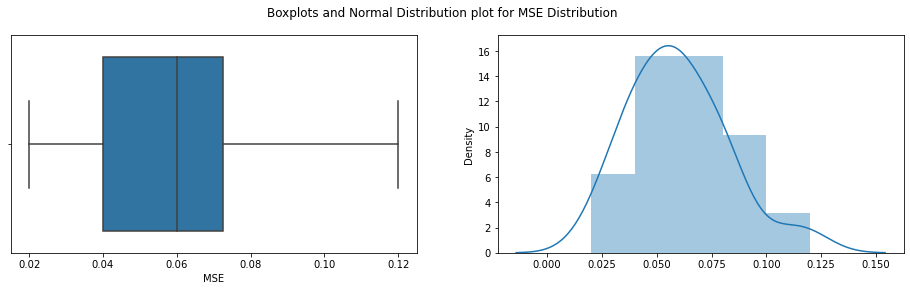

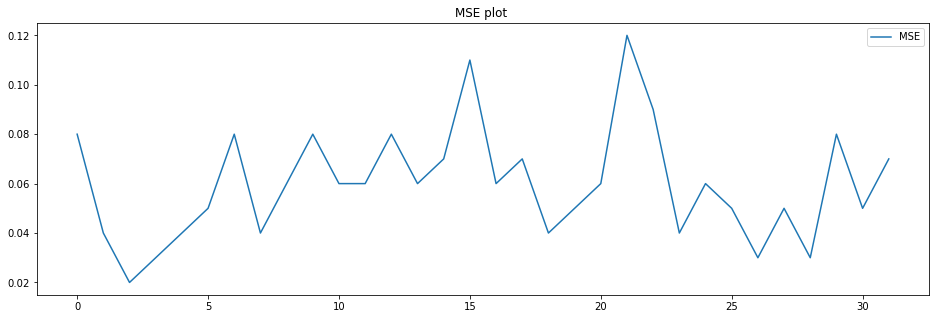


Shapiro_Wilk Test
Statistics=0.944, p=0.0988453478
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.917, p=0.086
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.456
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 146
mean=0.05 ,max=0.097,min=0.023,variance=0.00033


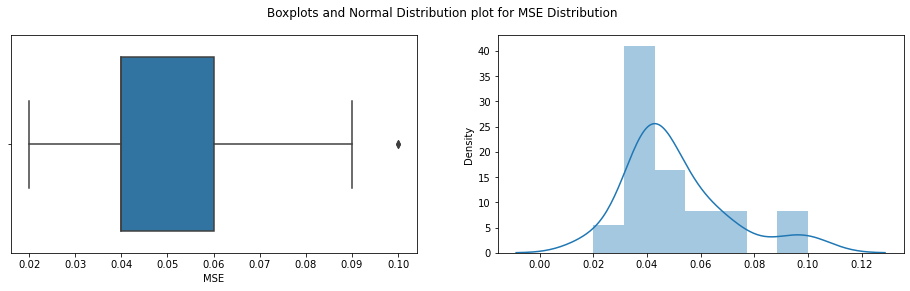

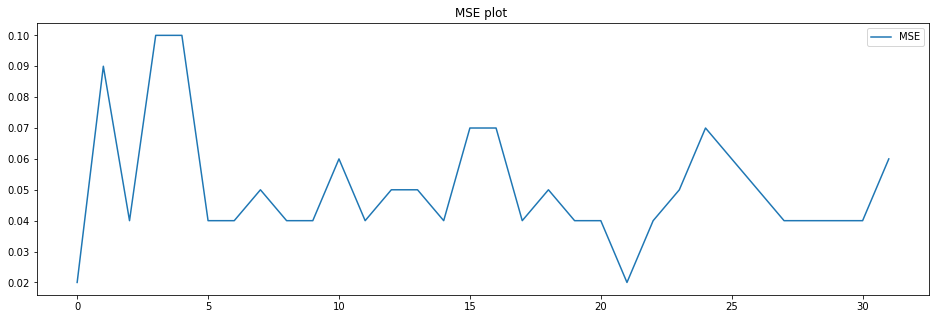


Shapiro_Wilk Test
Statistics=0.872, p=0.0012698099
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=9.875, p=0.007
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.511
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 147
mean=0.053 ,max=0.1,min=0.024,variance=0.00033


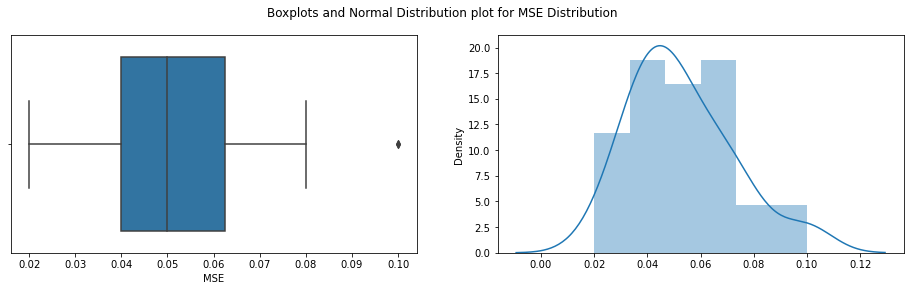

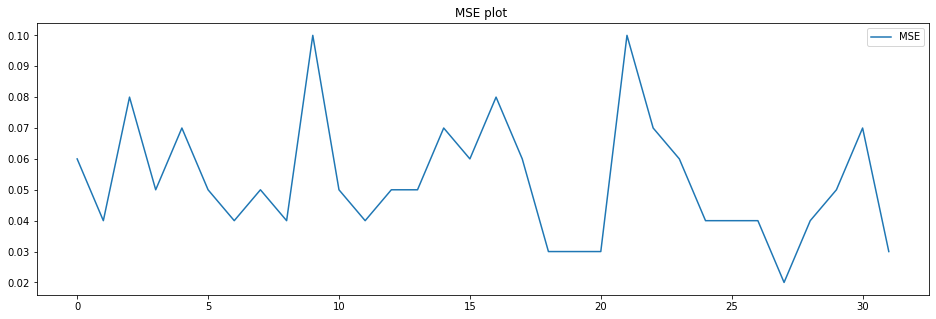


Shapiro_Wilk Test
Statistics=0.942, p=0.0860950574
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.169, p=0.075
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.585
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 148
mean=0.048 ,max=0.094,min=0.007,variance=0.00051


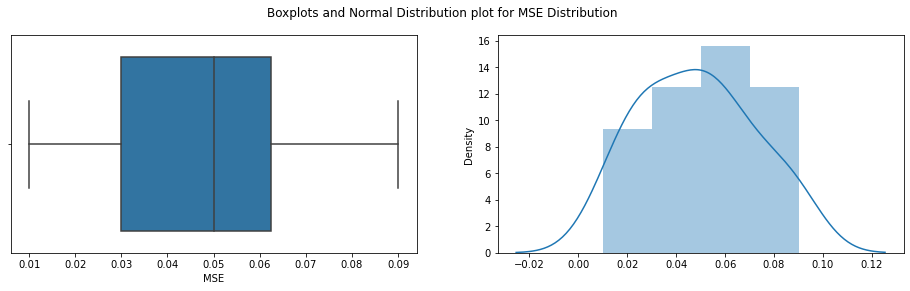

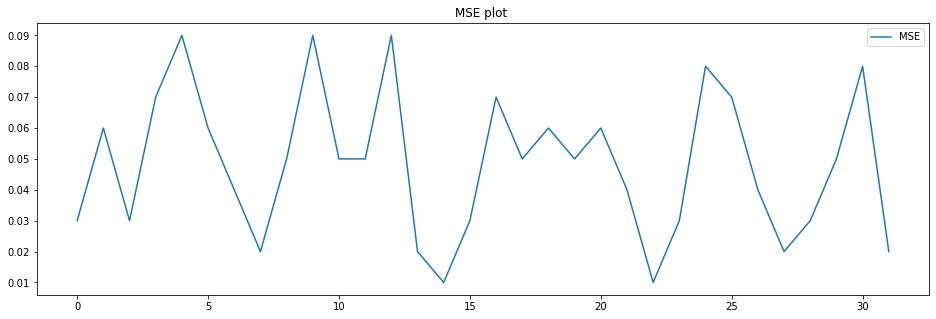


Shapiro_Wilk Test
Statistics=0.981, p=0.8282209635
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.867, p=0.648
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.162
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 149
mean=0.055 ,max=0.126,min=0.021,variance=0.00051


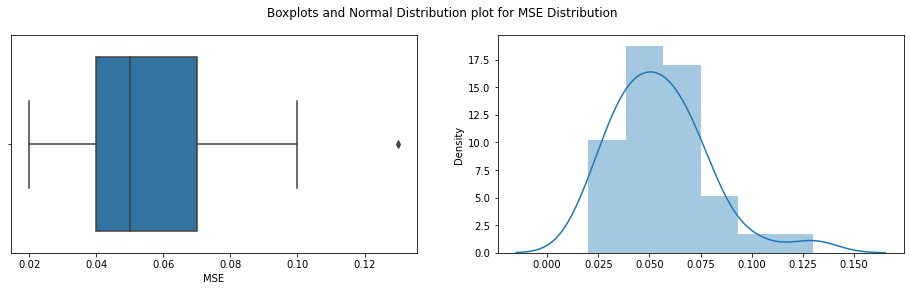

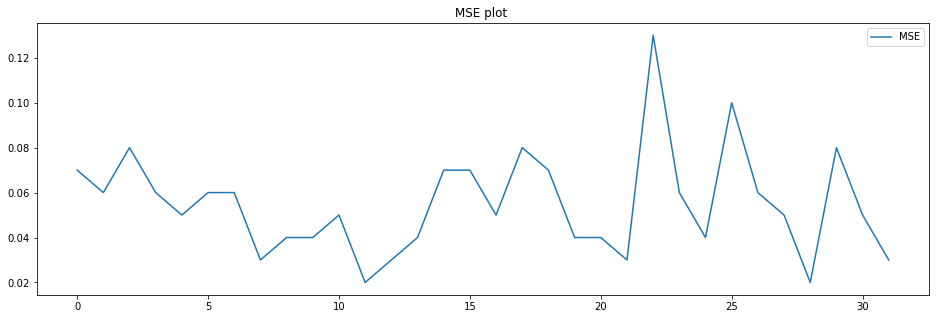


Shapiro_Wilk Test
Statistics=0.939, p=0.0716073960
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=8.602, p=0.014
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.386
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 150
mean=0.051 ,max=0.09,min=0.02,variance=0.00042


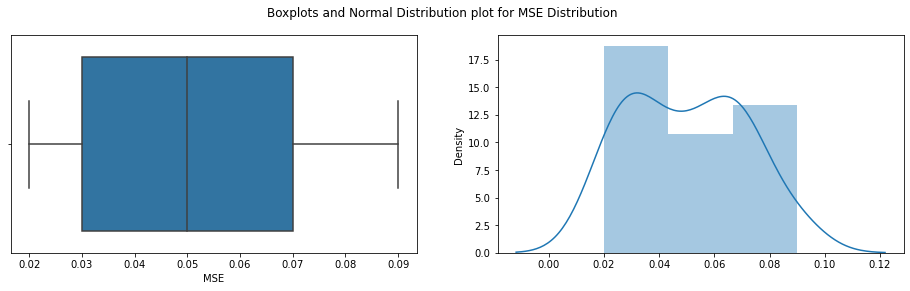

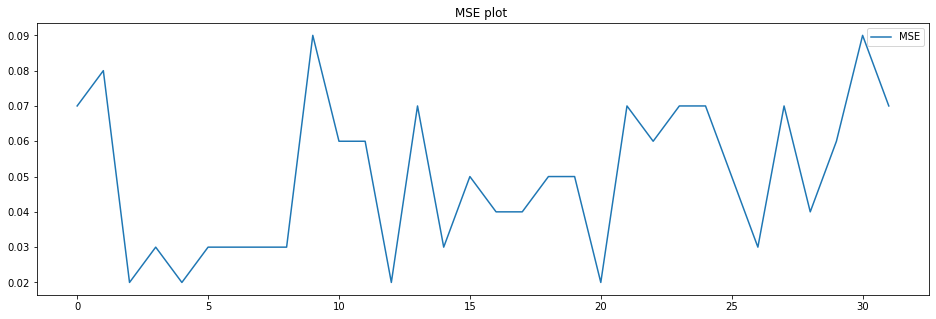


Shapiro_Wilk Test
Statistics=0.936, p=0.0581667237
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=6.906, p=0.032
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.685
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 151
mean=0.048 ,max=0.114,min=0.011,variance=0.00053


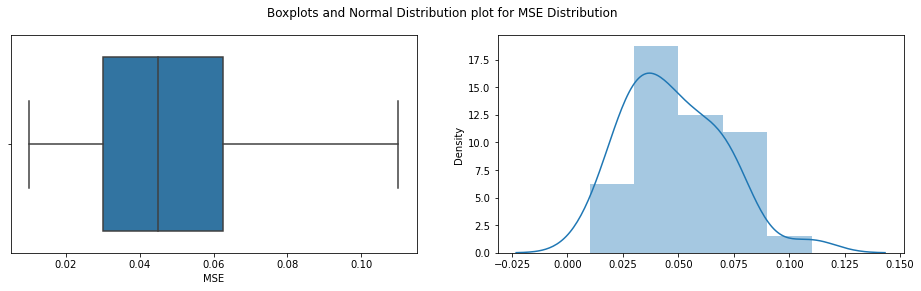

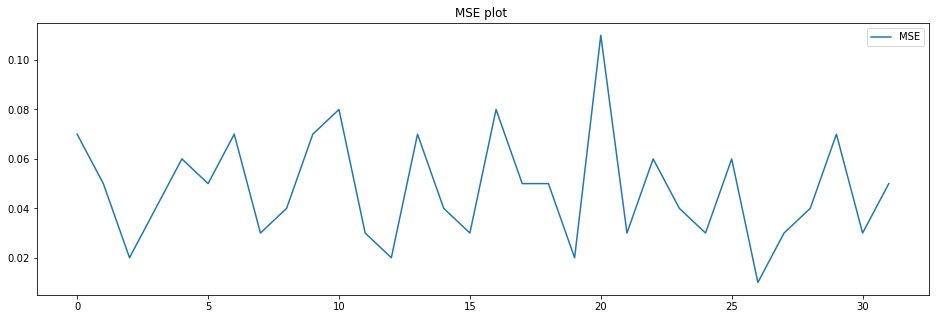


Shapiro_Wilk Test
Statistics=0.957, p=0.2207779586
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.215, p=0.200
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.435
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 152
mean=0.055 ,max=0.102,min=0.017,variance=0.00052


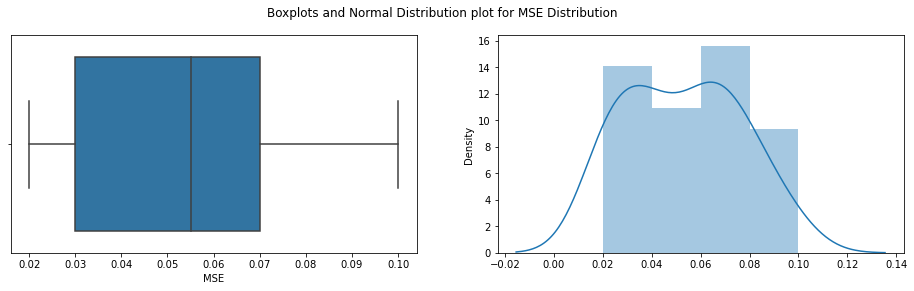

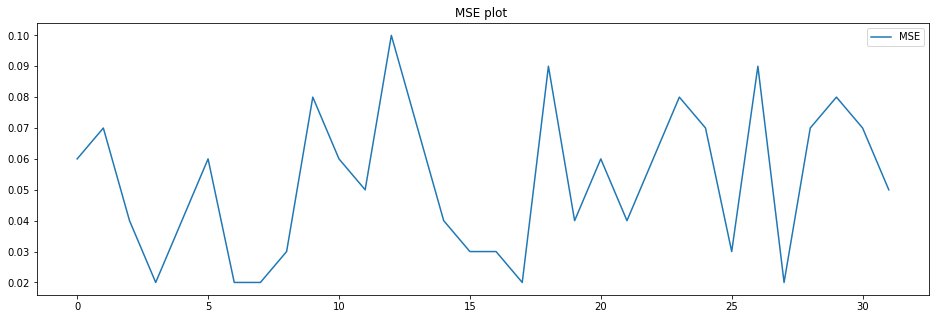


Shapiro_Wilk Test
Statistics=0.956, p=0.2161833644
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.322, p=0.115
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.523
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 153
mean=0.057 ,max=0.108,min=0.022,variance=0.00041


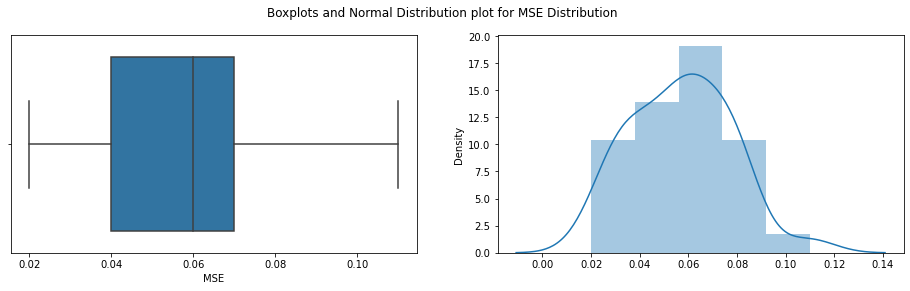

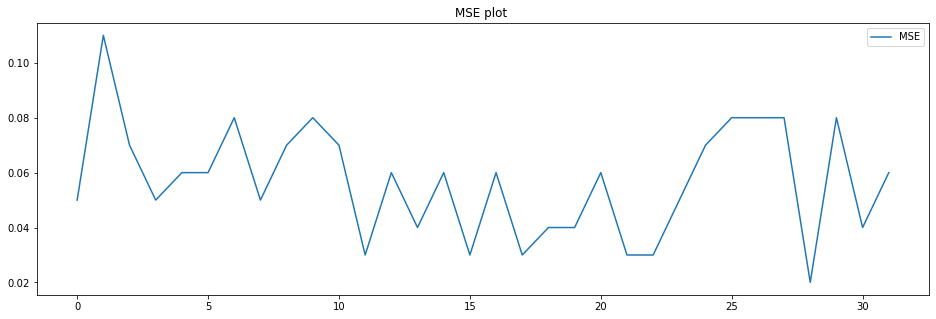


Shapiro_Wilk Test
Statistics=0.969, p=0.4667133391
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.387, p=0.824
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.317
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 154
mean=0.053 ,max=0.124,min=0.007,variance=0.00057


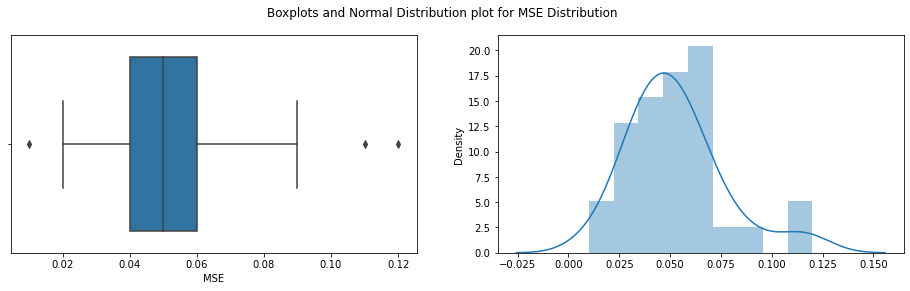

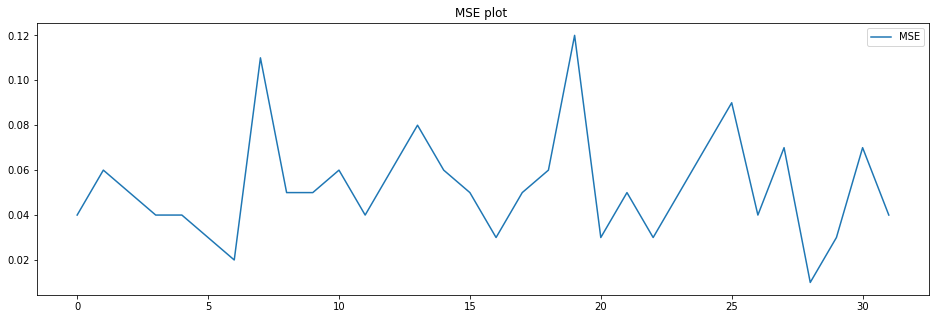


Shapiro_Wilk Test
Statistics=0.939, p=0.0706402585
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=8.884, p=0.012
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.607
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 155
mean=0.047 ,max=0.087,min=0.019,variance=0.00035


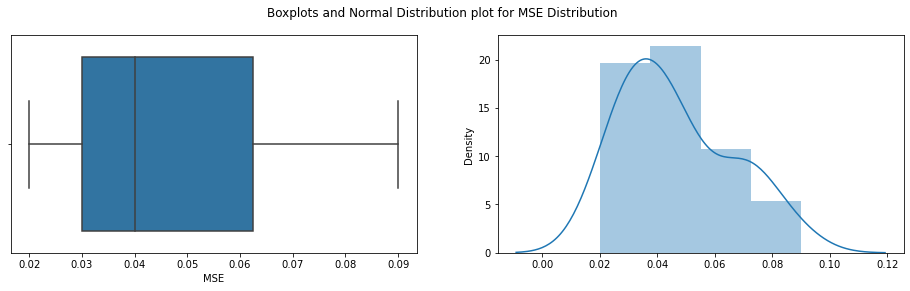

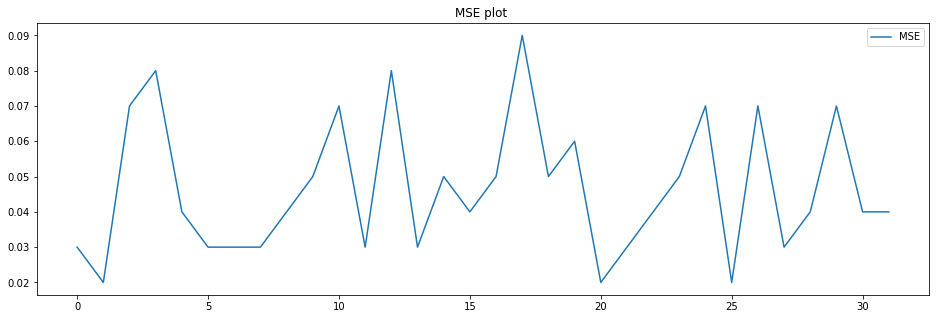


Shapiro_Wilk Test
Statistics=0.926, p=0.0303570144
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=3.864, p=0.145
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.885
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 156
mean=0.05 ,max=0.121,min=0.011,variance=0.00046


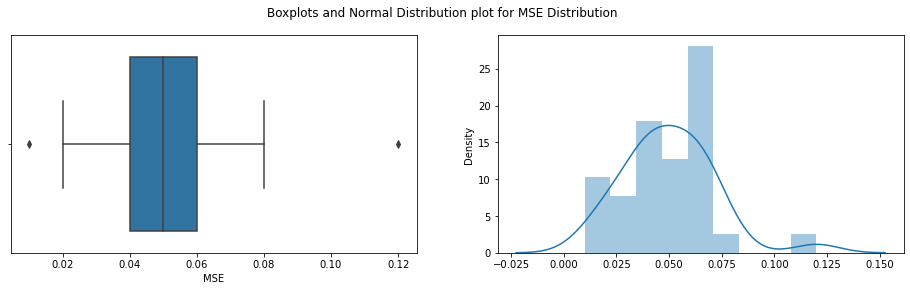

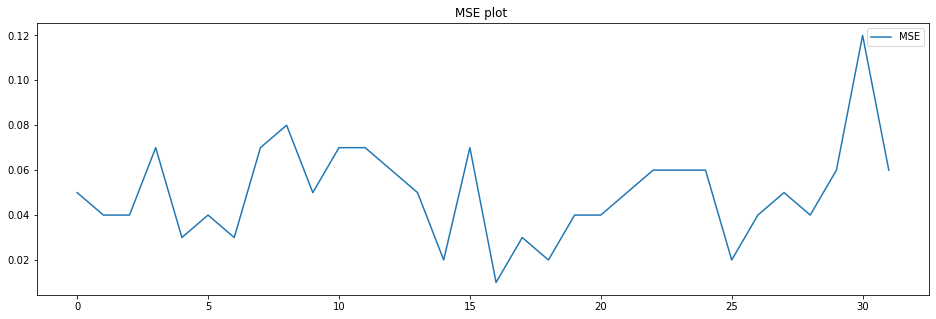


Shapiro_Wilk Test
Statistics=0.944, p=0.0962786973
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=7.844, p=0.020
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.359
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 157
mean=0.051 ,max=0.094,min=0.025,variance=0.00029


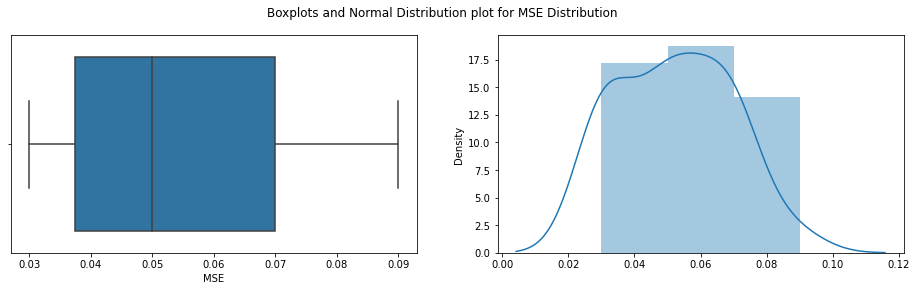

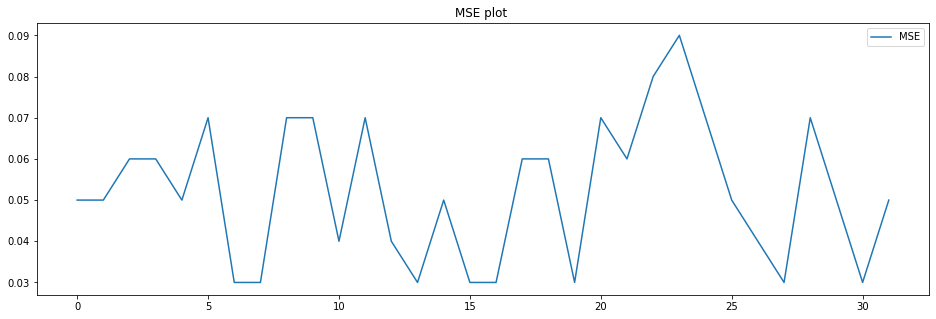


Shapiro_Wilk Test
Statistics=0.963, p=0.3251437545
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.118, p=0.572
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.330
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 158
mean=0.057 ,max=0.138,min=0.023,variance=0.00048


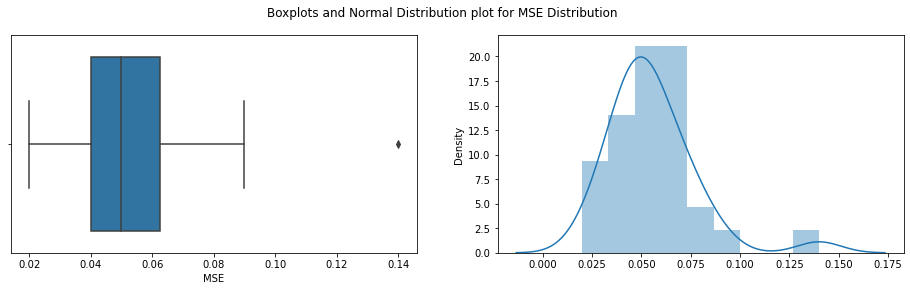

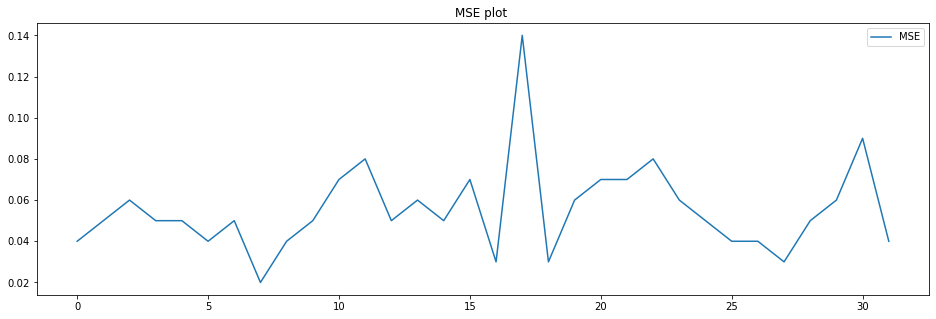


Shapiro_Wilk Test
Statistics=0.887, p=0.0029486900
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=20.231, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.833
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 159
mean=0.05 ,max=0.092,min=0.012,variance=0.00034


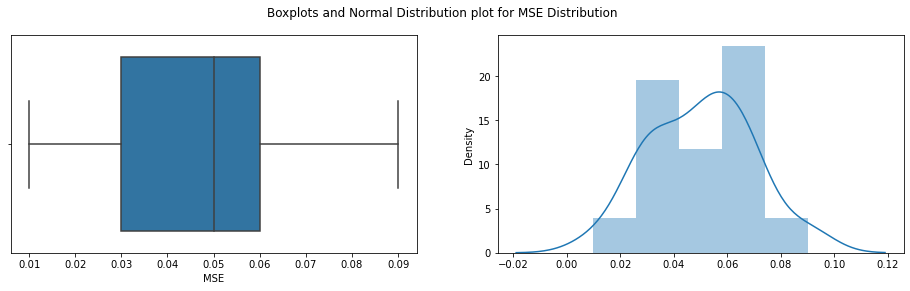

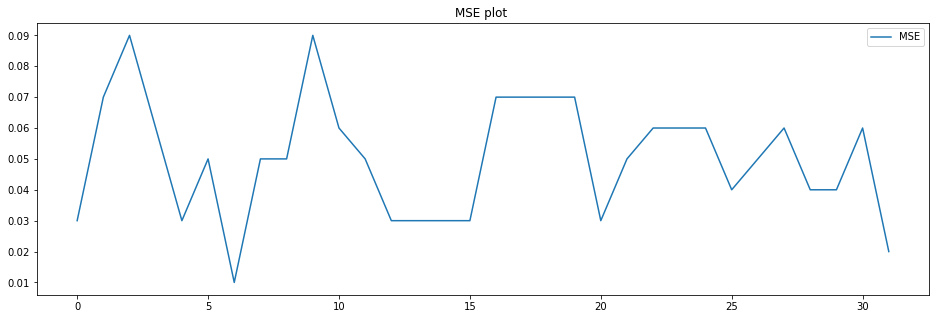


Shapiro_Wilk Test
Statistics=0.970, p=0.4971838892
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.060, p=0.970
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.438
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 160
mean=0.056 ,max=0.116,min=0.023,variance=0.00047


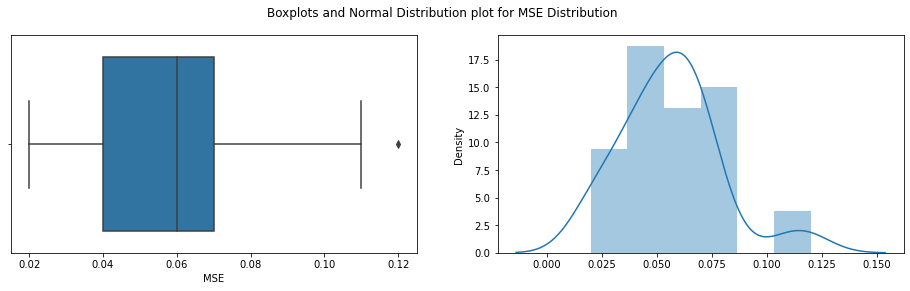

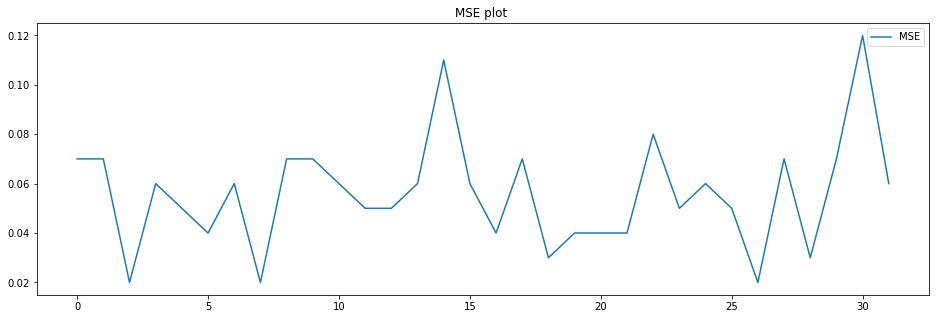


Shapiro_Wilk Test
Statistics=0.919, p=0.0190973617
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=7.756, p=0.021
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.642
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 161
mean=0.056 ,max=0.089,min=0.028,variance=0.00027


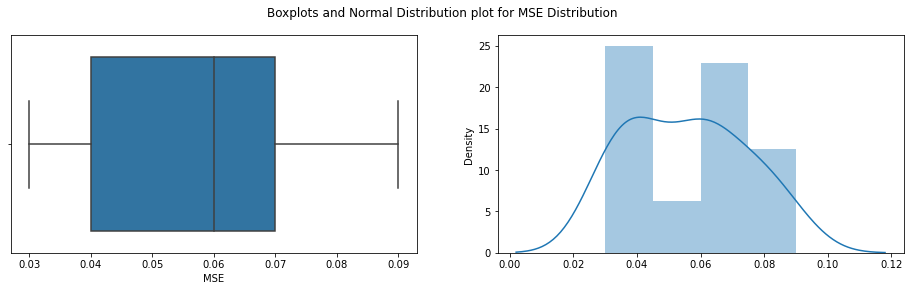

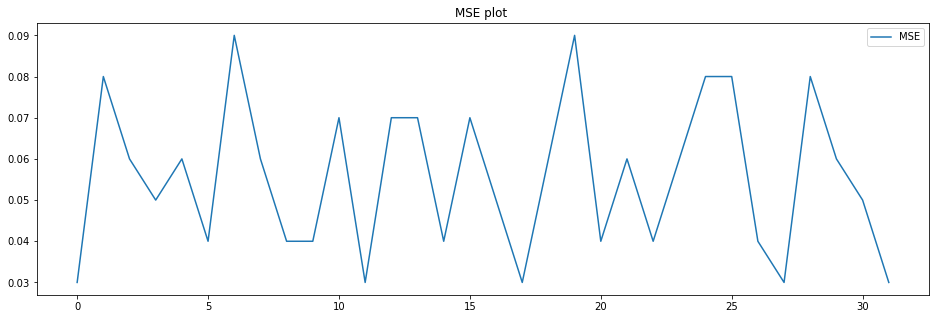


Shapiro_Wilk Test
Statistics=0.959, p=0.2541159391
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.097, p=0.350
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.411
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 162
mean=0.047 ,max=0.096,min=0.016,variance=0.00032


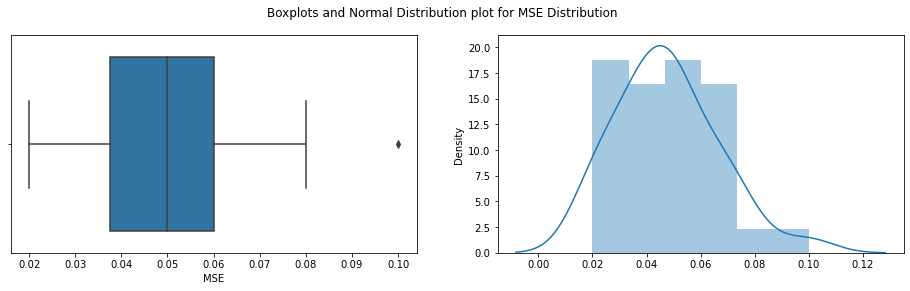

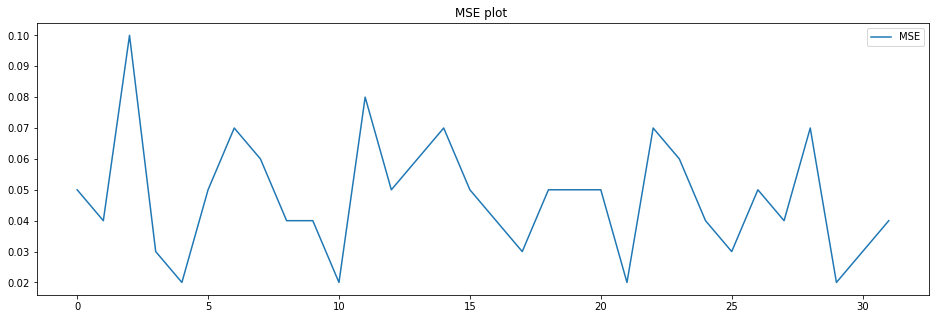


Shapiro_Wilk Test
Statistics=0.973, p=0.5805239081
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.267, p=0.322
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.280
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 163
mean=0.049 ,max=0.098,min=0.014,variance=0.00046


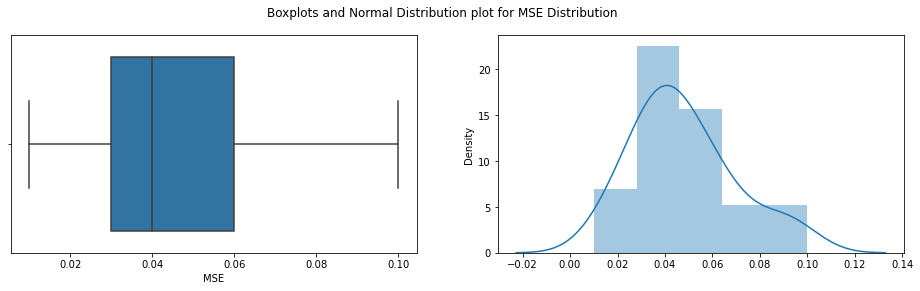

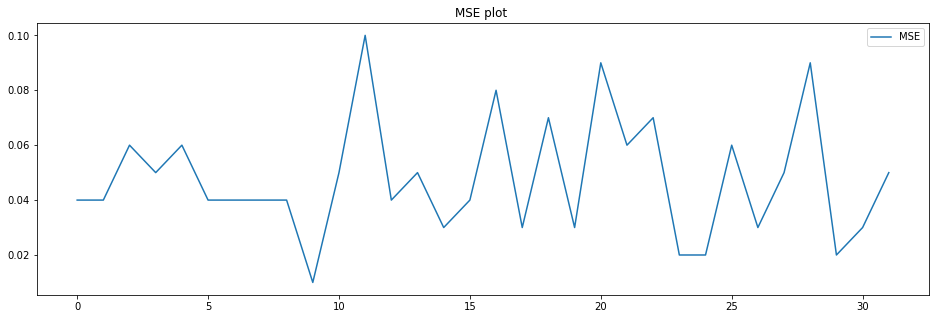


Shapiro_Wilk Test
Statistics=0.955, p=0.2041957080
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.305, p=0.316
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.444
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 164
mean=0.055 ,max=0.105,min=0.022,variance=0.00048


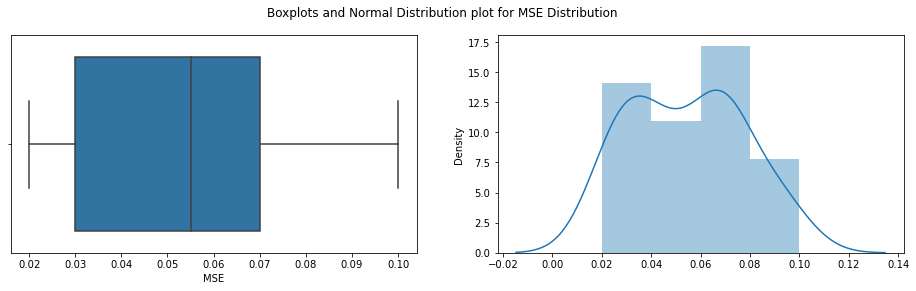

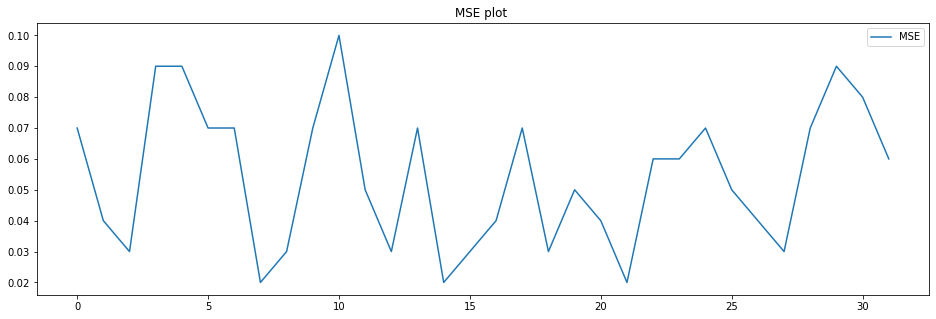


Shapiro_Wilk Test
Statistics=0.962, p=0.3041819334
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.433, p=0.488
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.354
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 165
mean=0.049 ,max=0.086,min=0.018,variance=0.0004


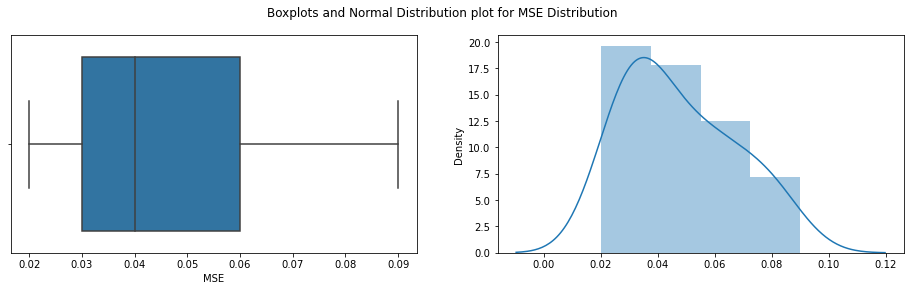

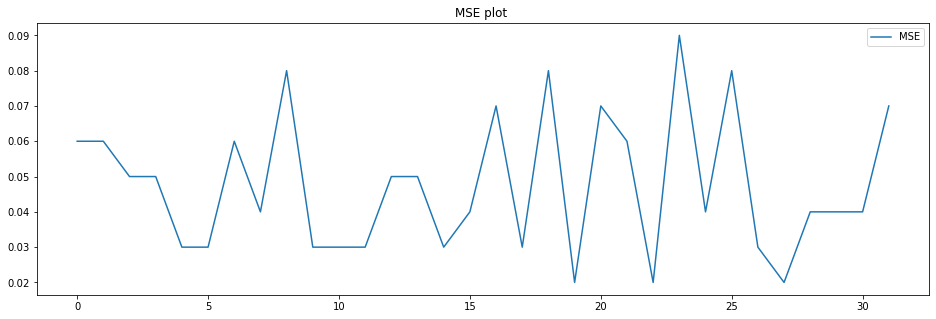


Shapiro_Wilk Test
Statistics=0.938, p=0.0669922903
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.835, p=0.147
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.611
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 166
mean=0.057 ,max=0.119,min=0.015,variance=0.00071


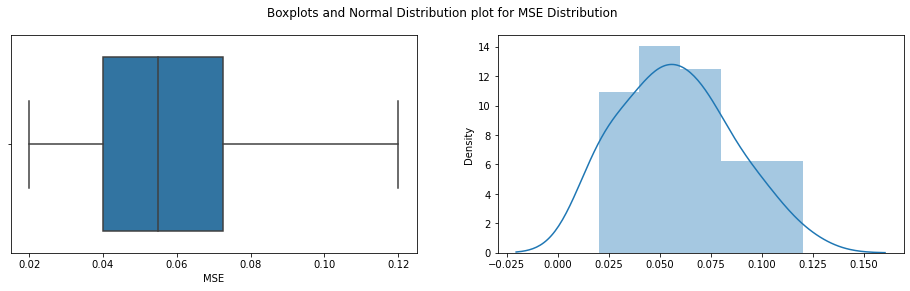

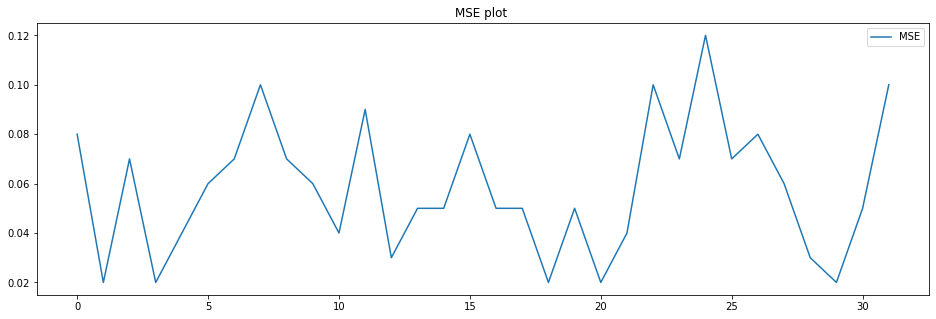


Shapiro_Wilk Test
Statistics=0.967, p=0.4249216616
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.950, p=0.622
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.299
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 167
mean=0.052 ,max=0.113,min=0.011,variance=0.00064


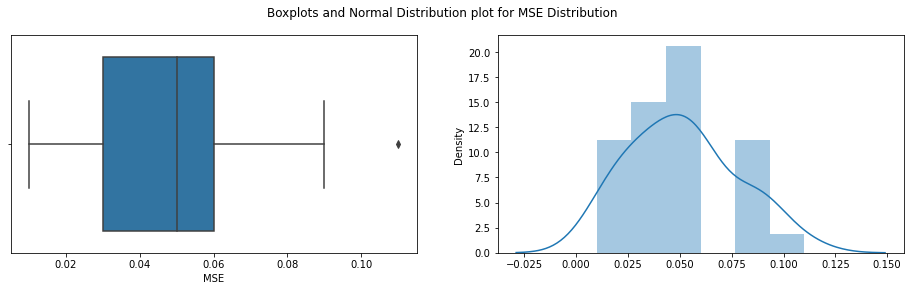

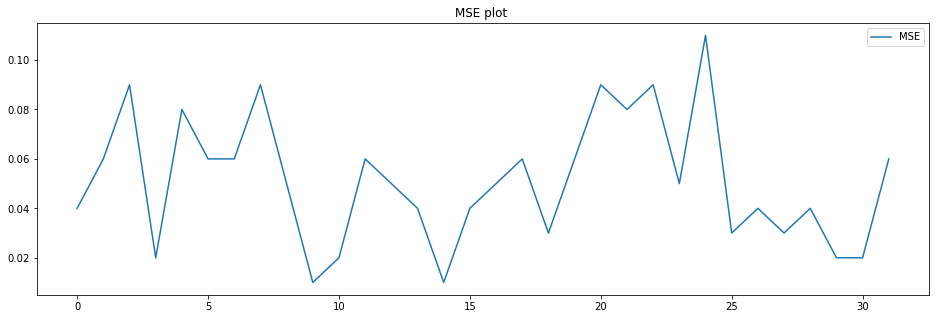


Shapiro_Wilk Test
Statistics=0.963, p=0.3345605731
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.120, p=0.571
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.369
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 168
mean=0.056 ,max=0.106,min=0.012,variance=0.00056


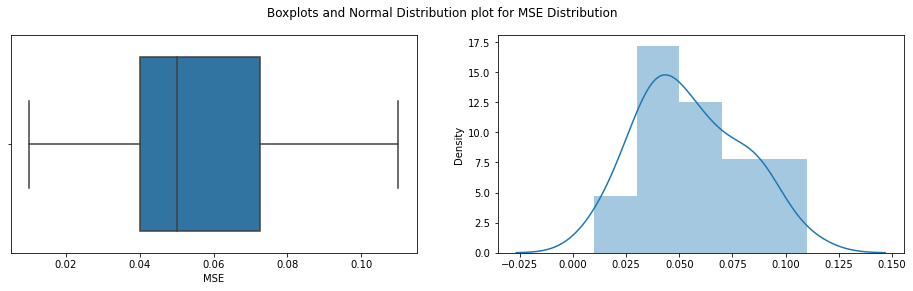

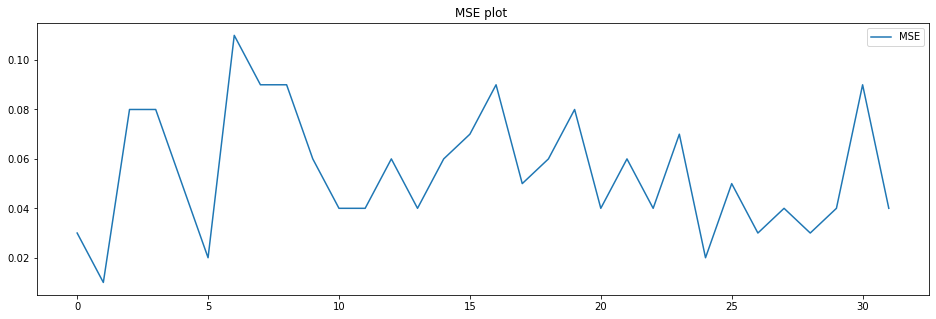


Shapiro_Wilk Test
Statistics=0.971, p=0.5181750655
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.482, p=0.477
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.358
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 169
mean=0.055 ,max=0.11,min=0.015,variance=0.0005


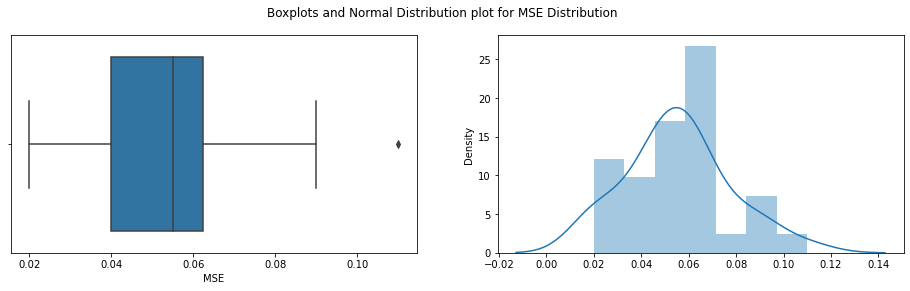

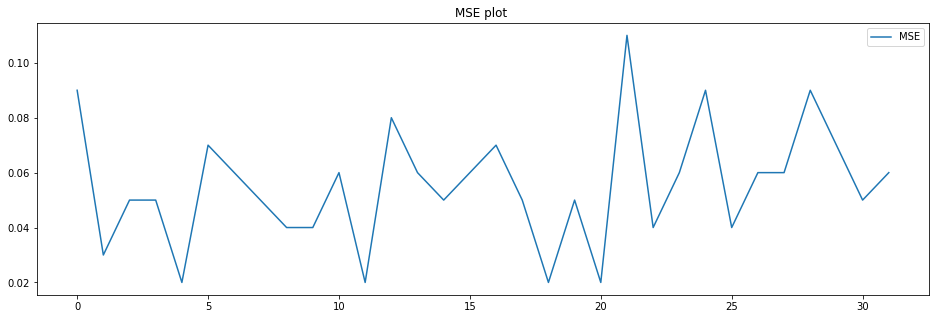


Shapiro_Wilk Test
Statistics=0.966, p=0.4060591757
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.308, p=0.520
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.391
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 170
mean=0.044 ,max=0.086,min=0.017,variance=0.00026


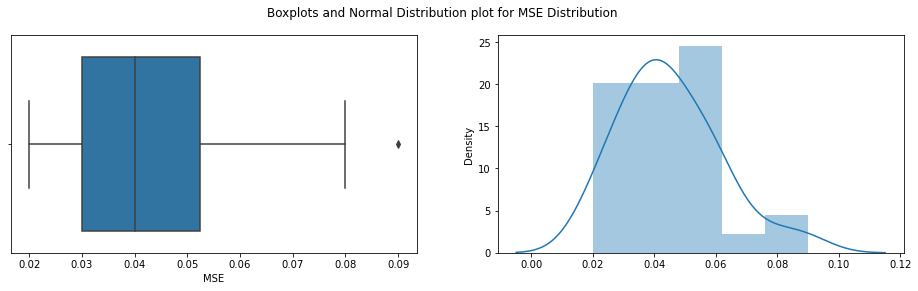

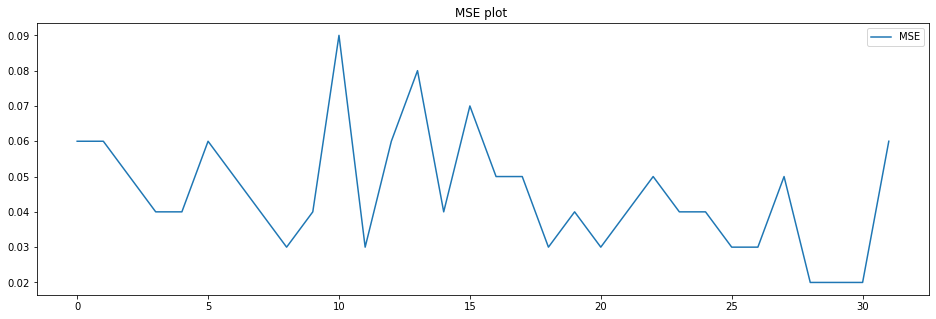


Shapiro_Wilk Test
Statistics=0.955, p=0.1935940981
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.408, p=0.182
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.453
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 171
mean=0.054 ,max=0.096,min=0.012,variance=0.00044


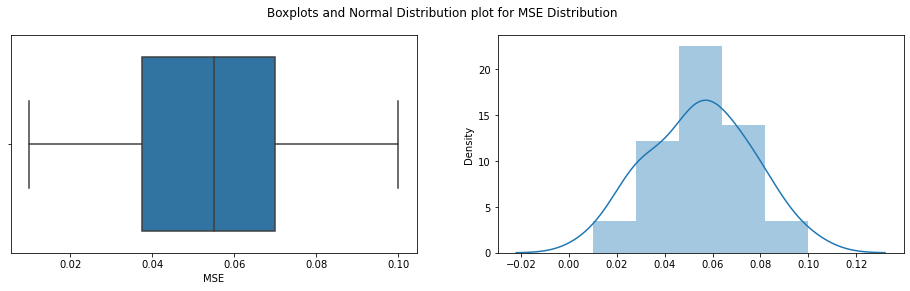

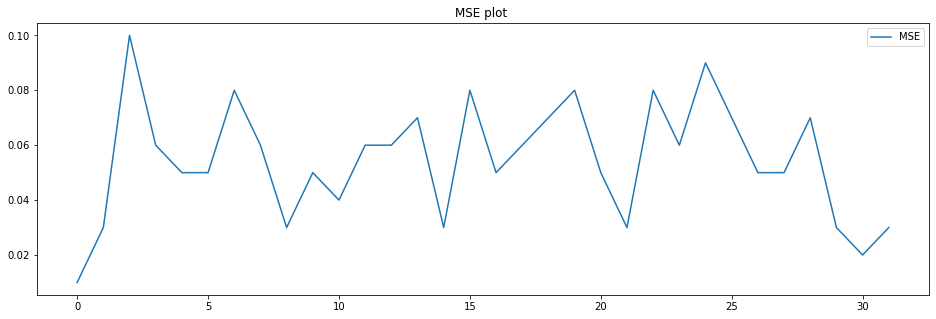


Shapiro_Wilk Test
Statistics=0.982, p=0.8497148156
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.083, p=0.582
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.223
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 172
mean=0.048 ,max=0.094,min=0.011,variance=0.00048


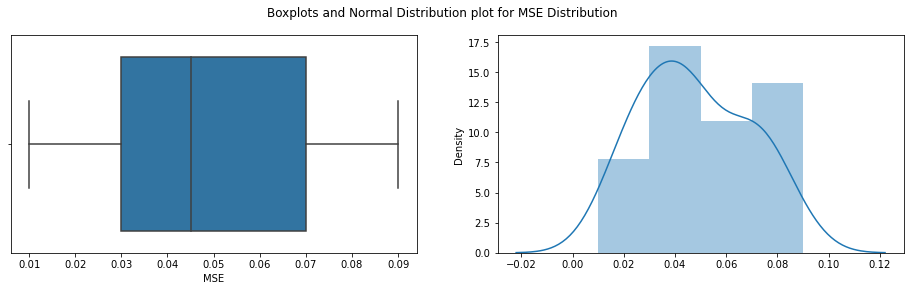

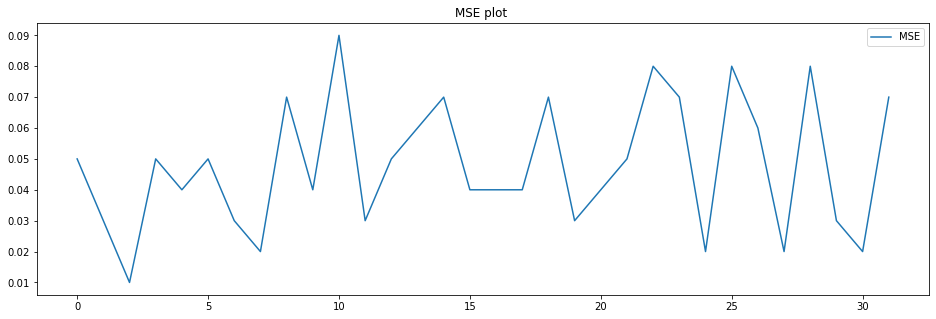


Shapiro_Wilk Test
Statistics=0.963, p=0.3356655240
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.836, p=0.242
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.414
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 173
mean=0.052 ,max=0.089,min=0.017,variance=0.00041


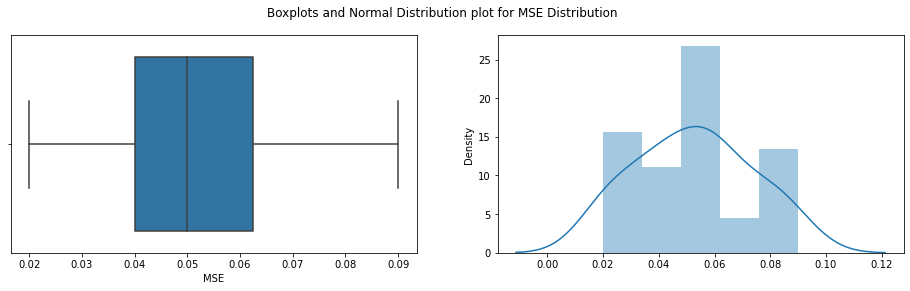

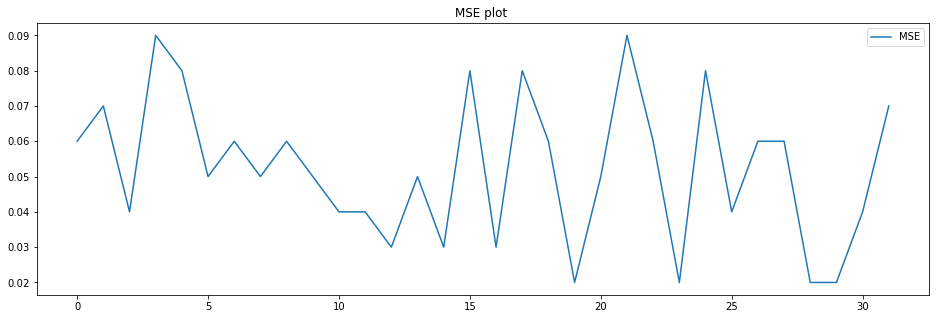


Shapiro_Wilk Test
Statistics=0.970, p=0.4925635755
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.716, p=0.424
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.208
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 174
mean=0.044 ,max=0.079,min=0.007,variance=0.00035


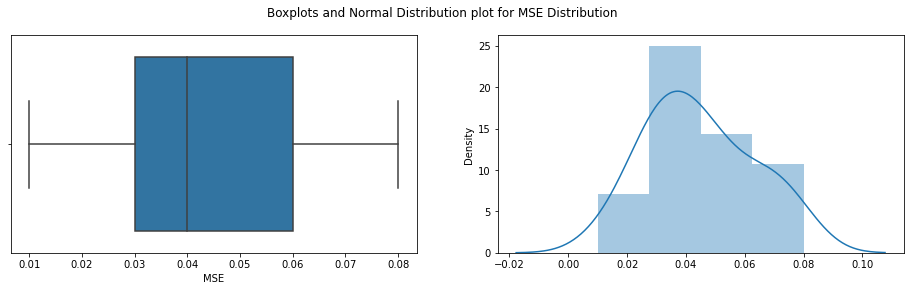

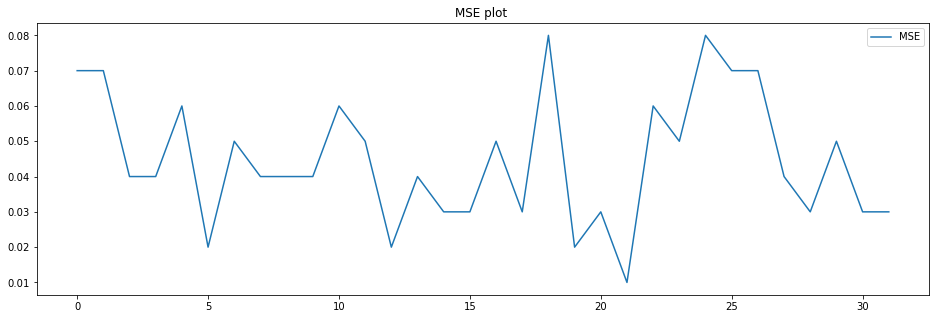


Shapiro_Wilk Test
Statistics=0.964, p=0.3483408093
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.196, p=0.550
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.460
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 175
mean=0.045 ,max=0.083,min=0.014,variance=0.00032


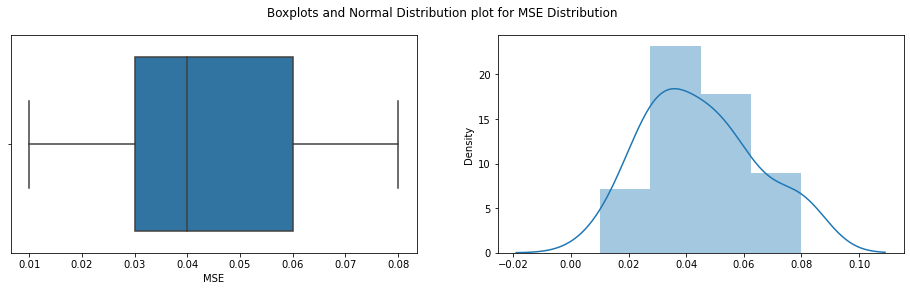

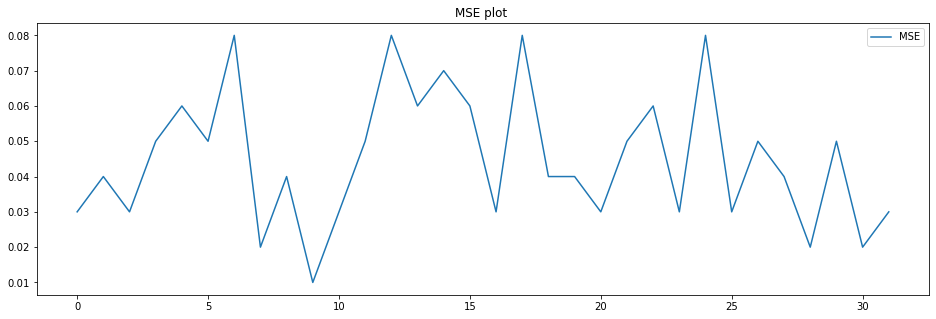


Shapiro_Wilk Test
Statistics=0.959, p=0.2588675320
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.797, p=0.407
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.420
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 176
mean=0.054 ,max=0.129,min=0.021,variance=0.00058


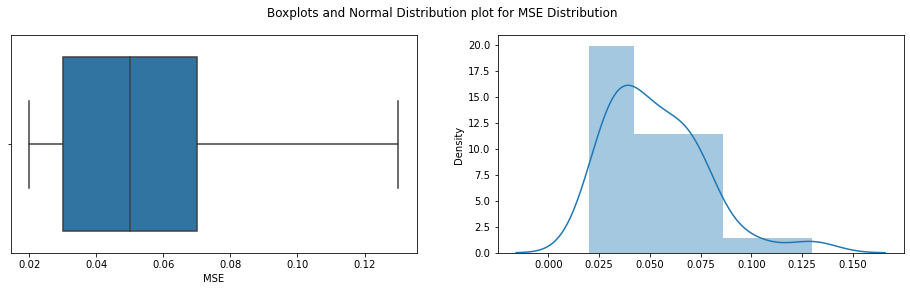

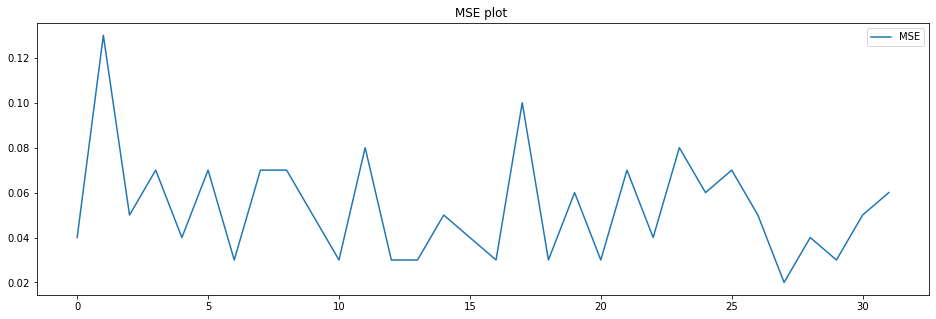


Shapiro_Wilk Test
Statistics=0.916, p=0.0161620583
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=8.385, p=0.015
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.673
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 177
mean=0.05 ,max=0.08,min=0.026,variance=0.0002


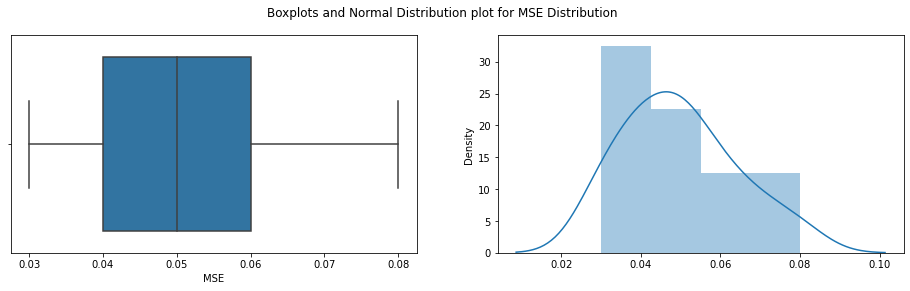

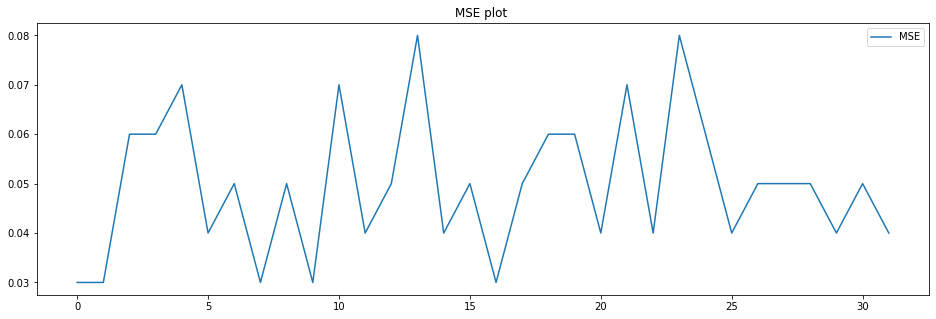


Shapiro_Wilk Test
Statistics=0.976, p=0.6706515551
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.931, p=0.628
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.204
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 178
mean=0.054 ,max=0.113,min=0.017,variance=0.00059


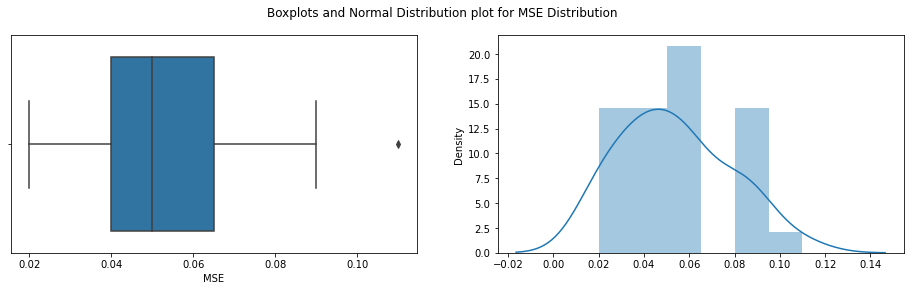

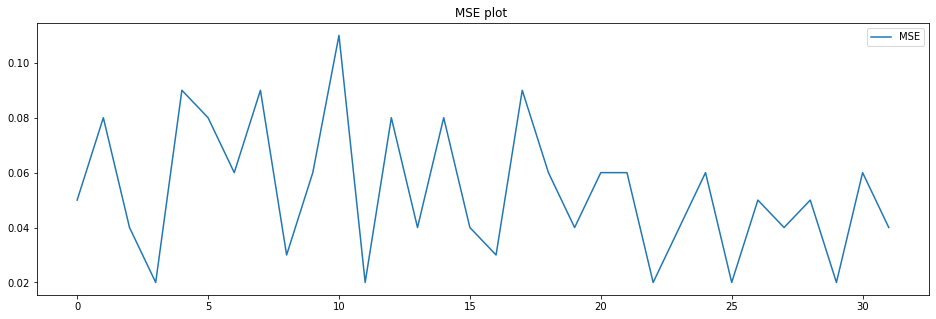


Shapiro_Wilk Test
Statistics=0.958, p=0.2443953753
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.489, p=0.475
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.417
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 179
mean=0.056 ,max=0.12,min=0.024,variance=0.00054


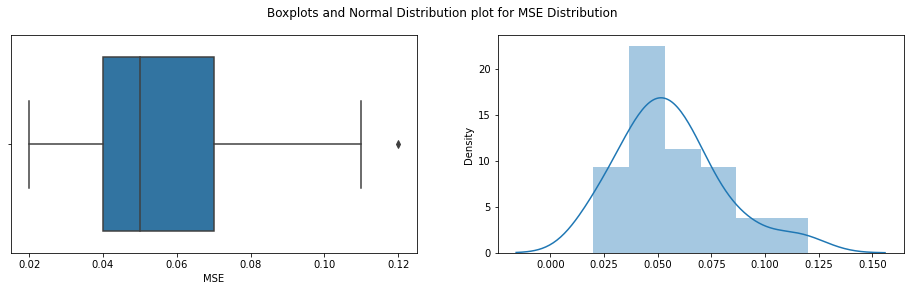

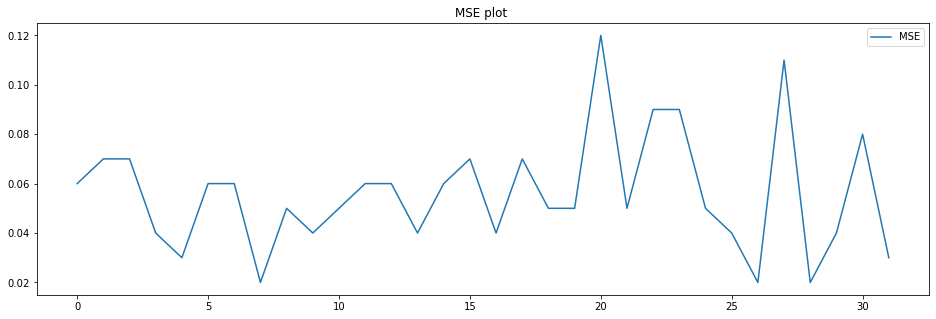


Shapiro_Wilk Test
Statistics=0.932, p=0.0455126278
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=5.623, p=0.060
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.615
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 180
mean=0.054 ,max=0.11,min=0.009,variance=0.00048


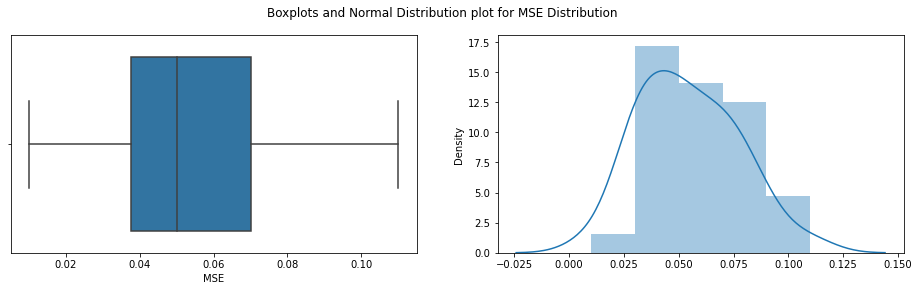

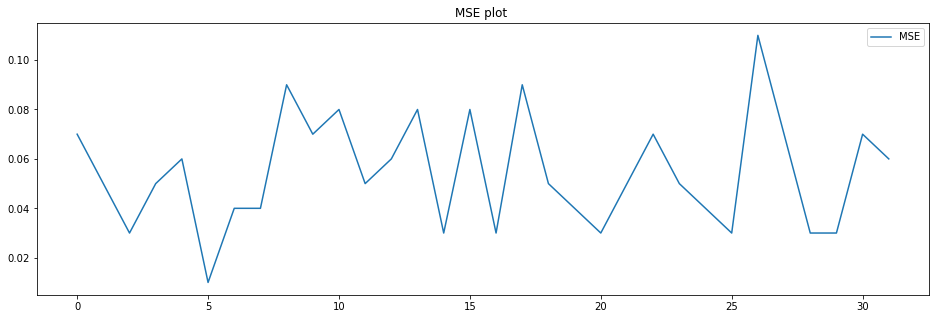


Shapiro_Wilk Test
Statistics=0.969, p=0.4606457055
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.404, p=0.496
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.472
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 181
mean=0.049 ,max=0.095,min=0.017,variance=0.00046


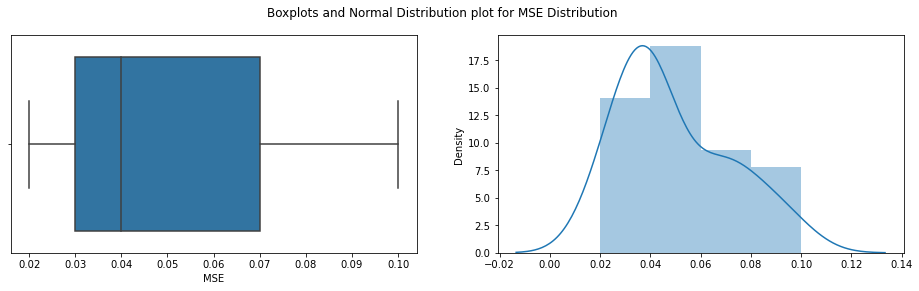

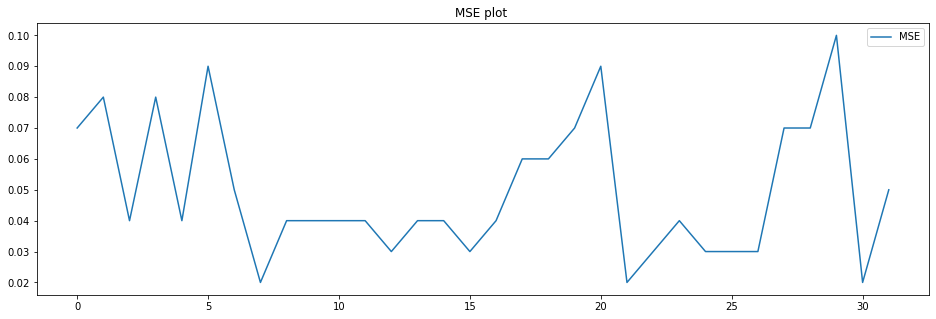


Shapiro_Wilk Test
Statistics=0.928, p=0.0350616798
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=3.199, p=0.202
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.862
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 182
mean=0.057 ,max=0.118,min=0.015,variance=0.00056


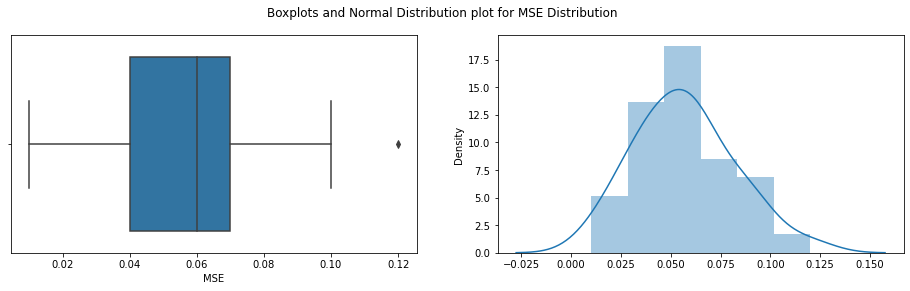

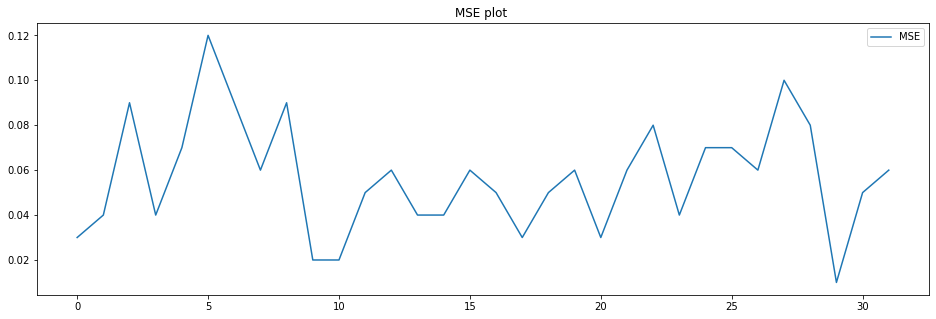


Shapiro_Wilk Test
Statistics=0.980, p=0.8009620905
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.151, p=0.562
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.200
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 183
mean=0.049 ,max=0.1,min=0.014,variance=0.00046


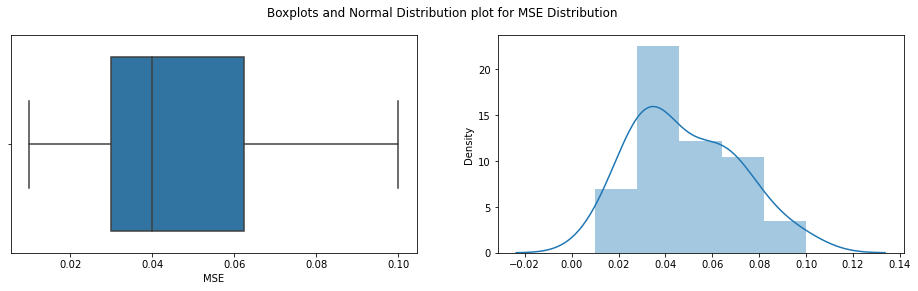

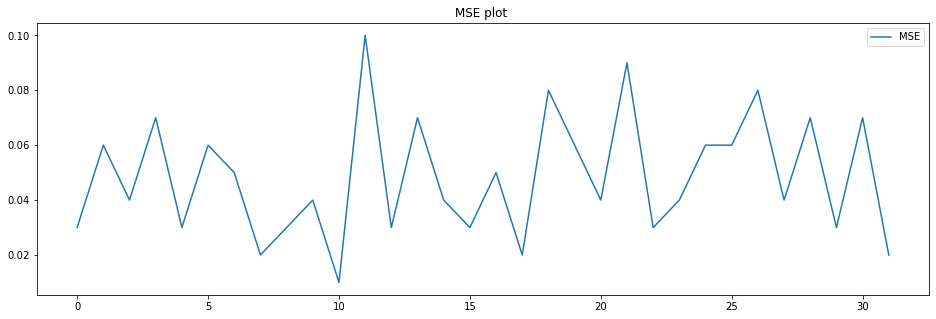


Shapiro_Wilk Test
Statistics=0.963, p=0.3379338086
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.830, p=0.401
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.398
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 184
mean=0.057 ,max=0.108,min=0.015,variance=0.00042


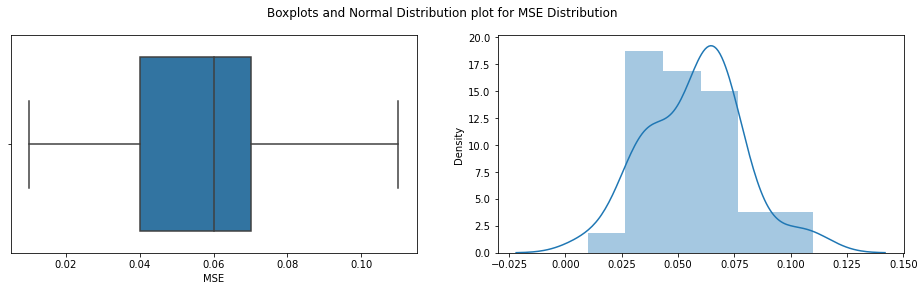

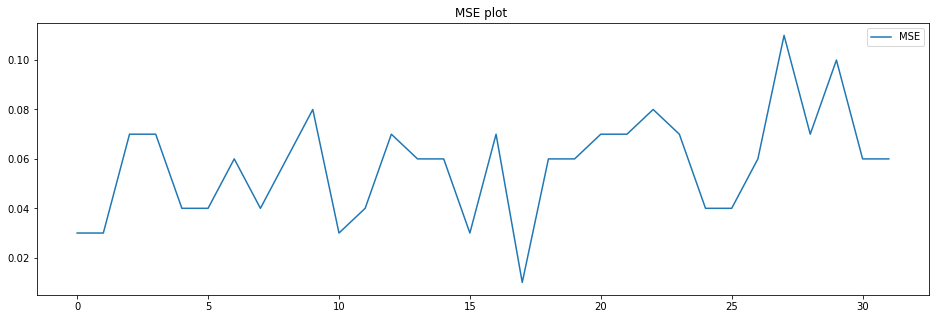


Shapiro_Wilk Test
Statistics=0.960, p=0.2742048800
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.882, p=0.643
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.561
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 185
mean=0.057 ,max=0.109,min=0.016,variance=0.00061


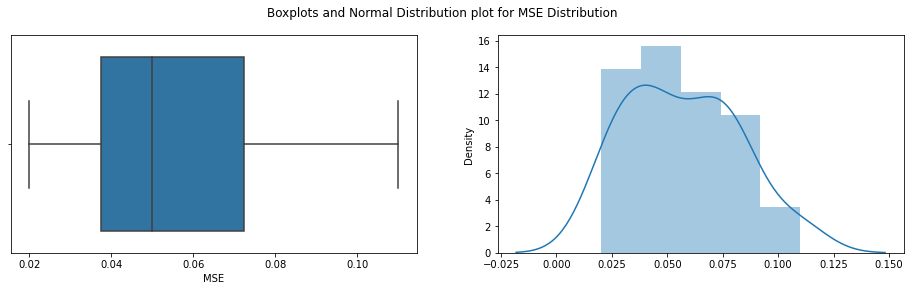

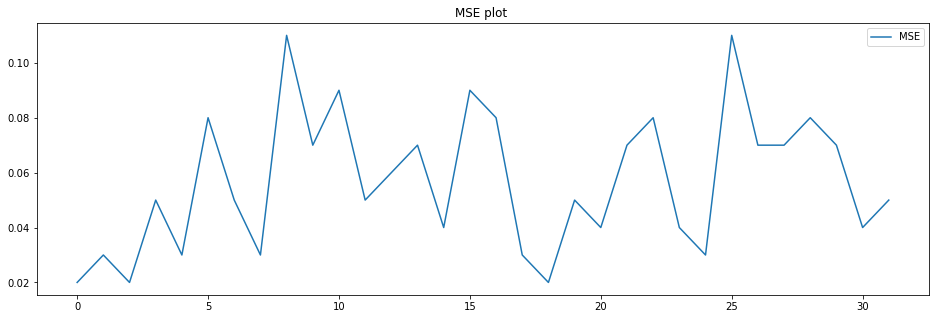


Shapiro_Wilk Test
Statistics=0.964, p=0.3592282832
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.610, p=0.447
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.353
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 186
mean=0.056 ,max=0.101,min=0.018,variance=0.0004


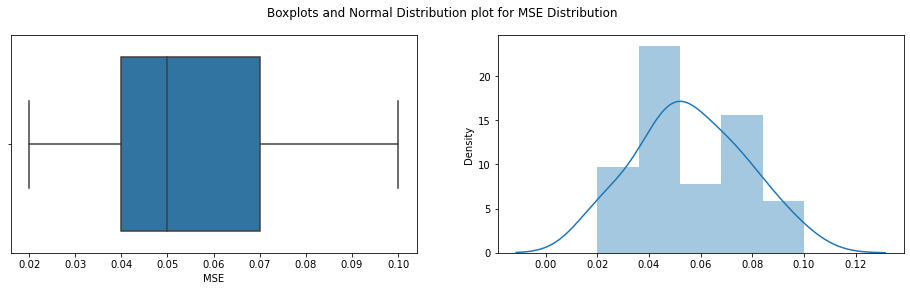

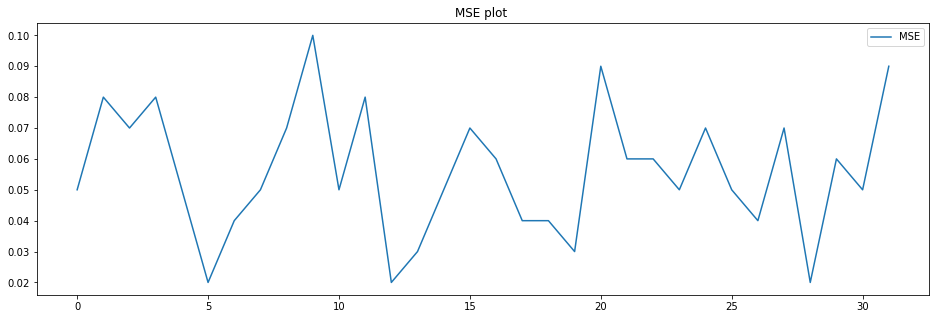


Shapiro_Wilk Test
Statistics=0.985, p=0.9197707176
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.365, p=0.833
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.166
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 187
mean=0.058 ,max=0.123,min=0.016,variance=0.00057


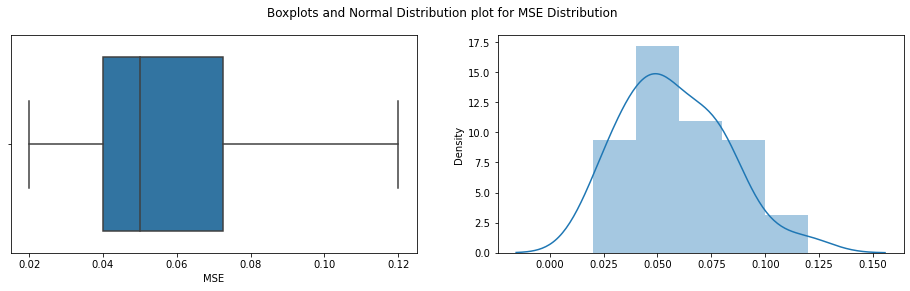

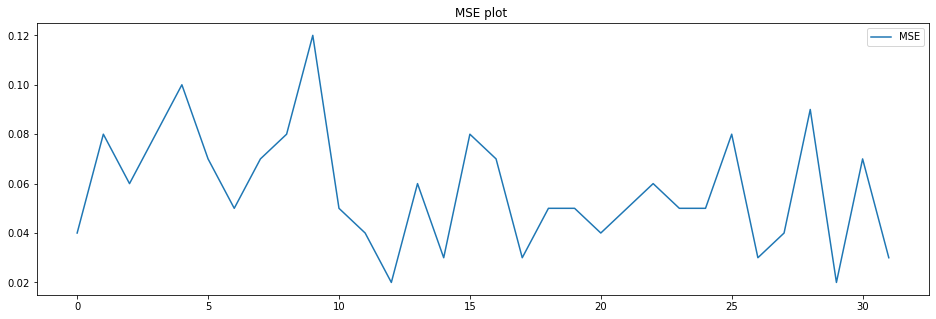


Shapiro_Wilk Test
Statistics=0.974, p=0.6261675954
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.228, p=0.328
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.234
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 188
mean=0.05 ,max=0.136,min=0.007,variance=0.0006


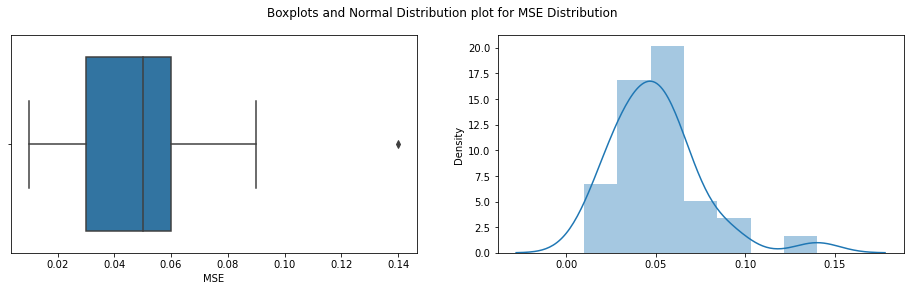

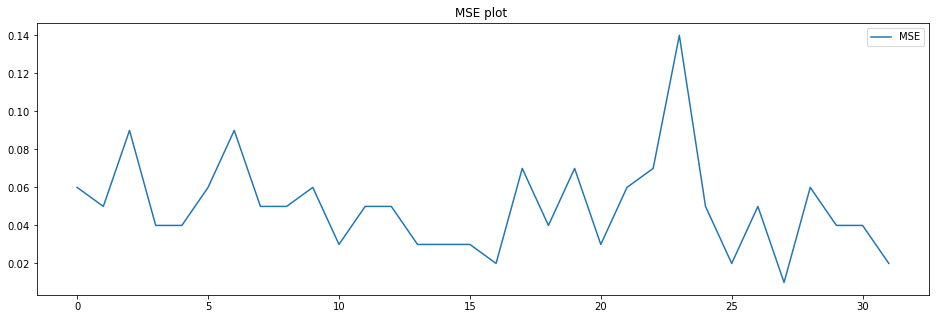


Shapiro_Wilk Test
Statistics=0.917, p=0.0167451315
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=15.542, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.664
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 189
mean=0.06 ,max=0.12,min=0.023,variance=0.00055


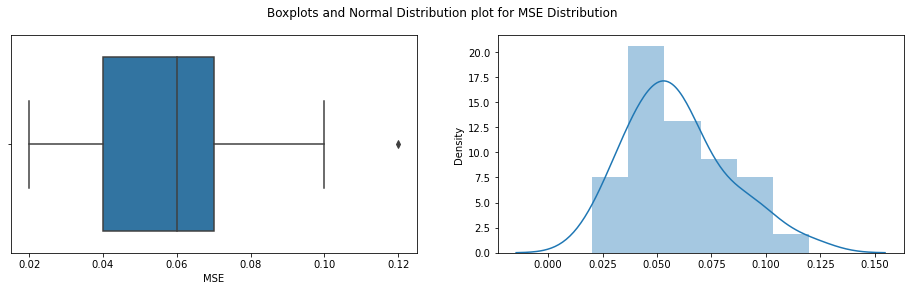

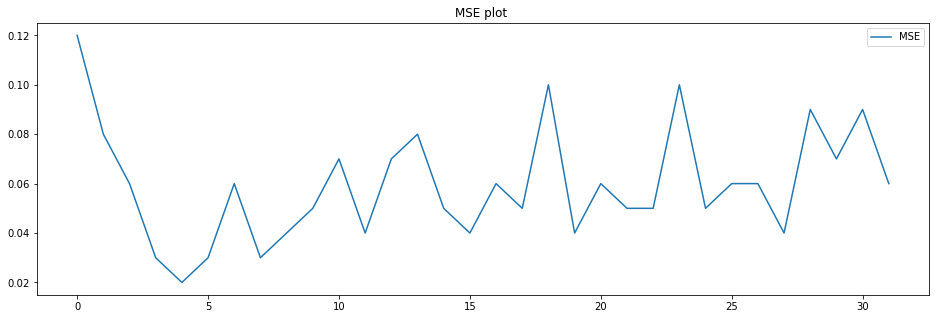


Shapiro_Wilk Test
Statistics=0.954, p=0.1906933635
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.236, p=0.198
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.497
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 190
mean=0.055 ,max=0.13,min=0.011,variance=0.00076


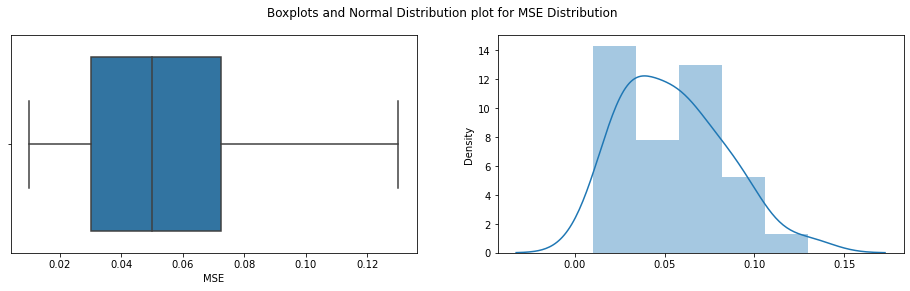

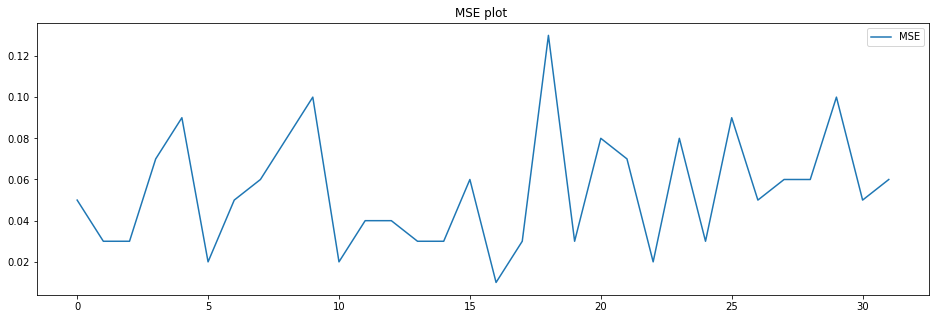


Shapiro_Wilk Test
Statistics=0.956, p=0.2065926343
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.749, p=0.253
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.476
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 191
mean=0.052 ,max=0.099,min=0.022,variance=0.0004


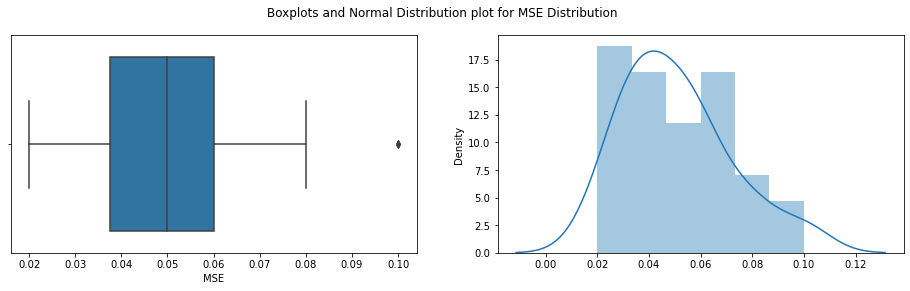

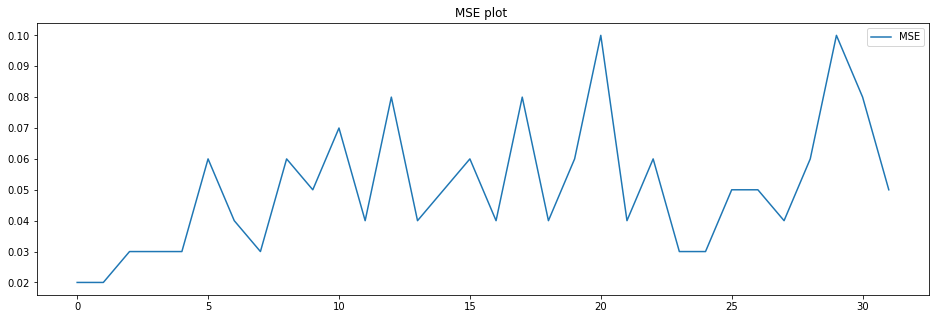


Shapiro_Wilk Test
Statistics=0.944, p=0.0950632468
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.147, p=0.207
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.504
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 192
mean=0.054 ,max=0.122,min=0.016,variance=0.00063


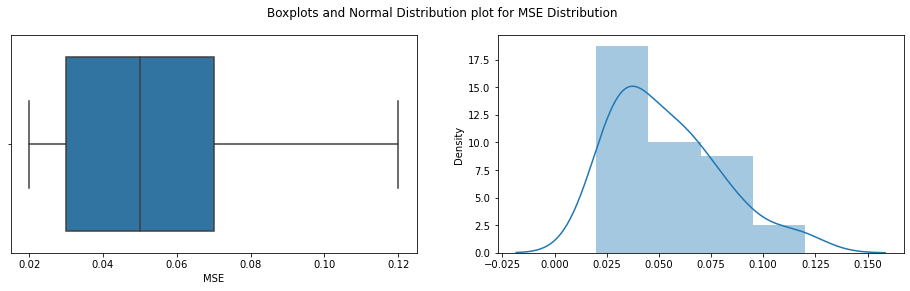

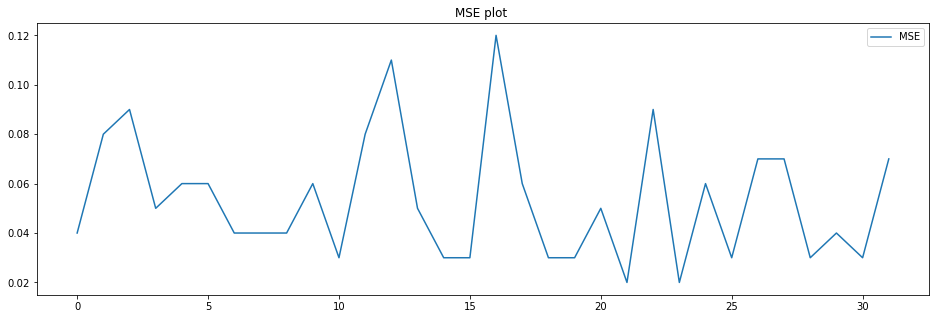


Shapiro_Wilk Test
Statistics=0.932, p=0.0457755700
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=4.886, p=0.087
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.703
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 193
mean=0.048 ,max=0.09,min=0.019,variance=0.0003


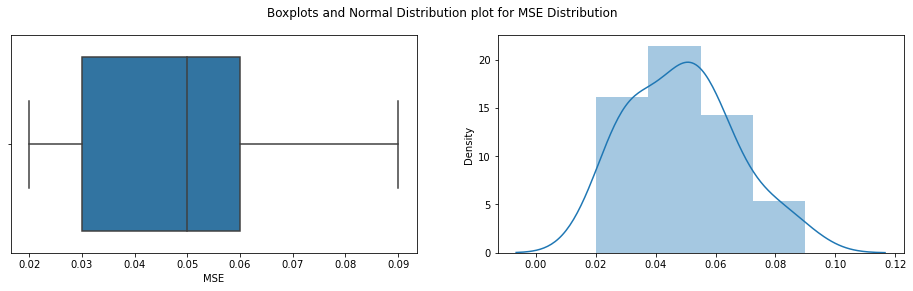

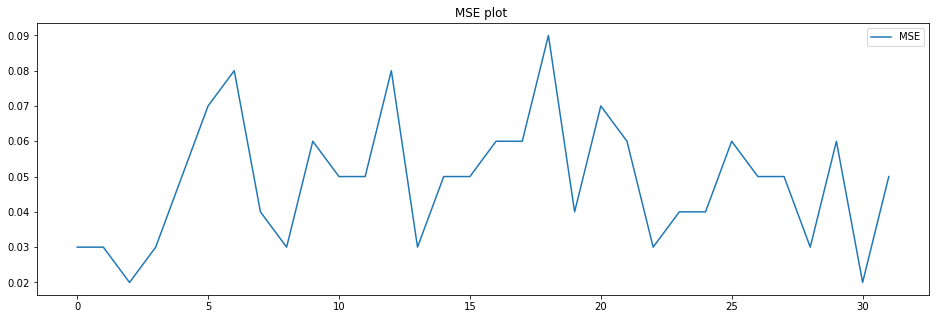


Shapiro_Wilk Test
Statistics=0.972, p=0.5546828508
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.031, p=0.597
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.270
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 194
mean=0.053 ,max=0.113,min=0.023,variance=0.00041


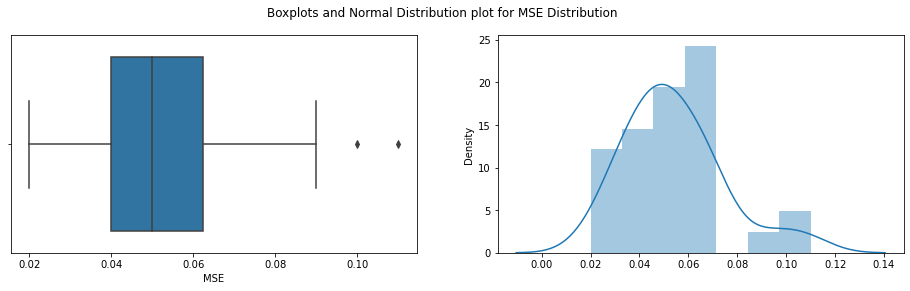

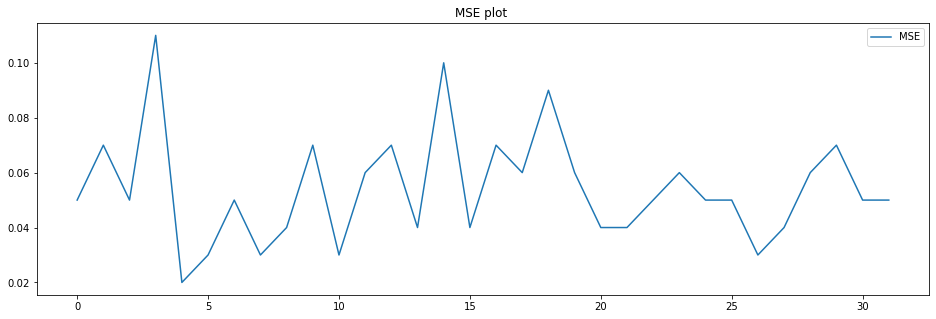


Shapiro_Wilk Test
Statistics=0.939, p=0.0711902678
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.954, p=0.051
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.531
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 195
mean=0.053 ,max=0.097,min=0.011,variance=0.00042


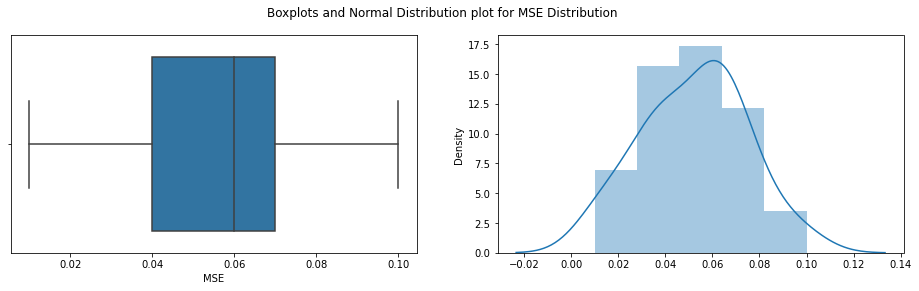

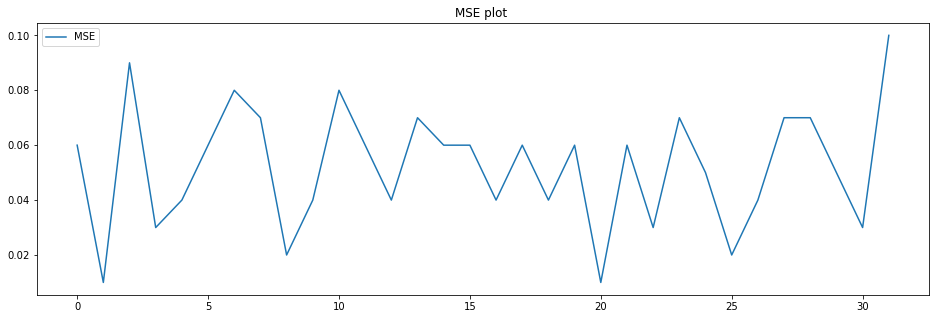


Shapiro_Wilk Test
Statistics=0.972, p=0.5682973266
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.273, p=0.872
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.404
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 196
mean=0.052 ,max=0.108,min=0.011,variance=0.00047


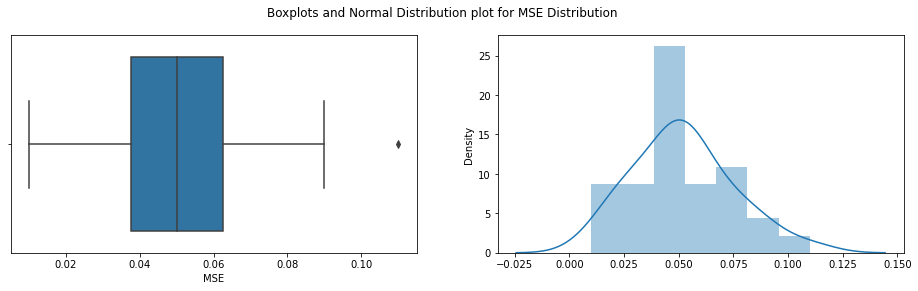

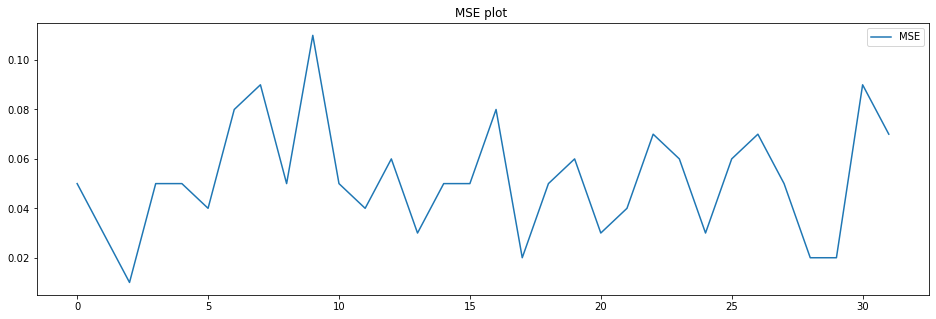


Shapiro_Wilk Test
Statistics=0.969, p=0.4667963684
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.019, p=0.364
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.432
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 197
mean=0.054 ,max=0.099,min=0.022,variance=0.0004


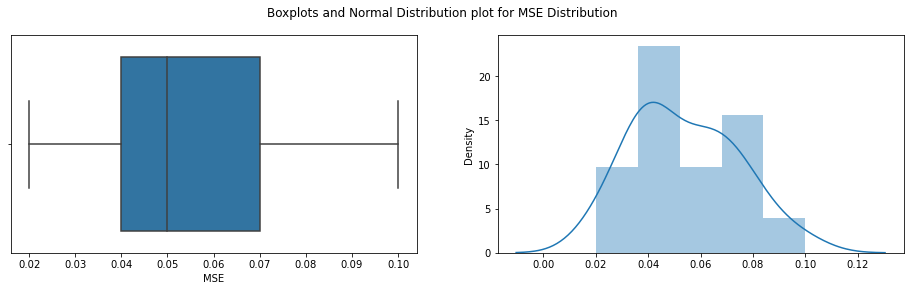

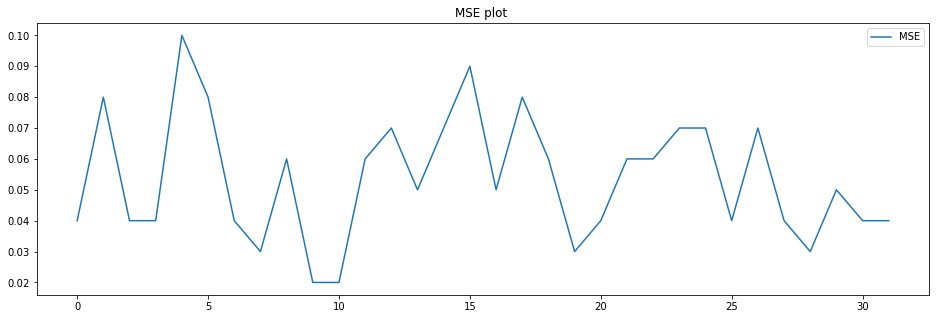


Shapiro_Wilk Test
Statistics=0.967, p=0.4198943079
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.822, p=0.402
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.342
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 198
mean=0.056 ,max=0.102,min=0.022,variance=0.00037


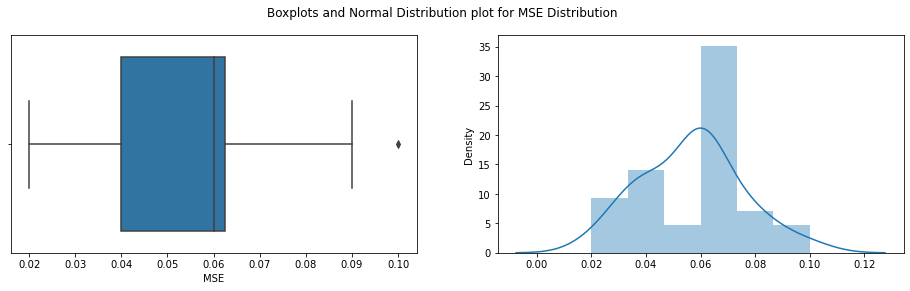

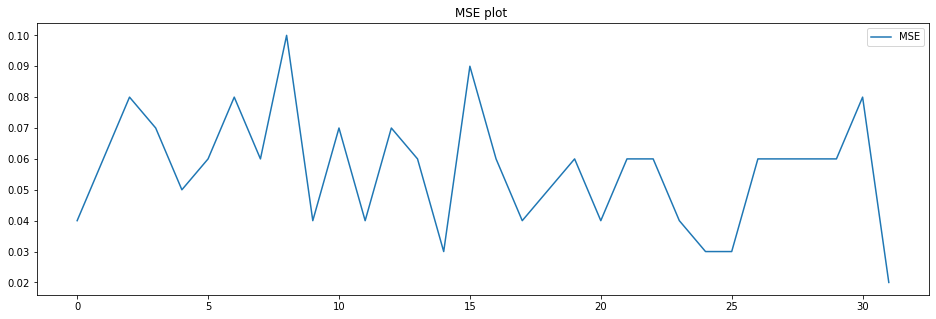


Shapiro_Wilk Test
Statistics=0.971, p=0.5211812258
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.411, p=0.814
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.396
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 199
mean=0.06 ,max=0.105,min=0.025,variance=0.00058


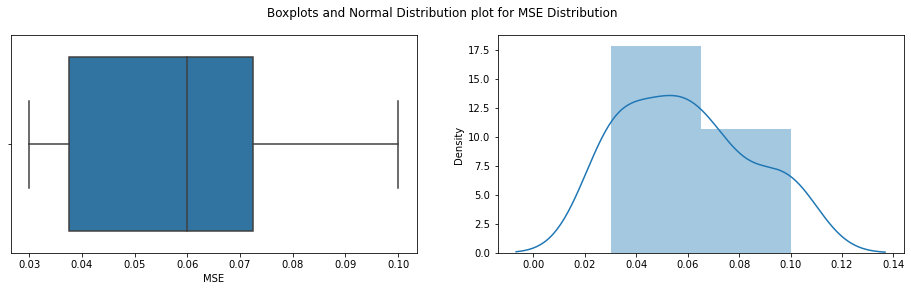

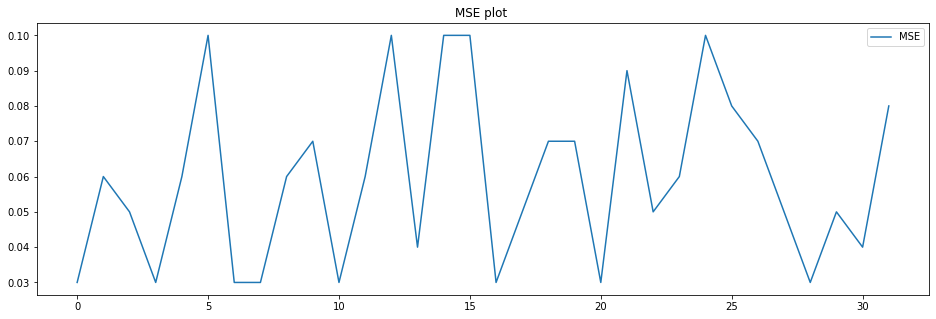


Shapiro_Wilk Test
Statistics=0.930, p=0.0399501212
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=2.888, p=0.236
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.638
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 200
mean=0.057 ,max=0.137,min=0.015,variance=0.00076


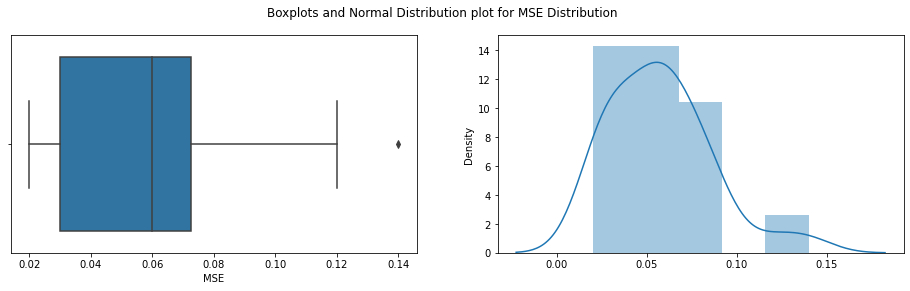

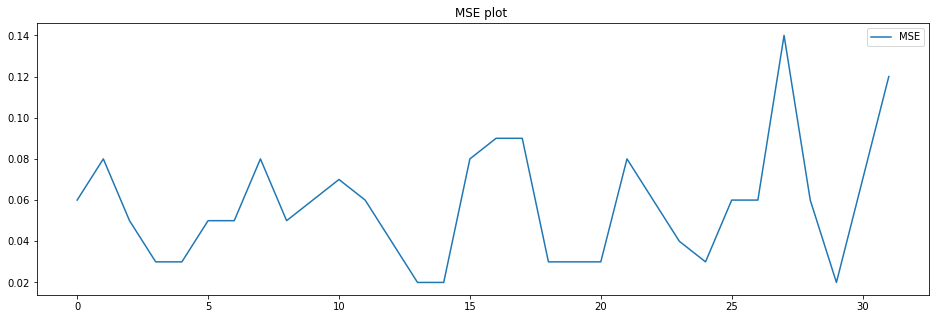


Shapiro_Wilk Test
Statistics=0.946, p=0.1087746695
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.851, p=0.054
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.438
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 201
mean=0.054 ,max=0.145,min=0.019,variance=0.00078


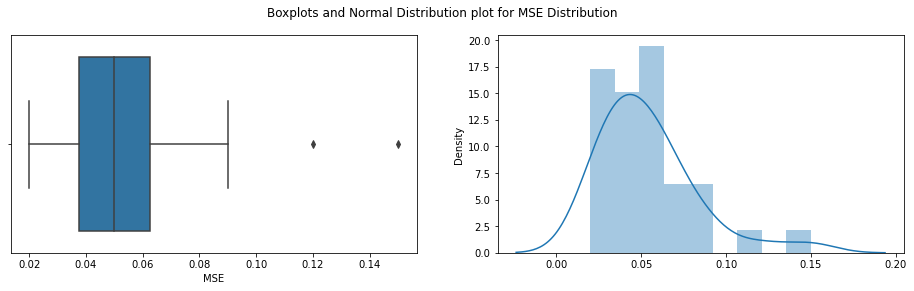

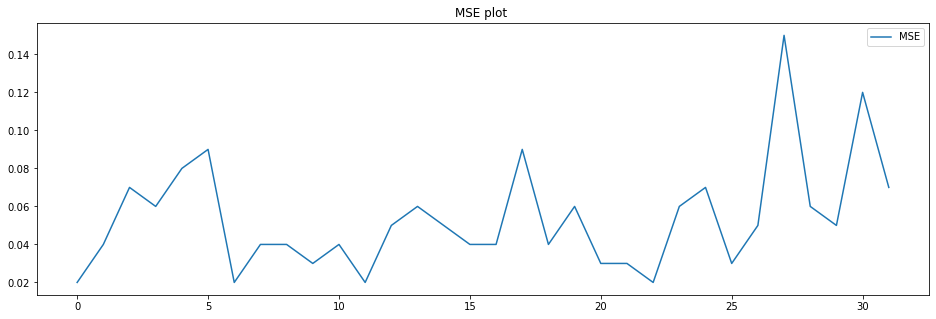


Shapiro_Wilk Test
Statistics=0.884, p=0.0025314295
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=15.530, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.933
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 202
mean=0.057 ,max=0.124,min=0.019,variance=0.0006


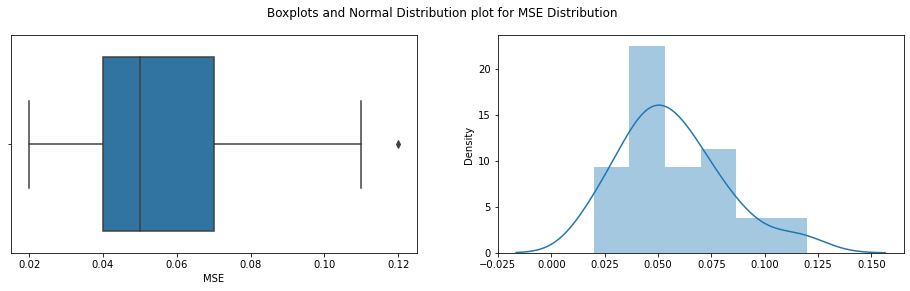

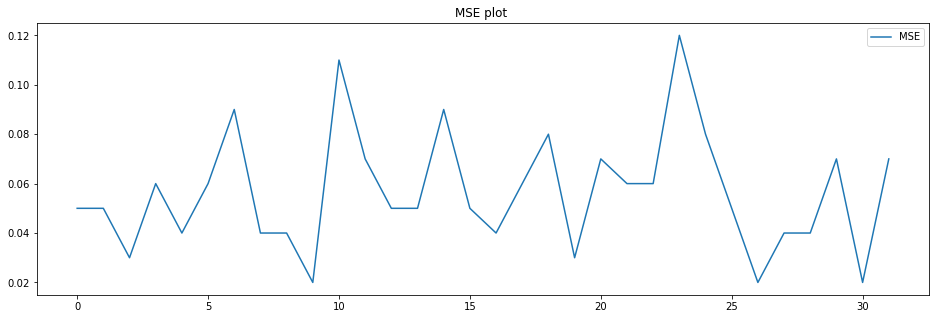


Shapiro_Wilk Test
Statistics=0.956, p=0.2109917700
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.496, p=0.106
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.376
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 203
mean=0.055 ,max=0.103,min=0.018,variance=0.00037


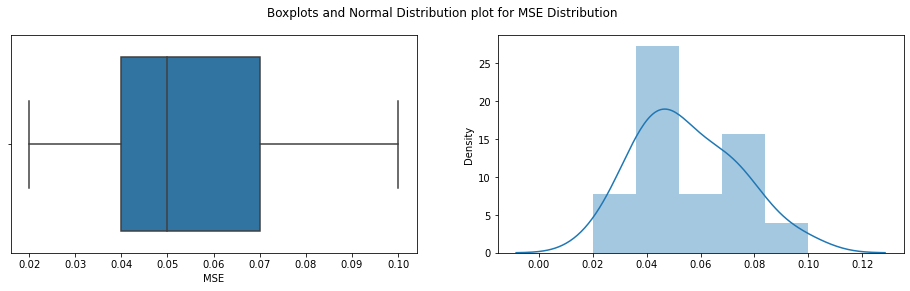

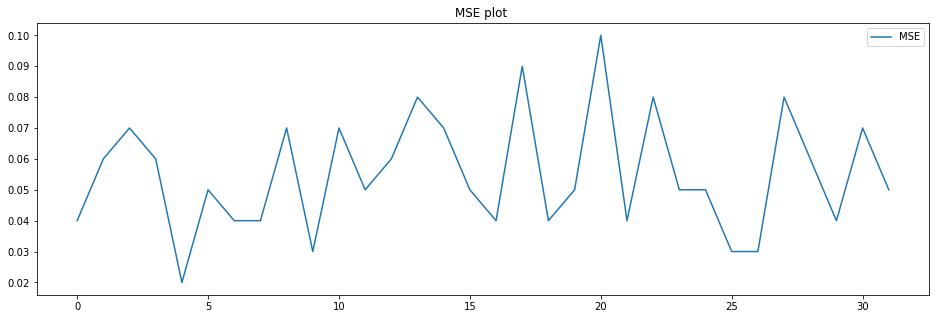


Shapiro_Wilk Test
Statistics=0.983, p=0.8761676550
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.681, p=0.711
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.238
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 204
mean=0.056 ,max=0.108,min=0.023,variance=0.00037


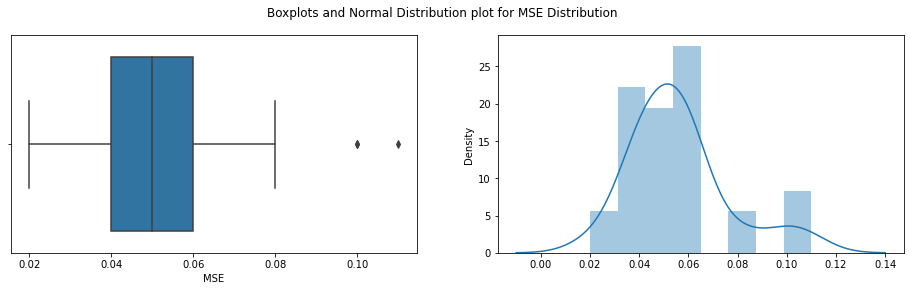

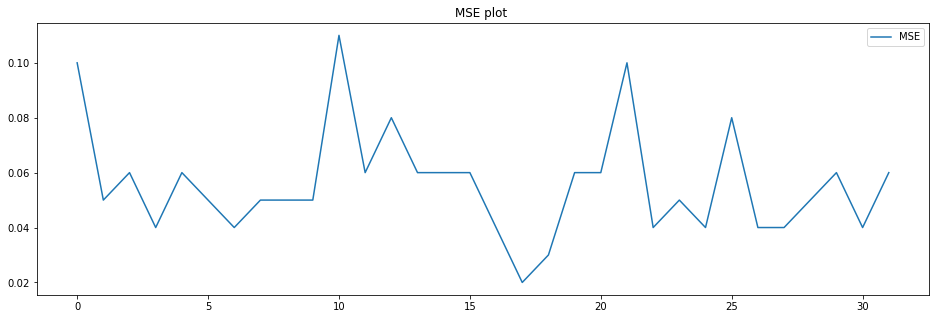


Shapiro_Wilk Test
Statistics=0.879, p=0.0018612692
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=10.858, p=0.004
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.439
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 205
mean=0.053 ,max=0.113,min=0.016,variance=0.00057


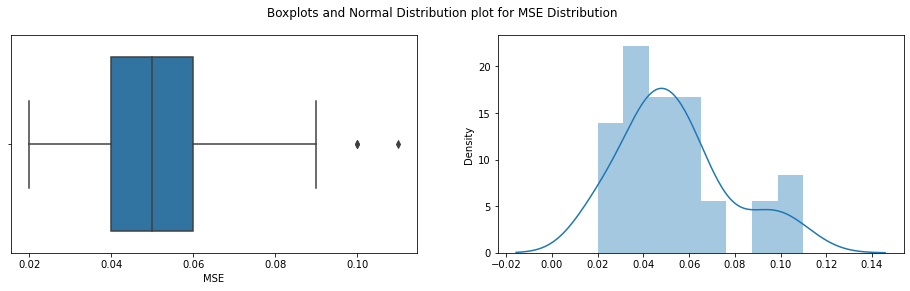

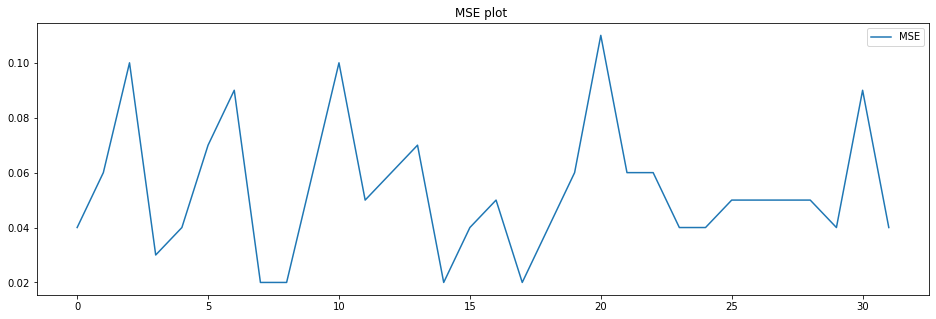


Shapiro_Wilk Test
Statistics=0.934, p=0.0502652451
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.250, p=0.119
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.761
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 206
mean=0.051 ,max=0.106,min=0.012,variance=0.00038


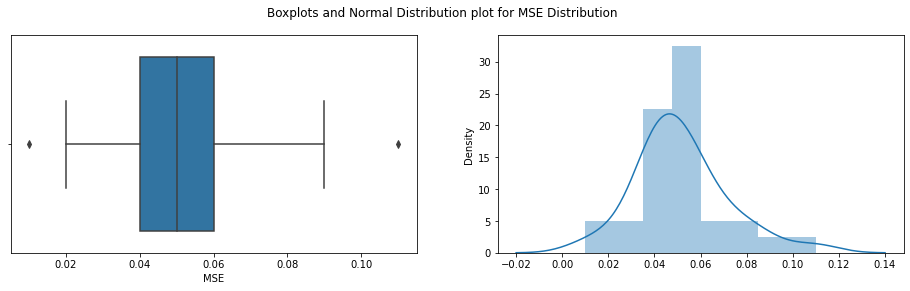

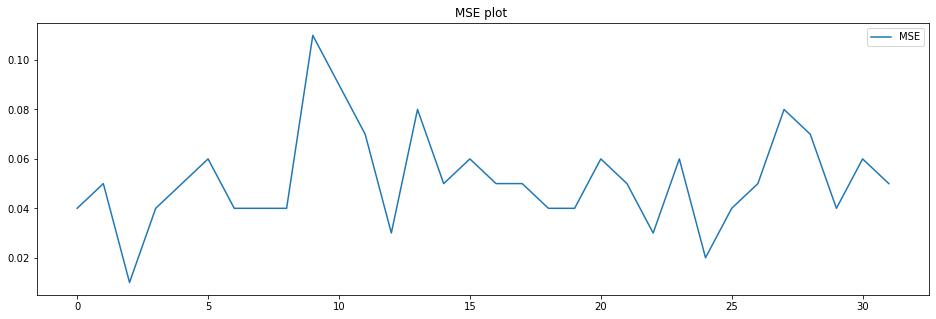


Shapiro_Wilk Test
Statistics=0.961, p=0.2835883200
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.225, p=0.121
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.552
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 207
mean=0.051 ,max=0.1,min=0.01,variance=0.00044


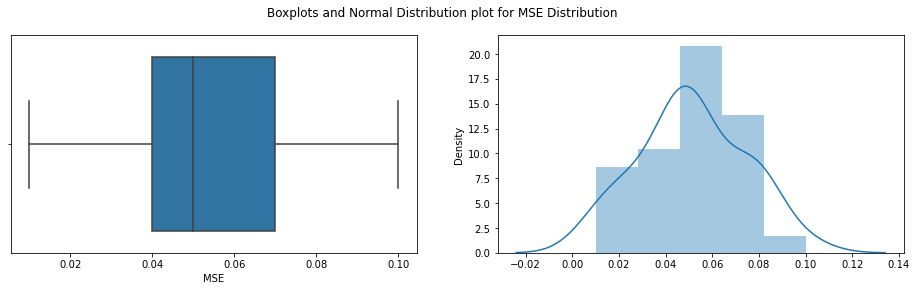

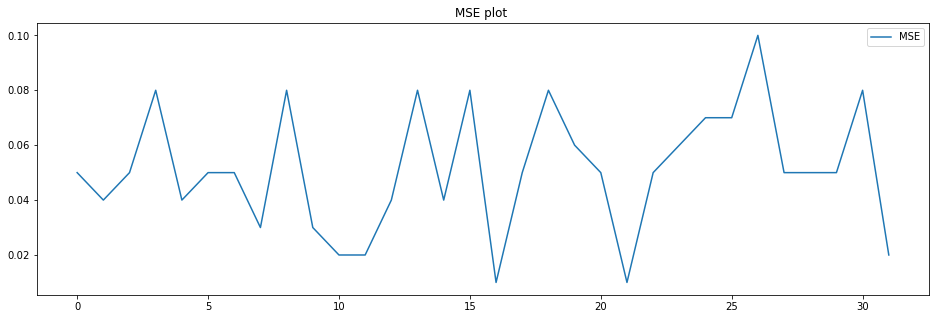


Shapiro_Wilk Test
Statistics=0.977, p=0.7024801970
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.015, p=0.993
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.290
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 208
mean=0.052 ,max=0.112,min=0.018,variance=0.00058


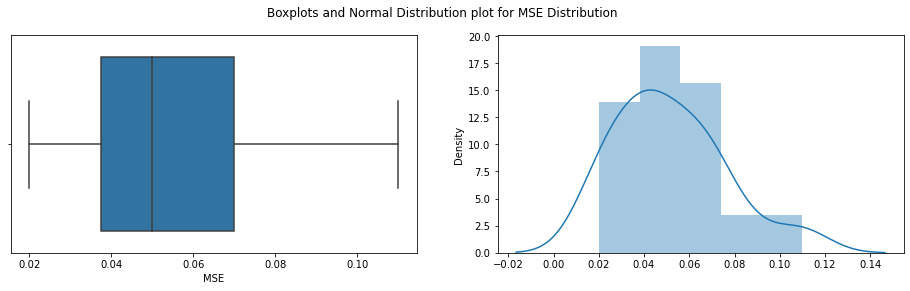

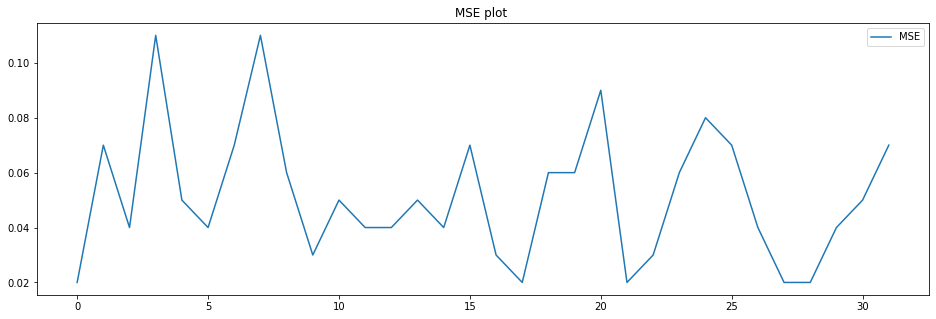


Shapiro_Wilk Test
Statistics=0.944, p=0.0947997868
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.725, p=0.155
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.501
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 209
mean=0.046 ,max=0.084,min=0.011,variance=0.00035


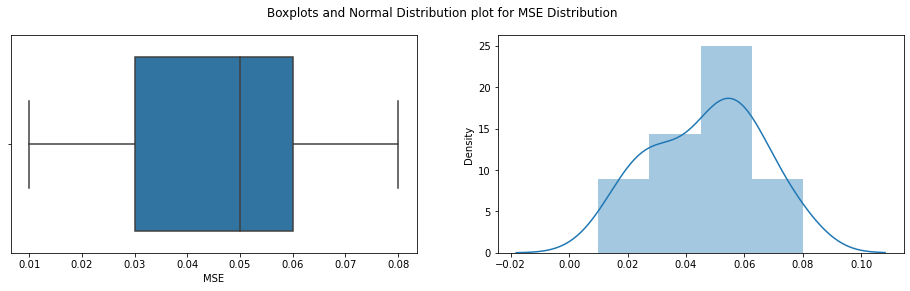

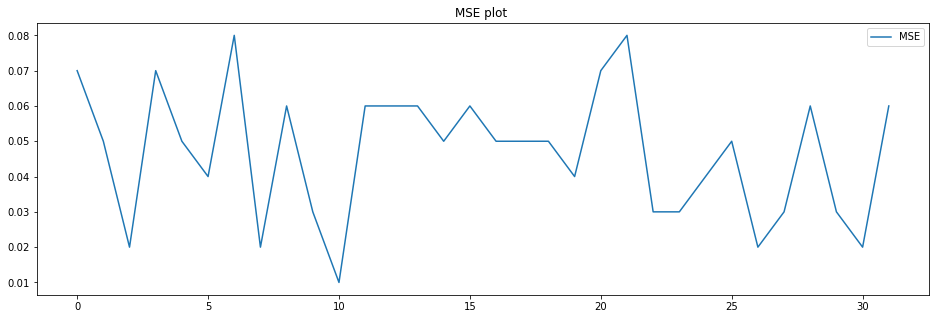


Shapiro_Wilk Test
Statistics=0.977, p=0.7006285191
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.080, p=0.583
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.267
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 210
mean=0.052 ,max=0.101,min=0.02,variance=0.00031


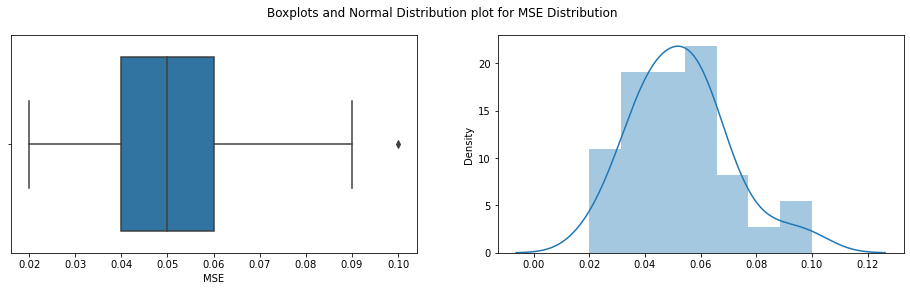

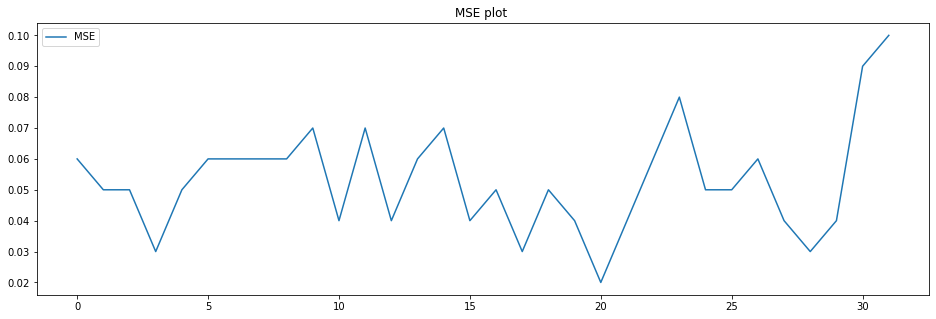


Shapiro_Wilk Test
Statistics=0.969, p=0.4779610932
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.882, p=0.144
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.304
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 211
mean=0.052 ,max=0.141,min=0.013,variance=0.00075


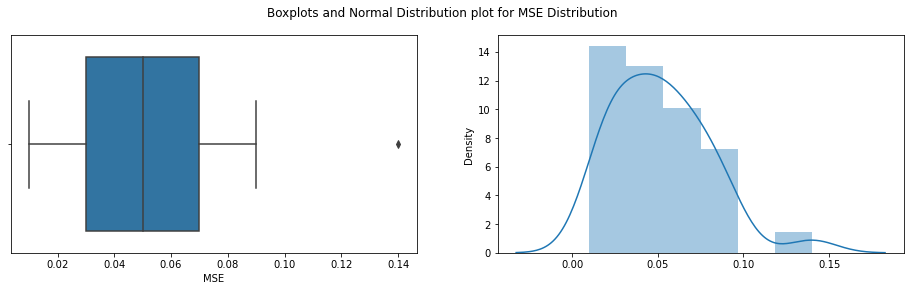

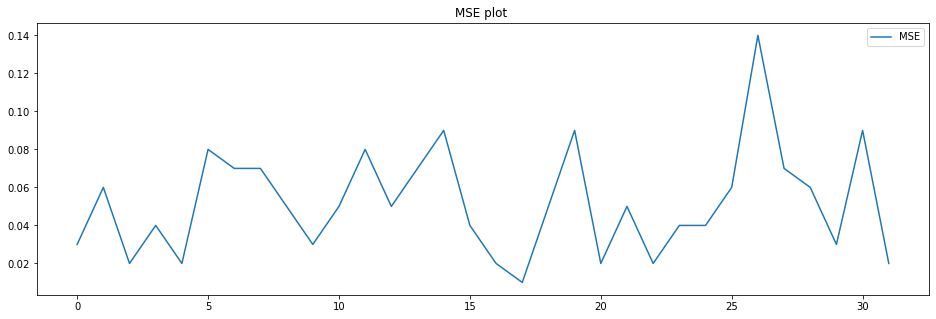


Shapiro_Wilk Test
Statistics=0.932, p=0.0442043655
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=8.367, p=0.015
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.417
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 212
mean=0.052 ,max=0.101,min=0.002,variance=0.00062


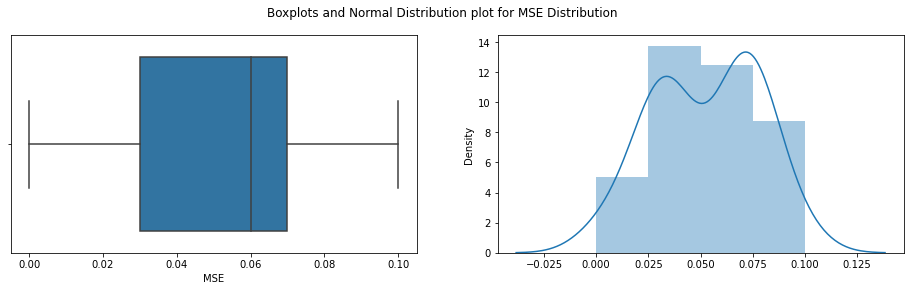

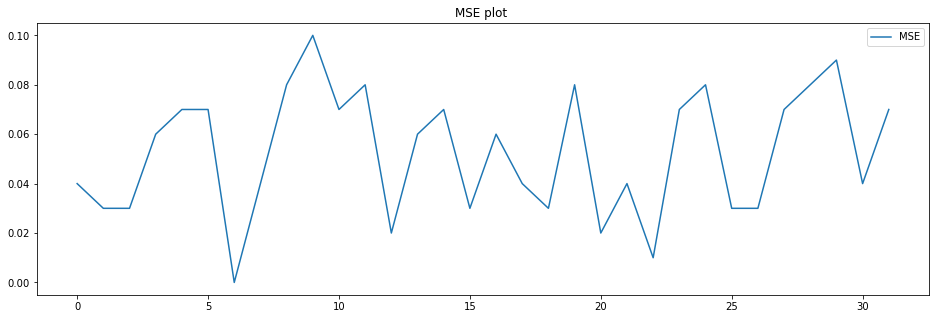


Shapiro_Wilk Test
Statistics=0.952, p=0.1658122838
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.794, p=0.247
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.749
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 213
mean=0.062 ,max=0.111,min=0.021,variance=0.00058


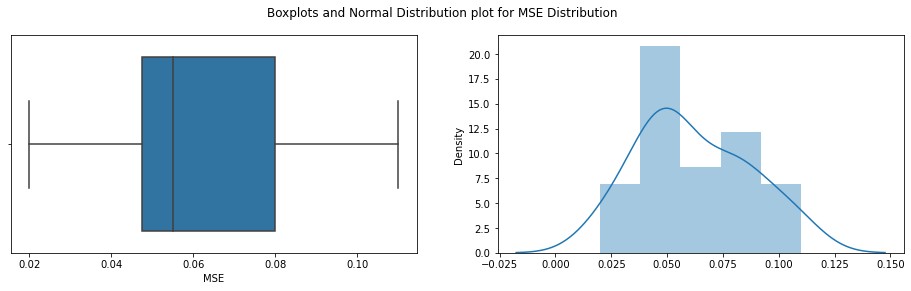

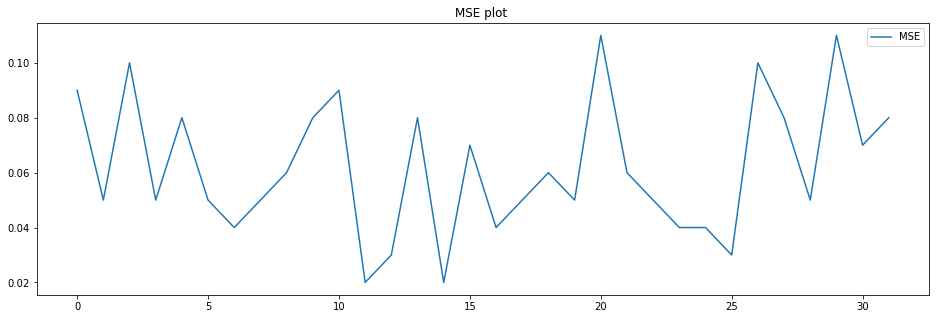


Shapiro_Wilk Test
Statistics=0.958, p=0.2459386736
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.949, p=0.377
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.497
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 214
mean=0.052 ,max=0.094,min=0.013,variance=0.0004


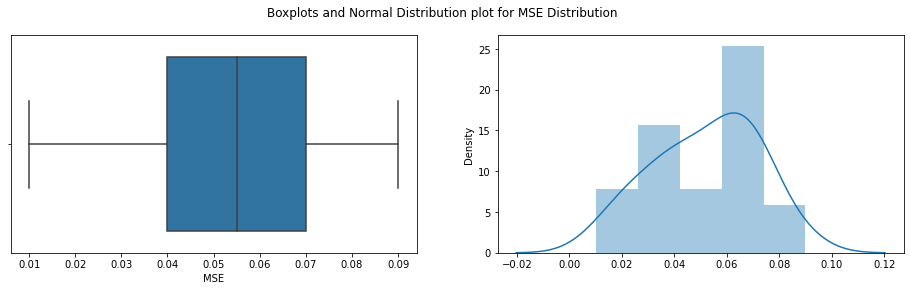

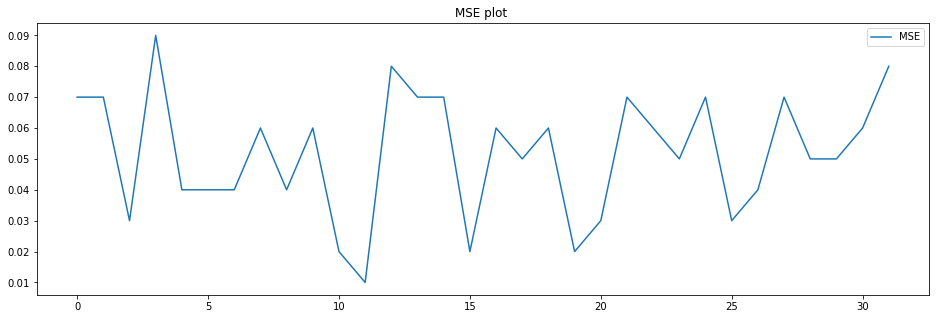


Shapiro_Wilk Test
Statistics=0.974, p=0.6313793659
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.799, p=0.671
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.333
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 215
mean=0.056 ,max=0.104,min=0.008,variance=0.00065


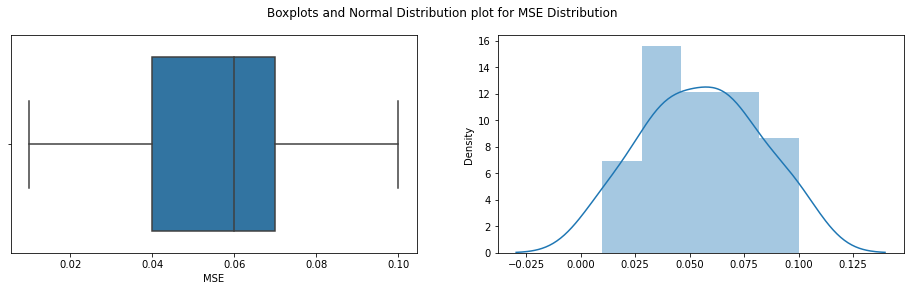

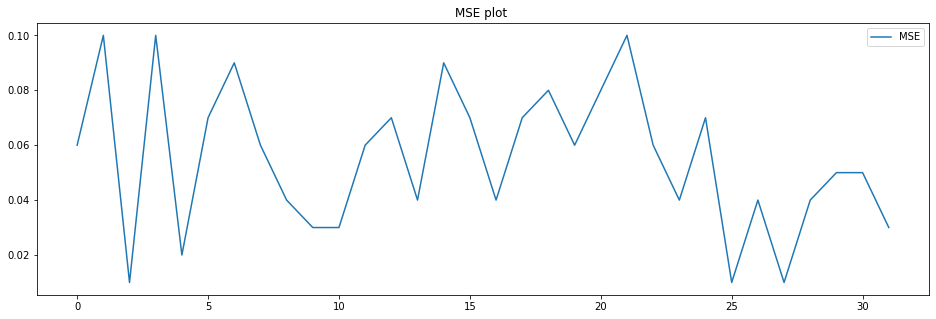


Shapiro_Wilk Test
Statistics=0.973, p=0.5971531272
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.079, p=0.583
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.259
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 216
mean=0.049 ,max=0.072,min=0.027,variance=0.00018


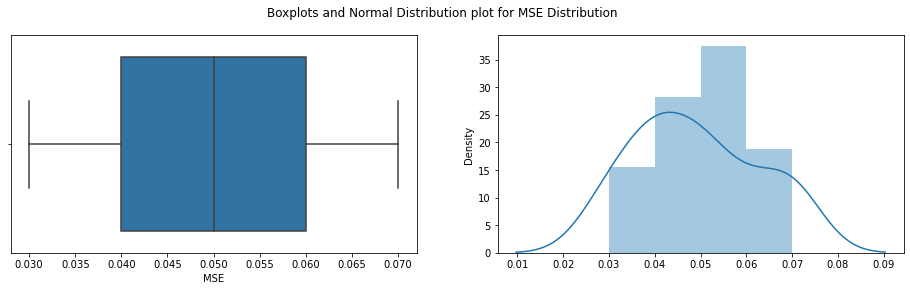

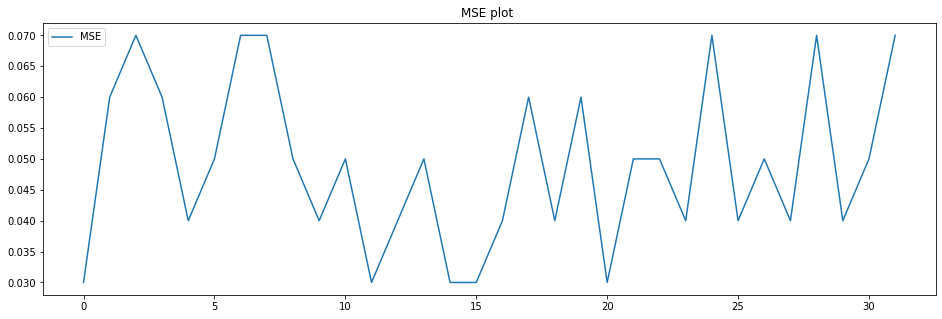


Shapiro_Wilk Test
Statistics=0.952, p=0.1623685658
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.284, p=0.194
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.380
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 217
mean=0.051 ,max=0.102,min=0.012,variance=0.00037


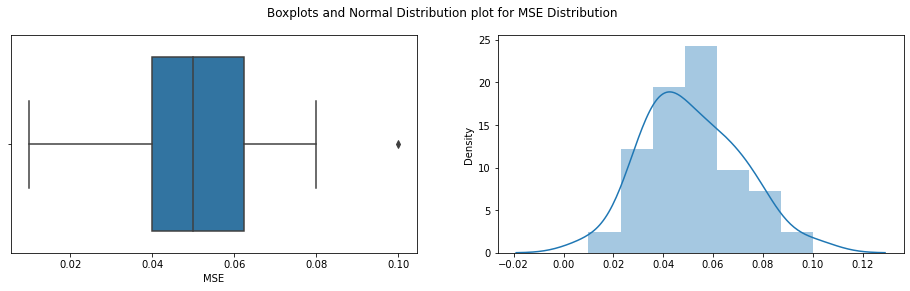

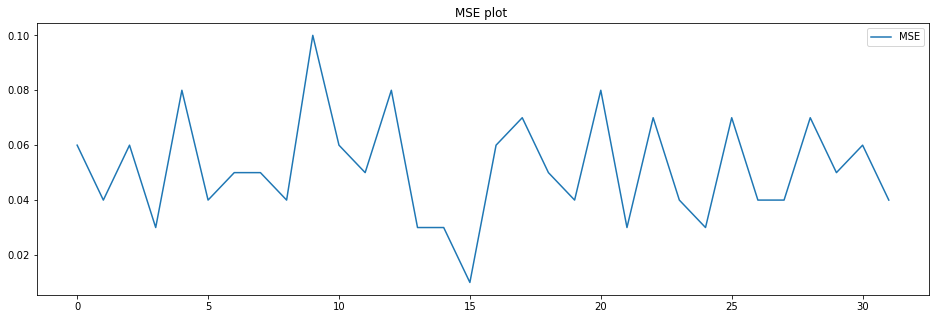


Shapiro_Wilk Test
Statistics=0.975, p=0.6433434486
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.780, p=0.411
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.336
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 218
mean=0.048 ,max=0.08,min=0.012,variance=0.00033


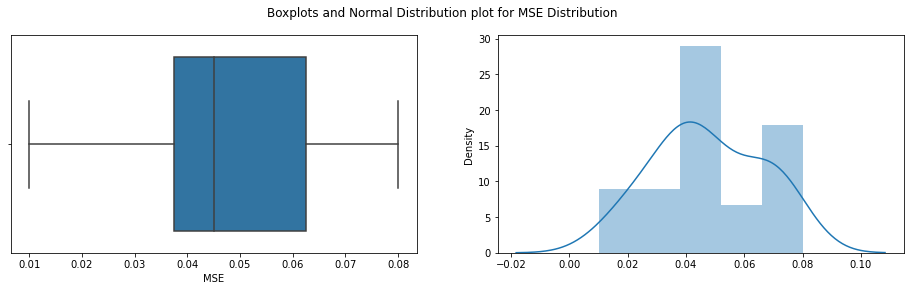

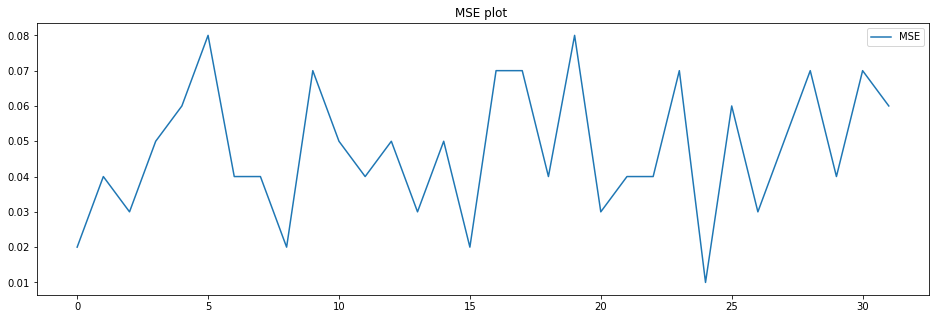


Shapiro_Wilk Test
Statistics=0.954, p=0.1832855195
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.842, p=0.242
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.542
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 219
mean=0.06 ,max=0.094,min=0.014,variance=0.00051


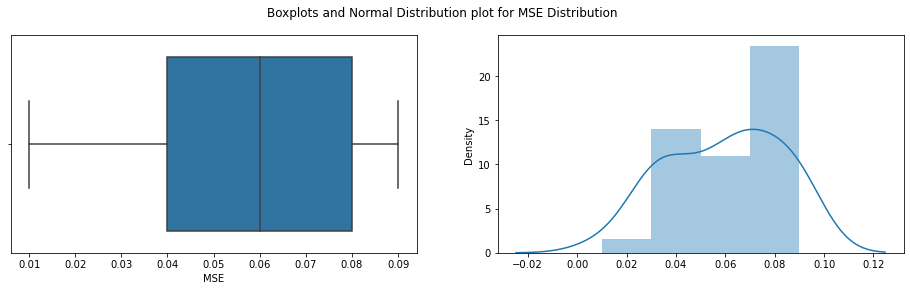

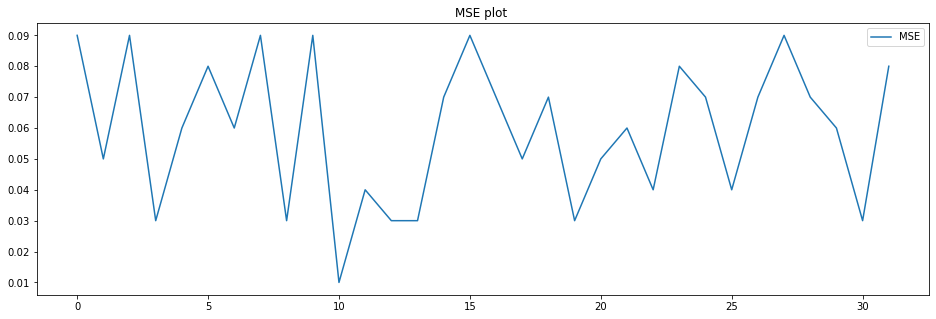


Shapiro_Wilk Test
Statistics=0.942, p=0.0859270692
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.421, p=0.067
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.618
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 220
mean=0.049 ,max=0.133,min=0.018,variance=0.00075


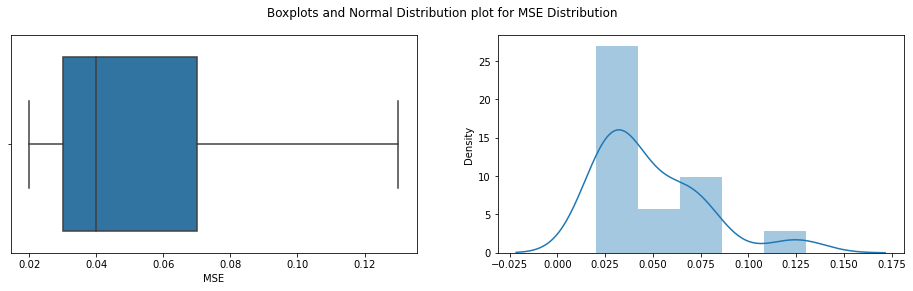

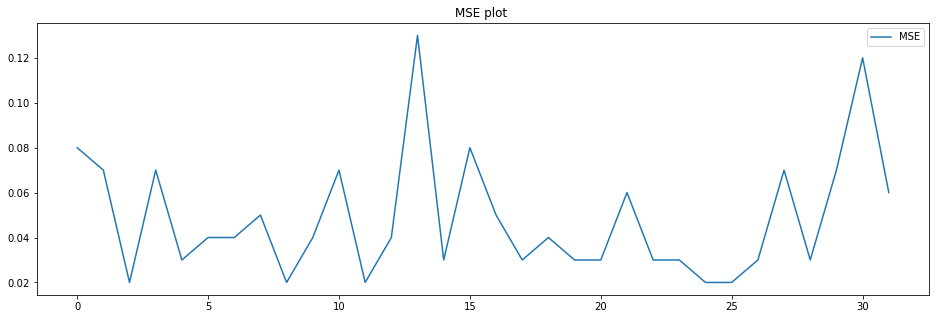


Shapiro_Wilk Test
Statistics=0.872, p=0.0012975974
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=11.523, p=0.003
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.234
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 221
mean=0.057 ,max=0.112,min=0.02,variance=0.00047


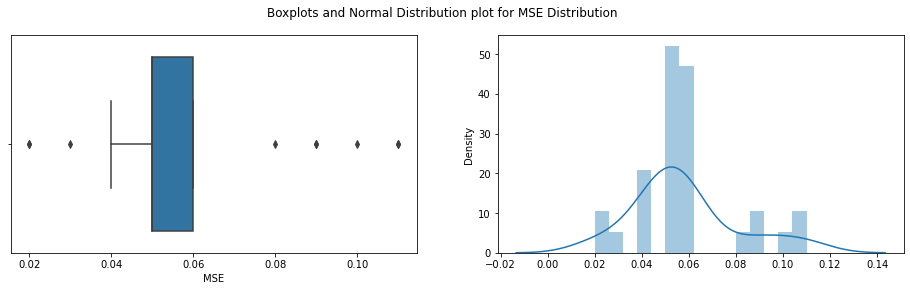

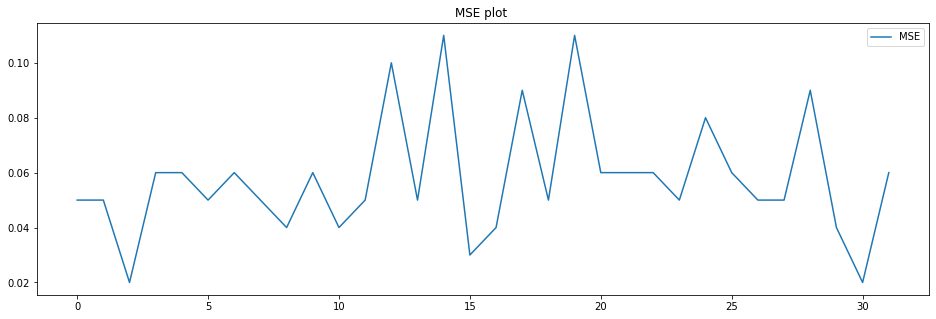


Shapiro_Wilk Test
Statistics=0.905, p=0.0081286458
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=6.531, p=0.038
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.270
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 222
mean=0.058 ,max=0.121,min=0.016,variance=0.00048


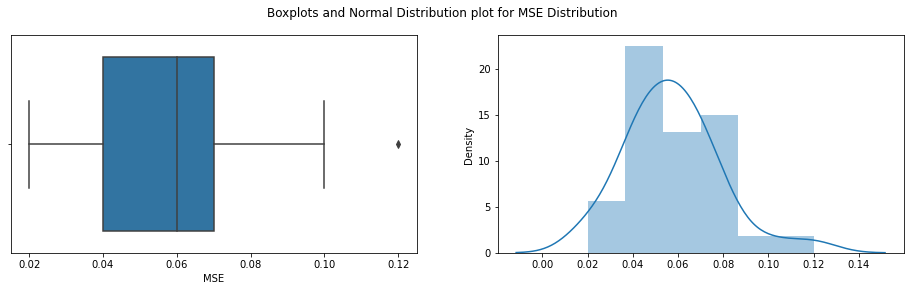

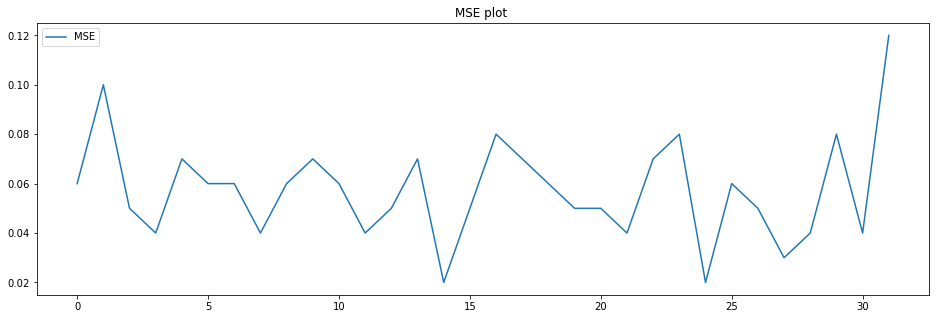


Shapiro_Wilk Test
Statistics=0.975, p=0.6367216706
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.386, p=0.184
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.252
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 223
mean=0.05 ,max=0.088,min=0.008,variance=0.00031


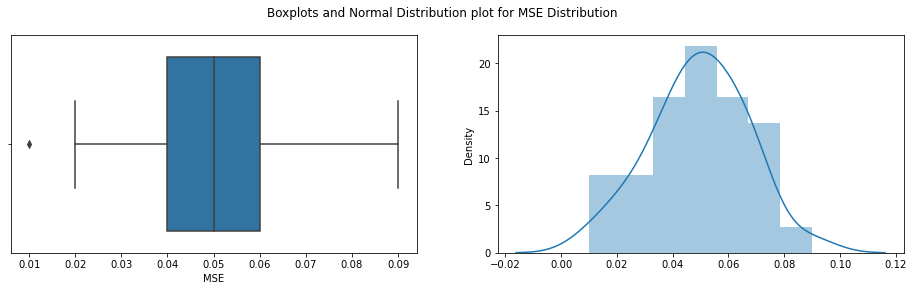

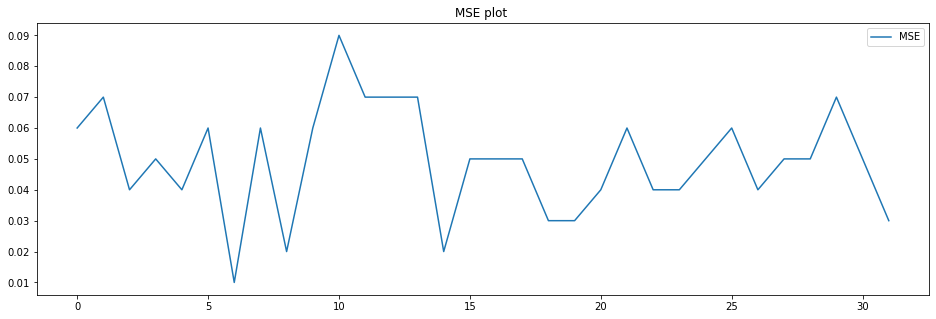


Shapiro_Wilk Test
Statistics=0.985, p=0.9173752666
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.320, p=0.852
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.227
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 224
mean=0.052 ,max=0.119,min=0.019,variance=0.00032


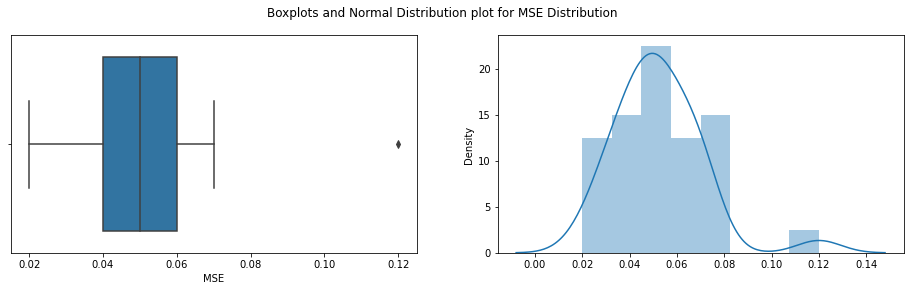

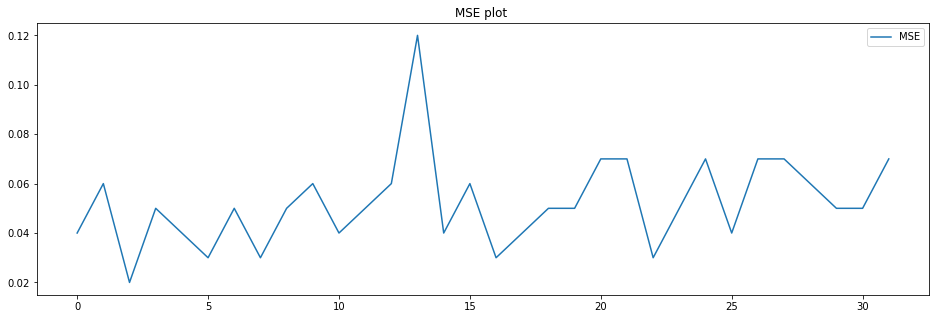


Shapiro_Wilk Test
Statistics=0.902, p=0.0067799683
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=17.953, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.625
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 225
mean=0.047 ,max=0.101,min=0.012,variance=0.00043


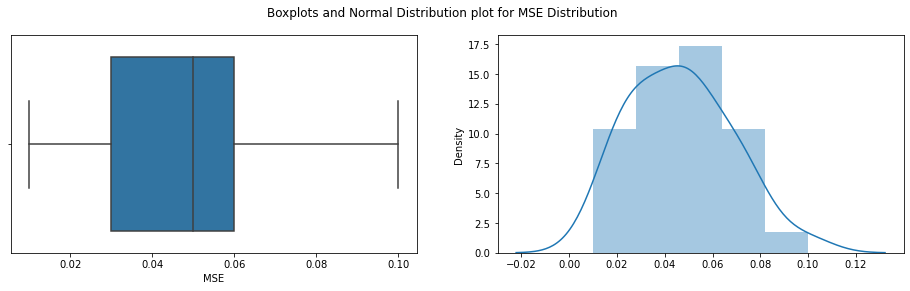

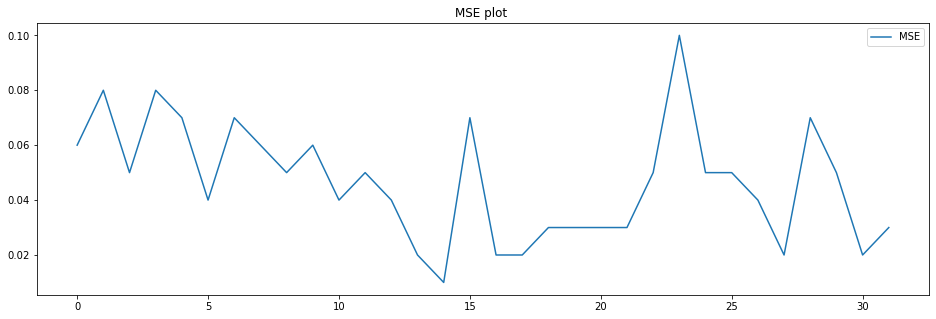


Shapiro_Wilk Test
Statistics=0.963, p=0.3225502670
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.278, p=0.528
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.393
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 226
mean=0.048 ,max=0.103,min=0.01,variance=0.00055


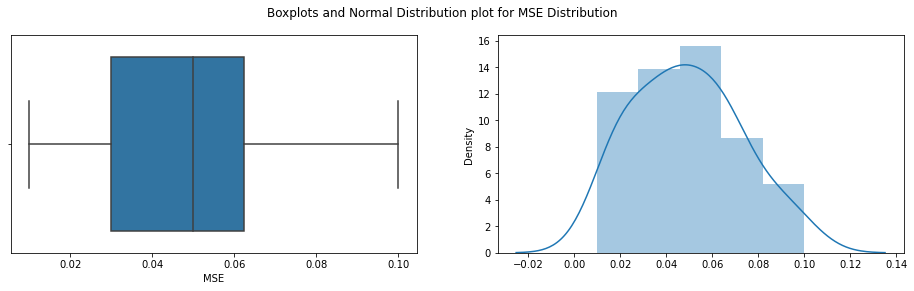

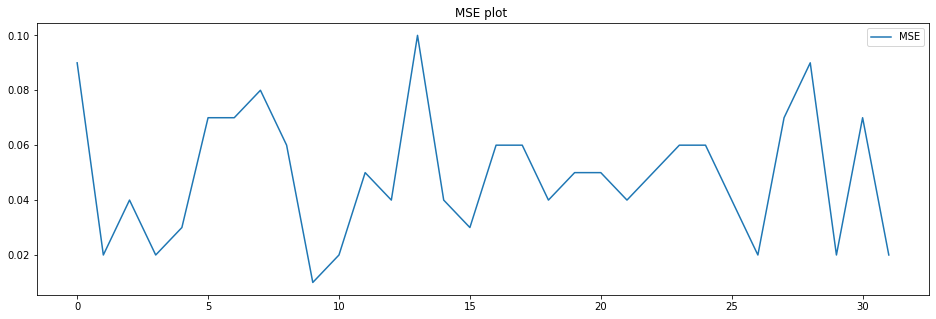


Shapiro_Wilk Test
Statistics=0.970, p=0.5037159324
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.374, p=0.503
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.286
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 227
mean=0.05 ,max=0.092,min=0.016,variance=0.00031


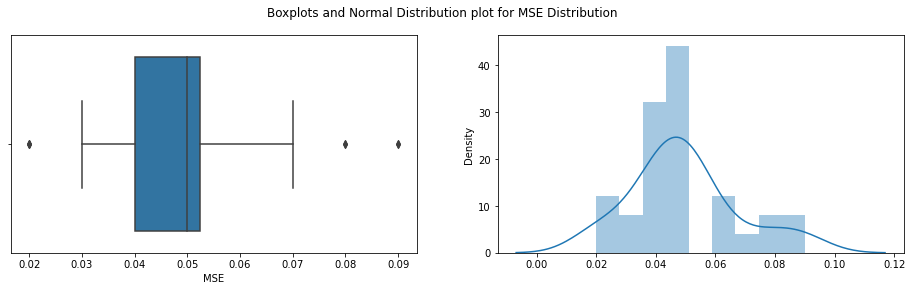

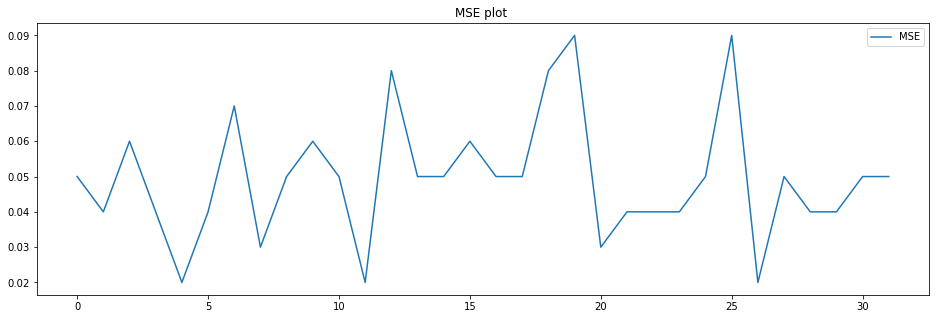


Shapiro_Wilk Test
Statistics=0.935, p=0.0534727238
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.665, p=0.160
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.894
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 228
mean=0.055 ,max=0.12,min=0.021,variance=0.00045


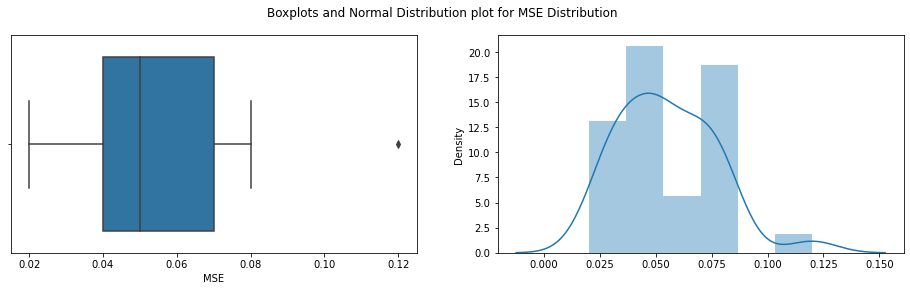

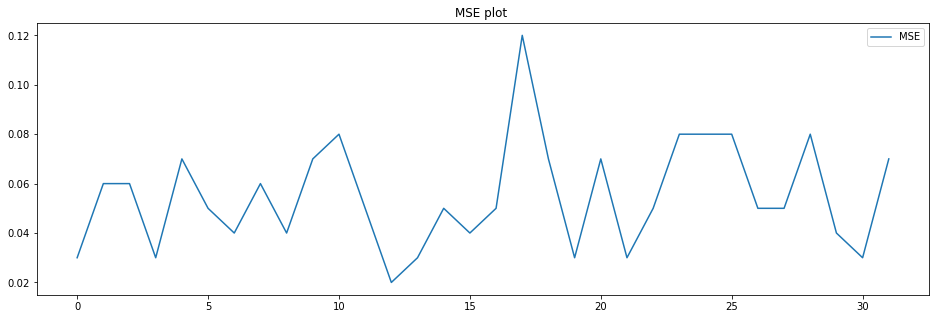


Shapiro_Wilk Test
Statistics=0.948, p=0.1290068179
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.654, p=0.161
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.375
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 229
mean=0.05 ,max=0.106,min=0.018,variance=0.00042


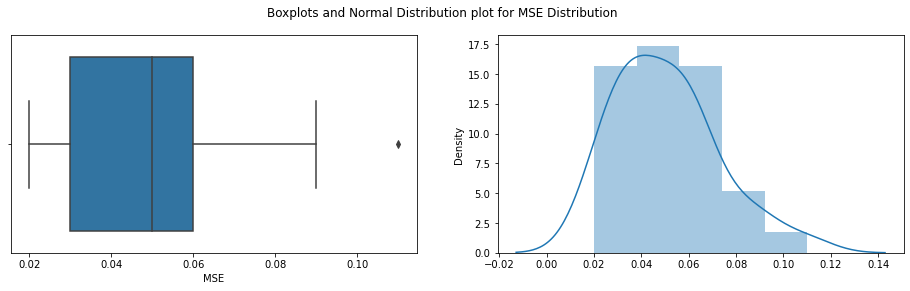

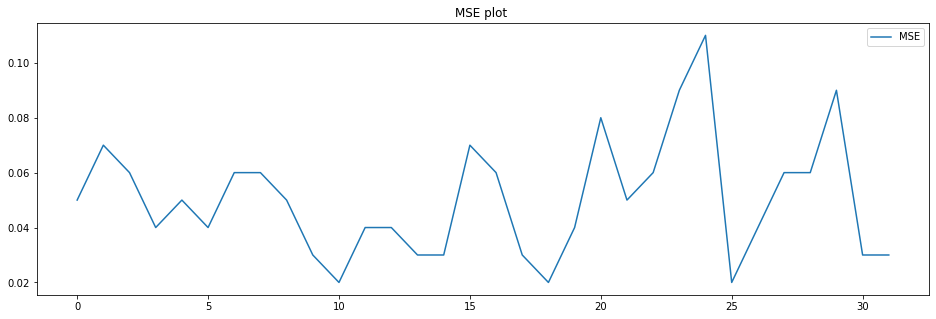


Shapiro_Wilk Test
Statistics=0.948, p=0.1234964132
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.727, p=0.094
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.485
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 230
mean=0.055 ,max=0.097,min=0.023,variance=0.00044


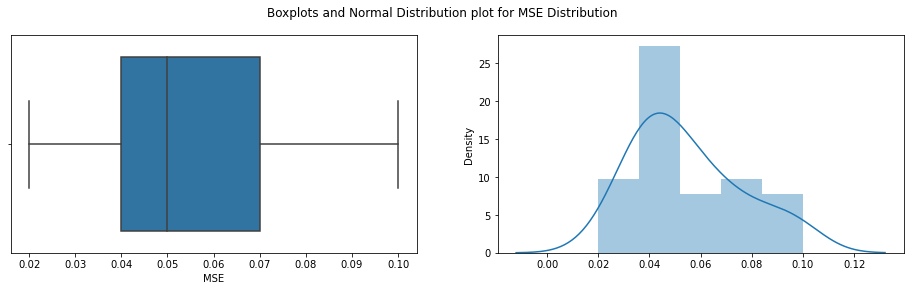

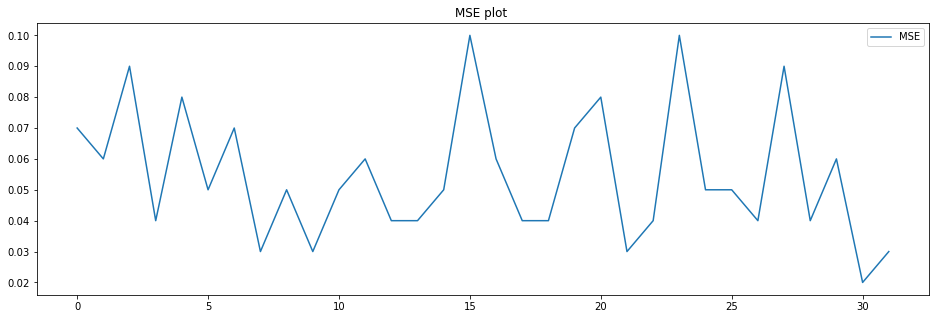


Shapiro_Wilk Test
Statistics=0.934, p=0.0510612577
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.537, p=0.281
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.697
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 231
mean=0.053 ,max=0.111,min=0.017,variance=0.00041


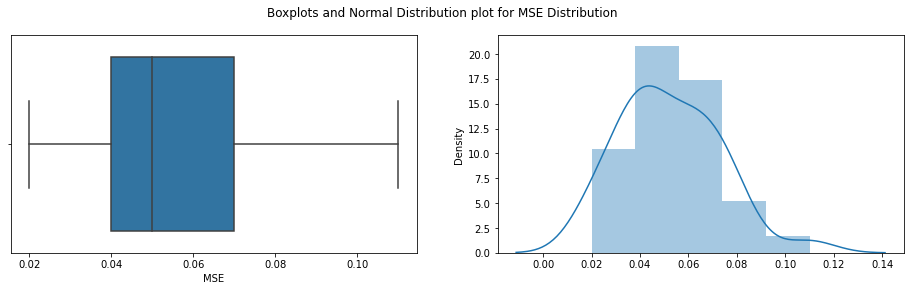

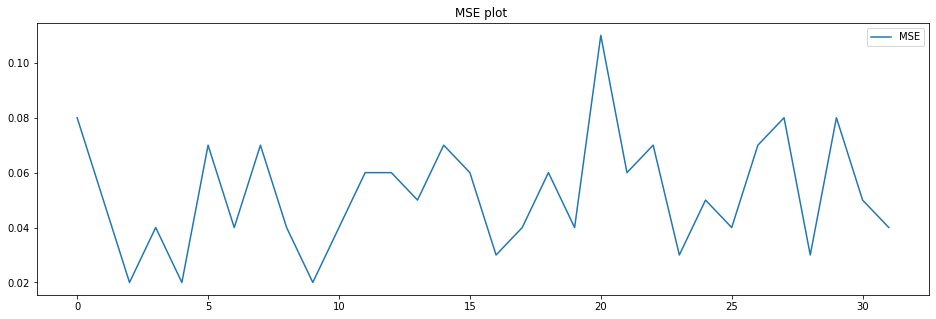


Shapiro_Wilk Test
Statistics=0.972, p=0.5539627671
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.047, p=0.218
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.250
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 232
mean=0.057 ,max=0.105,min=0.019,variance=0.00057


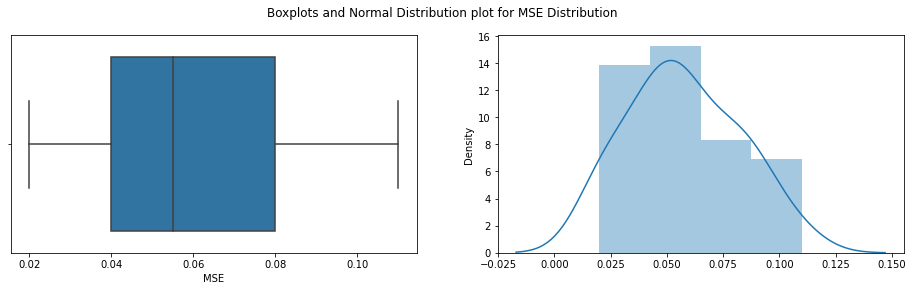

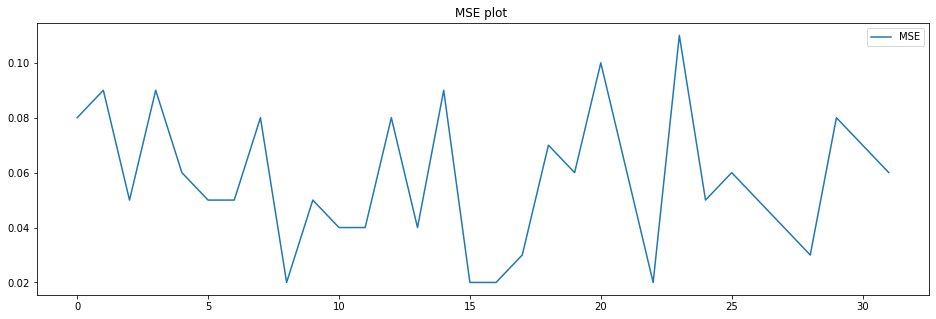


Shapiro_Wilk Test
Statistics=0.966, p=0.3928116262
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.434, p=0.488
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.276
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 233
mean=0.056 ,max=0.093,min=0.013,variance=0.00048


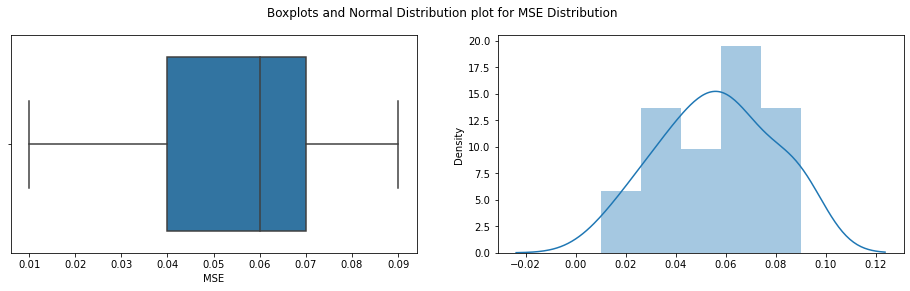

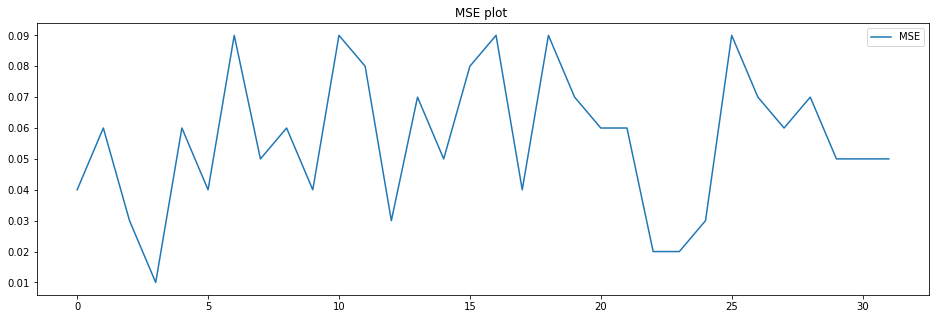


Shapiro_Wilk Test
Statistics=0.971, p=0.5317927599
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.260, p=0.533
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.201
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 234
mean=0.054 ,max=0.103,min=0.018,variance=0.00043


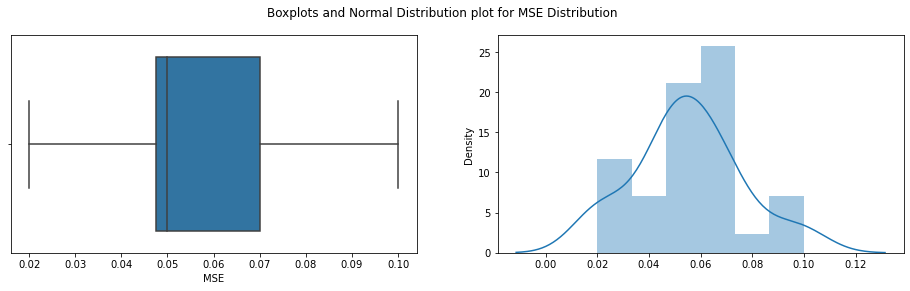

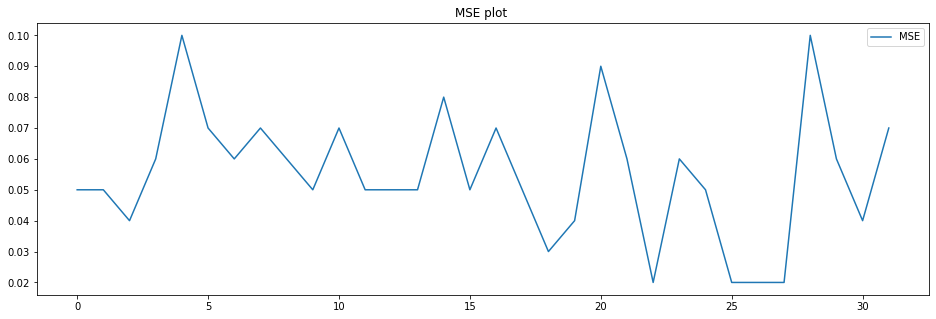


Shapiro_Wilk Test
Statistics=0.957, p=0.2333177775
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.185, p=0.553
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.420
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 235
mean=0.059 ,max=0.12,min=0.018,variance=0.00046


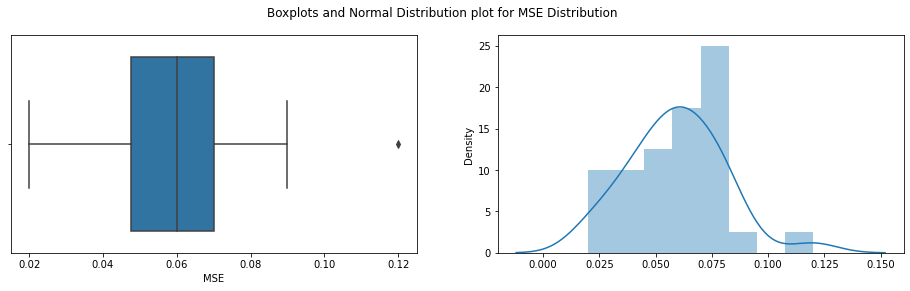

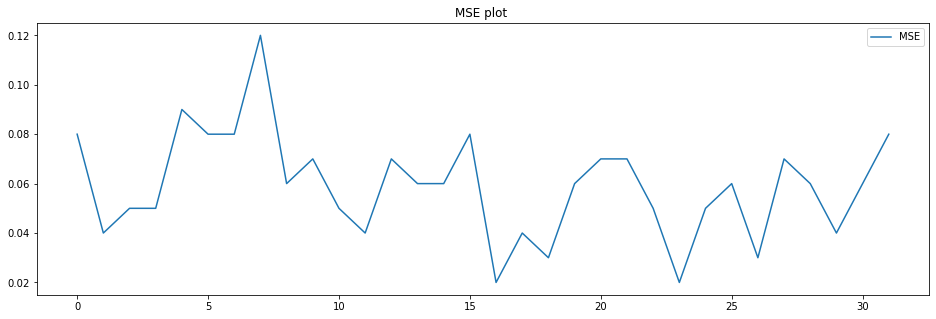


Shapiro_Wilk Test
Statistics=0.975, p=0.6483289599
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.644, p=0.267
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.244
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 236
mean=0.048 ,max=0.095,min=0.012,variance=0.00036


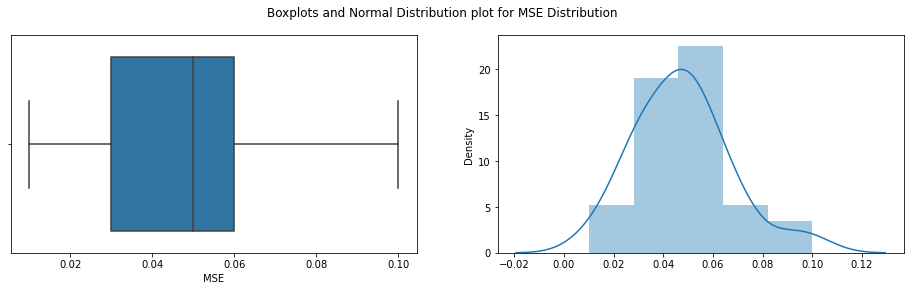

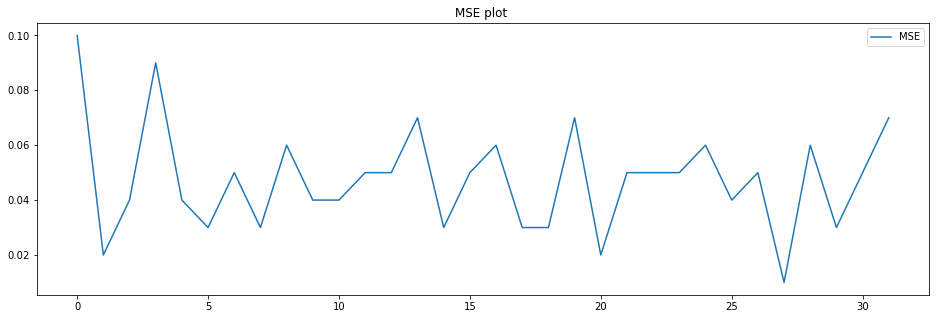


Shapiro_Wilk Test
Statistics=0.975, p=0.6516399384
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.752, p=0.416
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.273
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 237
mean=0.049 ,max=0.111,min=0.008,variance=0.00045


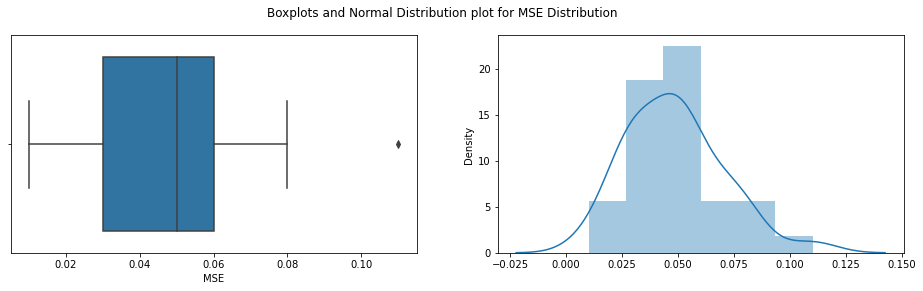

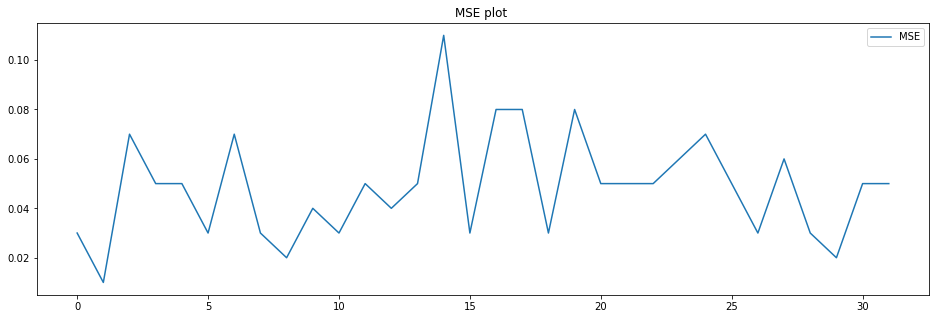


Shapiro_Wilk Test
Statistics=0.958, p=0.2389531285
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.269, p=0.118
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.432
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 238
mean=0.053 ,max=0.103,min=0.018,variance=0.0005


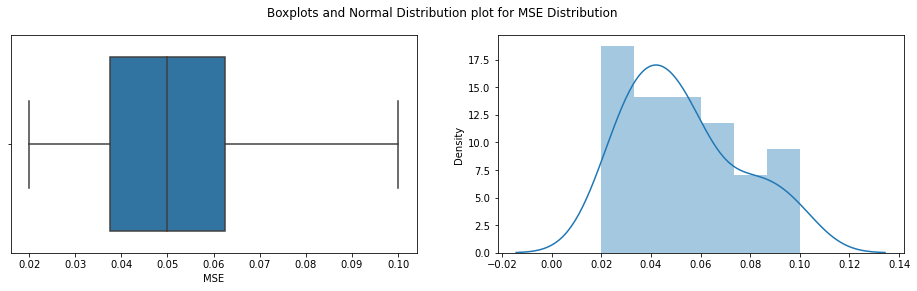

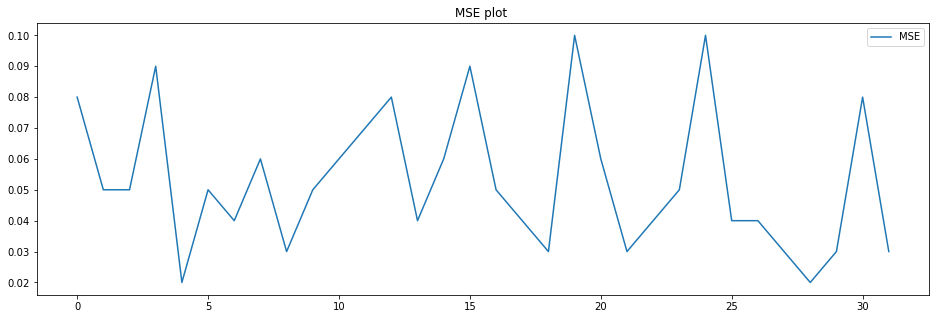


Shapiro_Wilk Test
Statistics=0.941, p=0.0806363747
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.899, p=0.235
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.669
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 239
mean=0.053 ,max=0.129,min=0.007,variance=0.00079


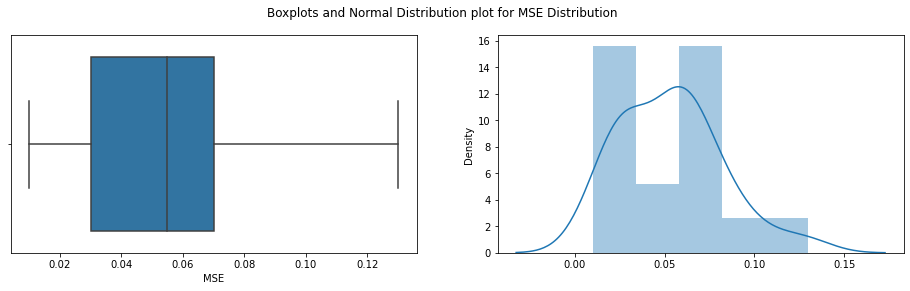

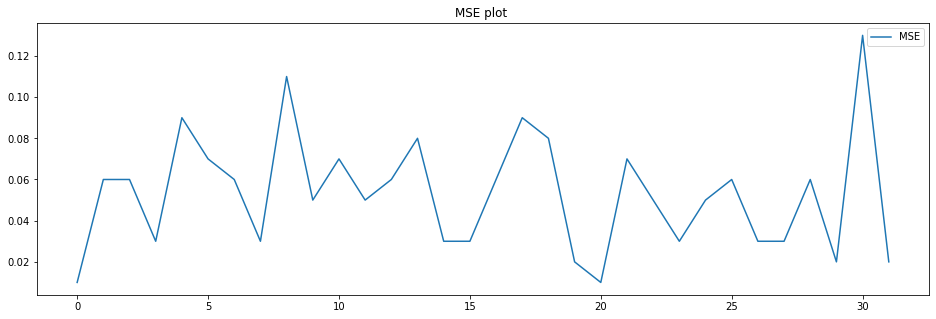


Shapiro_Wilk Test
Statistics=0.960, p=0.2749367654
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.921, p=0.232
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.407
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 240
mean=0.054 ,max=0.107,min=0.018,variance=0.00052


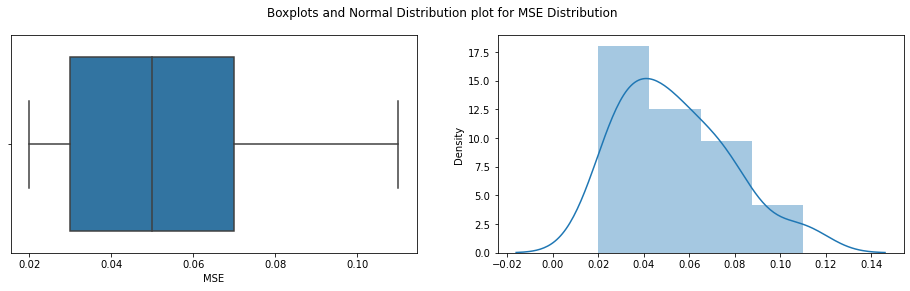

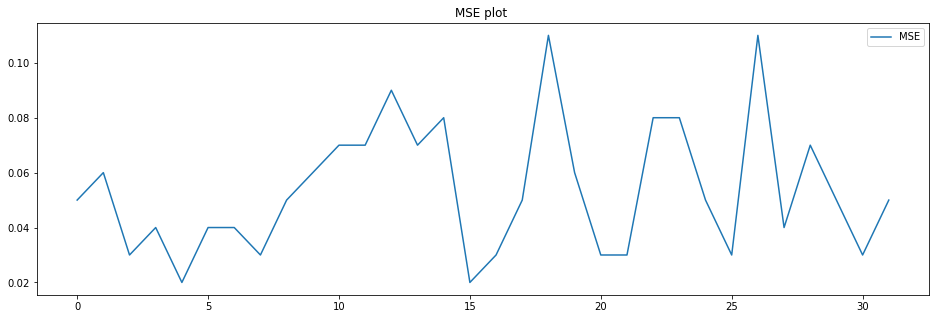


Shapiro_Wilk Test
Statistics=0.943, p=0.0920078084
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.774, p=0.250
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.579
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 241
mean=0.057 ,max=0.101,min=0.015,variance=0.0004


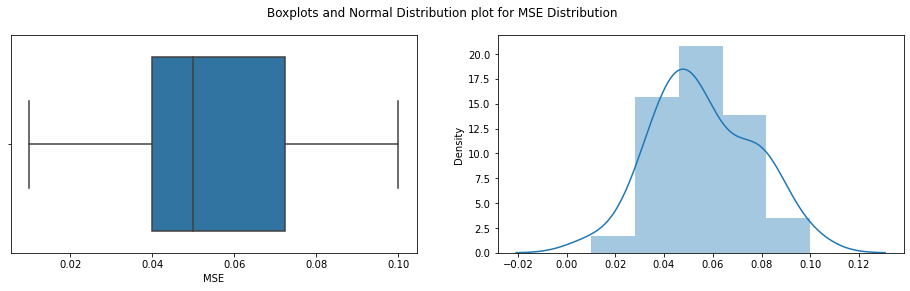

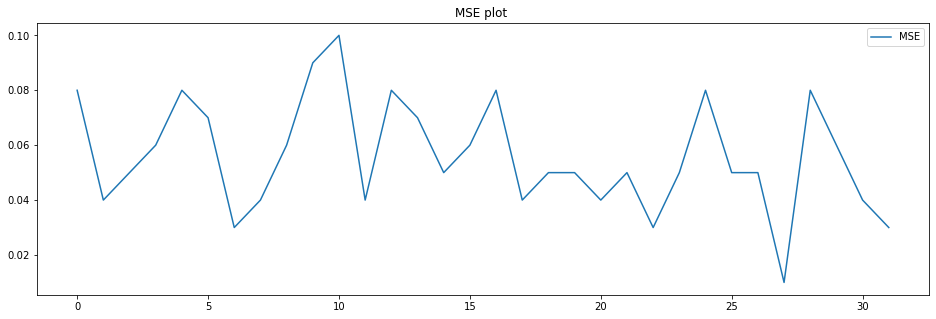


Shapiro_Wilk Test
Statistics=0.982, p=0.8561298847
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.425, p=0.809
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.275
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 242
mean=0.051 ,max=0.091,min=0.011,variance=0.00034


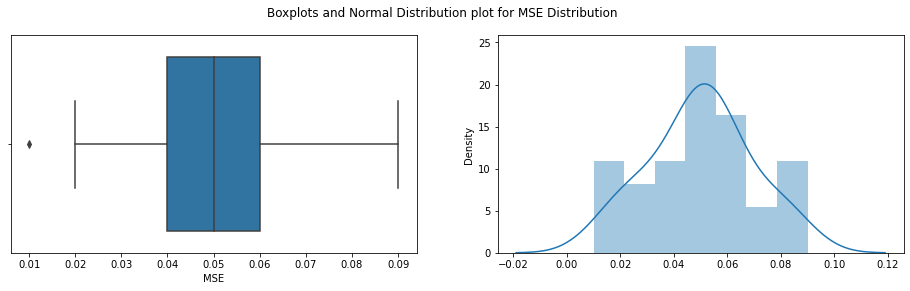

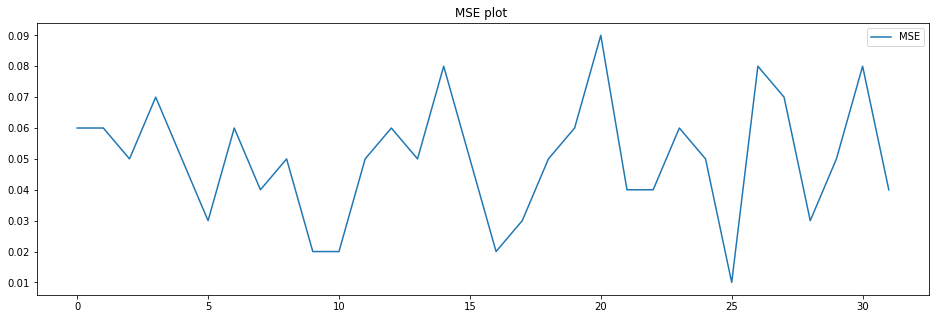


Shapiro_Wilk Test
Statistics=0.989, p=0.9840680361
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.008, p=0.996
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.165
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 243
mean=0.054 ,max=0.096,min=0.011,variance=0.00058


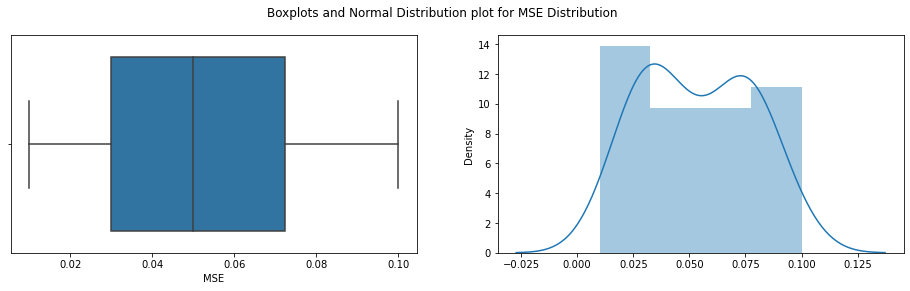

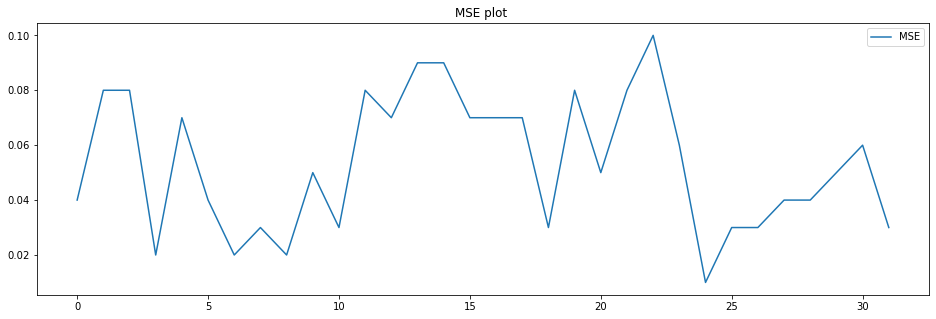


Shapiro_Wilk Test
Statistics=0.956, p=0.2189594358
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.899, p=0.052
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.463
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 244
mean=0.053 ,max=0.111,min=0.013,variance=0.00049


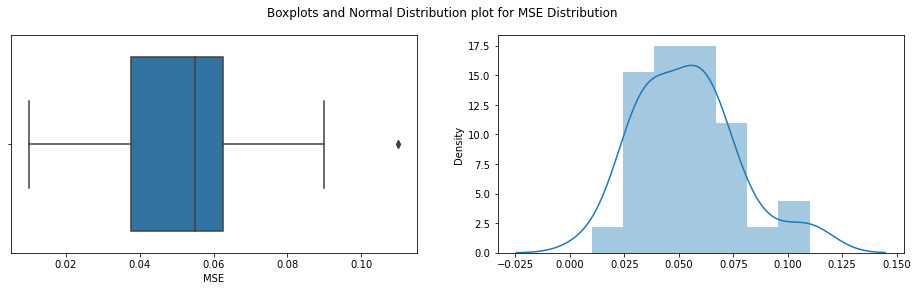

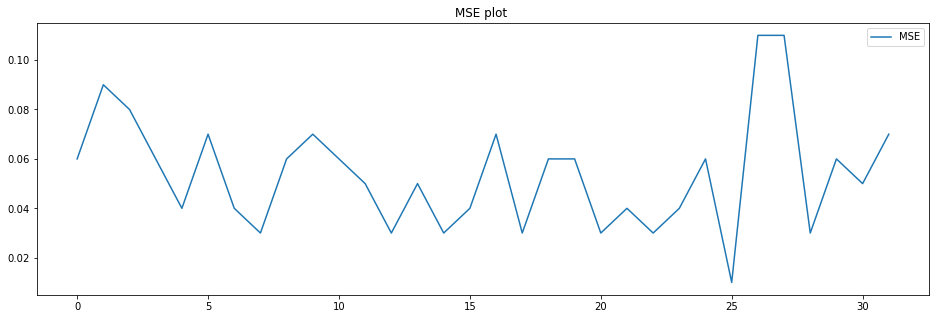


Shapiro_Wilk Test
Statistics=0.953, p=0.1748751998
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.030, p=0.133
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.457
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 245
mean=0.054 ,max=0.121,min=0.017,variance=0.00061


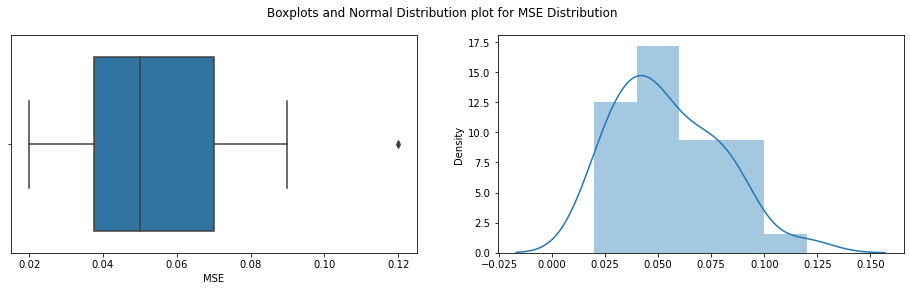

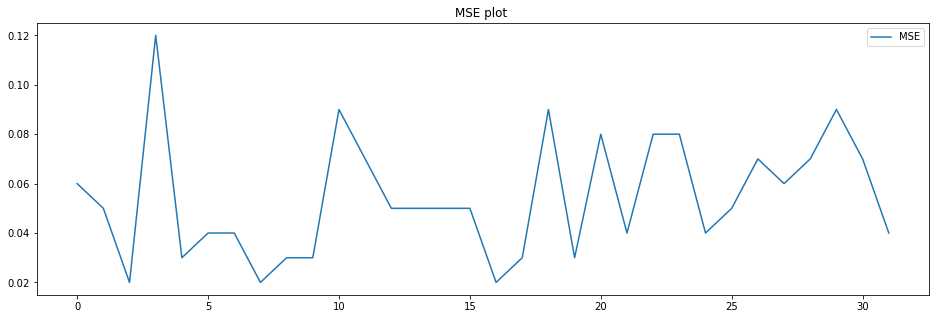


Shapiro_Wilk Test
Statistics=0.945, p=0.1046951413
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.945, p=0.229
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.559
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 246
mean=0.055 ,max=0.093,min=0.011,variance=0.00047


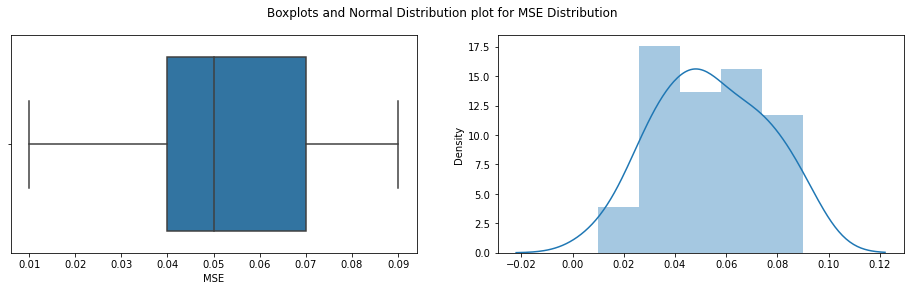

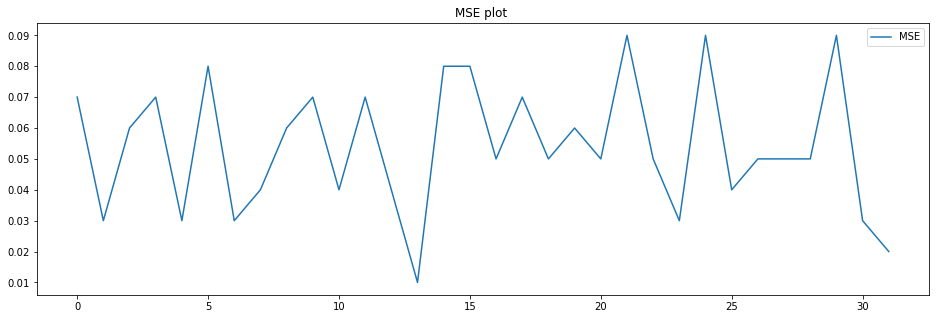


Shapiro_Wilk Test
Statistics=0.972, p=0.5610659122
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.437, p=0.488
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.265
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 247
mean=0.055 ,max=0.105,min=0.019,variance=0.00039


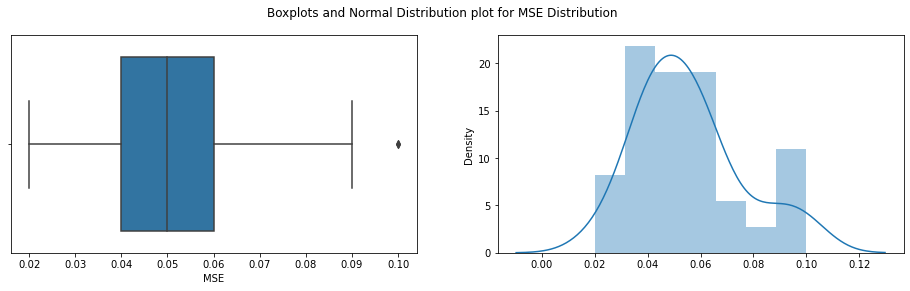

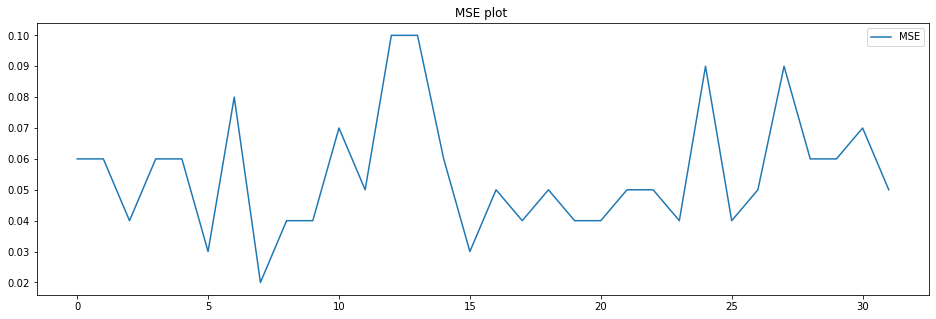


Shapiro_Wilk Test
Statistics=0.945, p=0.1068418249
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=4.010, p=0.135
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.691
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 248
mean=0.058 ,max=0.107,min=0.018,variance=0.00034


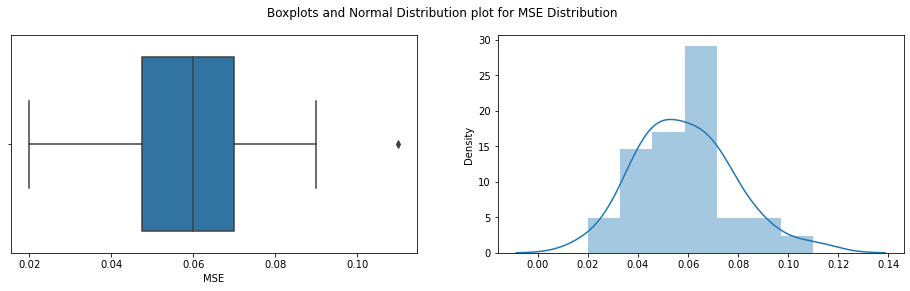

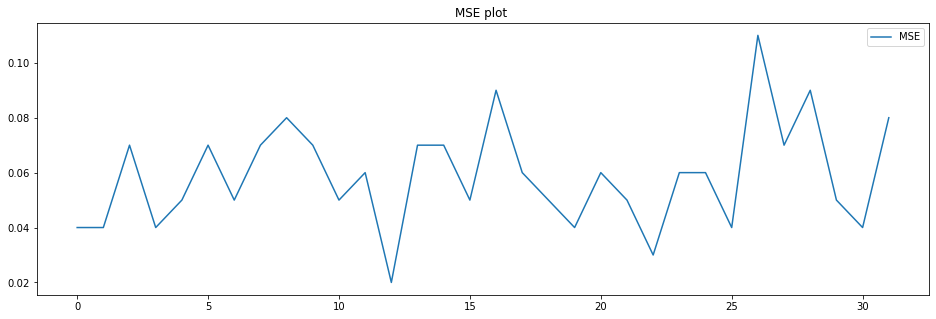


Shapiro_Wilk Test
Statistics=0.982, p=0.8489750624
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.208, p=0.546
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.267
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 249
mean=0.047 ,max=0.102,min=0.019,variance=0.00043


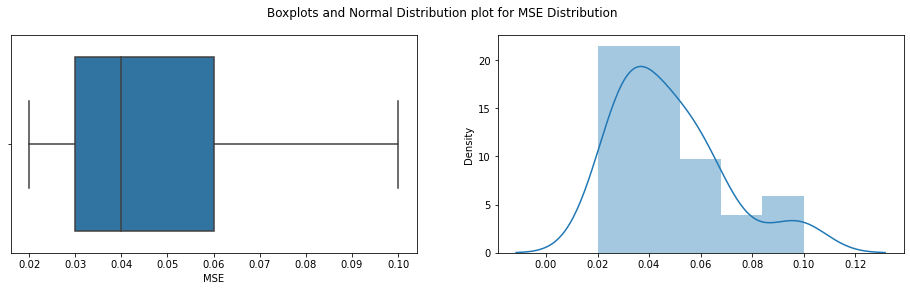

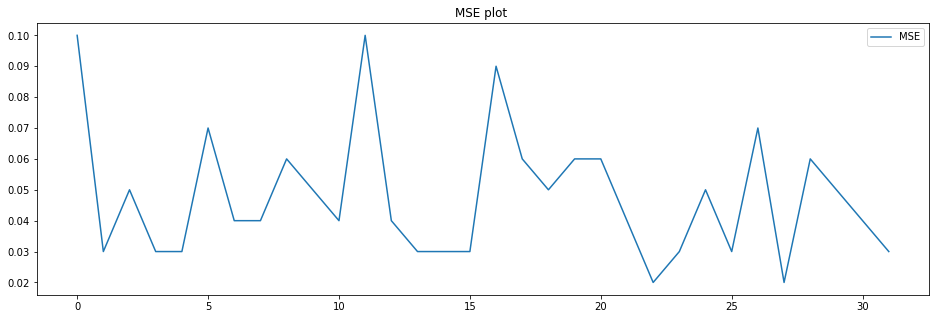


Shapiro_Wilk Test
Statistics=0.900, p=0.0060703927
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=8.041, p=0.018
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.991
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 250
mean=0.056 ,max=0.088,min=0.01,variance=0.0003


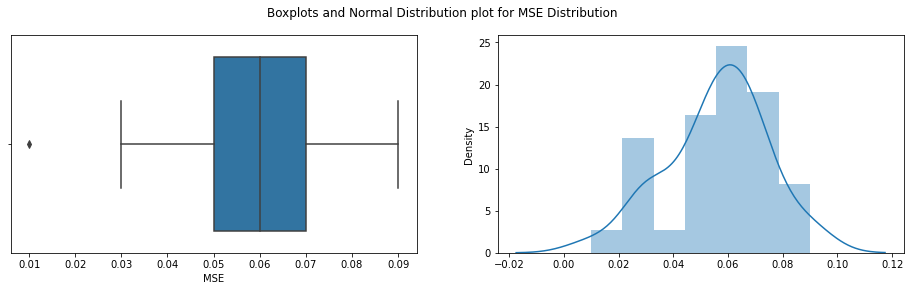

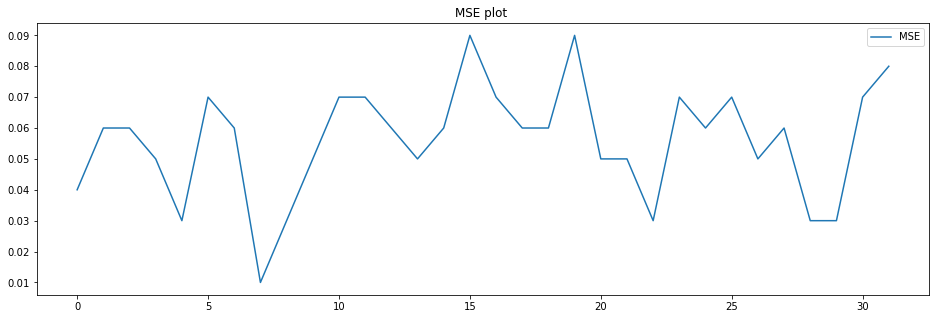


Shapiro_Wilk Test
Statistics=0.967, p=0.4331800044
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.337, p=0.311
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.418
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 251
mean=0.058 ,max=0.089,min=0.032,variance=0.00018


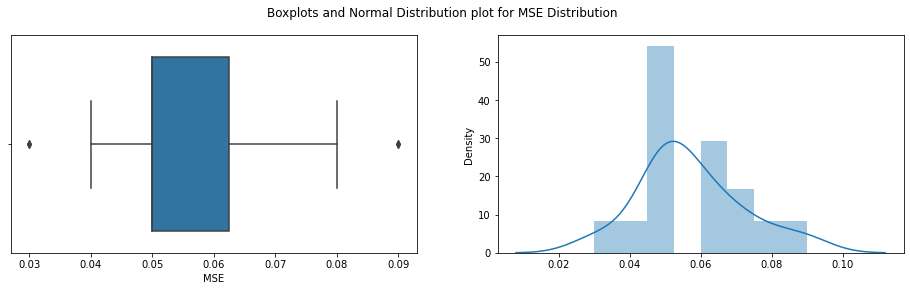

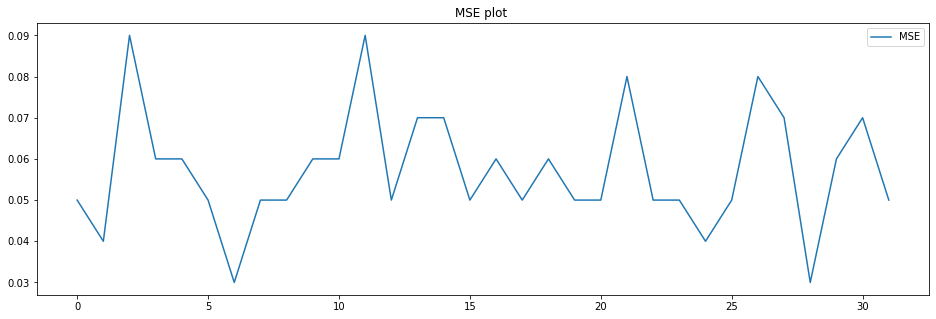


Shapiro_Wilk Test
Statistics=0.965, p=0.3703479171
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.420, p=0.492
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.491
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 252
mean=0.052 ,max=0.138,min=0.021,variance=0.00075


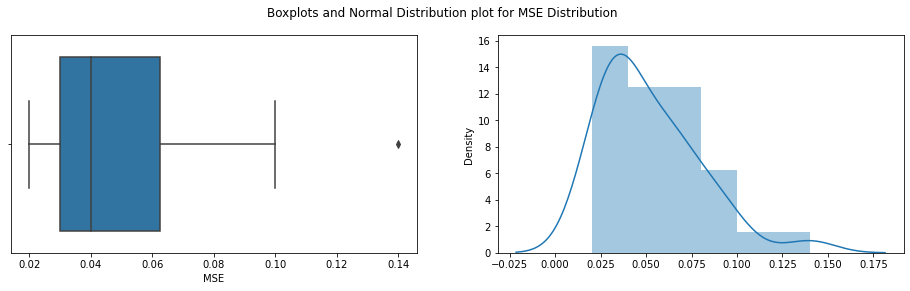

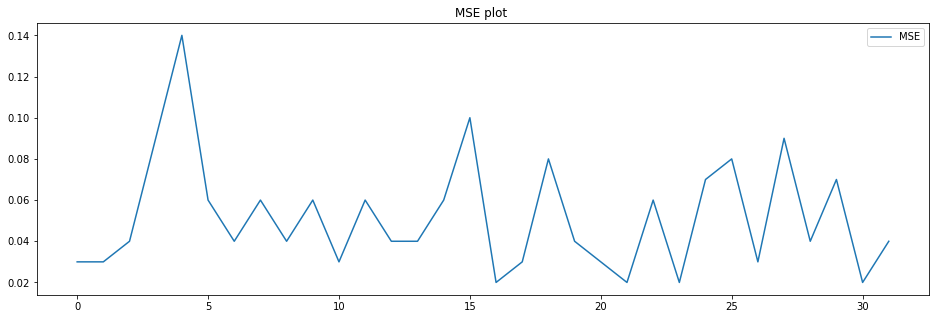


Shapiro_Wilk Test
Statistics=0.880, p=0.0020082602
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=10.250, p=0.006
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.166
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 253
mean=0.045 ,max=0.083,min=0.004,variance=0.00029


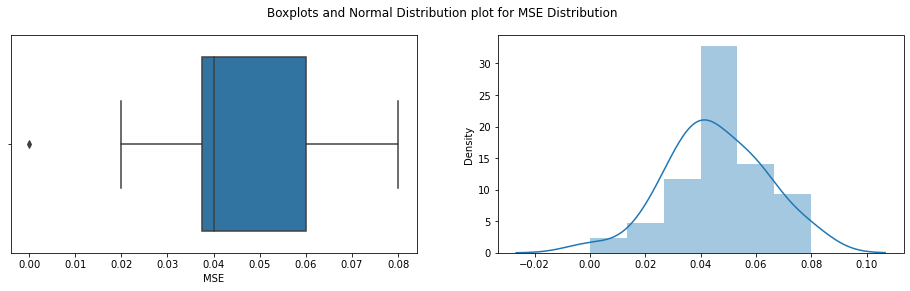

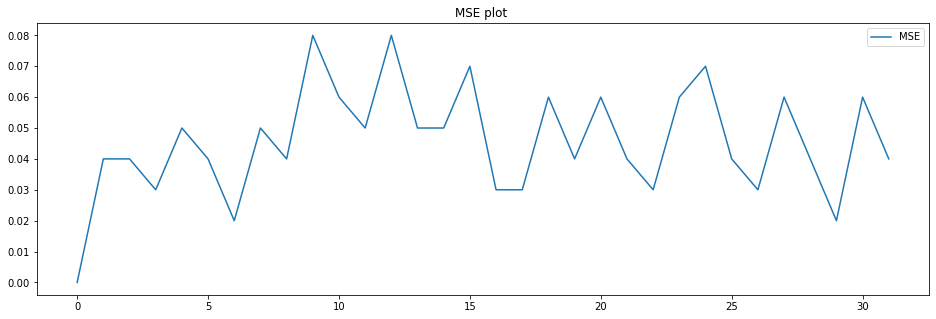


Shapiro_Wilk Test
Statistics=0.992, p=0.9967496991
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.326, p=0.850
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.143
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 254
mean=0.054 ,max=0.112,min=0.014,variance=0.00054


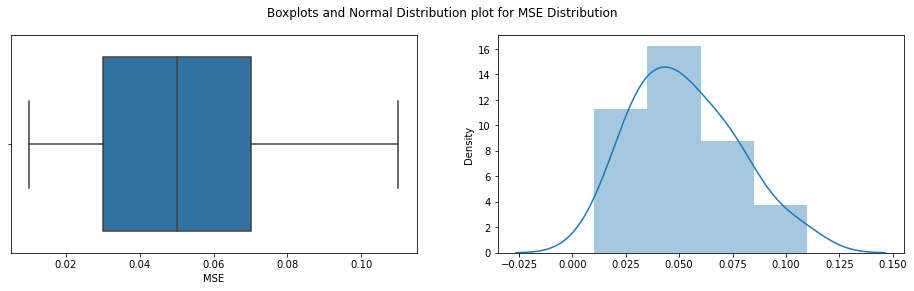

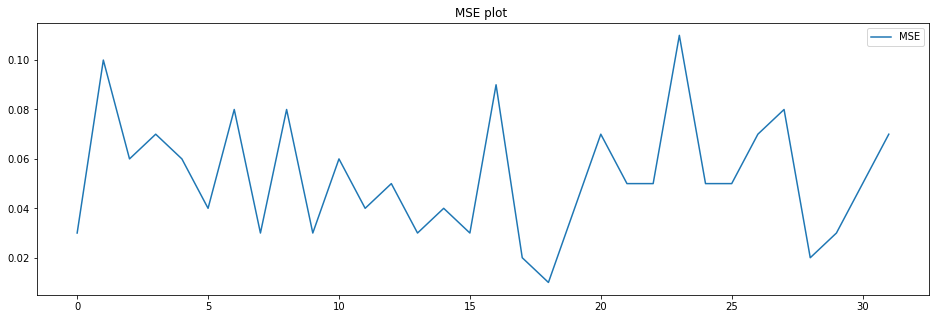


Shapiro_Wilk Test
Statistics=0.975, p=0.6317026019
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.395, p=0.498
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.247
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 255
mean=0.05 ,max=0.101,min=0.007,variance=0.00044


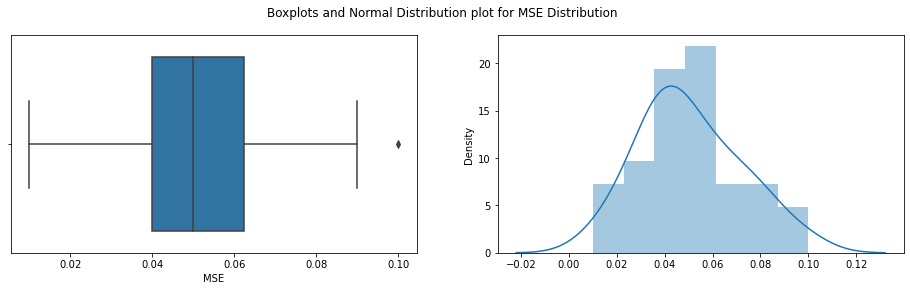

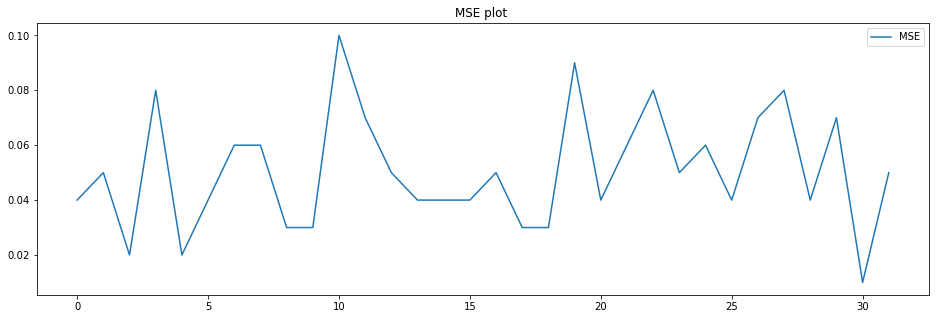


Shapiro_Wilk Test
Statistics=0.983, p=0.8725395799
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.970, p=0.616
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.282
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 256
mean=0.058 ,max=0.113,min=0.026,variance=0.0004


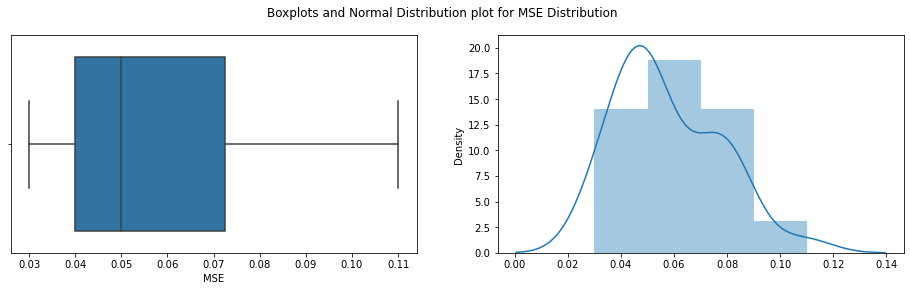

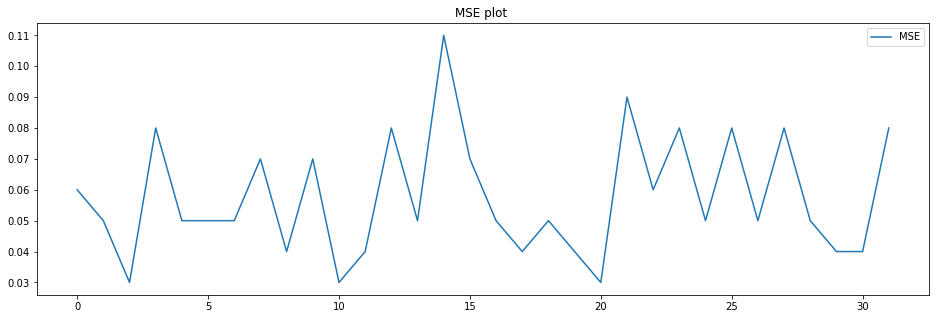


Shapiro_Wilk Test
Statistics=0.944, p=0.0944626182
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.911, p=0.233
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.665
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 257
mean=0.055 ,max=0.098,min=0.013,variance=0.00044


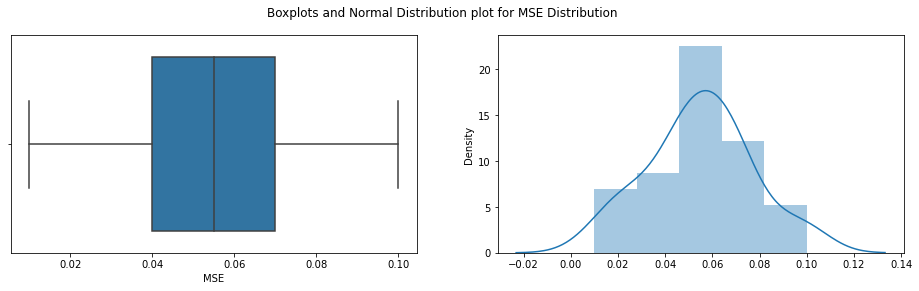

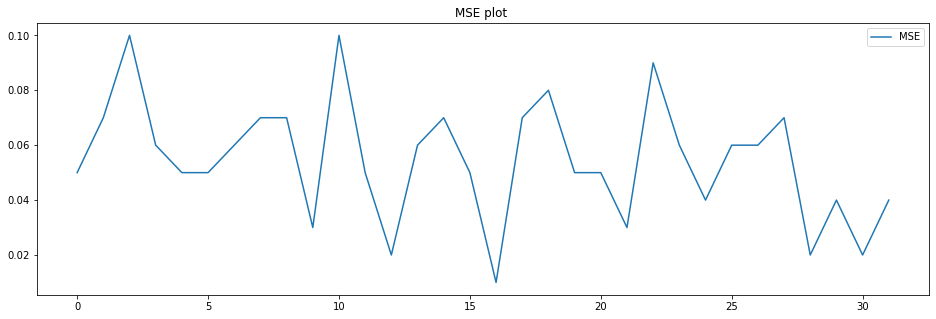


Shapiro_Wilk Test
Statistics=0.974, p=0.6189107299
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.007, p=0.997
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.325
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 258
mean=0.051 ,max=0.108,min=0.018,variance=0.00045


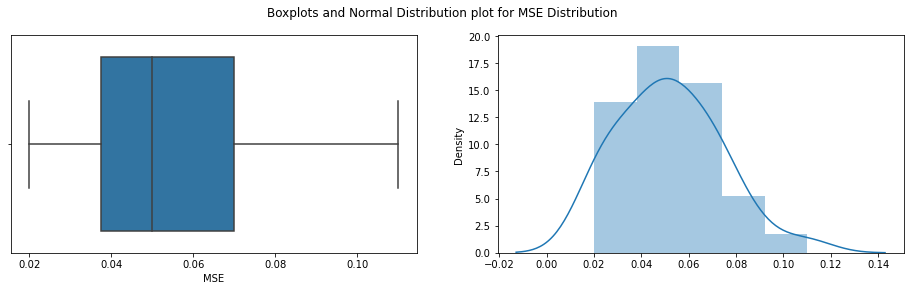

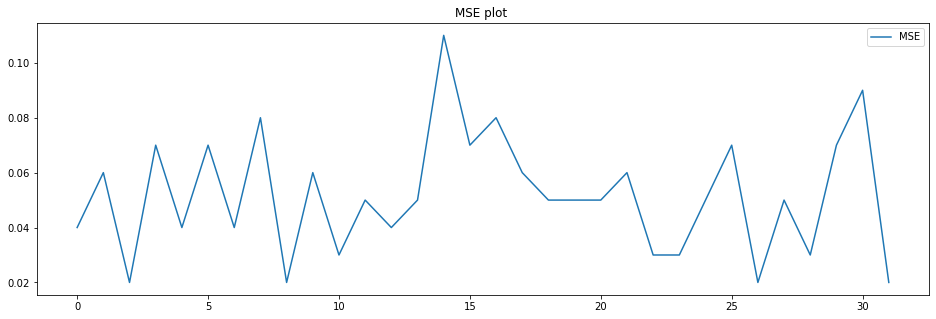


Shapiro_Wilk Test
Statistics=0.969, p=0.4790088534
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.811, p=0.404
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.229
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 259
mean=0.054 ,max=0.109,min=0.031,variance=0.0003


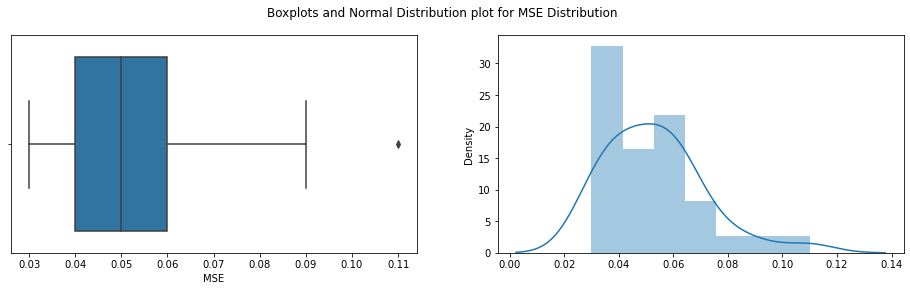

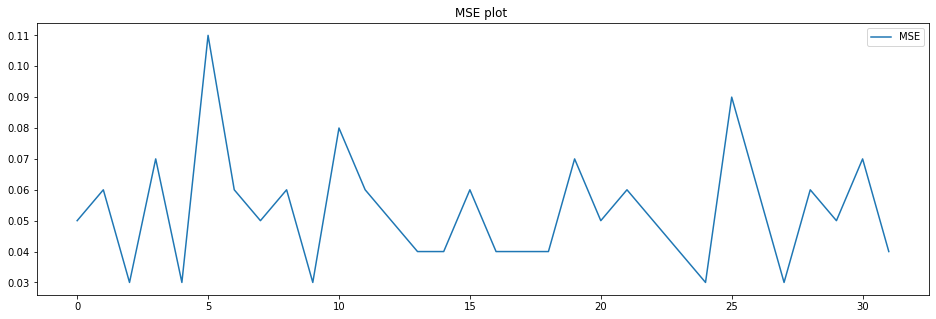


Shapiro_Wilk Test
Statistics=0.918, p=0.0189112835
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=10.755, p=0.005
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.637
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 260
mean=0.051 ,max=0.089,min=0.01,variance=0.00026


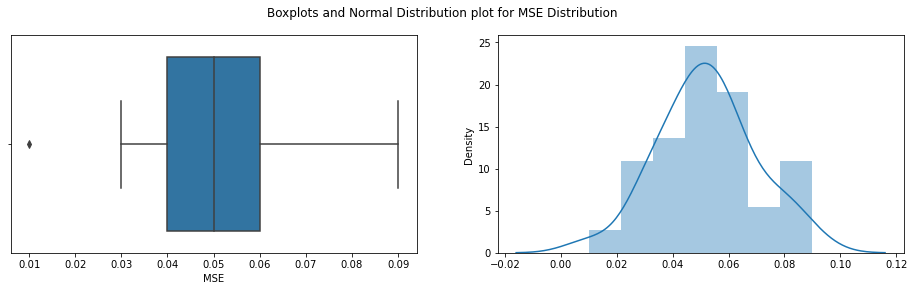

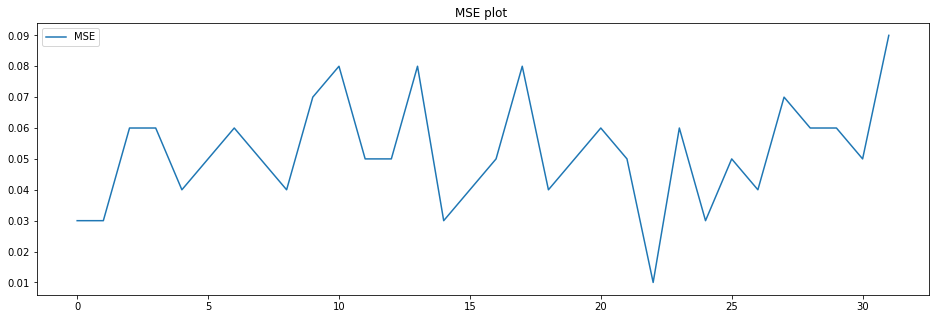


Shapiro_Wilk Test
Statistics=0.986, p=0.9449251890
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.772, p=0.680
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.199
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 261
mean=0.053 ,max=0.117,min=0.019,variance=0.00042


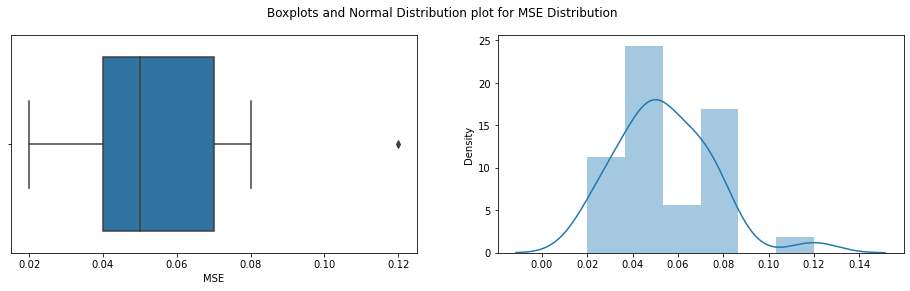

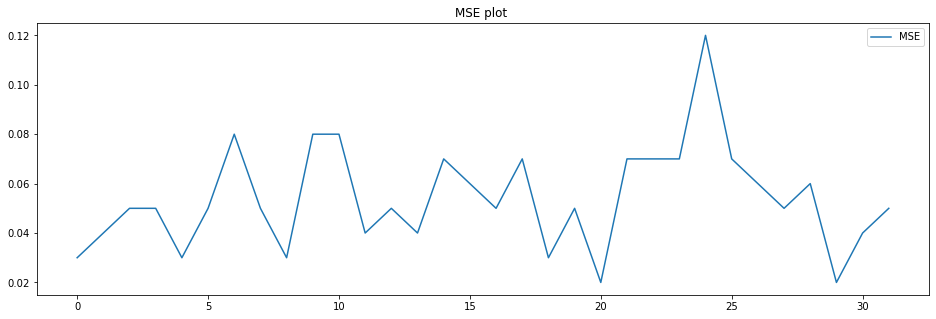


Shapiro_Wilk Test
Statistics=0.955, p=0.1955925226
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.807, p=0.055
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.320
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 262
mean=0.053 ,max=0.107,min=0.022,variance=0.00027


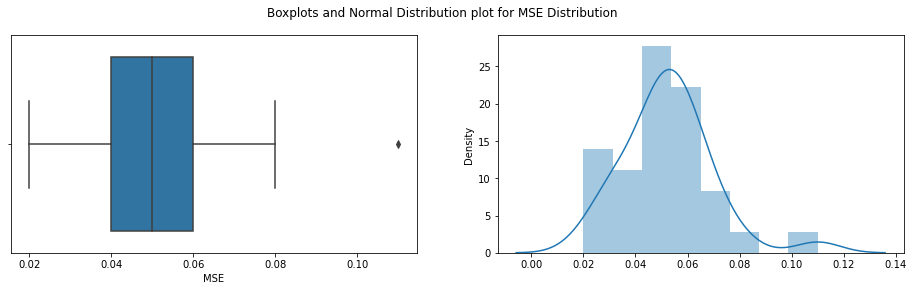

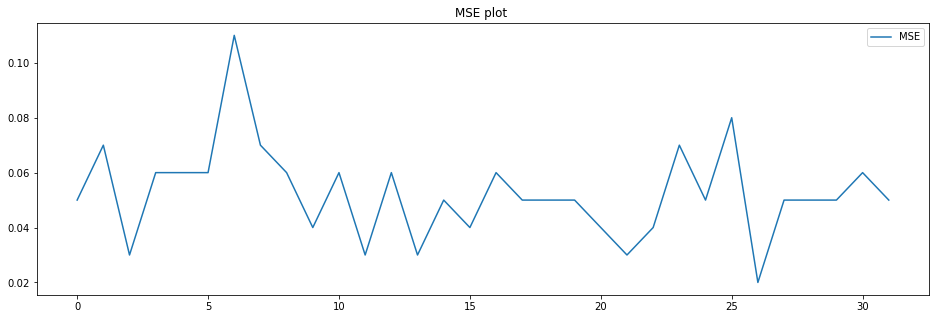


Shapiro_Wilk Test
Statistics=0.942, p=0.0857712403
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=7.955, p=0.019
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.467
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 263
mean=0.051 ,max=0.11,min=0.026,variance=0.00037


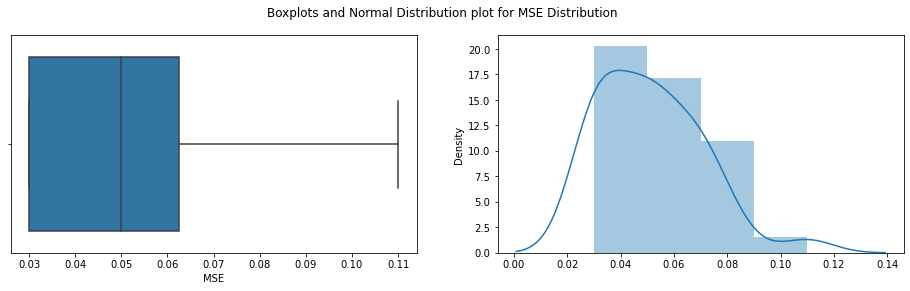

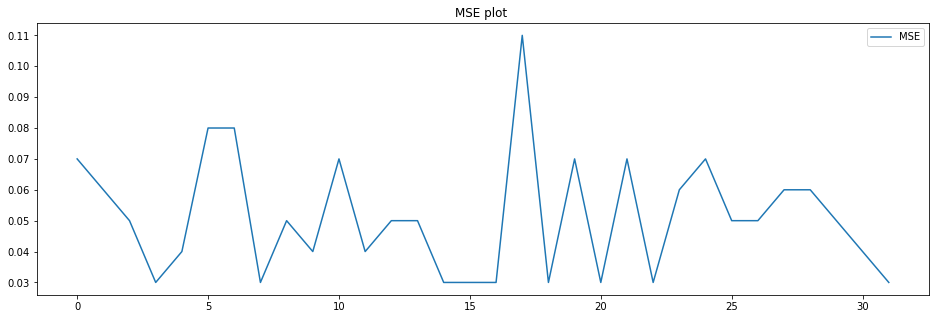


Shapiro_Wilk Test
Statistics=0.925, p=0.0284341518
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=6.464, p=0.039
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.575
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 264
mean=0.051 ,max=0.096,min=0.012,variance=0.00044


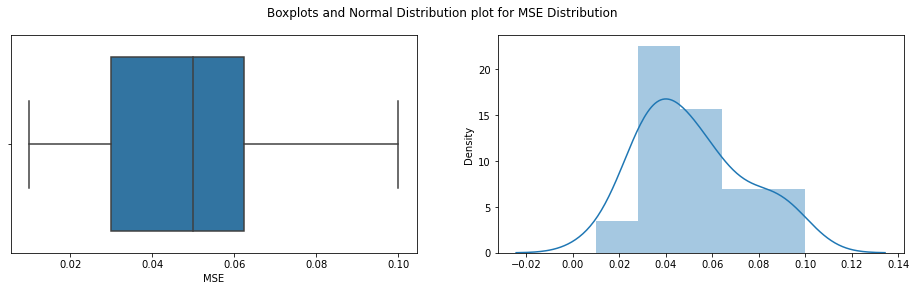

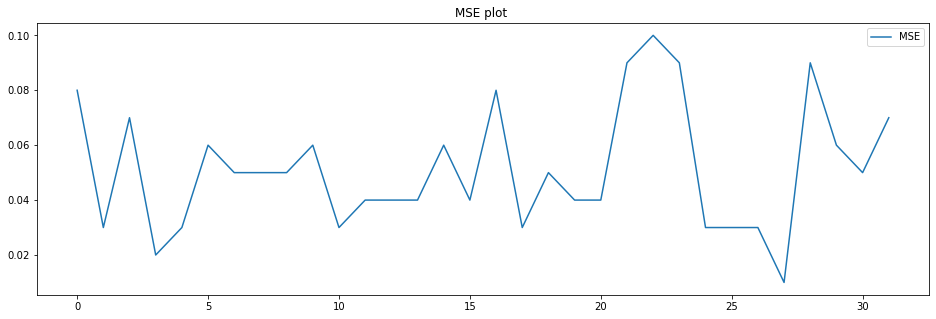


Shapiro_Wilk Test
Statistics=0.967, p=0.4214097261
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.558, p=0.459
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.390
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 265
mean=0.05 ,max=0.095,min=0.008,variance=0.00036


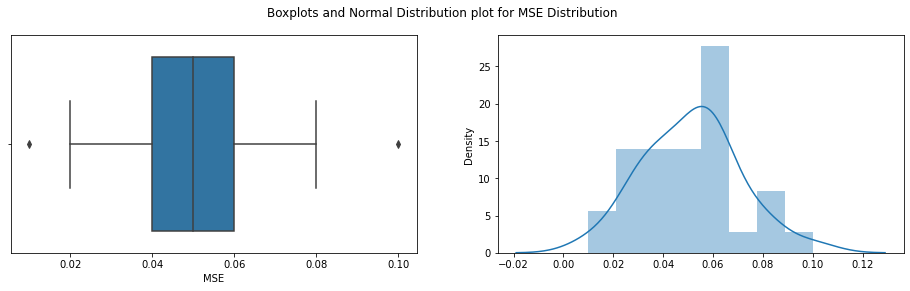

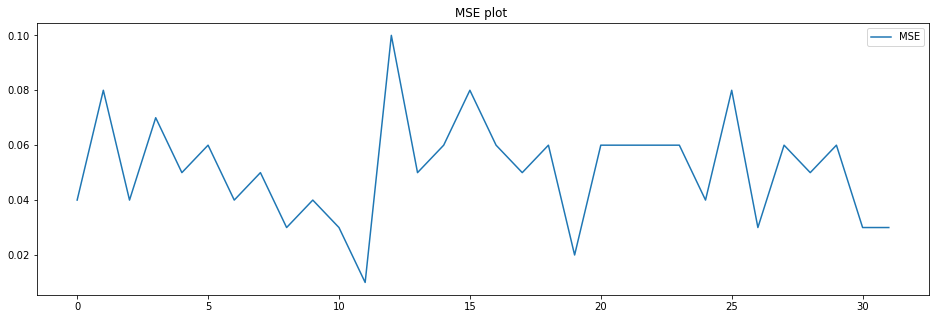


Shapiro_Wilk Test
Statistics=0.981, p=0.8347632885
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.408, p=0.815
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.292
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 266
mean=0.059 ,max=0.139,min=0.02,variance=0.00062


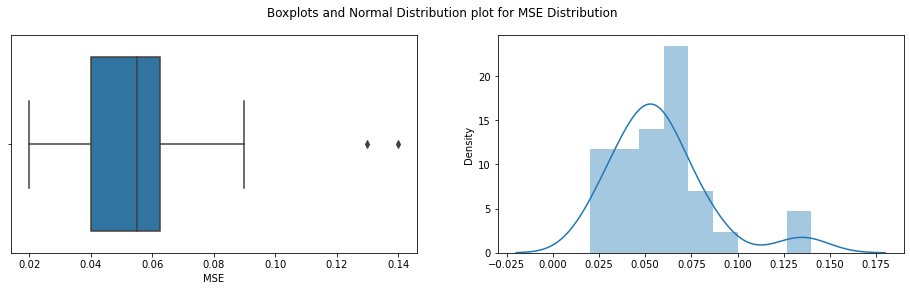

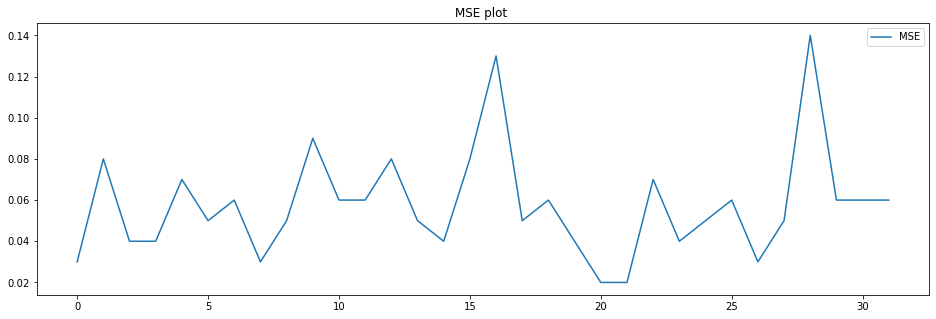


Shapiro_Wilk Test
Statistics=0.869, p=0.0011248954
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=17.616, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.244
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 267
mean=0.056 ,max=0.105,min=0.009,variance=0.00039


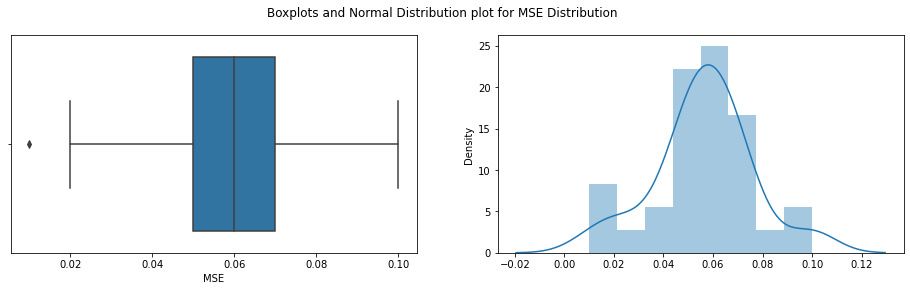

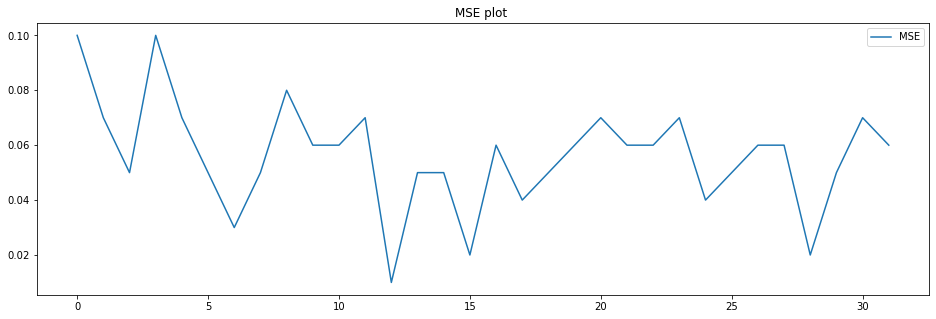


Shapiro_Wilk Test
Statistics=0.947, p=0.1170825362
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.039, p=0.361
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.786
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 268
mean=0.052 ,max=0.088,min=0.018,variance=0.00029


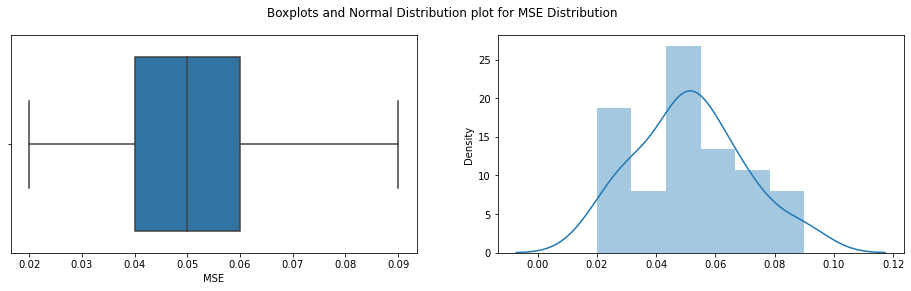

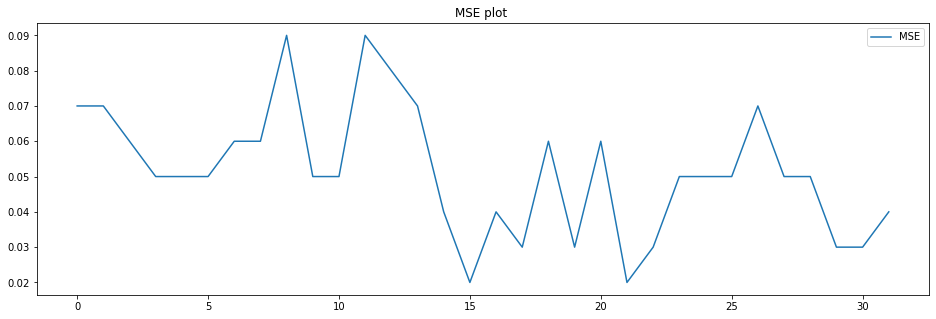


Shapiro_Wilk Test
Statistics=0.985, p=0.9264166355
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.124, p=0.940
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.166
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 269
mean=0.049 ,max=0.092,min=0.01,variance=0.00045


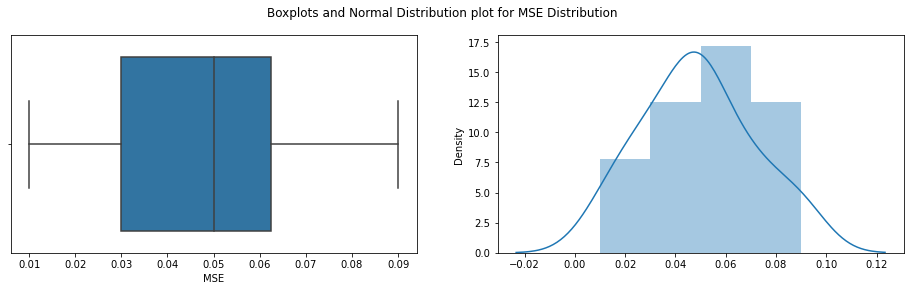

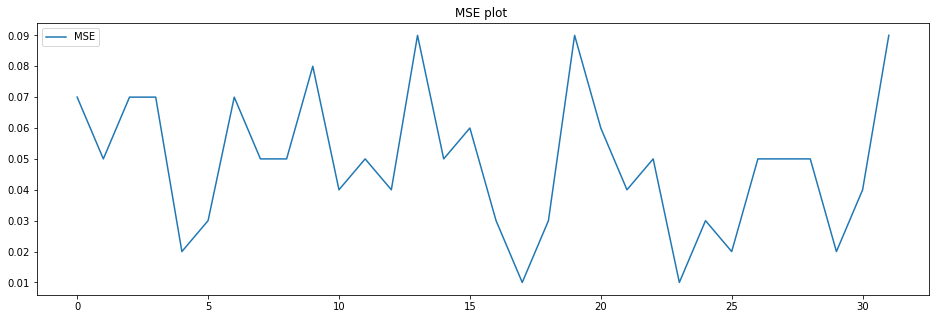


Shapiro_Wilk Test
Statistics=0.981, p=0.8357844353
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.377, p=0.828
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.162
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 270
mean=0.05 ,max=0.088,min=0.019,variance=0.00033


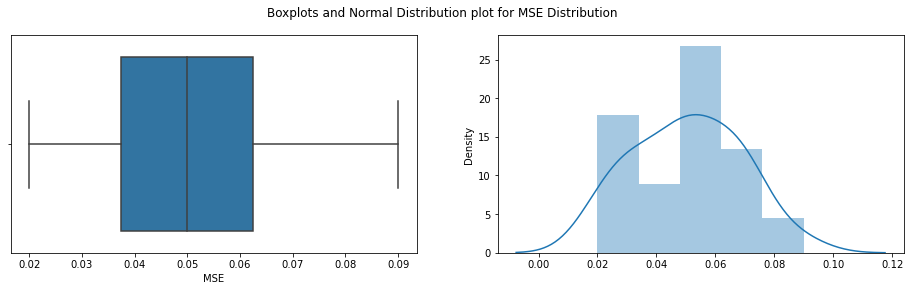

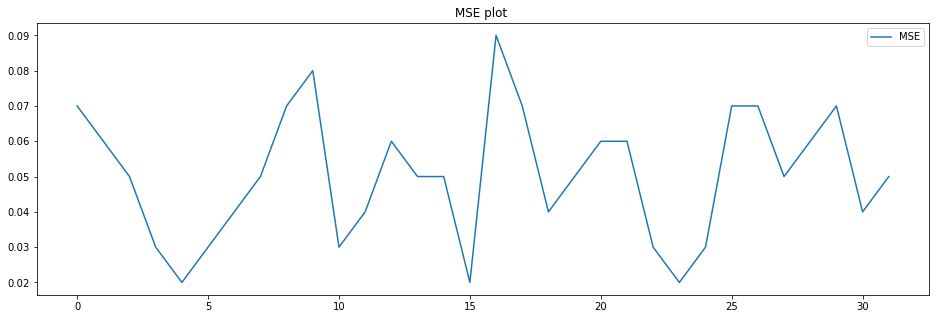


Shapiro_Wilk Test
Statistics=0.971, p=0.5146313310
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.300, p=0.317
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.302
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 271
mean=0.053 ,max=0.092,min=0.014,variance=0.00041


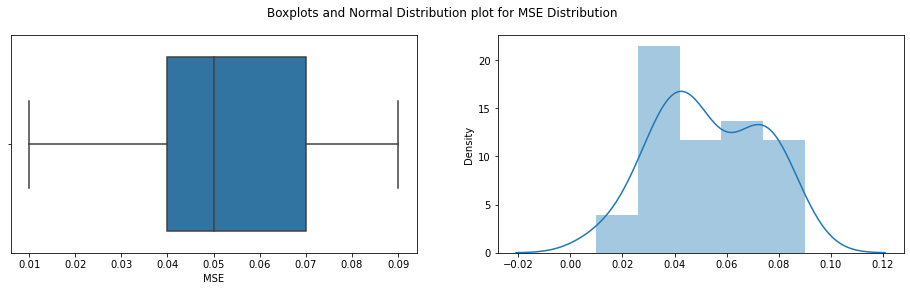

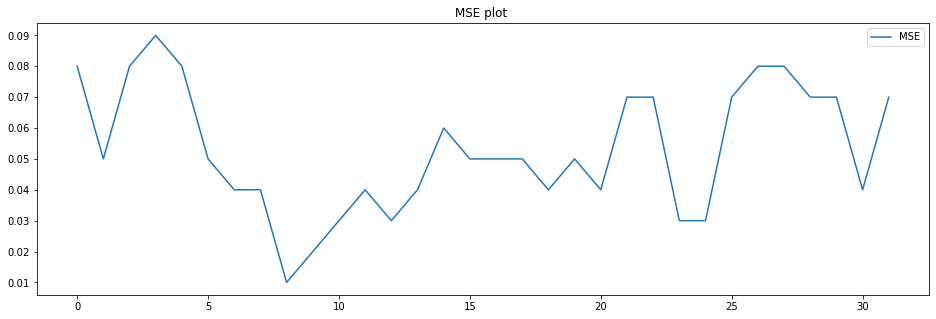


Shapiro_Wilk Test
Statistics=0.970, p=0.4920944870
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.744, p=0.254
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.365
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 272
mean=0.06 ,max=0.109,min=0.013,variance=0.0006


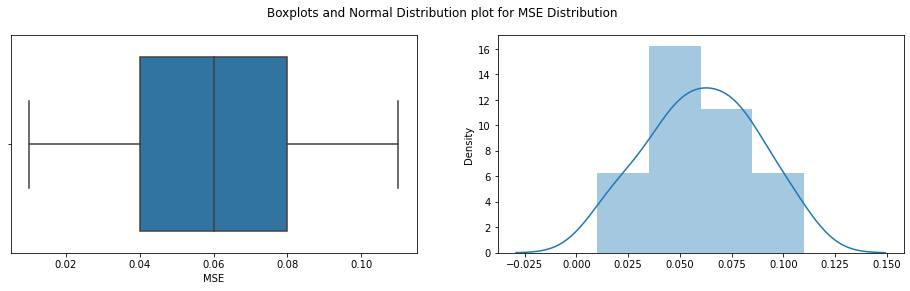

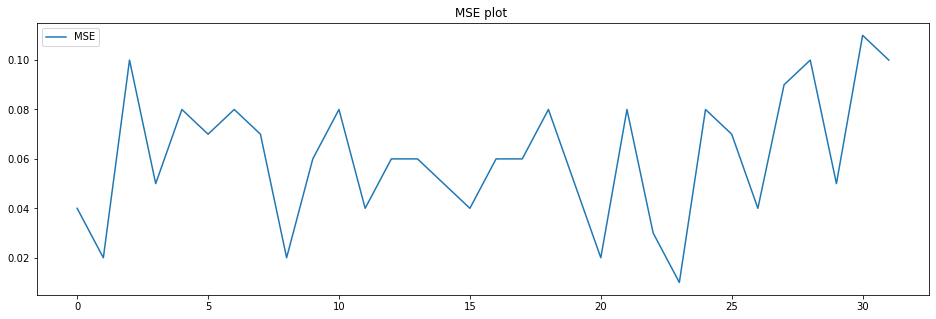


Shapiro_Wilk Test
Statistics=0.981, p=0.8262189627
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.877, p=0.645
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.167
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 273
mean=0.055 ,max=0.104,min=0.016,variance=0.0005


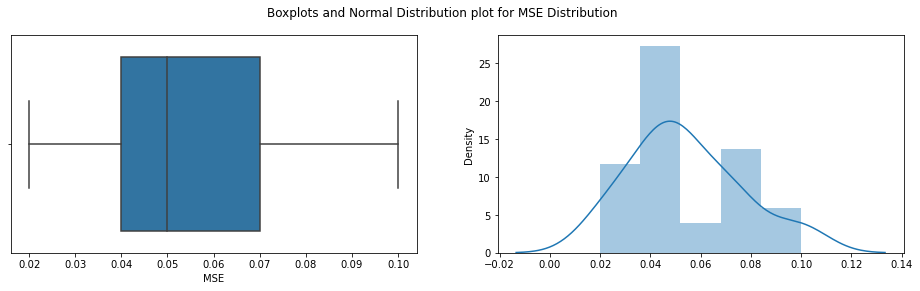

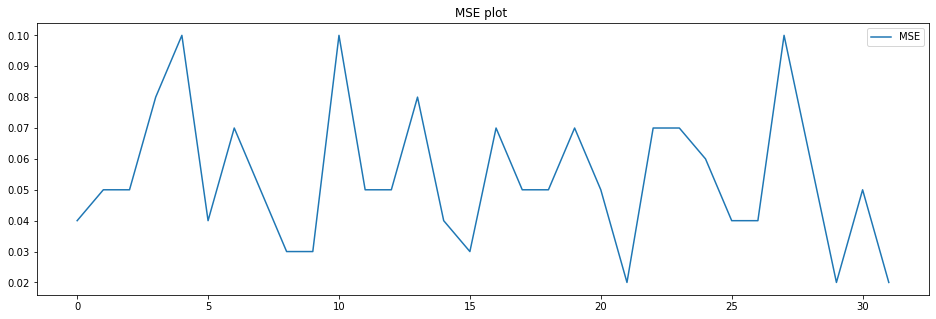


Shapiro_Wilk Test
Statistics=0.960, p=0.2831747234
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.706, p=0.426
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.390
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 274
mean=0.057 ,max=0.108,min=0.016,variance=0.00052


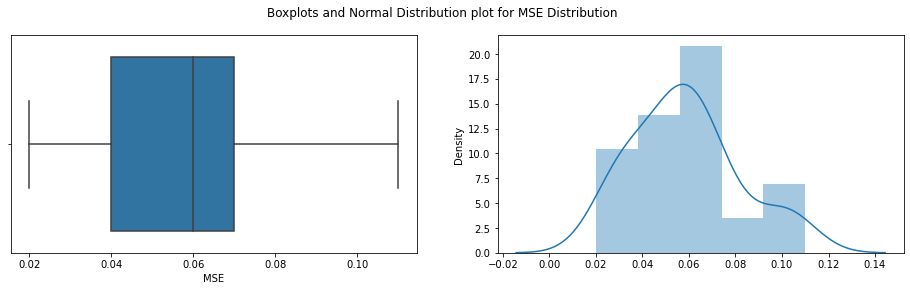

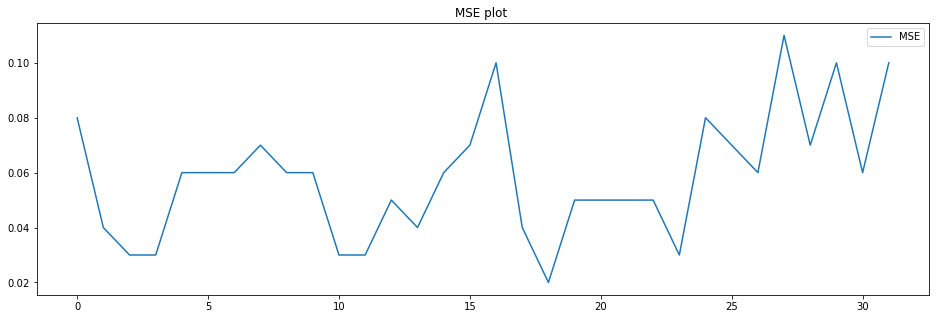


Shapiro_Wilk Test
Statistics=0.960, p=0.2812533975
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.494, p=0.474
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.427
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 275
mean=0.044 ,max=0.091,min=0.012,variance=0.0003


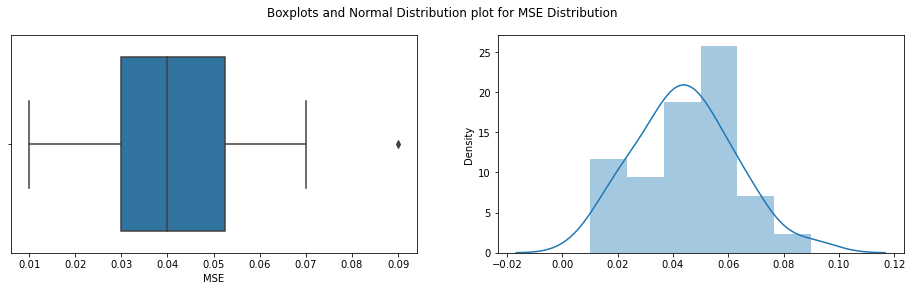

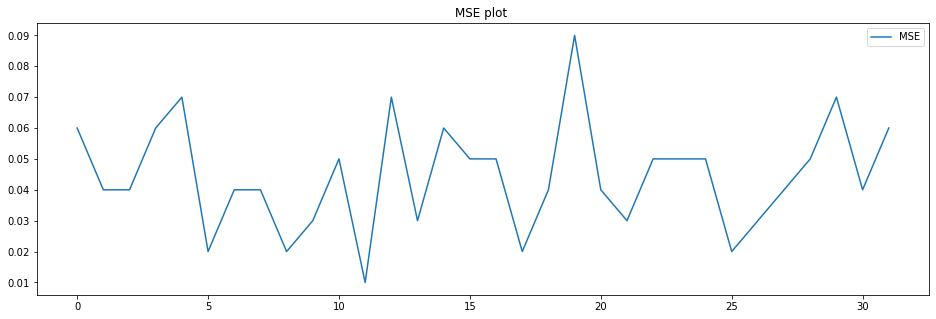


Shapiro_Wilk Test
Statistics=0.982, p=0.8630966544
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.538, p=0.463
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.164
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 276
mean=0.048 ,max=0.122,min=0.019,variance=0.00049


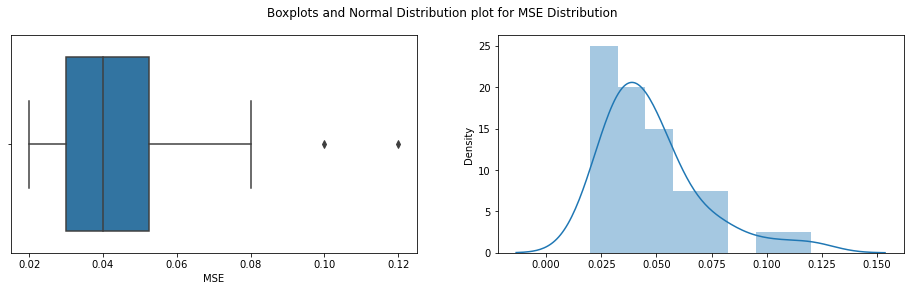

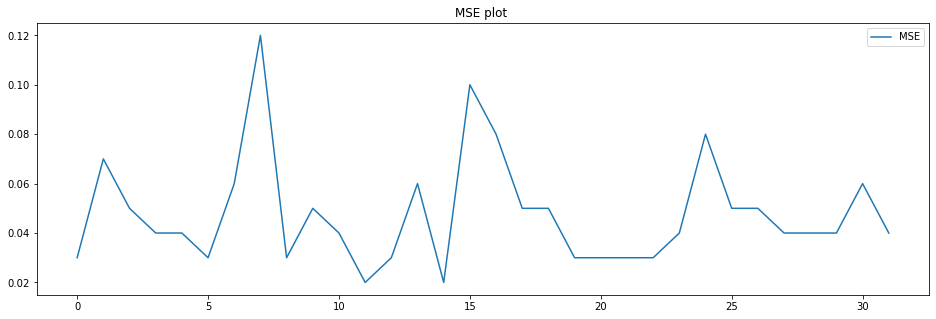


Shapiro_Wilk Test
Statistics=0.862, p=0.0007530755
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=17.138, p=0.000
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.364
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 277
mean=0.056 ,max=0.092,min=0.016,variance=0.0005


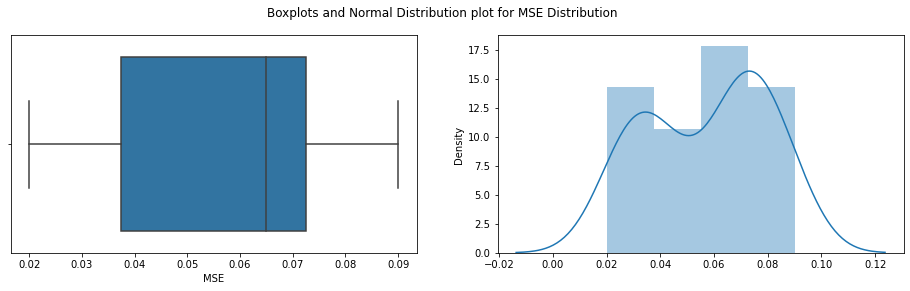

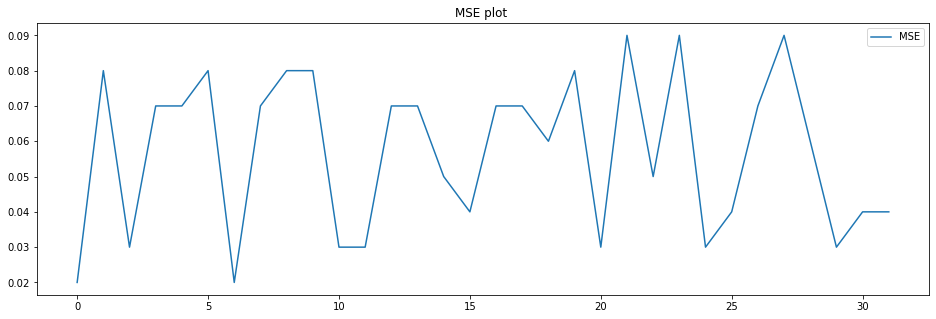


Shapiro_Wilk Test
Statistics=0.937, p=0.0598733537
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=6.459, p=0.040
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.794
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 278
mean=0.049 ,max=0.086,min=0.012,variance=0.00026


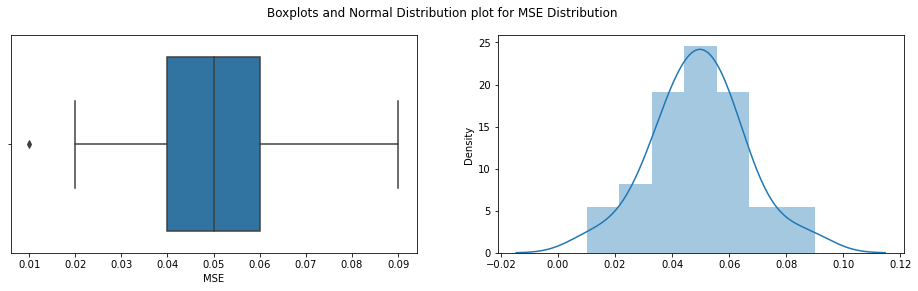

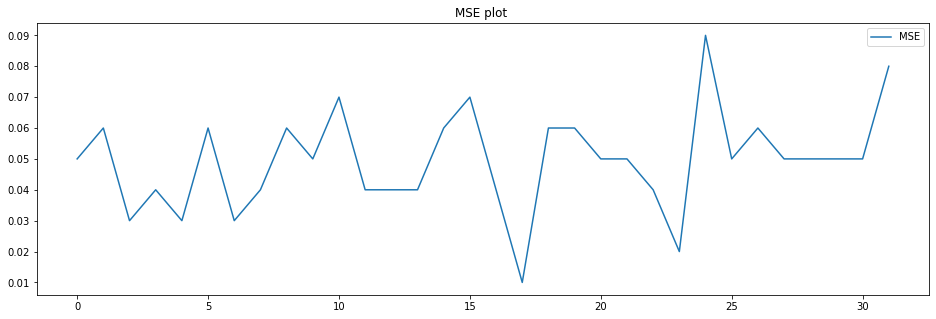


Shapiro_Wilk Test
Statistics=0.977, p=0.7021380663
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.973, p=0.615
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.328
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 279
mean=0.049 ,max=0.097,min=0.019,variance=0.00039


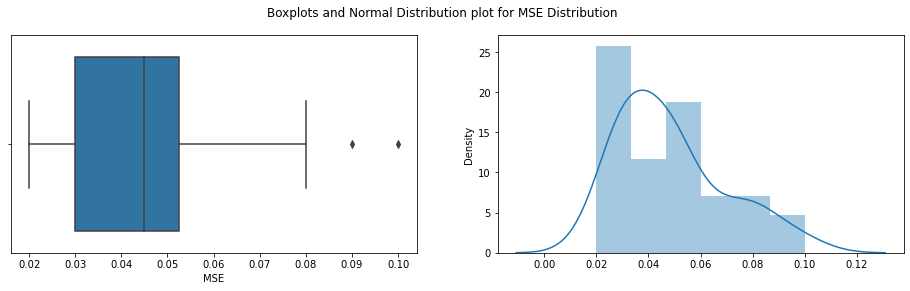

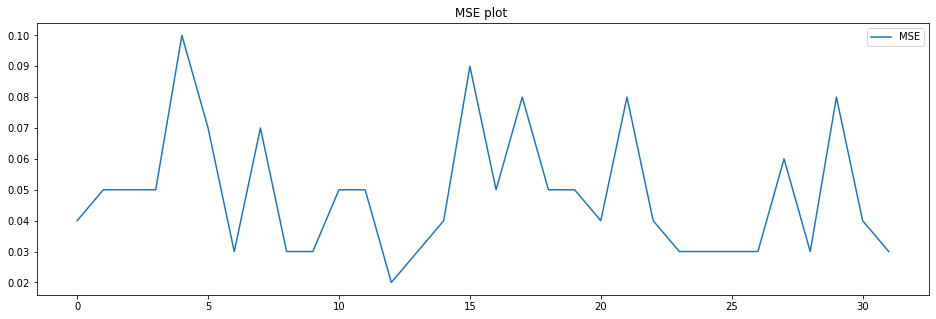


Shapiro_Wilk Test
Statistics=0.923, p=0.0246799700
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=3.491, p=0.175
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.903
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 280
mean=0.054 ,max=0.117,min=0.023,variance=0.00048


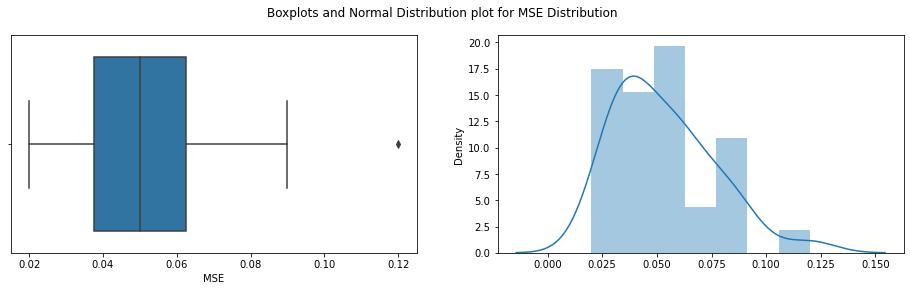

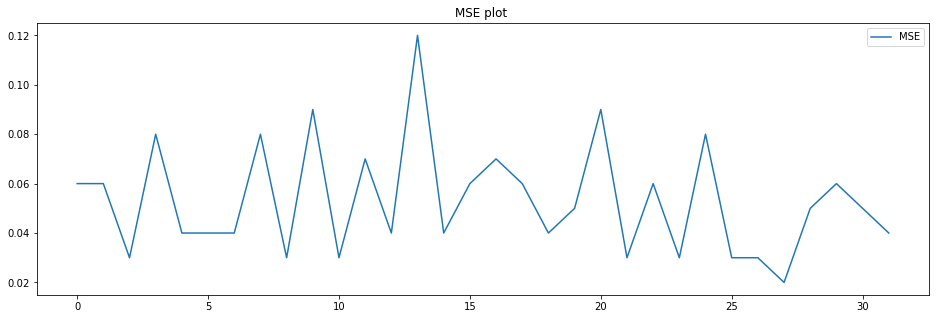


Shapiro_Wilk Test
Statistics=0.930, p=0.0390192866
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=4.979, p=0.083
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.700
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 281
mean=0.053 ,max=0.107,min=0.009,variance=0.00049


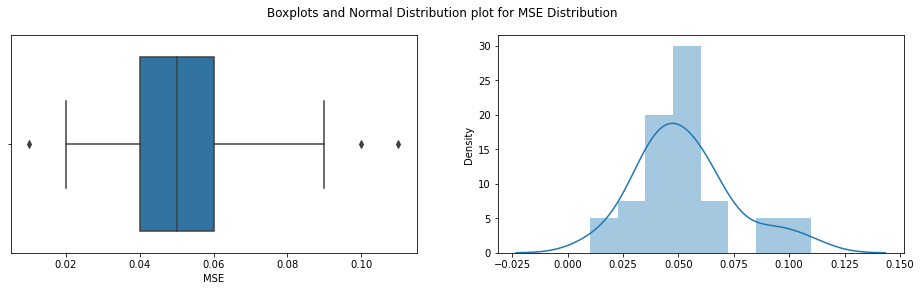

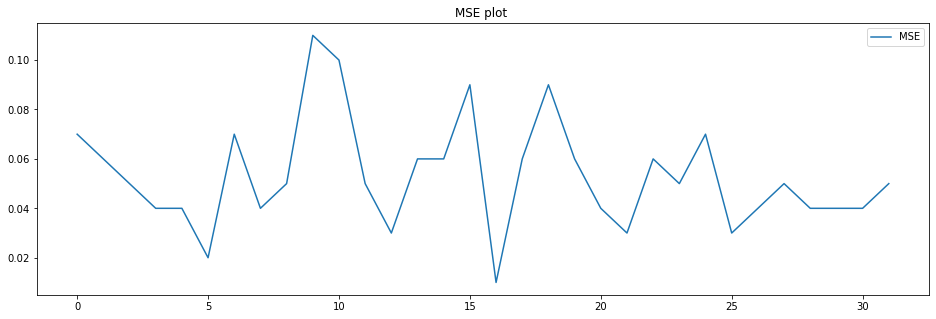


Shapiro_Wilk Test
Statistics=0.955, p=0.1950141788
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.192, p=0.203
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.587
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 282
mean=0.052 ,max=0.094,min=0.013,variance=0.00042


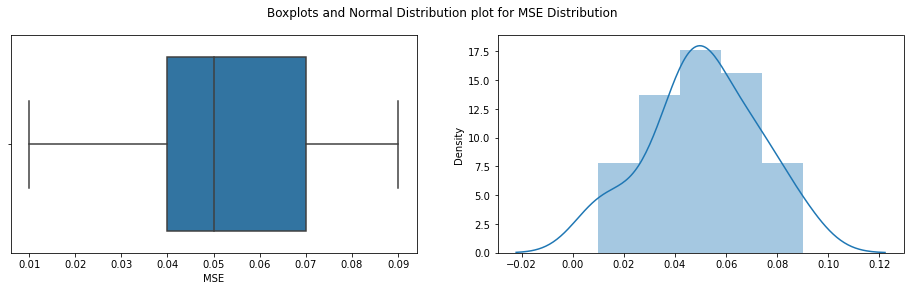

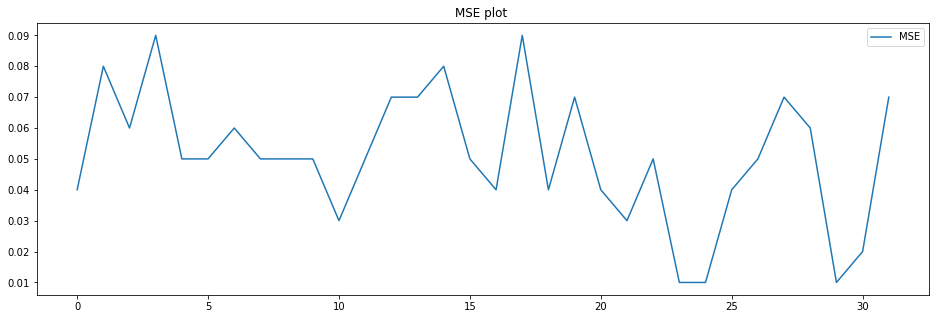


Shapiro_Wilk Test
Statistics=0.975, p=0.6536537409
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.198, p=0.906
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.258
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 283
mean=0.052 ,max=0.099,min=0.012,variance=0.00043


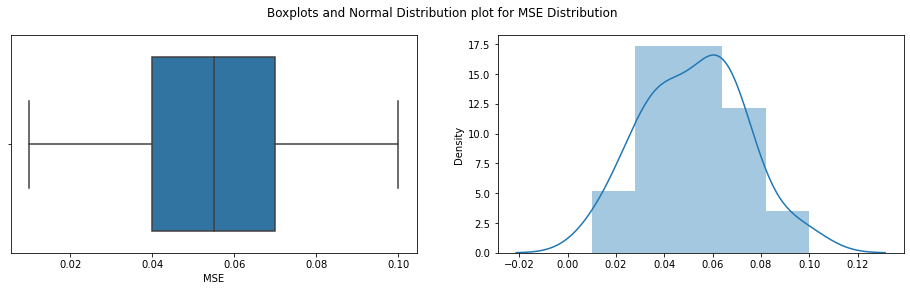

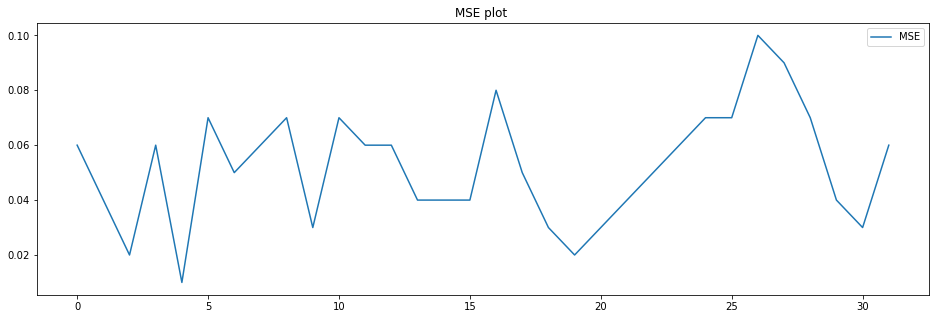


Shapiro_Wilk Test
Statistics=0.988, p=0.9727188945
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.251, p=0.882
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.150
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 284
mean=0.061 ,max=0.107,min=0.02,variance=0.00048


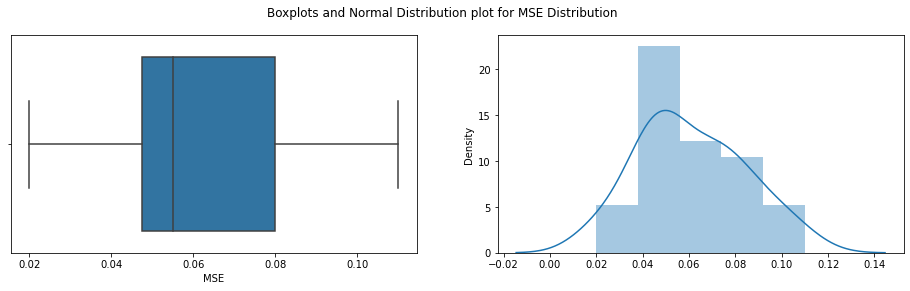

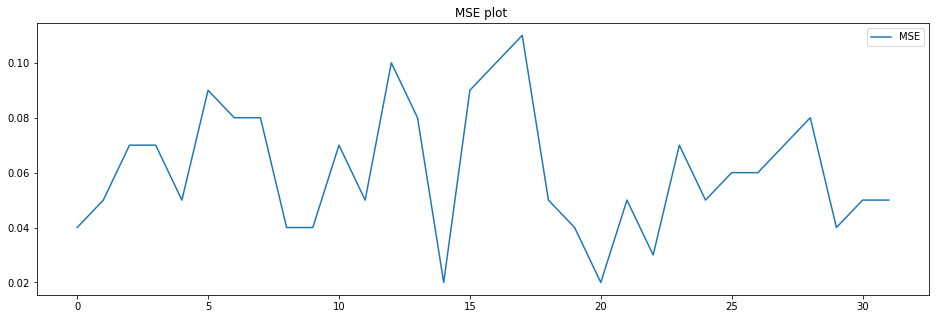


Shapiro_Wilk Test
Statistics=0.978, p=0.7347624898
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.799, p=0.671
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.270
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 285
mean=0.057 ,max=0.113,min=0.013,variance=0.0006


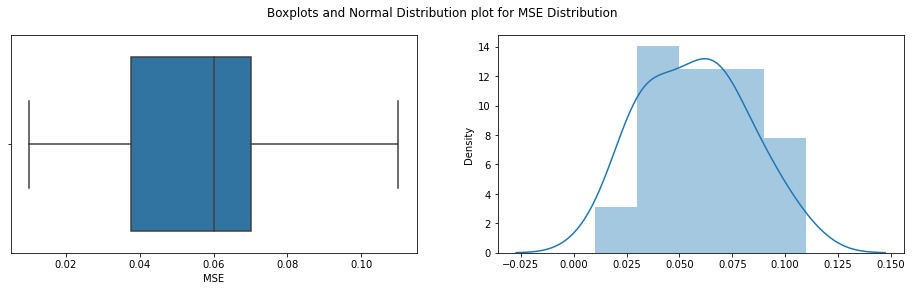

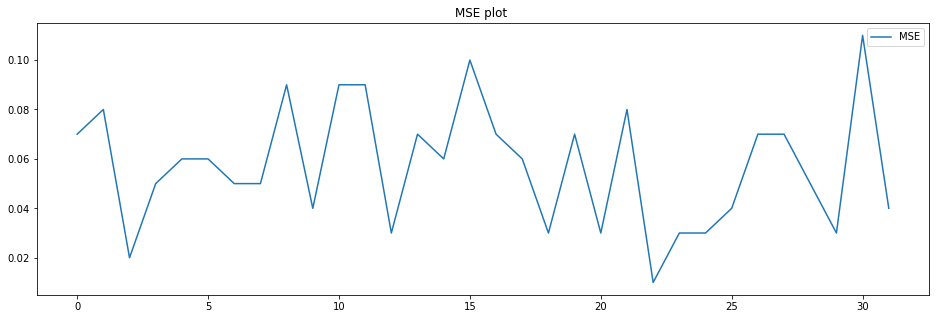


Shapiro_Wilk Test
Statistics=0.974, p=0.6294502020
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.317, p=0.518
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.285
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 286
mean=0.056 ,max=0.101,min=0.013,variance=0.00046


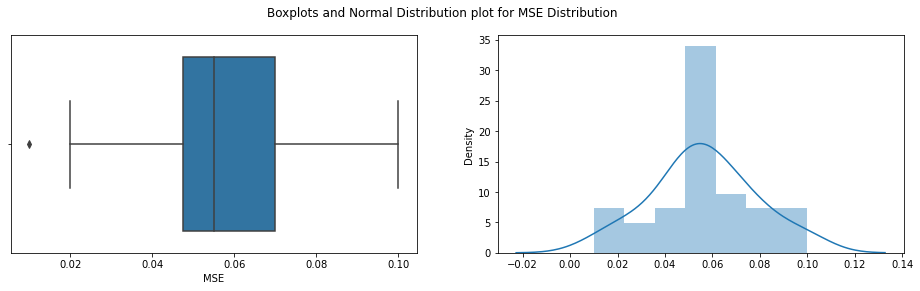

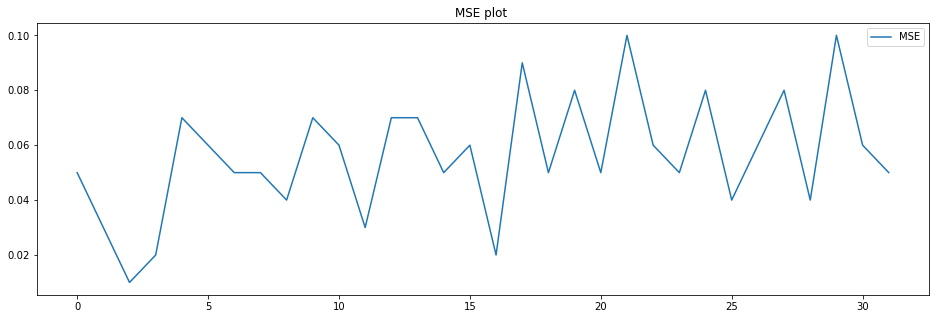


Shapiro_Wilk Test
Statistics=0.974, p=0.6227388978
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.144, p=0.931
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.289
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 287
mean=0.053 ,max=0.113,min=0.017,variance=0.00053


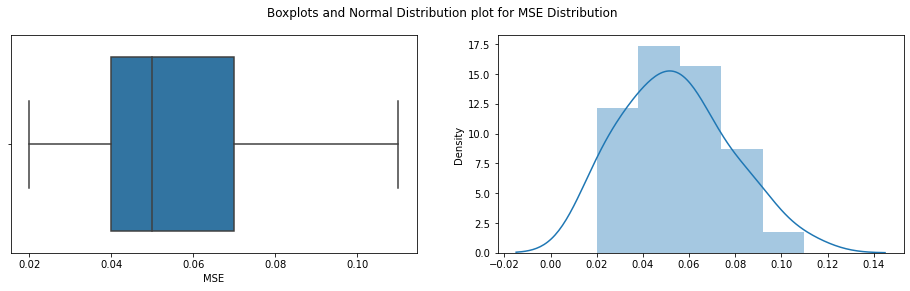

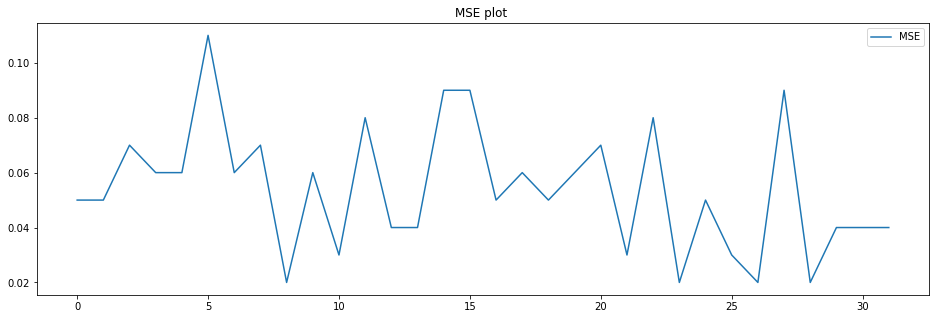


Shapiro_Wilk Test
Statistics=0.971, p=0.5254468918
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.456, p=0.483
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.246
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 288
mean=0.046 ,max=0.081,min=0.012,variance=0.00035


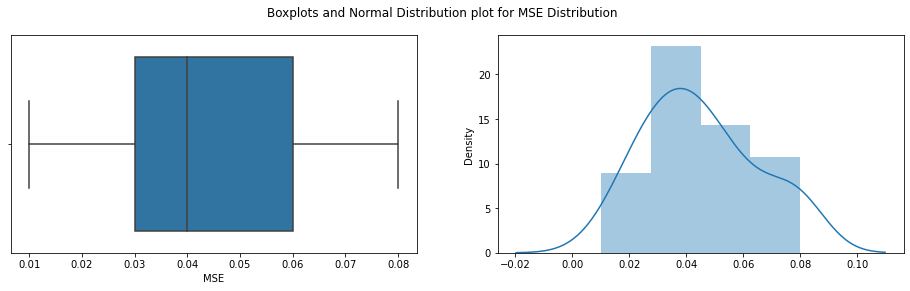

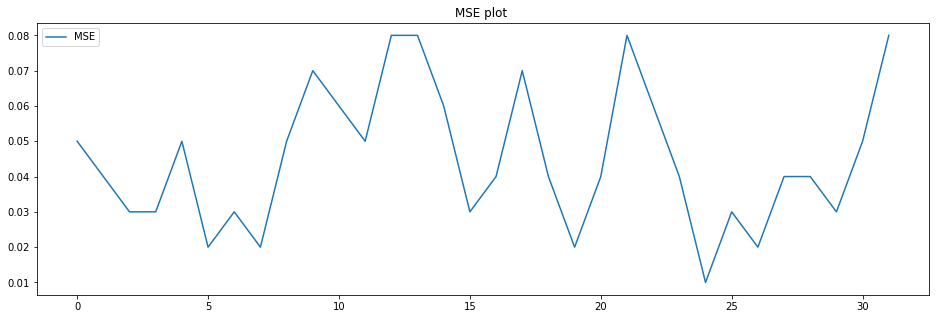


Shapiro_Wilk Test
Statistics=0.951, p=0.1530183256
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.948, p=0.378
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.549
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 289
mean=0.053 ,max=0.088,min=0.015,variance=0.00047


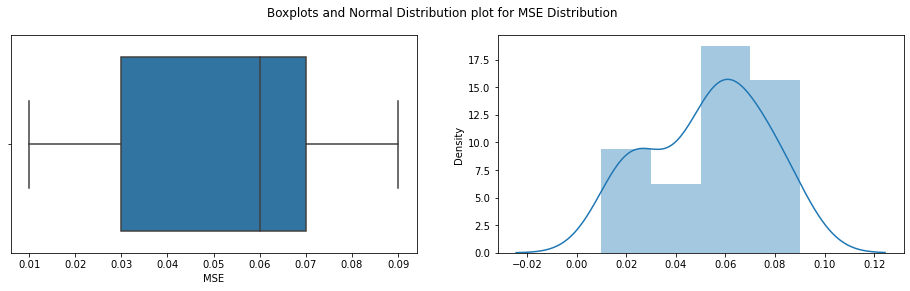

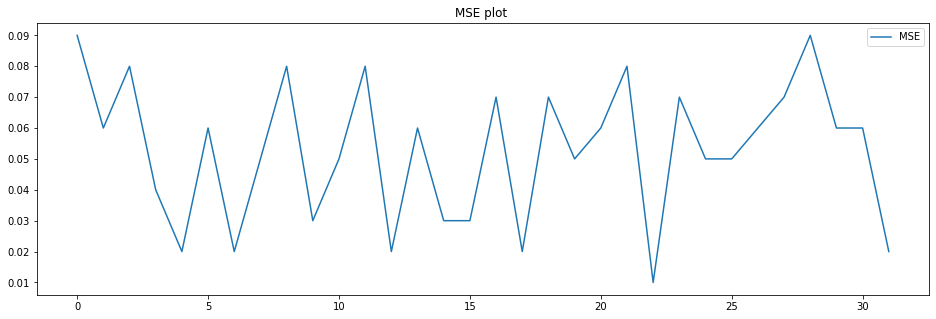


Shapiro_Wilk Test
Statistics=0.948, p=0.1251235455
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.761, p=0.153
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.480
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 290
mean=0.052 ,max=0.099,min=0.016,variance=0.00036


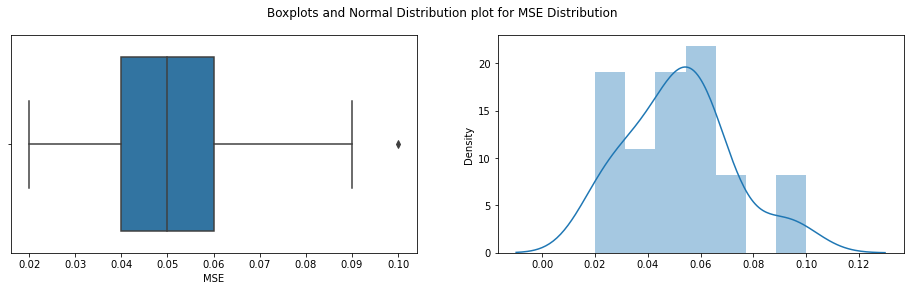

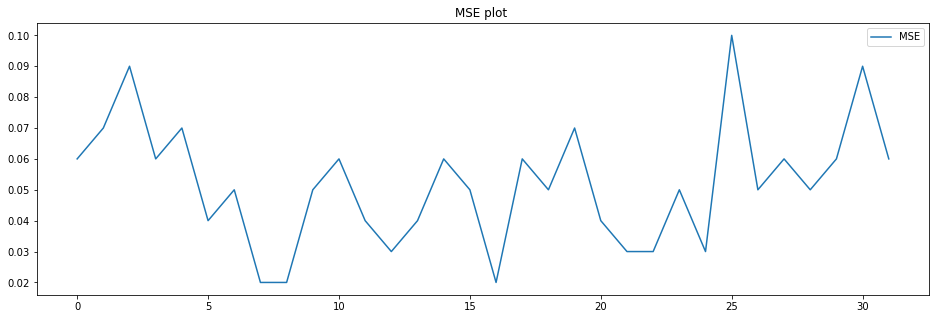


Shapiro_Wilk Test
Statistics=0.979, p=0.7669917941
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.037, p=0.595
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.238
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 291
mean=0.053 ,max=0.103,min=0.02,variance=0.00054


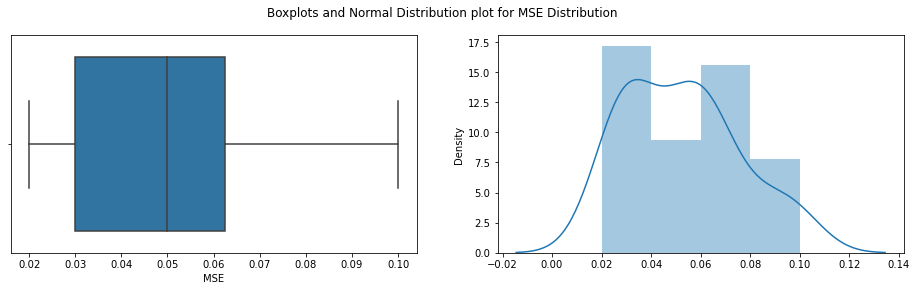

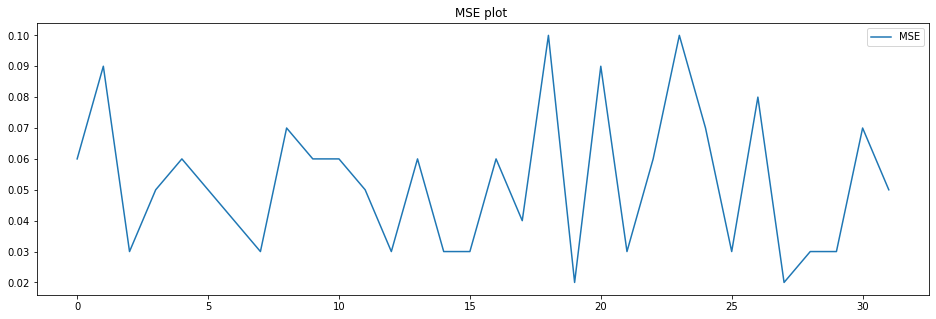


Shapiro_Wilk Test
Statistics=0.933, p=0.0484197810
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=2.514, p=0.284
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.635
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 292
mean=0.055 ,max=0.096,min=0.006,variance=0.0004


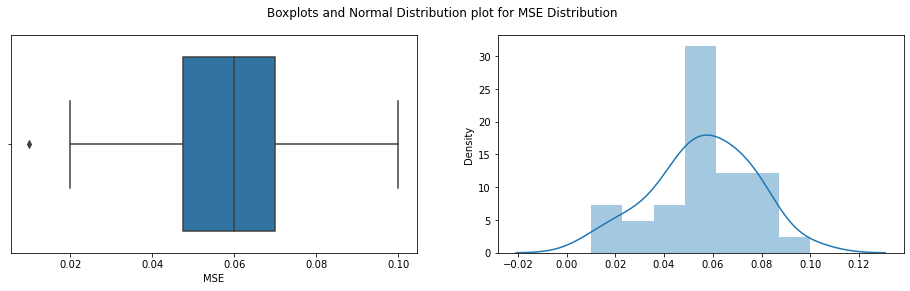

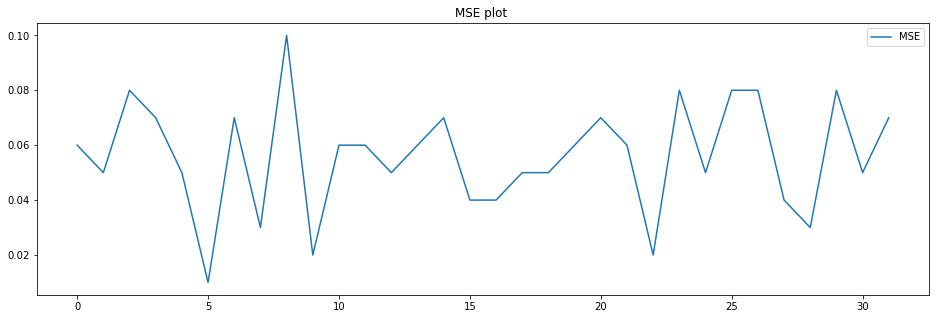


Shapiro_Wilk Test
Statistics=0.980, p=0.7915983200
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.302, p=0.522
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.256
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 293
mean=0.048 ,max=0.102,min=0.013,variance=0.00041


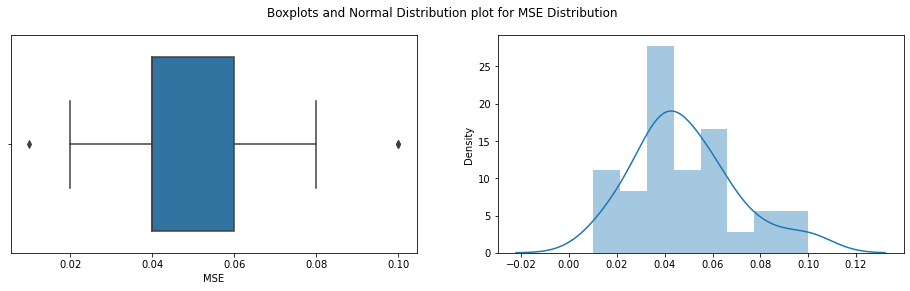

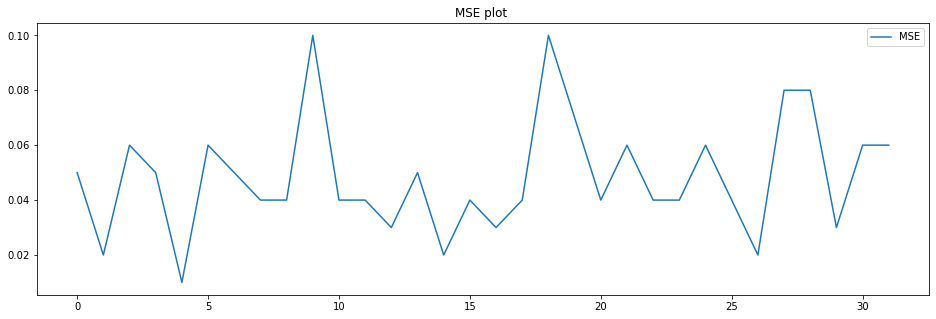


Shapiro_Wilk Test
Statistics=0.943, p=0.0901169330
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.743, p=0.057
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.608
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 294
mean=0.051 ,max=0.078,min=0.022,variance=0.00027


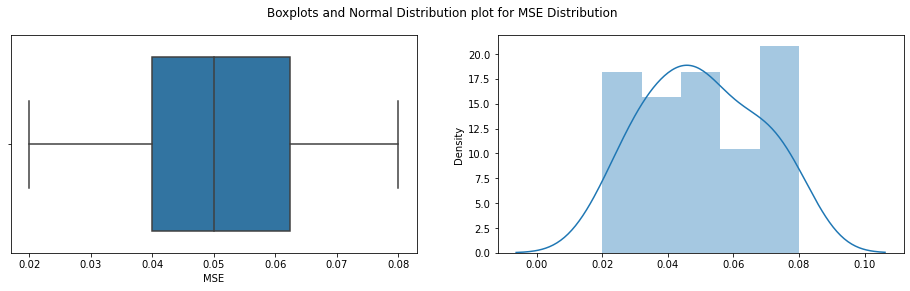

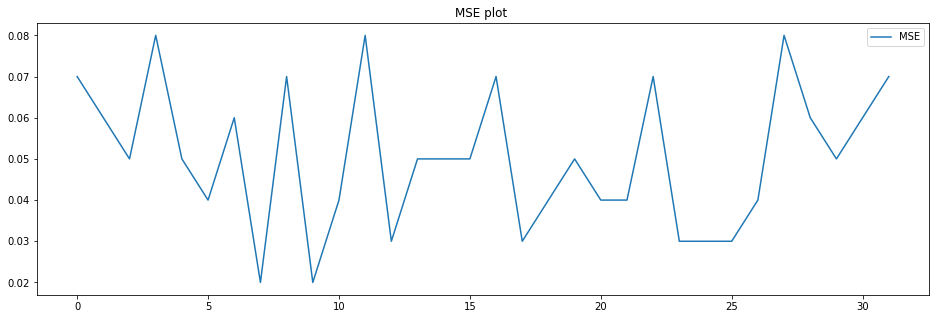


Shapiro_Wilk Test
Statistics=0.955, p=0.2030755579
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.568, p=0.168
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.380
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 295
mean=0.048 ,max=0.097,min=0.019,variance=0.00045


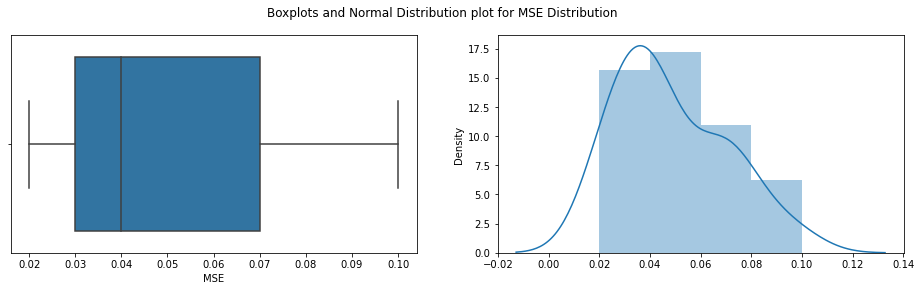

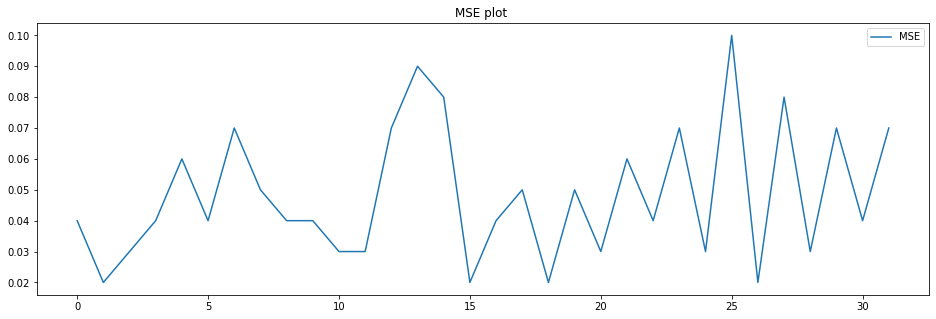


Shapiro_Wilk Test
Statistics=0.930, p=0.0396039598
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=3.036, p=0.219
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.802
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 296
mean=0.057 ,max=0.1,min=0.021,variance=0.0004


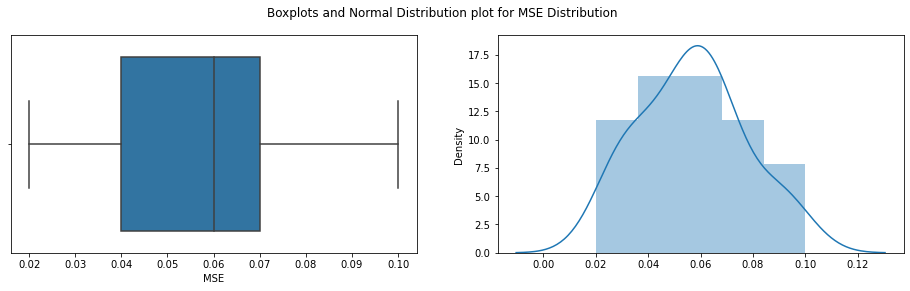

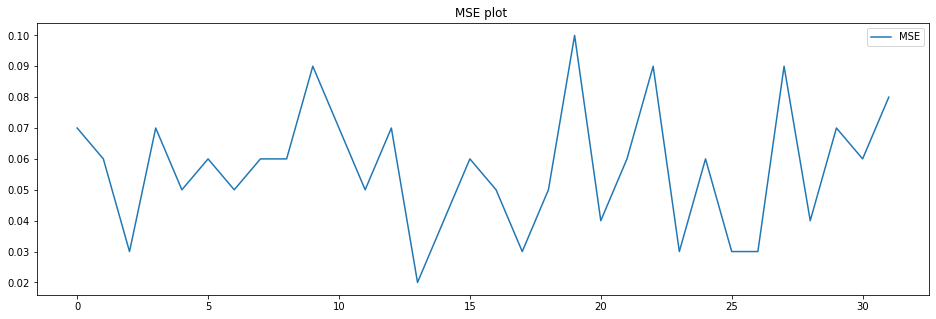


Shapiro_Wilk Test
Statistics=0.976, p=0.6793201566
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.671, p=0.715
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.240
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 297
mean=0.05 ,max=0.117,min=0.018,variance=0.00051


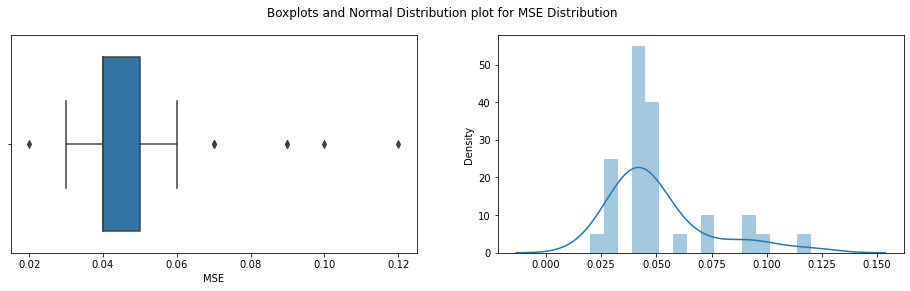

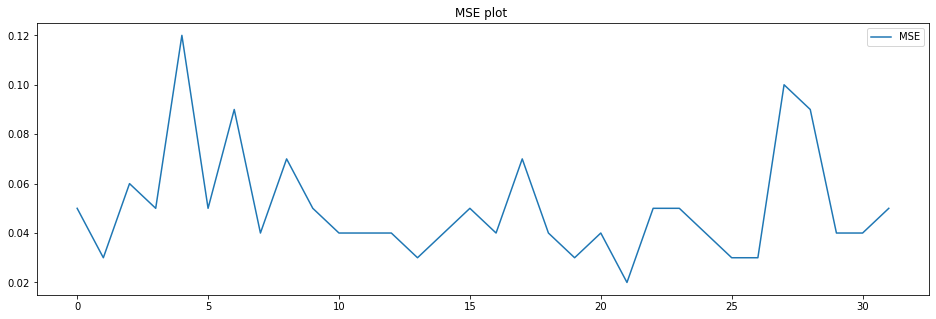


Shapiro_Wilk Test
Statistics=0.856, p=0.0005548759
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=13.109, p=0.001
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.743
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 298
mean=0.052 ,max=0.103,min=0.016,variance=0.00054


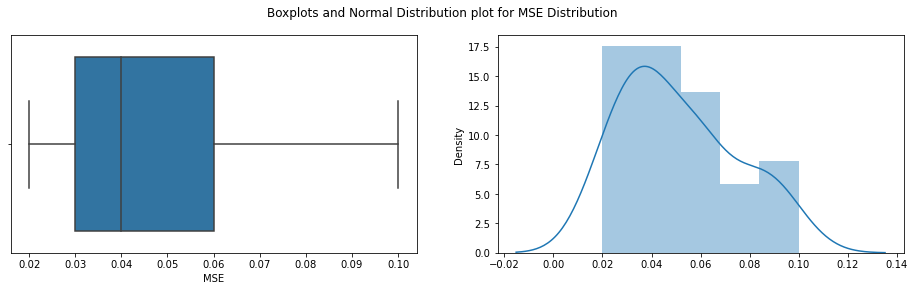

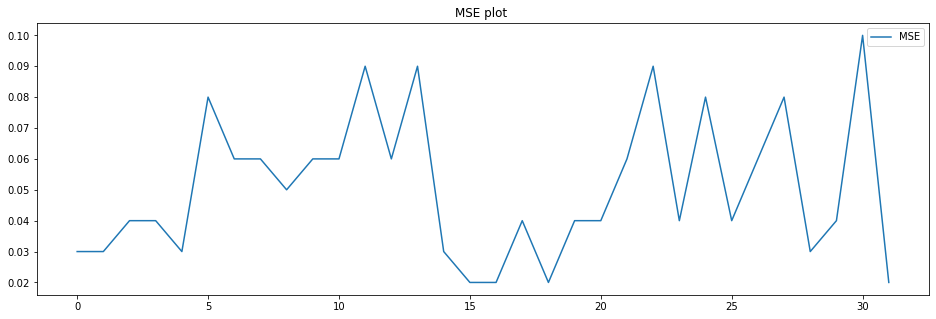


Shapiro_Wilk Test
Statistics=0.947, p=0.1173841655
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.469, p=0.291
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.579
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 299
mean=0.042 ,max=0.069,min=0.016,variance=0.00018


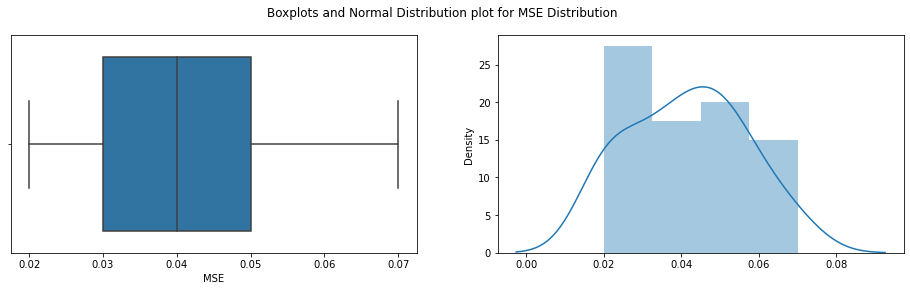

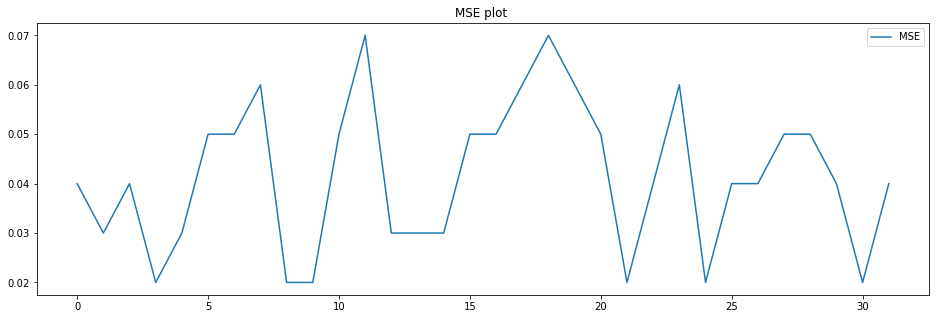


Shapiro_Wilk Test
Statistics=0.975, p=0.6481080055
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.153, p=0.562
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.275
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 300
mean=0.053 ,max=0.103,min=0.008,variance=0.00059


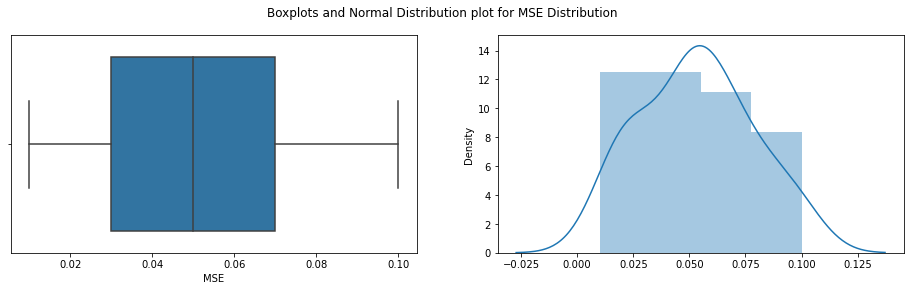

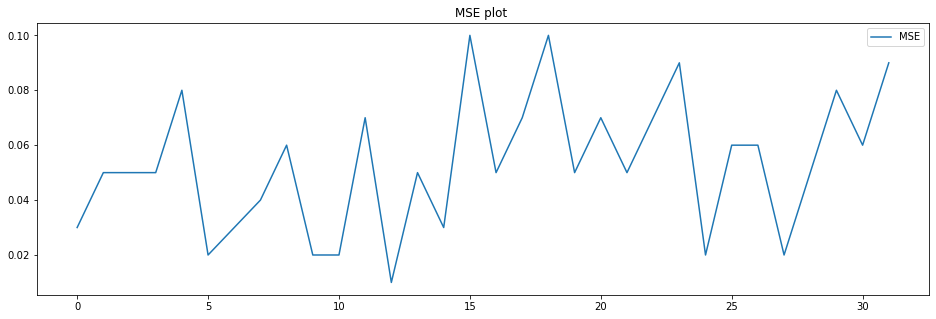


Shapiro_Wilk Test
Statistics=0.970, p=0.5024814606
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.966, p=0.617
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.347
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 301
mean=0.053 ,max=0.088,min=0.019,variance=0.00032


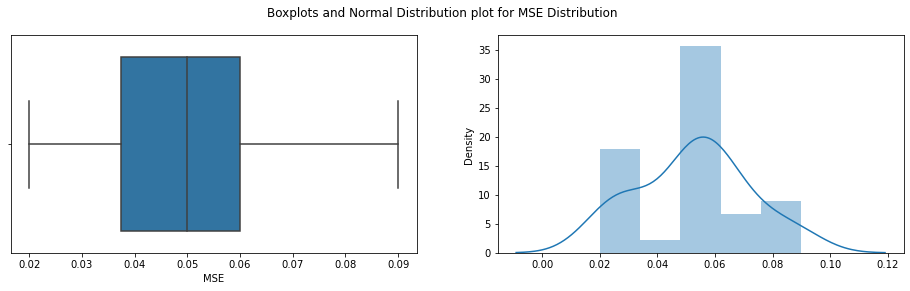

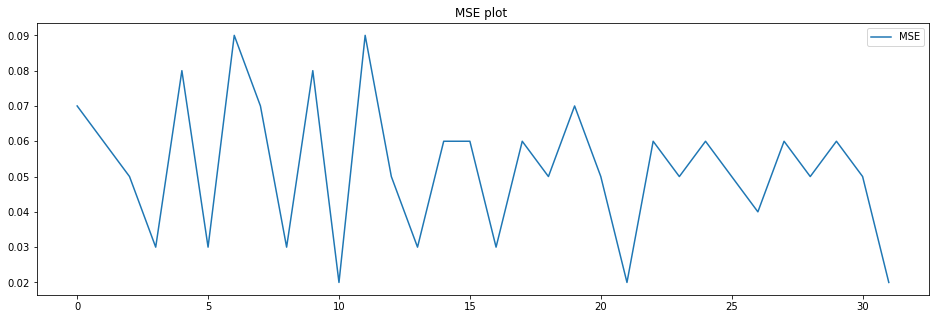


Shapiro_Wilk Test
Statistics=0.977, p=0.6952061653
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.330, p=0.848
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.224
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 302
mean=0.048 ,max=0.091,min=0.016,variance=0.00036


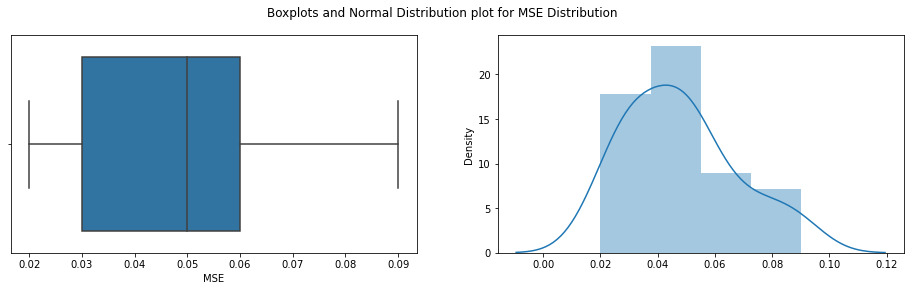

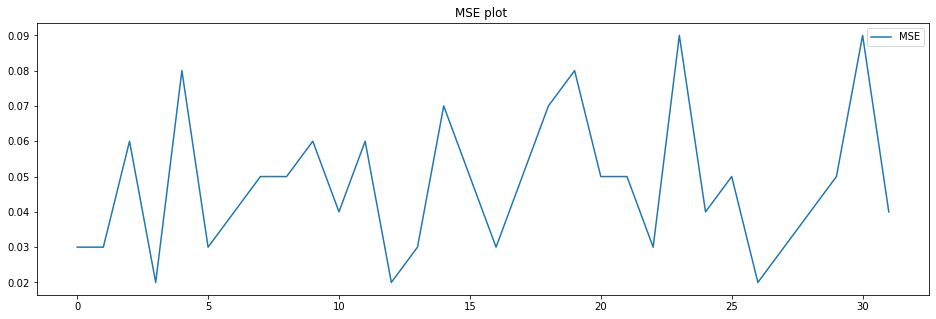


Shapiro_Wilk Test
Statistics=0.956, p=0.2132168859
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=2.080, p=0.353
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.461
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 303
mean=0.047 ,max=0.083,min=0.014,variance=0.00032


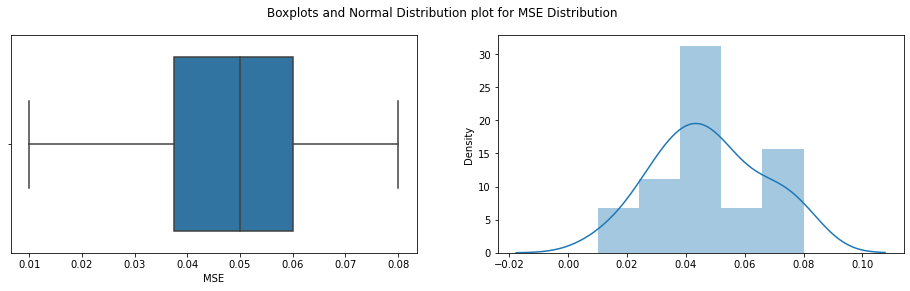

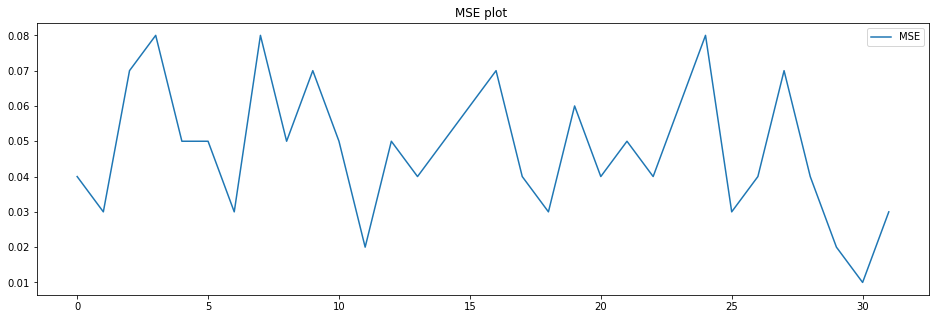


Shapiro_Wilk Test
Statistics=0.977, p=0.6972163320
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.908, p=0.635
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.197
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 304
mean=0.061 ,max=0.12,min=0.008,variance=0.0008


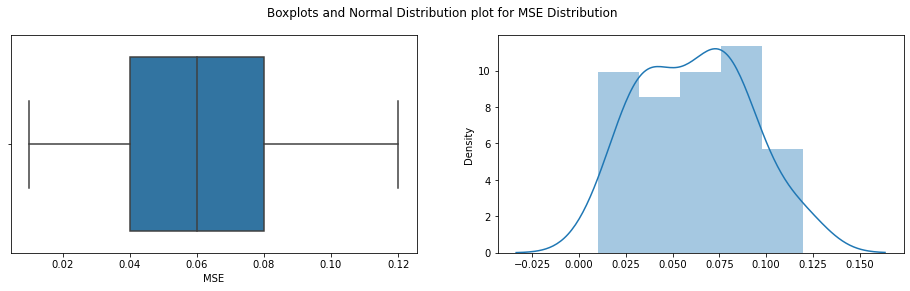

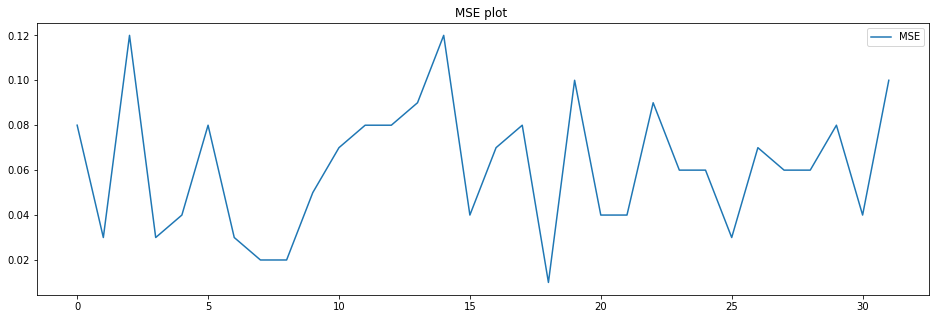


Shapiro_Wilk Test
Statistics=0.972, p=0.5646638870
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.237, p=0.539
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.291
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 305
mean=0.053 ,max=0.083,min=0.013,variance=0.00035


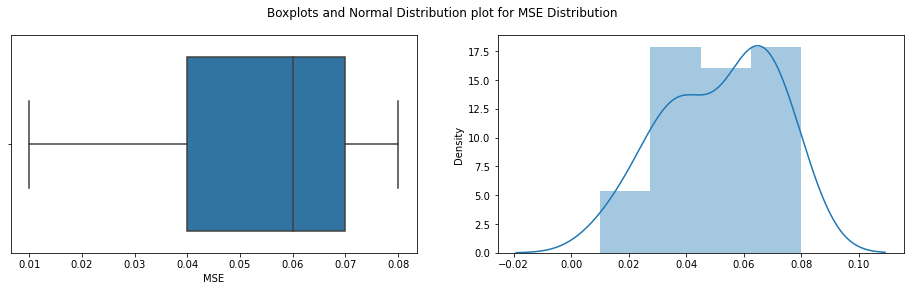

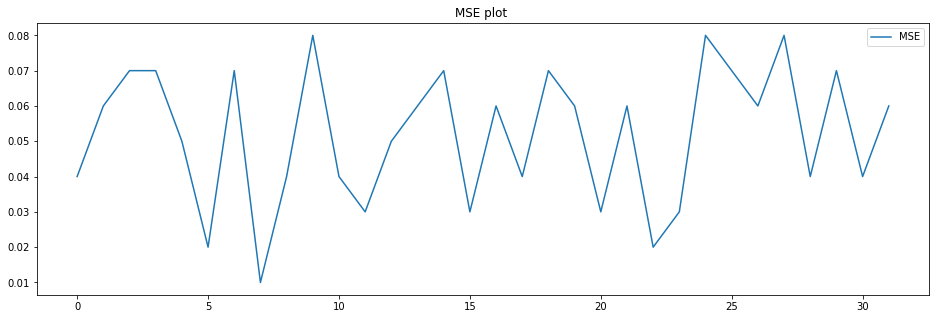


Shapiro_Wilk Test
Statistics=0.950, p=0.1473262012
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.592, p=0.166
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.589
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 306
mean=0.048 ,max=0.119,min=0.013,variance=0.00062


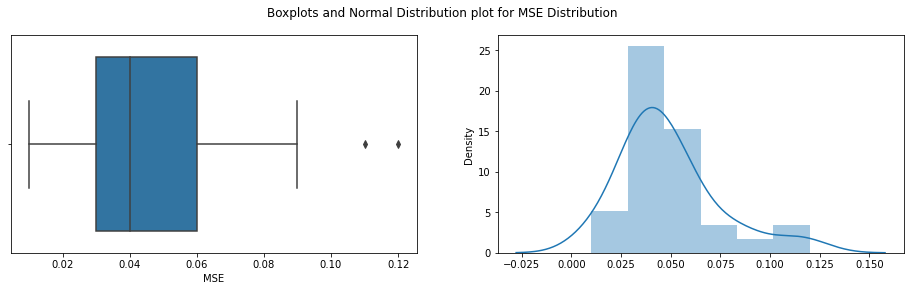

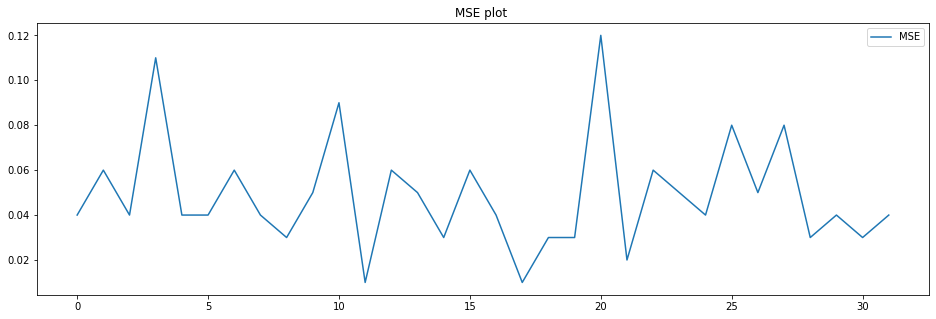


Shapiro_Wilk Test
Statistics=0.899, p=0.0057580569
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=10.054, p=0.007
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 1.073
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data does not look normal (reject H0)

 ********************
Batch: 307
mean=0.063 ,max=0.14,min=0.017,variance=0.00077


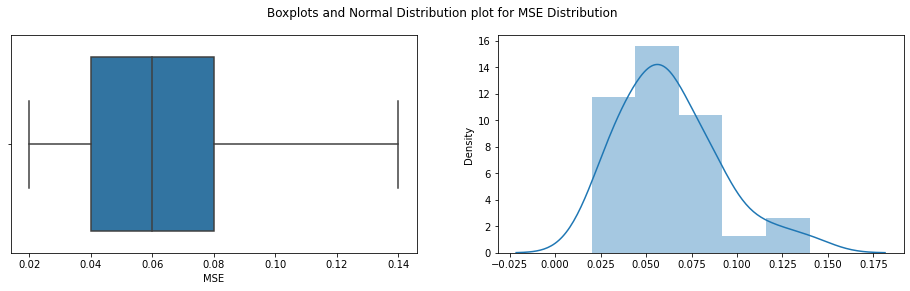

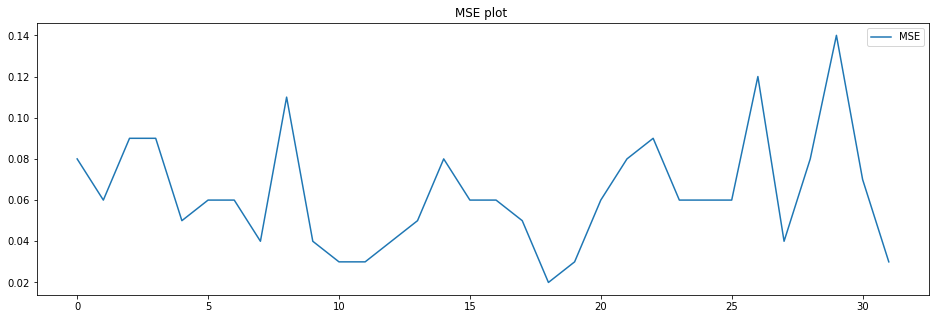


Shapiro_Wilk Test
Statistics=0.942, p=0.0831559524
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.551, p=0.062
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.677
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 308
mean=0.06 ,max=0.112,min=0.013,variance=0.00067


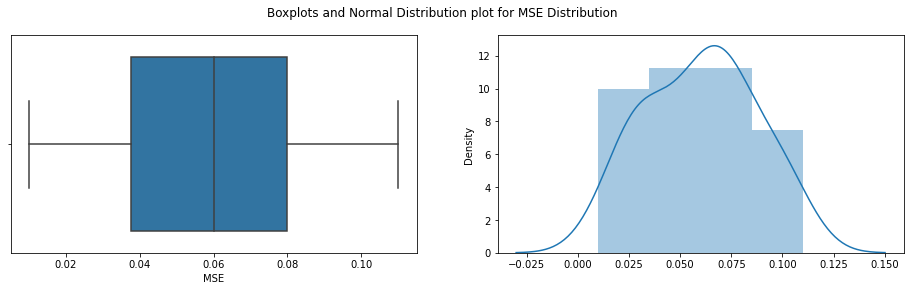

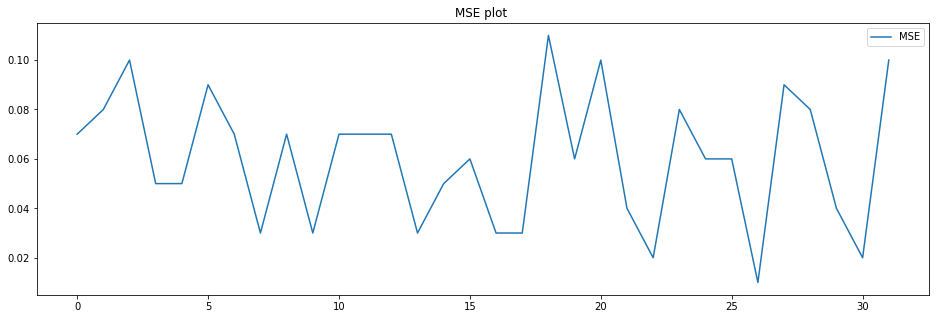


Shapiro_Wilk Test
Statistics=0.977, p=0.7172074318
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.387, p=0.500
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.231
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 309
mean=0.056 ,max=0.093,min=0.016,variance=0.00048


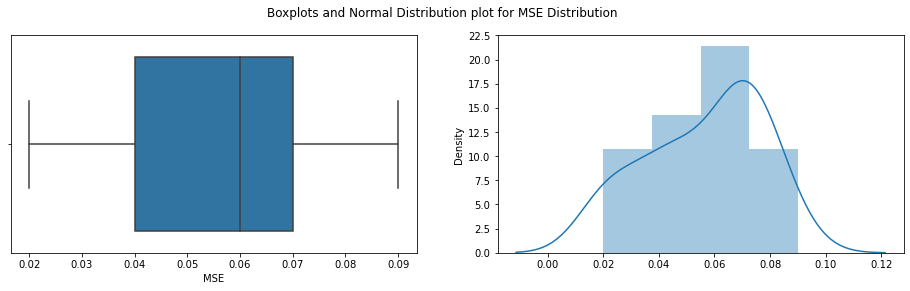

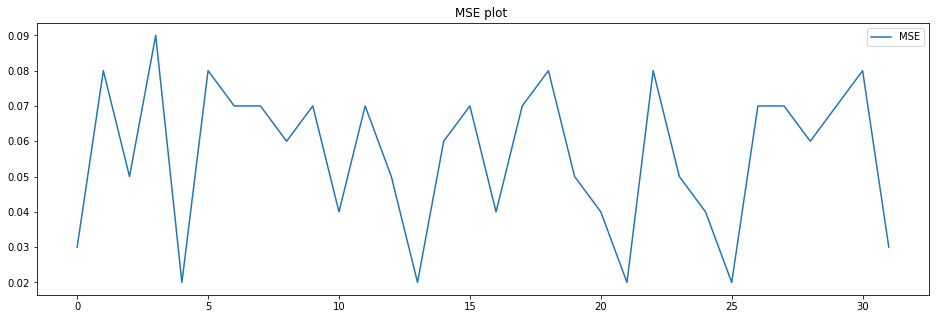


Shapiro_Wilk Test
Statistics=0.936, p=0.0579378754
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=5.021, p=0.081
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.762
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 310
mean=0.056 ,max=0.094,min=0.018,variance=0.00035


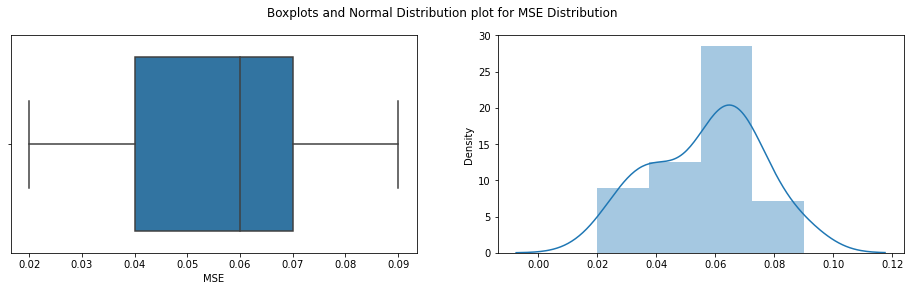

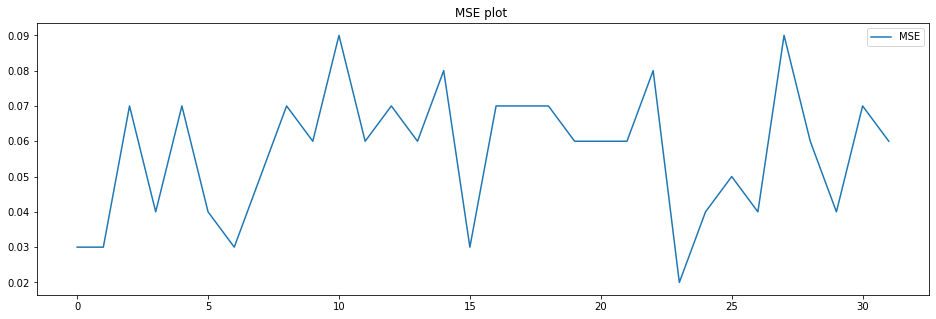


Shapiro_Wilk Test
Statistics=0.979, p=0.7824769020
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.324, p=0.851
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.258
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 311
mean=0.049 ,max=0.113,min=0.015,variance=0.00057


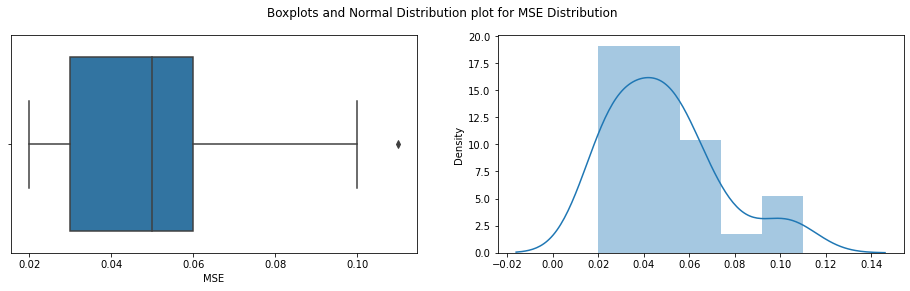

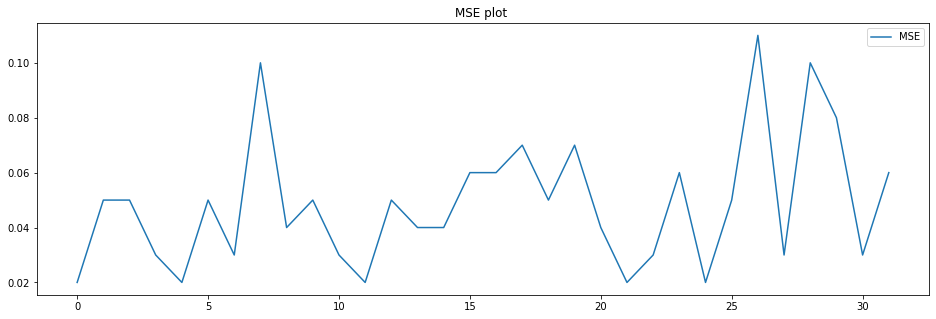


Shapiro_Wilk Test
Statistics=0.905, p=0.0082691340
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=7.946, p=0.019
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.892
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data does not look normal (reject H0)
5.000: 0.715, data does not look normal (reject H0)
2.500: 0.834, data does not look normal (reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 312
mean=0.051 ,max=0.103,min=0.014,variance=0.00051


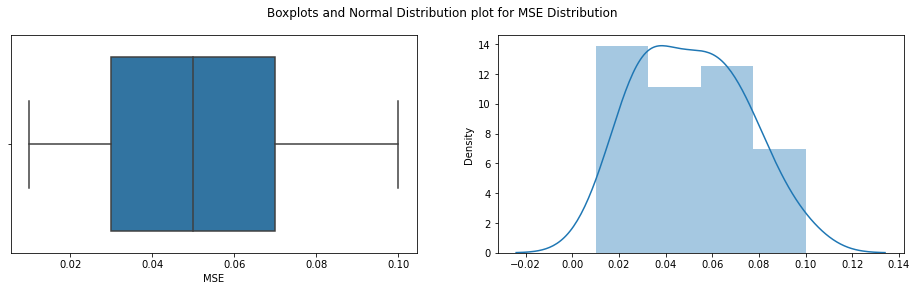

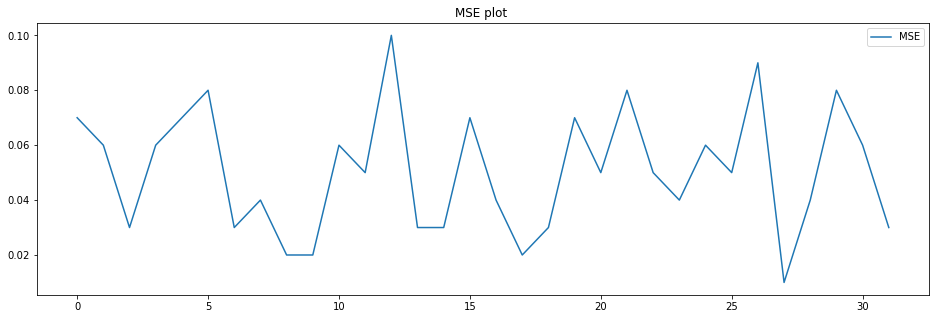


Shapiro_Wilk Test
Statistics=0.970, p=0.5035026670
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=1.461, p=0.482
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.273
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 313
mean=0.046 ,max=0.075,min=0.022,variance=0.0002


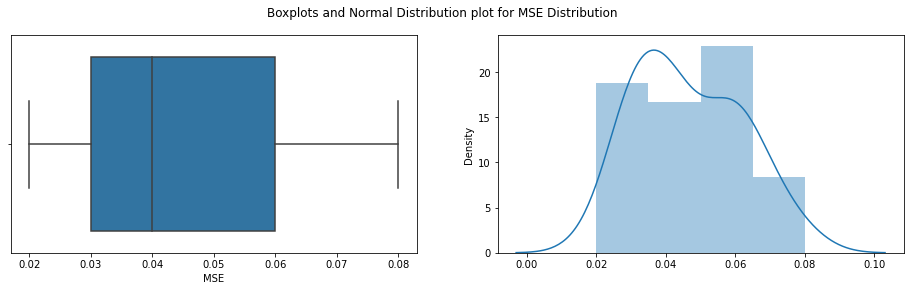

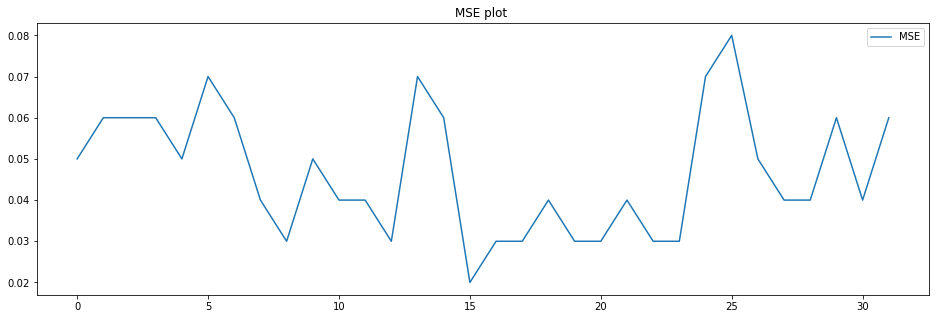


Shapiro_Wilk Test
Statistics=0.958, p=0.2414319366
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=3.356, p=0.187
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.513
15.000: 0.523, data looks normal (fail to reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 314
mean=0.054 ,max=0.144,min=0.012,variance=0.00073


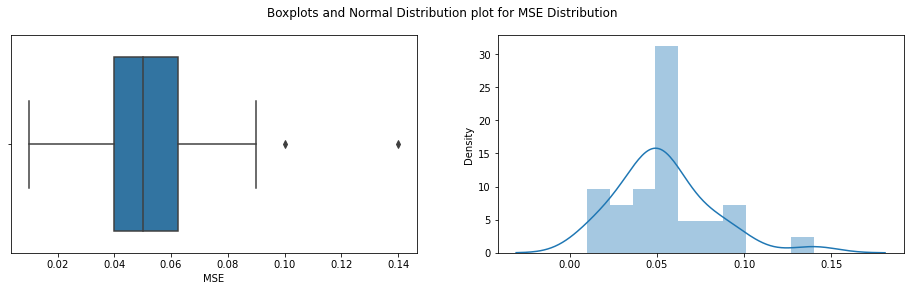

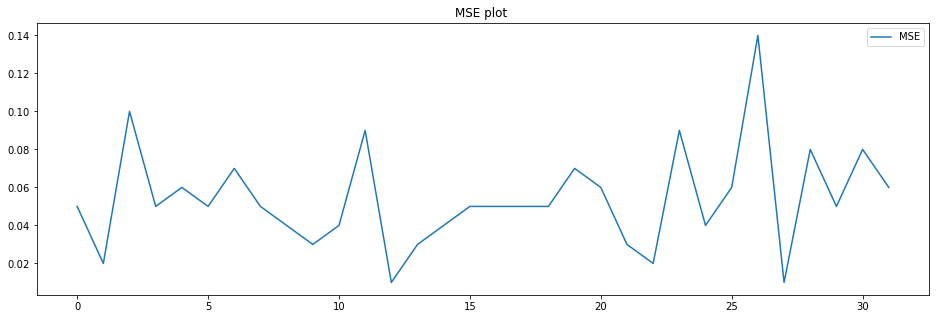


Shapiro_Wilk Test
Statistics=0.929, p=0.0369411670
Sample does not look Gaussian (reject H0)
D_Agostino Test
Statistics=11.137, p=0.004
Sample does not look Gaussian (reject H0)

Anderson_Darling Test
Statistic: 0.553
15.000: 0.523, data does not look normal (reject H0)
10.000: 0.596, data looks normal (fail to reject H0)
5.000: 0.715, data looks normal (fail to reject H0)
2.500: 0.834, data looks normal (fail to reject H0)
1.000: 0.992, data looks normal (fail to reject H0)

 ********************
Batch: 315
mean=0.064 ,max=0.101,min=0.033,variance=0.00046


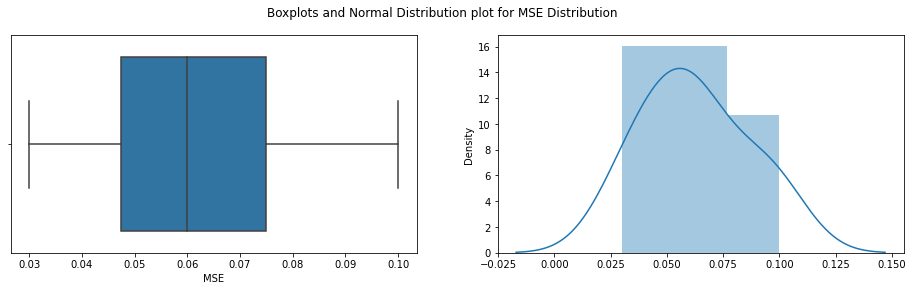

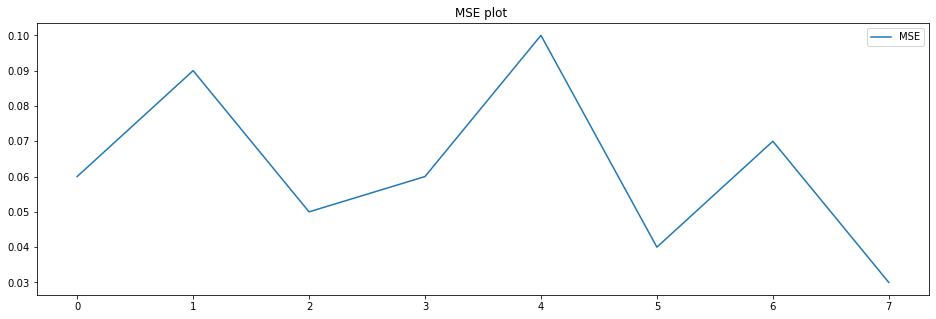


Shapiro_Wilk Test
Statistics=0.958, p=0.7874103785
Sample looks Gaussian (fail to reject H0)
D_Agostino Test
Statistics=0.506, p=0.777
Sample looks Gaussian (fail to reject H0)

Anderson_Darling Test
Statistic: 0.217
15.000: 0.519, data looks normal (fail to reject H0)
10.000: 0.591, data looks normal (fail to reject H0)
5.000: 0.709, data looks normal (fail to reject H0)
2.500: 0.827, data looks normal (fail to reject H0)
1.000: 0.984, data looks normal (fail to reject H0)


In [60]:
batch_avg_mse_pos,batch_mse_values_pos=check_all_batch_normality(batches_pos,encoder_pos_class,32)

## Compute Instance Level Threshold 

In [61]:
instance_thresh_pos,zscore_list_pos =compute_instance_threshold_firstN_batches(batch_mse_values_pos,30)

In [62]:
instance_thresh_pos

0.1178

In [63]:
Anderson_Darling(zscore_list_pos)

Statistic: 0.181
15.000: 0.521, data looks normal (fail to reject H0)
10.000: 0.593, data looks normal (fail to reject H0)
5.000: 0.712, data looks normal (fail to reject H0)
2.500: 0.830, data looks normal (fail to reject H0)
1.000: 0.988, data looks normal (fail to reject H0)


## Compute Batch Threshold 

In [64]:
thres_iqr_batch_pos, thres_zscore_batch_pos ,thresh_max_batch_pos=compute_batch_threshold_testdata(batch_avg_mse_pos)

In [65]:
thres_iqr_batch_pos, thres_zscore_batch_pos ,thresh_max_batch_pos

(0.0639, 0.0658, 0.065)

## Compute Count Threshold

In [66]:
# Counts the MSE values exceeding threshold in each batch 
exceed_count_pos,total_pos=threshold_exceed_count(batch_mse_values_pos,instance_thresh_pos)

In [67]:
exceed_count_pos,total_pos;

In [68]:
exceed_list_pos=[]
for key in exceed_count_pos.keys():
    exceed_list_pos.append(exceed_count_pos[key])

mean=0.18 ,max=2,min=0,variance=0.17316


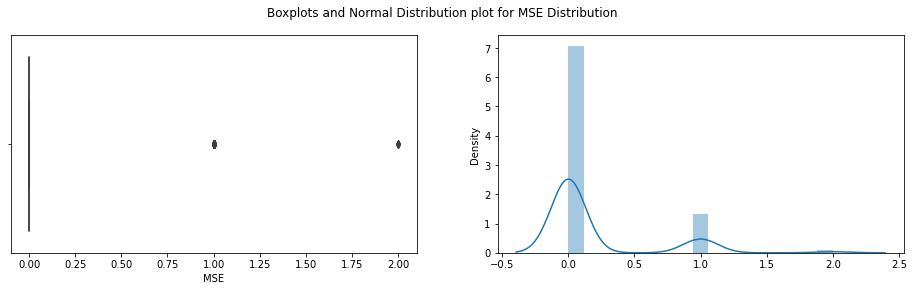

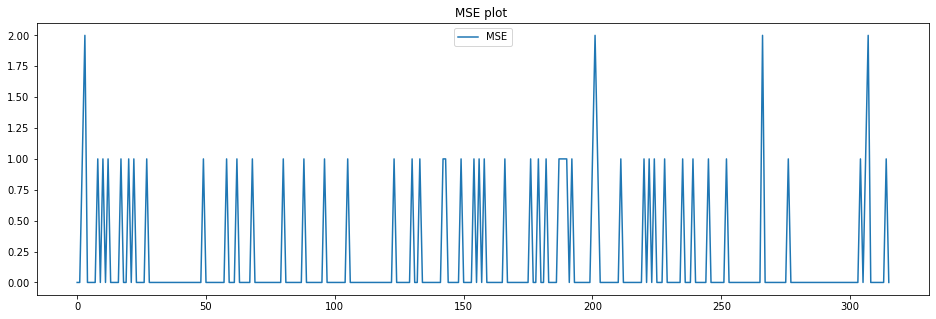

In [69]:
plot_results(exceed_list_pos)

In [70]:
count_thresh_pos=np.max(exceed_list_pos)

In [71]:
count_thresh_pos

2

##  Working with Drifted Dataset 

In [72]:
drift_set=gen_hyperplane_data(10000, 10, 8,0.5, 0,0 )

In [73]:
drift_set

,att0,att1,att2,att3,att4,att5,att6,att7,att8,att9,output
0,0.791725,0.528895,0.568045,0.925597,0.071036,0.087129,0.020218,0.832620,0.778157,0.870012,1
1,0.414662,0.264556,0.774234,0.456150,0.568434,0.018790,0.617635,0.612096,0.616934,0.943748,0
2,0.315428,0.363711,0.570197,0.438602,0.988374,0.102045,0.208877,0.161310,0.653108,0.253292,0
3,0.097101,0.837945,0.096098,0.976459,0.468651,0.976761,0.604846,0.739264,0.039188,0.282807,1
4,0.523248,0.093941,0.575946,0.929296,0.318569,0.667410,0.131798,0.716327,0.289406,0.183191,0
...,...,...,...,...,...,...,...,...,...,...,...
9995,0.054854,0.063050,0.777511,0.065467,0.154705,0.475271,0.253900,0.603893,0.985970,0.786833,0
9996,0.144813,0.652069,0.887089,0.281824,0.813089,0.003370,0.031384,0.046594,0.254128,0.174100,0
9997,0.168283,0.160162,0.148071,0.101906,0.917511,0.371122,0.033393,0.765036,0.089591,0.654368,0
9998,0.367327,0.900807,0.350671,0.271159,0.672307,0.750504,0.504976,0.792326,0.382003,0.053055,1


In [74]:
del drift_set['output']

In [75]:
def prepare_test_data(data):
     
    # Apply Label Encoding
    encoder=LabelEncoder()
    for col in data.columns:
        if ((data[col].dtype=='object')and (col!=label_col)): 
            data = pd.get_dummies(data, columns=[col])
            
   # Apply Minmax Normalization 
    for col in data.columns:
        if ((data[col].dtype=='float64')or(data[col].dtype=='int64')): 
            data[col] = np.round((data[col] - data[col].min()) / (data[col].max() - data[col].min()) ,3)  
        
  
   
    return data

In [76]:
drift_set=prepare_test_data(drift_set)

In [77]:
drift_set

,att0,att1,att2,att3,att4,att5,att6,att7,att8,att9
0,0.792,0.529,0.568,0.926,0.071,0.087,0.020,0.833,0.778,0.870
1,0.415,0.265,0.774,0.456,0.568,0.019,0.618,0.612,0.617,0.944
2,0.315,0.364,0.570,0.439,0.988,0.102,0.209,0.161,0.653,0.253
3,0.097,0.838,0.096,0.976,0.469,0.977,0.605,0.739,0.039,0.283
4,0.523,0.094,0.576,0.929,0.318,0.667,0.132,0.716,0.289,0.183
...,...,...,...,...,...,...,...,...,...,...
9995,0.055,0.063,0.778,0.065,0.155,0.475,0.254,0.604,0.986,0.787
9996,0.145,0.652,0.887,0.282,0.813,0.003,0.031,0.046,0.254,0.174
9997,0.168,0.160,0.148,0.102,0.918,0.371,0.033,0.765,0.090,0.654
9998,0.367,0.901,0.351,0.271,0.672,0.751,0.505,0.792,0.382,0.053


In [78]:
batches_d=make_batches(drift_set,32)

In [79]:
keys = (0, 1, 2,3,4)
test_batches = {k: batches_d[k] for k in keys}

In [80]:
len(test_batches[1])

32

In [200]:
def detect_at_batch_level(test_batch,b,batch_thres_pos,batch_thres_neg,count_thresh_pos,count_thres_neg,instance_thresh_pos,instance_thresh_neg, all_excede_list):
    
    # Layer 1 Variables 
    mse_list_layer1=[]     # Holds the MSE values predicted by Layer 1 Autoencoder for a single batch
    exceed_count_layer1=0  # How many instances exceed layer one instance level threshold
    mse_sum=0              # sum of MSE values from layer 1 AE for this batch
    #batch_mse_layer1=[]
    
    
    # Layer 2 Variables 
    mse_list_layer2=[]      # Holds the MSE values predicted by Layer 2 Autoencoder for a single batch
    exceed_count_layer2=-1  # If a batch is not passed to the layer2 AE , then exceed count value will be -1 . This is symbolic.
    mse_sum_layer2=0        # sum of MSE values from layer 2 AE for this batch
    
        
    layer1_excede_list=[] # Hold the batch numbers of bathces exceeding layer thresholds
    #all_excede_list=[]    # Hold the batch number of batches exceeding both Layer-1 and Layer-2 AE Thresholds 
    layer_one_instance_exceed_list=[] # Holds the indices of instances exceeding layer 1 instance threshold
    layer_two_instance_exceed_list=[] # Holds the indices of instances exceeding layer 2 instance thresholds
     
      
    # Determine Layer 1 and Layer AE and their associated thresholds
    layer_one_batch_thres= batch_thres_pos if batch_thres_pos<batch_thres_neg  else batch_thres_neg
    layer_two_batch_thres= batch_thres_pos if batch_thres_pos>batch_thres_neg  else batch_thres_neg
    layer_one_encoder= encoder_pos_class if batch_thres_pos<batch_thres_neg else encoder_neg_class
    layer_two_encoder= encoder_pos_class if batch_thres_pos>batch_thres_neg else encoder_neg_class
    
    layer_one_count_threshold=count_thresh_pos if batch_thres_pos<batch_thres_neg  else count_thres_neg
    layer_two_count_threshold=count_thresh_pos if batch_thres_pos>batch_thres_neg  else count_thres_neg
    
    layer1_ins_thresh=instance_thresh_pos if  batch_thres_pos<batch_thres_neg  else instance_thresh_neg
    layer2_ins_thresh=instance_thresh_pos if  batch_thres_pos>batch_thres_neg  else instance_thresh_neg
    
    # Pass each instance of a batch from Layer 1 AE. Compute Batch MSE and Number of Instances excceding Layer 1 Instance Thresh       
    avg_mse_layer1=0
    for i in range(0,test_batch.shape[0]):
        ROW = np.array([test_batch[i]])
        pred= layer_one_encoder.predict(ROW) 
        mse = np.round(np.mean(np.power(test_batch[i] - pred, 2)),5)
        mse_list_layer1.append(mse)
        if mse>layer1_ins_thresh:
            exceed_count_layer1+=1
            layer_one_instance_exceed_list.append(i)
        mse_sum+=mse    
    avg_mse_layer1=(mse_sum)/len(test_batch)
    avg_mse_layer2=0 
    # Check if This batch exceeds both Layer 1 batch and count thresholds
    if ((avg_mse_layer1>layer_one_batch_thres) and ( exceed_count_layer1 >layer_one_count_threshold) ):
        layer1_excede_list.append(b)# Keep track of batches exceesding layer 1 thresholds
        exceed_count_layer2=0
        # Pass each instance of this batch to Layer 2 AE. Compute Batch MSE and Number of Instances excceding Layer 2 Instance Thresh
        for i in range(0,test_batch.shape[0]):
            ROW = np.array([test_batch[i]])
            pred= layer_two_encoder.predict(ROW) 
            mse = np.round(np.mean(np.power(test_batch[i] - pred, 2)),5)
            mse_list_layer2.append(mse)
            if mse>layer2_ins_thresh:
                exceed_count_layer2+=1
                layer_two_instance_exceed_list.append(i)
            mse_sum_layer2+=mse    
        avg_mse_layer2=(mse_sum_layer2)/len(test_batch)
        
        if  (avg_mse_layer2 > layer_two_batch_thres) and (exceed_count_layer2>layer_two_count_threshold):
            all_excede_list.append(b)# Keep track of batches exceesding layer 2 thresholds
          
    return  all_excede_list,mse_list_layer1 , exceed_count_layer1 ,avg_mse_layer2,exceed_count_layer2,len(layer_two_instance_exceed_list),layer_two_batch_thres,layer_two_count_threshold,layer_one_instance_exceed_list,layer_two_instance_exceed_list,avg_mse_layer1 

In [201]:
# This function makes a list of dictionary values
def return_list_of_dict_values(d):
    values_list=[]
    for key in d.keys():
        values_list.append(d[key])
    return values_list

In [202]:
# This function takes two lists of Batch MSE and Exceed Counts along with Batch and Count Thresholds of Layer 2 AE
# If three consecutive bathces exceed booth thresholds , warning is generated and for 10 consectutive batches drift is confirmed.
def detect_drift(batch_mse,exceed_list, Thresh,count_thresh):
    n=0 # total number of batches where MSE exceeds threshold
    count=0 ## counts the number of consecutive batches exceding threshold
    w_count=0 # Count of elements in Window. Windows contains batch number where batch MSE exceeds
              #threshold 
    w_index_list=[] # Contains indices of batches where batch MSE esceeds threshold 
    for i in range(0,len(batch_mse)):
        #print (batch_mse)
        if((((batch_mse[i])>Thresh)) and (exceed_list[i]>count_thresh)):
            print(' Threshold exceeds at batch : {}'.format(i))
            n=n+1
            #print('Cumulative Batch Count Exceeding Threshold : {}'.format(n))
            if(len(w_index_list)==0 or (i-w_index_list[-1]==1)):
                # Check if w_index_list is empty or its last entry is the previous batch
                    w_index_list.append(i)# then append this batch to w_index_list
            count+=1
            #if (i!= w_index_list[-1]
            #print ("Batch %d MSE exceeds Threshold" %i)
            print(w_index_list)
            if (count>2):# if for more than nine consecutive batches , batch MSE esceeds threshold , then 
                         # confirm drift
                drift_batch=i-2 # at the first batch i this window

                print( " Drift Confirmed at Batch No : % d" %drift_batch)
            if (len(w_index_list)>=1 and len(w_index_list)<=2):
                w_level=i-len(w_index_list)
                print("Warning Level at Batch",i)
        
        if(batch_mse[i])<Thresh:
            count=0 # reset count 
            #if len(w_index_list)>=2:
               # w_level=i-len(w_index_list)
                #print("Warning Level at Batch",w_level)
            if len(w_index_list)<=3:
                w_index_list=[]

In [203]:
def detect_stream_drift(batches,encoder_pos_class,encoder_neg_class,batch_thres_pos,batch_thres_neg, count_thresh_pos,count_thres_neg):
    exceed_count_layer2_instance_thresh={} # Holds Number of instances exceeding thresholds of Both Layer 1 and layer 2 AE.
    
    mse_dict_L1={}         # Holds batchwise MSE values from Layer 1 AE
    exceed_count_L1={}     # Batchwise number of Instances exceeding layer 1 count threshold
    layer_one_instance_exceed_list={} # batch wise list of instances ( indices ) exceeding Layer 1 count threshold
    avg_mse_l1={}
    
    mse_dict_L2={}        # Holds batchwise MSE values from Layer 2 AE
    exceed_count_L2={}    # Batchwise number of Instances exceeding layer 2 count threshold
    layer_two_instance_exceed_list={} # For each batch maintains the indices where MSE exceeds layer 2 threshold
    avg_mse_l2={}         #
    all_excede_list=[]
    n=0
    for b in batches:
        print("\n\n")
        print("**************")
        print('\nBatch Number : {}'.format(b))
        all_excede_list,mse_dict_L1[b],exceed_count_L1[b],avg_mse_l2[b],exceed_count_L2[b],exceed_count_layer2_instance_thresh[b],layer_two_batch_thres,layer_two_count_threshold,layer_one_instance_exceed_list[b],layer_two_instance_exceed_list[b],avg_mse_l1[b]= detect_at_batch_level(batches[b],b,batch_thres_pos,batch_thres_neg,count_thresh_pos,count_thres_neg,instance_thresh_pos,instance_thresh_neg, all_excede_list)
             
        
        print('\nData Points Exceeding Layer 1 Encoder Instance Threshold : {} '.format(layer_one_instance_exceed_list[b]))
        print('\nData Points Exceeding Layer 2 Encoder Instance Threshold: {}'.format(layer_two_instance_exceed_list[b])) 
        print('\nNumber of Data Points Exceeding Layer 2 Encoder Instance thresholds: {}'.format(exceed_count_layer2_instance_thresh[b]))
        
    mse_list_layer1=return_list_of_dict_values(avg_mse_l1)
    exceed_count_list_layer1=return_list_of_dict_values(exceed_count_L1)
    
    
    ## Detect Drift at Batch Level 
    print ("\n Drift Detection at Batch Level\n")
    exceed_list=return_list_of_dict_values(exceed_count_L2)
    mse_list=return_list_of_dict_values(avg_mse_l2)
    detect_drift(mse_list,exceed_list,layer_two_batch_thres,layer_two_count_threshold )
        
    return all_excede_list,exceed_count_layer2_instance_thresh ,exceed_count_L2,avg_mse_l2 ,mse_list_layer1,exceed_count_list_layer1




In [204]:
keys = tuple(range(10))
#keys = (0, 1, 2,3,4)
test_batches = {k: batches_d[k] for k in keys}

In [205]:
all_excede_list_drifted,exceed_count_L2_instThresh_drifted ,exceed_count_L2_countThresh_drifted,avg_mse_l2_list_drifted,mse_list_layer1_drifted,exceed_count_list_layer1_drifted=detect_stream_drift(batches_d,encoder_pos_class,encoder_neg_class,thres_zscore_batch_pos,thres_zscore_batch_neg, count_thresh_pos,count_thresh_neg)




**************

Batch Number : 0

Data Points Exceeding Layer 1 Encoder Instance Threshold : [0, 7, 15, 23, 29] 

Data Points Exceeding Layer 2 Encoder Instance Threshold: [20, 21, 30]

Number of Data Points Exceeding Layer 2 Encoder Instance thresholds: 3



**************

Batch Number : 1

Data Points Exceeding Layer 1 Encoder Instance Threshold : [0, 19, 25] 

Data Points Exceeding Layer 2 Encoder Instance Threshold: []

Number of Data Points Exceeding Layer 2 Encoder Instance thresholds: 0



**************

Batch Number : 2

Data Points Exceeding Layer 1 Encoder Instance Threshold : [9] 

Data Points Exceeding Layer 2 Encoder Instance Threshold: []

Number of Data Points Exceeding Layer 2 Encoder Instance thresholds: 0



**************

Batch Number : 3

Data Points Exceeding Layer 1 Encoder Instance Threshold : [] 

Data Points Exceeding Layer 2 Encoder Instance Threshold: []

Number of Data Points Exceeding Layer 2 Encoder Instance thresholds: 0



**************

Batch Num

## Working with Normal Test Data 

In [206]:
test_small=test[10000:20000]

In [207]:
test_small.shape

(10000, 11)

In [208]:
del test_small['output']

In [209]:
test_small.head()

,att0,att1,att2,att3,att4,att5,att6,att7,att8,att9
90000,0.536,0.301,0.639,0.161,0.395,0.067,0.867,0.061,0.311,0.114
90001,0.252,0.837,0.239,0.980,0.387,0.750,0.299,0.350,0.449,0.177
90002,0.367,0.669,0.303,0.319,0.130,0.054,0.688,0.574,0.377,0.280
90003,0.147,0.876,0.389,0.212,0.019,0.077,0.790,0.876,0.447,0.756
90004,0.689,0.751,0.722,0.048,0.402,0.861,0.905,0.226,0.349,0.155


In [210]:
test_small_batches=make_batches(test_small,32)

In [211]:
len(test_small_batches)

313

In [212]:
keys2 = tuple(range(100))
#keys = (0, 1, 2,3,4)
test_batches = {k: test_small_batches[k] for k in keys2}

all_excede_list_normal,exceed_count_L2_instThresh_normal ,exceed_count_L2_countThresh_normal,avg_mse_l2_list_normal,mse_list_layer1_normal,exceed_count_list_layer1_normal=detect_stream_drift(test_small_batches,encoder_pos_class,encoder_neg_class,thres_zscore_batch_pos,thres_zscore_batch_neg, count_thresh_pos,count_thresh_neg)

# Perrforming Student's t Test 

In [233]:
def two_sample_tTest(sample1, sample2,alpha) :
    t_value,p_value=stats.ttest_ind(sample1,sample2)
    print('Test statistic is %f'%float("{:.6f}".format(t_value)))
    print('p-value for two tailed test is %f'%p_value)
    if p_value<=alpha:
        print('Conclusion :\n''Since p-value(=%f)'%p_value,'<','alpha(=%.2f)'%alpha,'''We reject the null hypothesis H0 and Accept H1 . So we conclude that\nThere is a drift in the dataset at %.2f level of significance.'''%alpha)
    else:
        print( 'Accept H0: There is no drift in the dataset')

In [234]:
two_sample_tTest(mse_list_layer1_normal, mse_list_layer1_drifted,alpha=0.05)

Test statistic is 0.630880
p-value for two tailed test is 0.528350
Accept H0: There is no drift in the dataset


In [237]:
def return_list_of_dict_values(d):
    values_list=[]
    for key in d.keys():
        values_list.append(d[key])
    return values_list

In [238]:
avg_mse_l2_list_drifted=return_list_of_dict_values(avg_mse_l2_list_drifted)

In [239]:
avg_mse_l2_list_normal=return_list_of_dict_values(avg_mse_l2_list_normal)

In [240]:
two_sample_tTest(avg_mse_l2_list_normal,avg_mse_l2_list_normal,alpha=0.05)

Test statistic is 0.000000
p-value for two tailed test is 1.000000
Accept H0: There is no drift in the dataset


In [243]:
two_sample_tTest(exceed_count_list_layer1_normal,exceed_count_list_layer1_drifted,alpha=0.05)

Test statistic is 0.129187
p-value for two tailed test is 0.897252
Accept H0: There is no drift in the dataset


In [248]:
exceed_count_L2_instThresh_drifted=return_list_of_dict_values(exceed_count_L2_instThresh_drifted)
exceed_count_L2_instThresh_normal=return_list_of_dict_values(exceed_count_L2_instThresh_normal)

In [251]:
two_sample_tTest(exceed_count_L2_instThresh_normal,exceed_count_L2_instThresh_drifted,alpha=0.05)

Test statistic is 0.555568
p-value for two tailed test is 0.578705
Accept H0: There is no drift in the dataset


# Conclusion 